# Libraries, data and installs

In [1]:
import tensorflow as tf
tf.config.list_physical_devices("GPU")


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [1]:
#!pip3 install visualkeras
!pip3 install -U numpy==1.18.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 10.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: Could not build wheels for numpy, which is required to install pyproject.toml-based projects


In [60]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Dense, Dropout
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add, Multiply
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Model
from keras.utils.vis_utils import plot_model
from tensorflow.keras import optimizers
from keras.optimizers import SGD
from keras.optimizers import Adagrad
from keras import metrics
from sklearn.metrics import r2_score
from keras.callbacks import EarlyStopping
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers.experimental.preprocessing import Normalization
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.densenet import DenseNet121

from tensorflow.keras.layers import GlobalAveragePooling2D


from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import math as m
import numpy as np
import seaborn as sns
import os

sns.set_style("darkgrid")
edgecolors=None



In [1]:
'''
Nomenclature:

<DATASET-INITIALS><FRUIT-INITIAL><TEST-INITIAL>.csv|.pkl

DATASET-INITIALS:
CG = Classic Geometry
F = Form
C = Color
A = All
CI = Cropped Images

FRUIT-INITIAL:
B = Blueberry
R = Raspberry
S = Strawberry

TEST-INITIAL:
R = Raw
Y = YOLO
D = Detectron2

---------------------

EXAMPLES

CLASSIC GEOMETRY of RASPBERRIES from RAW test
CGRR.csv

CROPPED IMAGES of BLUEBERRIES from YOLO test
CIBY.pkl

---------------------

Cropped images are the only datasets that are saved in a pickle file


'''

#-----------------Blueberries------------------
###############################################
#Blueberries - RAW
#ClassicGeometry
!wget -O CGBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
#Form
!wget -O FBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
#Color
!wget -O CBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsBlueberriesRaw.csv
#All
!wget -O ABR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesBlueberriesRaw.csv
#Images
!wget -O CIBR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesRaw.pkl
###############################################
#Blueberries - YOLO
#ClassicGeometry
!wget -O CGBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLOBlue.csv
#Form
!wget -O FBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLOBlue.csv
#Color
!wget -O CBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLOBlue.csv
#All
!wget -O ABY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLOBlue.csv
#Images
!wget -O CIBY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesYOLO.pkl
###############################################
#Blueberries - Detectron2
#ClassicGeometry
!wget -O CGBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2blue.csv
#Form
!wget -O FBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2blue.csv
#Color
!wget -O CBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2blue.csv
#All
!wget -O ABD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2blue.csv
#Images
!wget -O CIBD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Raspberries------------------
###############################################
#Raspberries - RAW
#ClassicGeometry
!wget -O CGRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryRaspberriesRaw.csv
#Form
!wget -O FRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsRaspberriesRaw.csv
#Color
!wget -O CRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsRaspberriesRaw.csv
#All
!wget -O ARR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesRaspberriesRaw.csv
#Images
!wget -O CIRR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesRaw.pkl
###############################################
#Raspberries - YOLO
#ClassicGeometry
!wget -O CGRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLORasp.csv
#Form
!wget -O FRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLORasp.csv
#Color
!wget -O CRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLORasp.csv
#All
!wget -O ARY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLORasp.csv
#Images
!wget -O CIRY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesYOLO.pkl
###############################################
#Raspberries - Detectron2
#ClassicGeometry
!wget -O CGRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2rasp.csv
#Form
!wget -O FRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2rasp.csv
#Color
!wget -O CRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2rasp.csv
#All
!wget -O ARD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2rasp.csv
#Images
!wget -O CIRD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Strawberries------------------
###############################################
#Strawberries - RAW
#ClassicGeometry
!wget -O CGSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesRaw.csv
#Form
!wget -O FSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesRaw.csv
#Color
!wget -O CSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesRaw.csv
#All
!wget -O ASR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesRaw.csv
#Images
!wget -O CISR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesRaw.pkl
###############################################
#Strawberries - YOLO
#ClassicGeometry
!wget -O CGSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesYOLO.csv
#Form
!wget -O FSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesYOLO.csv
#Color
!wget -O CSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesYOLO.csv
#All
!wget -O ASY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesYOLO.csv
#Images
!wget -O CISY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesYOLO.pkl
###############################################
#Strawberries - Detectron2
#ClassicGeometry
!wget -O CGSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2straw.csv
#Form
!wget -O FSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2straw.csv
#Color
!wget -O CSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2straw.csv
#All
!wget -O ASD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2straw.csv
#Images
!wget -O CISD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================

%mkdir figures


--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8002::154, 2606:50c0:8003::154, 2606:50c0:8000::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8002::154|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3559 (3.5K) [text/plain]
Saving to: ‘CGBR.csv’

CGBR.csv            100%[===================>]   3.48K  --.-KB/s    in 0.001s  

2023-05-02 00:20:06 (2.84 MB/s) - ‘CGBR.csv’ saved [3559/3559]

--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8003::154, 2606:50c0:8000::154, 2606:50c0:8001::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8003::154|:443... connected.
HTTP request sent, awaiting re

# Data analysis

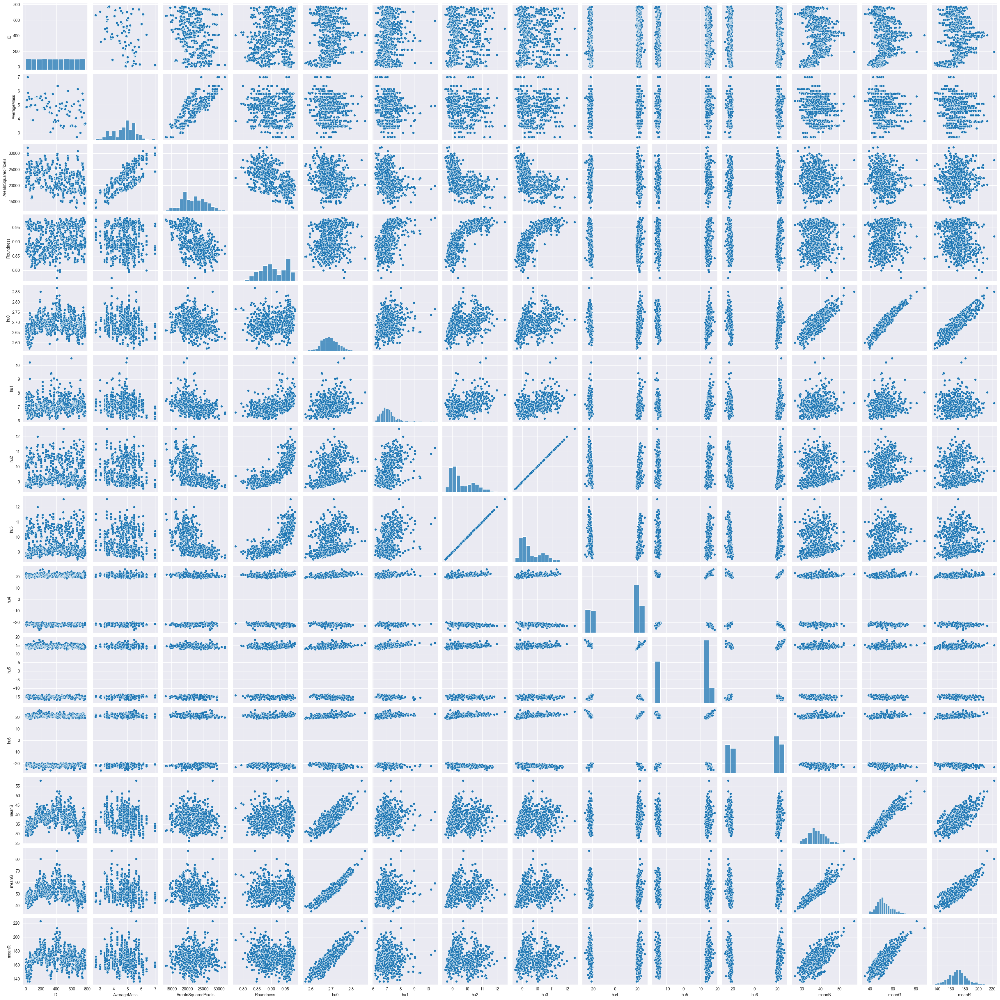

In [5]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")

sns.pairplot(testdf)


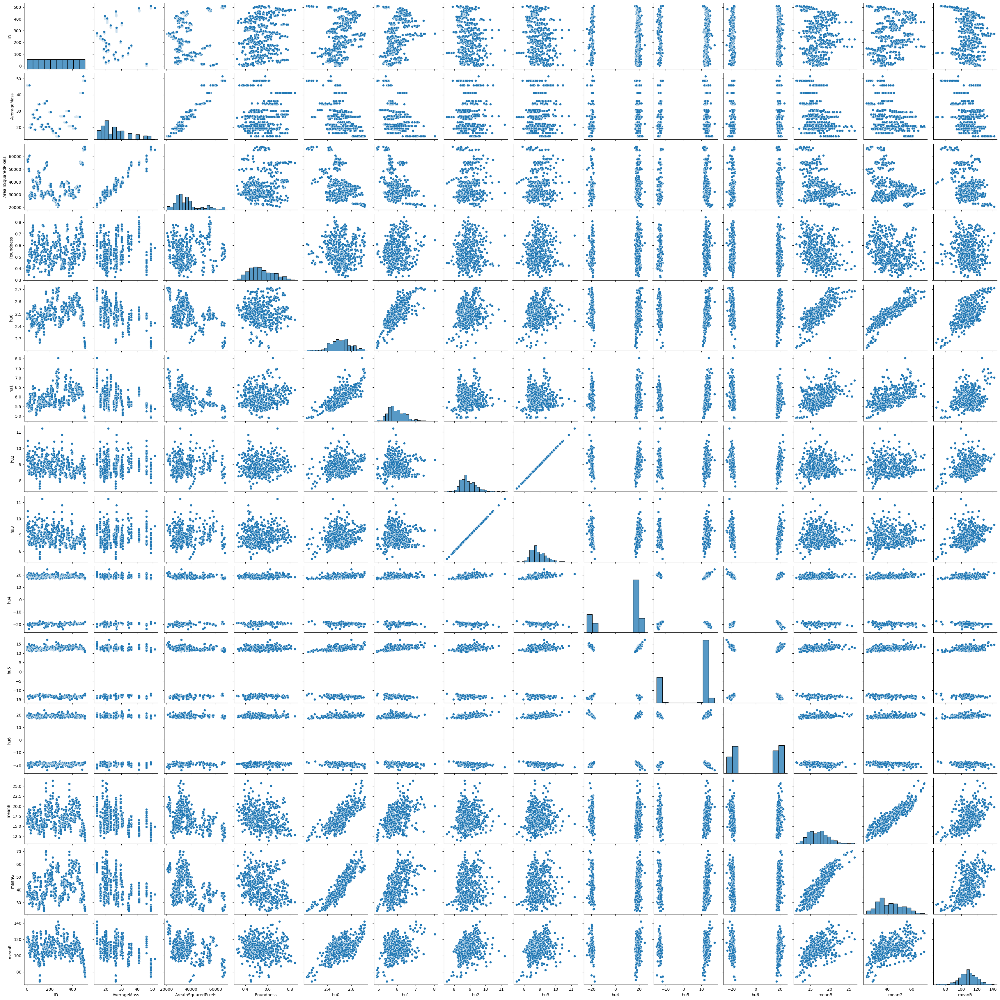

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

sns.pairplot(testdf)


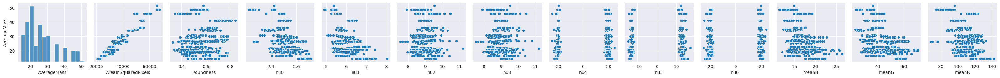

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

testdf = testdf.drop(['ID'], axis=1)

pp = sns.pairplot(data=testdf,
                  y_vars=['AverageMass'])

plt.savefig("./figures/StrawberriesPairplotAverageMass", dpi=300)




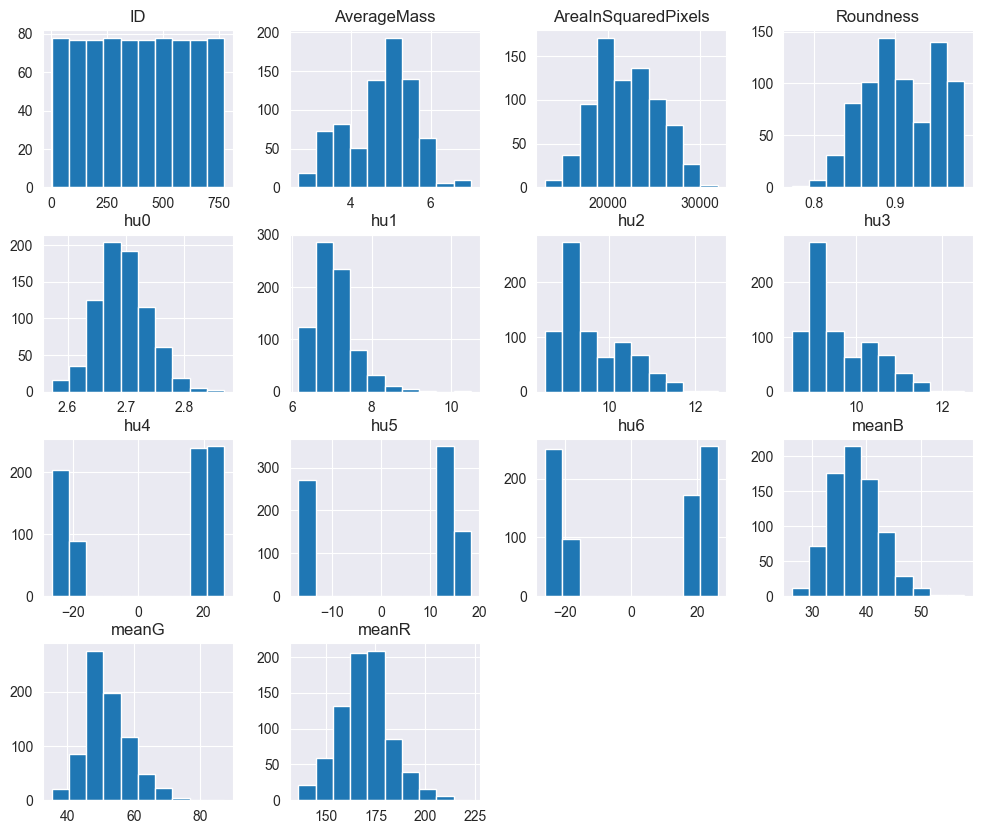

In [6]:
testdf.hist(figsize = (12,10))
plt.show()

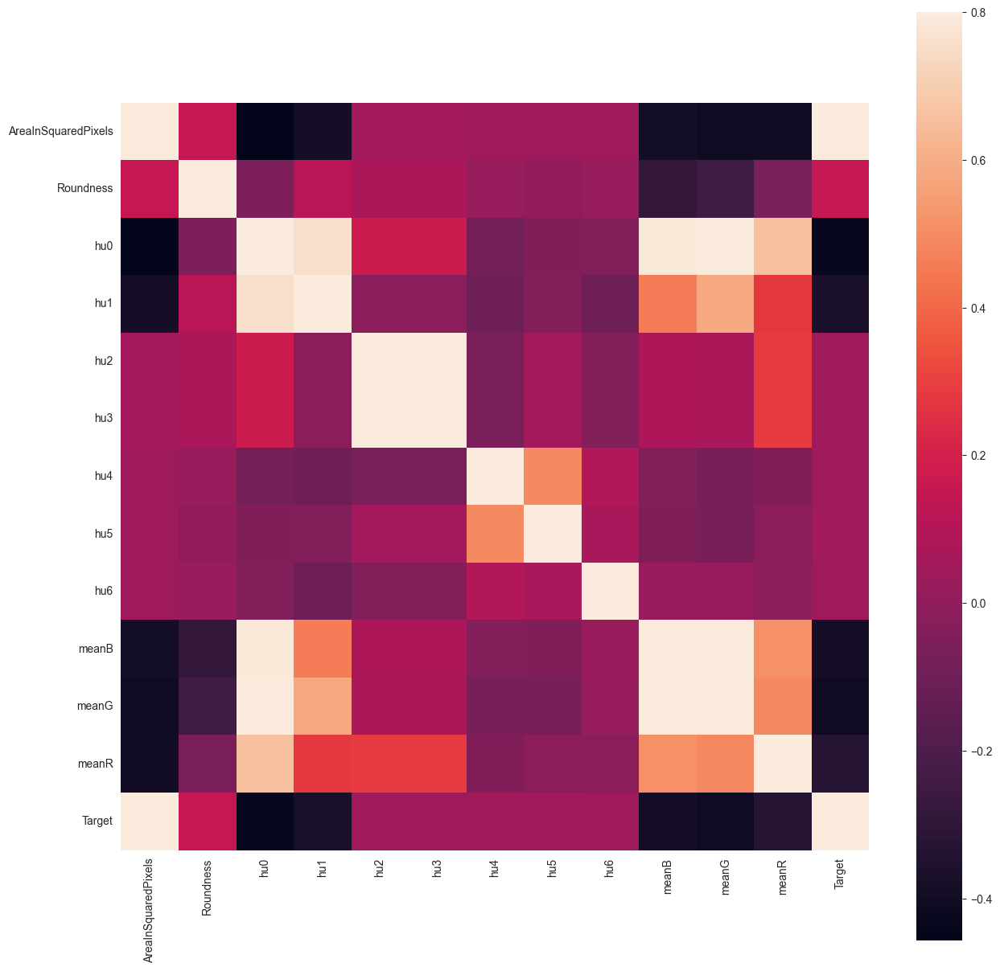

In [7]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)

testdf['Target'] = testdf['AverageMass']
testdf = testdf.drop(["AverageMass"], axis = 1)
C_mat = testdf.corr()
fig = plt.figure(figsize = (15,15))

sns.heatmap(C_mat, vmax = .8, square = True)
plt.show()

<AxesSubplot: >

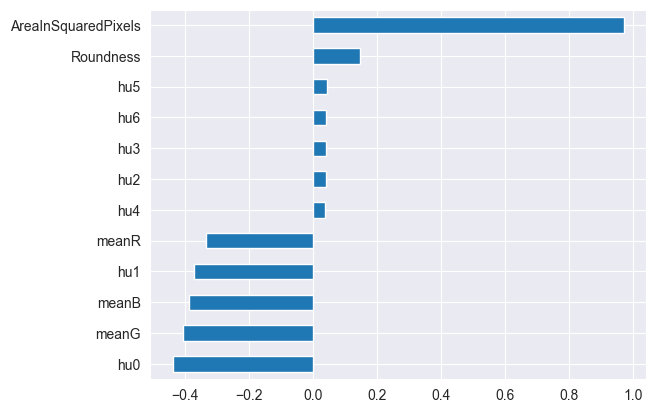

In [8]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

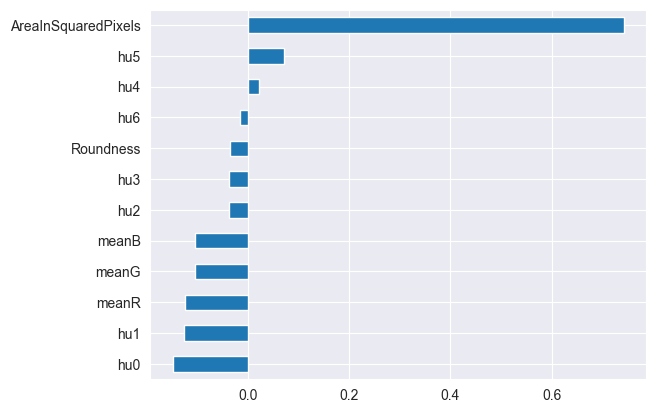

In [9]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

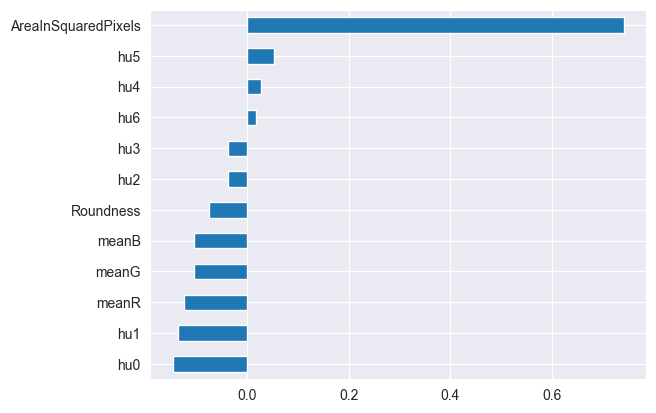

In [10]:
testdf = pd.read_csv("allfeaturesYOLORasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

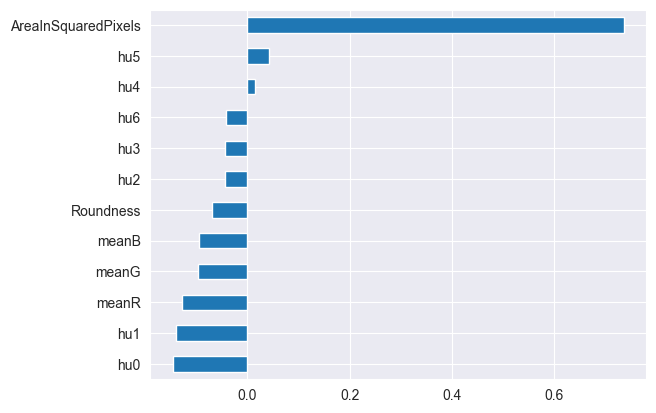

In [11]:
testdf = pd.read_csv("allfeaturesDetectron2rasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()



<AxesSubplot: >

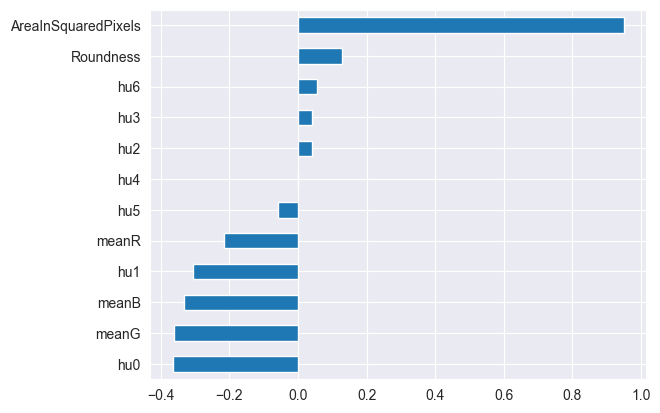

In [12]:
#checando correlacion no lineal con spearman
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr(method= 'spearman')["AverageMass"].sort_values()[:-1].plot.barh()


In [13]:
testdf.corr().style.background_gradient(cmap='coolwarm')


,AverageMass,AreaInSquaredPixels,Roundness,hu0,hu1,hu2,hu3,hu4,hu5,hu6,meanB,meanG,meanR
AverageMass,1.000000,0.971616,0.147975,-0.436478,-0.372183,0.041011,0.041011,0.037208,0.045287,0.041830,-0.386290,-0.404366,-0.333780
AreaInSquaredPixels,0.971616,1.000000,0.148809,-0.456898,-0.384775,0.054358,0.054358,0.037499,0.042792,0.035218,-0.389722,-0.406470,-0.399383
Roundness,0.147975,0.148809,1.000000,-0.055411,0.117716,0.070617,0.070617,0.016065,0.003740,0.016817,-0.289358,-0.244875,-0.065841
hu0,-0.436478,-0.456898,-0.055411,1.000000,0.756037,0.172867,0.172867,-0.085603,-0.049323,-0.041409,0.788042,0.893985,0.654910
hu1,-0.372183,-0.384775,0.117716,0.756037,1.000000,-0.019207,-0.019207,-0.102314,-0.034972,-0.104948,0.460615,0.580435,0.276126
hu2,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu3,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu4,0.037208,0.037499,0.016065,-0.085603,-0.102314,-0.067787,-0.067787,1.000000,0.493780,0.096488,-0.040366,-0.072974,-0.049212
hu5,0.045287,0.042792,0.003740,-0.049323,-0.034972,0.052346,0.052346,0.493780,1.000000,0.064254,-0.045144,-0.072504,-0.015929
hu6,0.041830,0.035218,0.016817,-0.041409,-0.104948,-0.043903,-0.043903,0.096488,0.064254,1.000000,0.027822,0.018287,-0.019152


<AxesSubplot: >

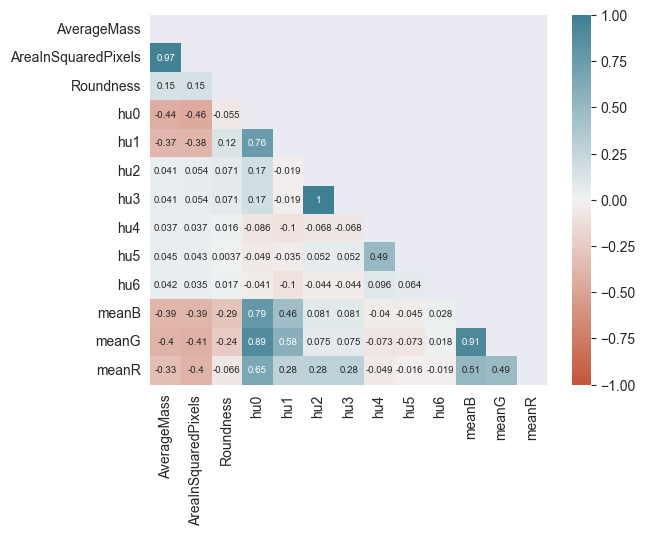

In [14]:

corrmat = testdf.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

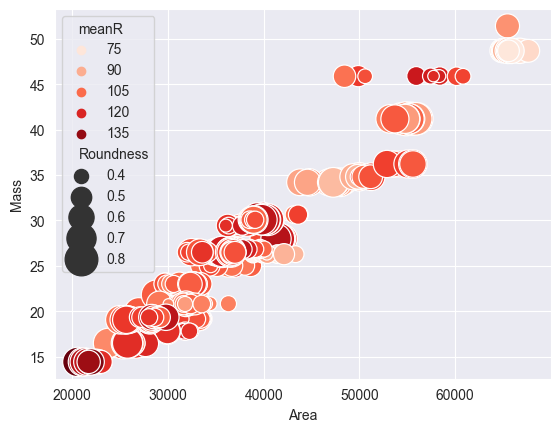

In [15]:
sns.scatterplot(data = testdf, x=testdf['AreaInSquaredPixels'], y=testdf['AverageMass'],
               size=testdf['Roundness'], hue=testdf['meanR'],
               sizes=(20,600),
               palette='Reds')

plt.xlabel('Area')
plt.ylabel('Mass')
plt.savefig("./figures/StrawberriesRawAreaVsMassAndRoundnessAndMeanRed", dpi=300)


# Deep learning

In [3]:
print(tf.__version__)
!pip3 install tensorflow_addons


2.9.0
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [4]:
!pip3 install tensorflow-addons==0.16.1


Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [5]:
#%reload_ext tensorboard

#%rm -rf "logs/fit"

import tensorflow_addons as tfa
from tensorflow_addons.metrics import RSquare


/Users/pablo/Library/Python/3.9/lib/python/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [6]:
!pip3 install pydot

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


# MASTER CLASS

In [102]:
class AutomaticLearning:



  def __init__(self , dataframe, title, model_name):

    print(dataframe.head(2))

    self.df = dataframe
    self.model_name = model_name
    self.input_shape = None
    self.num_classes = None
    self.epochs = None
    self.model = None
    self.X = None
    self.y = None
    self.X_train = None
    self.X_test = None
    self.y_train = None
    self.y_test = None
    self.run_name = "run"
    self.history = None
    self.r2 = None
    self.loss = None
    self.mse = None
    self.mae = None
    self.rmse = None
    self.library = None
    self.title = title
    self.plottittle = ""
    return

  def gather_data(self):
    return {'r2': self.r2, 'loss': self.loss, 'mse': self.mse, 'mae': self.mae, 'rmse': self.rmse}

  def plotA(self):
    pd.DataFrame(self.history.history).plot(figsize=(8,5))
    plt.show()
    return

  def plotLinear(self, save, show):
    # plot the data and the predictions

    #print(self.X_test)
    predictions = self.model.predict(self.X_test)

    plt.xlabel('Area (pixels^2)')
    plt.ylabel('Mass (g)')

    plt.scatter(self.X_test, self.y_test)
    if(self.model_name == "SVR"):
      plt.scatter(self.X_test, predictions, color='red', marker="x")
    else:
      plt.plot(self.X_test, predictions, color='red')

    plt.title(self.plottittle +'-R2', size = 20)

    if(show):
      plt.show()
    if(save):
      plt.savefig(self.folder +'/'+self.plottittle + '-R2', dpi=300)
    print(f'R-squared value: {self.r2:.4f}')


    plt.scatter(self.y_test, predictions)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.title(self.plottittle + '-Predictions', size = 20)
    if(show):
      plt.show()

    if(save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions', dpi=300)

    return

  def plotLoss(self):
    fig, ax = plt.subplots()
    ax.set(title='Loss')
    ax.plot(self.history.history['loss'], label='Loss')
    ax.plot(self.history.history['val_loss'], label='Val loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='MSE')
    ax.plot(self.history.history['mse'], label='MSE')
    ax.plot(self.history.history['val_mse'], label='Val MSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
    

  def plotMAE(self):
    fig, ax = plt.subplots()
    ax.set(title='MAE')
    ax.plot(self.history.history['mae'], label='MAE')
    ax.plot(self.history.history['val_mae'], label='Val MAE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotRMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='RMSE')
    ax.plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax.plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
  
  def plotPredictions(self, save, show):
    predictions = self.model(self.X_test)
    self.r2 = r2_score(self.y_test, predictions)
    print(f'R-squared value: {self.r2:.4f}')
    plt.scatter(self.y_test, predictions)
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.title(self.plottittle + '-Predictions', size = 20)

    if(save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions', dpi=300)
    if(show):
      plt.show()

  def plotAll(self, save, show):

    fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))
   
    fig.suptitle(self.plottittle, size = 35)   

    ax[0][0].set(title='Loss')
    ax[0][0].plot(self.history.history['loss'], label='Loss')
    ax[0][0].plot(self.history.history['val_loss'], label='Val loss')
    ax[0][0].set_xlabel('Epoch')
    ax[0][0].set_ylabel('Values')
    ax[0][0].legend()


    ax[0][1].set(title='MSE')
    ax[0][1].plot(self.history.history['mse'], label='MSE')
    ax[0][1].plot(self.history.history['val_mse'], label='Val MSE')
    ax[0][1].set_xlabel('Epoch')
    ax[0][1].set_ylabel('Values')
    ax[0][1].legend()

   

    ax[1][0].set(title='MAE')
    ax[1][0].plot(self.history.history['mae'], label='MAE')
    ax[1][0].plot(self.history.history['val_mae'], label='Val MAE')
    ax[1][0].set_xlabel('Epoch')
    ax[1][0].set_ylabel('Values')
    ax[1][0].legend()

    ax[1][1].set(title='RMSE')
    ax[1][1].plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax[1][1].plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax[1][1].set_xlabel('Epoch')
    ax[1][1].set_ylabel('Values')
    ax[1][1].legend()

    if(save):
      print("IM SAVING", save)

      plt.savefig(self.folder +'/'+self.plottittle+'-Summary', dpi=300)

    if(show):
      print("IM SHOWING", show)

      plt.show()

  def plotNonLinear(self, save, show):

    self.plotAll(save, show)
    self.plotPredictions(save, show)
    #self.plotLoss()
    #self.plotMAE()
    #self.plotMSE()
    #self.plotRMSE()
    return

  def plot(self, folder, save = True, show = False):
    self.folder = folder
    if not os.path.exists(self.folder):
      print("creating folder:", self.folder)
      os.makedirs(self.folder)

    if(self.library == "Tensorflow"):
      if(save and show): 
        print(self.model.summary())
        plot_model(self.folder + '/' + self.model, to_file= self.model_name + "-" + self.run_name + "-" + self.title + '.png', show_shapes=True, show_layer_names=False)
        #plot_model(self.model, show_shapes=True, show_layer_names=False)
      if(save):
        print("IM SAVING")
        #img = mpimg.imread(self.title +'/'+ self.model_name + "-" + self.run_name + "-" + self.title + '.png')
      if(show):
        print("IM SHOWING")
        #imgplot = plt.imshow(img)
        #imgplot = plt.imshow(img2)
        plt.show()


    if(self.library == "Tensorflow"):
      self.plotNonLinear(save = False, show = True)
    elif(self.library == "scikit"):
      print("plotting linear")
      self.plotLinear(save = False, show = True)


  def train(self, epochs = 2):

    self.epochs = epochs
    if(self.library != "scikit"):
      self.plottittle = self.title + "-" + str(self.epochs)
    else:
      self.plottittle = self.title

    print(self.plottittle)
    
    if(self.library == "Tensorflow"):
      opt = optimizers.Adam(learning_rate=0.01)
      sgd = optimizers.SGD(learning_rate=0.01, momentum=0.9, nesterov=True)

      
      self.model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer = opt, metrics=['mse', 'mae', tf.keras.metrics.RootMeanSquaredError()])
      early_stop = EarlyStopping(monitor='val_loss', patience=250, verbose=1)

      self.history = self.model.fit(self.X_train, self.y_train, batch_size=32, epochs = self.epochs, validation_split=0.2, shuffle = True,callbacks=[early_stop], verbose = 1)
      #['loss', 'mse', 'mae', 'root_mean_squared_error']
      results = self.model.evaluate(self.X_test, self.y_test)
      self.loss = results[0]
      self.mse = results[1]
      self.mae = results[2]
      self.rmse = results[3]
      print("Test loss:", results)
      print(self.model.metrics_names)

    elif(self.library == "scikit"):


      self.model.fit(self.X_train, self.y_train)
      self.y_pred = self.model.predict(self.X_test)


      self.predictions = self.model.predict(self.X_test)

      self.r2 = r2_score(self.y_test, self.y_pred)

      #self.r2 = self.model.score(self.X, self.y)
      self.mse = mean_squared_error(self.y_test, self.y_pred)
      self.mae = mean_absolute_error(self.y_test, self.y_pred)
      self.rmse = np.sqrt(self.mse)
      
    return
  def buildData(self):

    normalizer = Normalization()
    if(self.model_name == "linear" or self.model_name == "SVR"):
      self.df = self.df.drop(["Roundness"], axis = 1)

    if(self.model_name == 'CNN' or self.model_name == 'ResNet' or self.model_name == 'MobileNet'):
      print("entrando")
      self.X = np.array(self.df['img'].tolist())
      self.y = np.array(self.df['AverageMass'].tolist())
      self.X = self.X / 255.0

    else:
      self.X = self.df.drop(columns=['AverageMass', 'ID'])
      self.y = self.df['AverageMass']
        
      
    if(self.library == "Tensorflow" and self.model_name != 'CNN'):
      #self.X = scaler.fit_transform(self.X)
      normalizer.adapt(self.X)
      self.X = normalizer(self.X)

    #print(self.X.head(10))
  
    self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2)


    if(self.model_name != 'CNN' or self.model_name != 'ResNet' or self.model_name != 'MobileNet'):
      self.X_train = np.array(self.X_train)
      self.y_train = np.array(self.y_train)
      self.X_test = np.array(self.X_test)
      self.y_test = np.array(self.y_test)

    # Define the input shape and number of classes
    self.input_shape = (self.X_train.shape[1],)
    #print(self.input_shape)
    num_classes = 1
    return

  def buildModel(self):

    if(self.model_name == "FCNN"): 
      # FCNN
      self.library = "Tensorflow"
      self.model = keras.Sequential(
          [
          tf.keras.layers.Dense(64, activation='relu', input_shape = self.input_shape),
          tf.keras.layers.Dense(32, activation='relu'),
          tf.keras.layers.Dense(16, activation='linear'),
          tf.keras.layers.Dense(1)
          ]
      )
    elif(self.model_name == "DeepSVM"):

      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Dense(128, activation='linear', input_shape=self.input_shape, kernel_regularizer=tf.keras.regularizers.l2(0.01)),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "CNN"):
      # Autoencoder
      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(140, 140, 3)),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(128, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "ResNet"):
      self.library = "Tensorflow"
      base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False


    elif(self.model_name == "DenseNet"):
      self.library = "Tensorflow"

      base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "MobileNet"):
      self.library = "Tensorflow"

      base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "linear"):
      self.library = "scikit"
      self.model = LinearRegression()

    elif(self.model_name == "SVR"):
      self.library = "scikit"
      # Create an SVR object and fit the training data
      self.model = SVR(kernel='rbf', C=100, epsilon=0.01)

    elif(self.model_name == "MLP"):
      # MLP
      self.library = "Tensorflow"
      self.model = Sequential([
          Dense(64, activation='relu', input_shape=self.input_shape),
          Dropout(0.2),
          Dense(32, activation='relu'),
          Dropout(0.2),
          Dense(1, activation='linear')
      ])



    return




In [65]:

RawExperiments = {
    "Blueberries": {
        "Tests" : {
                "DeepLearning": {
                        "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                        "Extention" : ".csv",
                        "Models" : ["MLP", "FCNN", "DeepSVM"],
                        "Epochs" : [100, 400, 1000, 2000]
                },
                "MachineLearning": {
                        "Datasets" : ["CGBR"],
                        "Extention" : ".csv",
                        "Models" : ["Linear", "SVR"],
                        "Epochs" : [1]
                },
                "Images" : {
                        "Datasets" : ["CIBR"],
                        "Extention" : ".pkl",
                        "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                        "Epochs" : [50, 200, 1000, 4000]
                }
        }
    }
}

Experiments = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    }
}


YOLOExperiments = {}
DetectronExperiments = {}


Running experiments for Blueberries...
Running DeepLearning tests...
Running tests on CGBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_296 (Dense)           (None, 64)                192       
                                                                 
 dropout_66 (Dropout)        (None, 64)                0         
                                                                 
 dense_297 (Dense)           (None, 32)                2080      
                                                                 
 dropout_67 (Dropout)        (None, 32)                0         
                                                                 

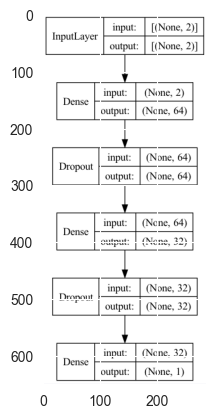

CGBR-MLP-1


2023-05-02 10:13:57.007428: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 300ms/step - loss: 1931104.5000 - mse: 1931104.5000 - mae: 1080.4812 - root_mean_squared_error: 1389.6418 - val_loss: 50933.7109 - val_mse: 50933.7109 - val_mae: 219.9613 - val_root_mean_squared_error: 225.6850


2023-05-02 10:13:58.516810: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 81ms/step - loss: 78186.1719 - mse: 78186.1719 - mae: 270.6571 - root_mean_squared_error: 279.6179
Test loss: [78186.171875, 78186.171875, 270.6570739746094, 279.6178894042969]
['loss', 'mse', 'mae', 'root_mean_squared_error']


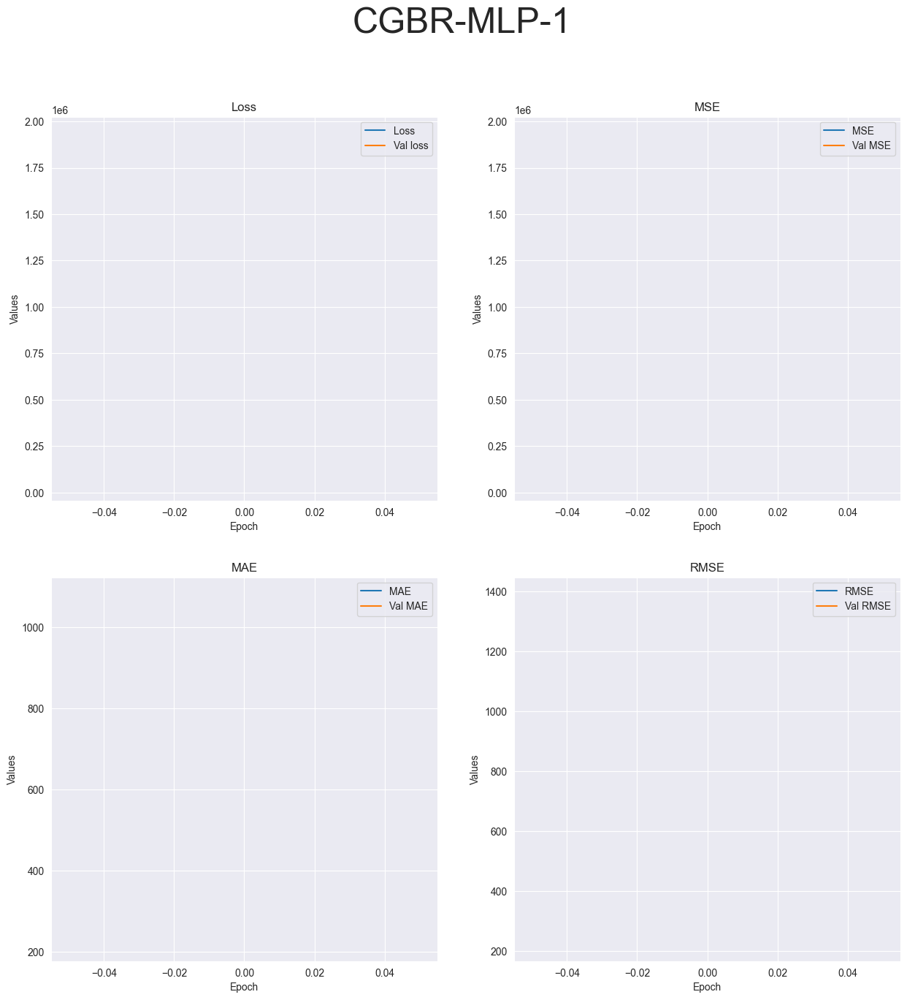

R-squared value: -133489.8933


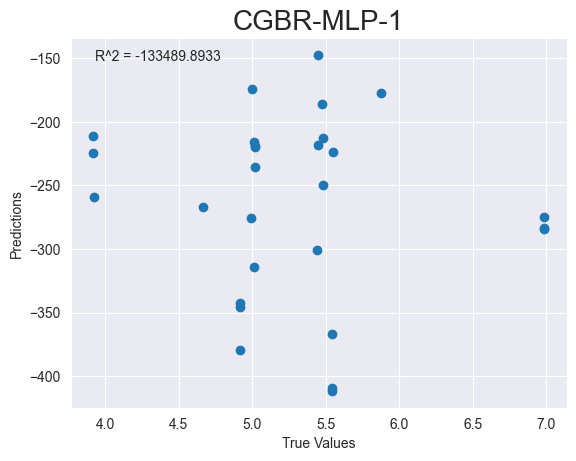

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_299 (Dense)           (None, 64)                192       
                                                                 
 dropout_68 (Dropout)        (None, 64)                0         
                                                                 
 dense_300 (Dense)           (None, 32)                2080      
                                                                 
 dropout_69 (Dropout)        (None, 32)                0         
                                                                 
 dense_301 (Dense)           (None, 1)                 33        
                                                                 


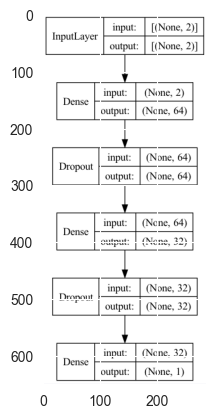

CGBR-MLP-4
Epoch 1/4


2023-05-02 10:14:00.018595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 264ms/step - loss: 2730065.7500 - mse: 2730065.7500 - mae: 1343.4875 - root_mean_squared_error: 1652.2910 - val_loss: 1249.9309 - val_mse: 1249.9309 - val_mae: 34.1330 - val_root_mean_squared_error: 35.3544
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 541208.7500 - mse: 541208.7500 - mae: 609.3057 - root_mean_squared_error: 735.6689

2023-05-02 10:14:00.991140: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 39ms/step - loss: 493546.1562 - mse: 493546.1562 - mae: 548.7688 - root_mean_squared_error: 702.5284 - val_loss: 141150.8281 - val_mse: 141150.8281 - val_mae: 358.5188 - val_root_mean_squared_error: 375.7004
Epoch 3/4
3/3 [==============================] - 0s 25ms/step - loss: 376858.2500 - mse: 376858.2500 - mae: 464.1815 - root_mean_squared_error: 613.8878 - val_loss: 1027.1545 - val_mse: 1027.1545 - val_mae: 30.0109 - val_root_mean_squared_error: 32.0493
Epoch 4/4
1/1 [==============================] - 0s 100ms/step - loss: 12471.4229 - mse: 12471.4229 - mae: 105.7011 - root_mean_squared_error: 111.6755
Test loss: [12471.4228515625, 12471.4228515625, 105.70111846923828, 111.67552185058594]
['loss', 'mse', 'mae', 'root_mean_squared_error']


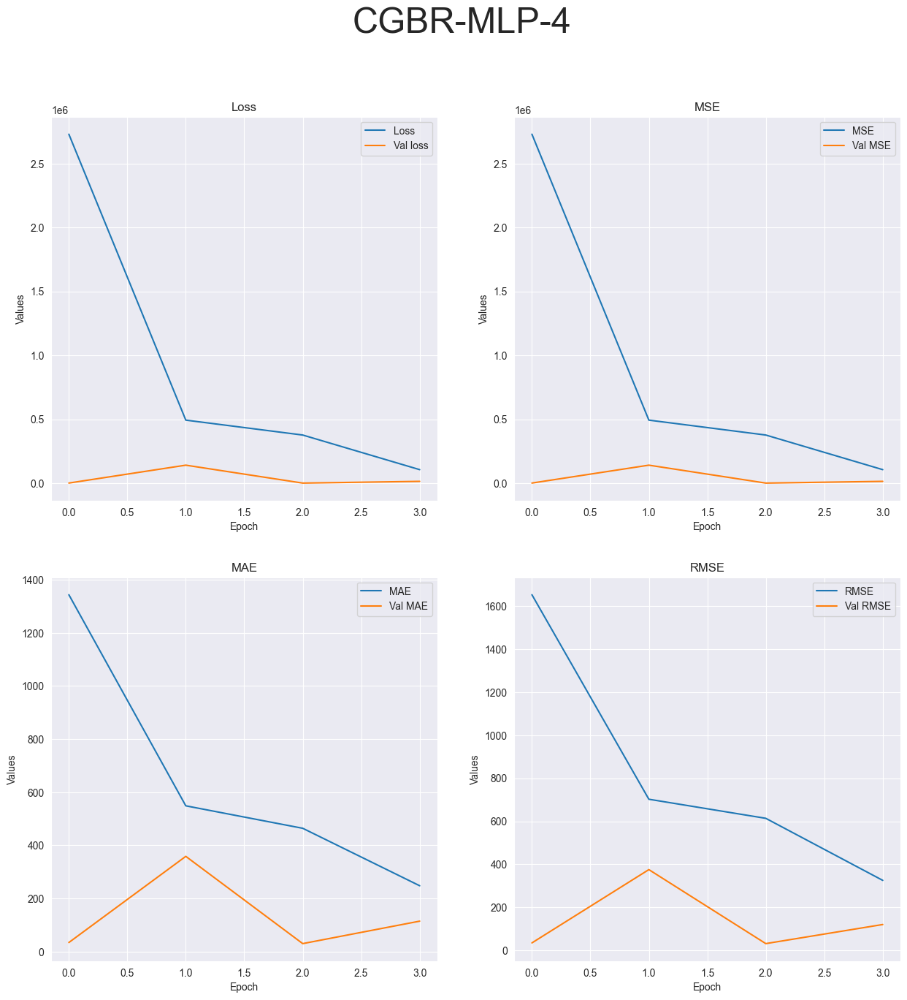

R-squared value: -35688.9116


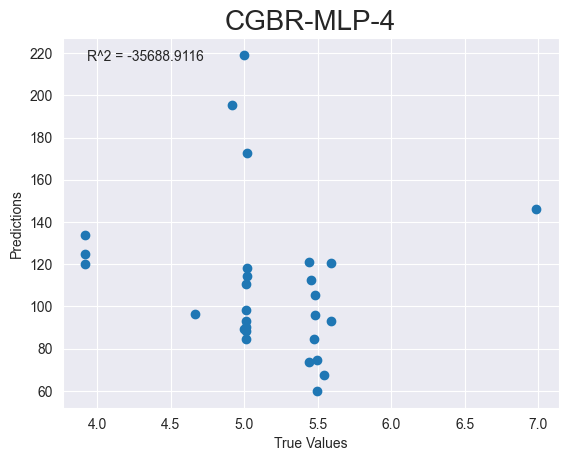

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_302 (Dense)           (None, 64)                192       
                                                                 
 dropout_70 (Dropout)        (None, 64)                0         
                                                                 
 dense_303 (Dense)           (None, 32)                2080      
                                                                 
 dropout_71 (Dropout)        (None, 32)                0         
                                                                 
 dense_304 (Dense)           (None, 1)                 33        
                                                                 

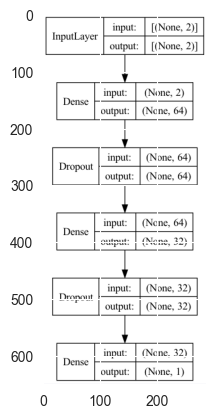

CGBR-MLP-10
Epoch 1/10


2023-05-02 10:14:02.733682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 222ms/step - loss: 2508475.7500 - mse: 2508475.7500 - mae: 1262.2791 - root_mean_squared_error: 1583.8168 - val_loss: 658.6792 - val_mse: 658.6792 - val_mae: 24.0872 - val_root_mean_squared_error: 25.6647
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 659467.2500 - mse: 659467.2500 - mae: 596.9396 - root_mean_squared_error: 812.0759

2023-05-02 10:14:03.509332: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 24ms/step - loss: 527895.7500 - mse: 527895.7500 - mae: 543.3682 - root_mean_squared_error: 726.5643 - val_loss: 9679.7568 - val_mse: 9679.7568 - val_mae: 94.6234 - val_root_mean_squared_error: 98.3858
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 234242.5156 - mse: 234242.5156 - mae: 362.8885 - root_mean_squared_error: 483.9861 - val_loss: 70071.3281 - val_mse: 70071.3281 - val_mae: 253.0035 - val_root_mean_squared_error: 264.7099
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 80555.0000 - mse: 80555.0000 - mae: 209.2354 - root_mean_squared_error: 283.8221 - val_loss: 66226.6172 - val_mse: 66226.6172 - val_mae: 245.9524 - val_root_mean_squared_error: 257.3453
Epoch 5/10
3/3 [==============================] - 0s 40ms/step - loss: 57563.9531 - mse: 57563.9531 - mae: 198.7654 - root_mean_squared_error: 239.9249 - val_loss: 35728.9492 - val_mse: 35728.9492 - val_mae: 180.5332 - val_root_mean_squared

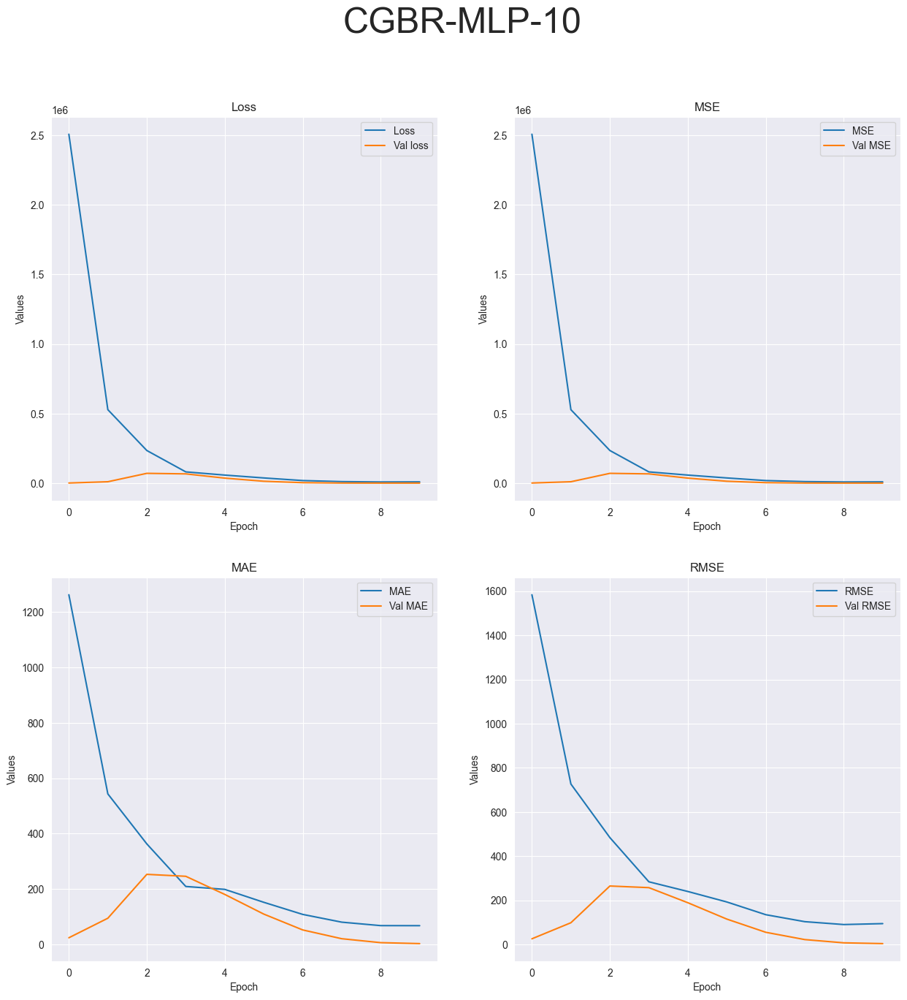

R-squared value: -23.9595


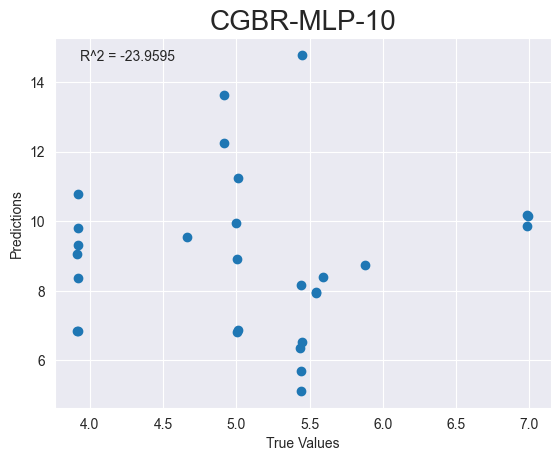

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_305 (Dense)           (None, 64)                192       
                                                                 
 dropout_72 (Dropout)        (None, 64)                0         
                                                                 
 dense_306 (Dense)           (None, 32)                2080      
                                                                 
 dropout_73 (Dropout)        (None, 32)                0         
                                                                 
 dense_307 (Dense)           (None, 1)                 33        
                                                                 

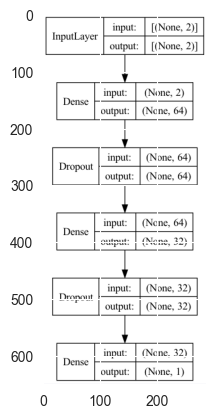

CGBR-MLP-20
Epoch 1/20


2023-05-02 10:14:05.431238: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 156ms/step - loss: 2737144.7500 - mse: 2737144.7500 - mae: 1291.3274 - root_mean_squared_error: 1654.4319 - val_loss: 24137.1758 - val_mse: 24137.1758 - val_mae: 148.9451 - val_root_mean_squared_error: 155.3614
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 591930.1250 - mse: 591930.1250 - mae: 635.6565 - root_mean_squared_error: 769.3699

2023-05-02 10:14:05.938118: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 53ms/step - loss: 605862.5625 - mse: 605862.5625 - mae: 589.9862 - root_mean_squared_error: 778.3718 - val_loss: 201718.5625 - val_mse: 201718.5625 - val_mae: 429.7851 - val_root_mean_squared_error: 449.1309
Epoch 3/20
3/3 [==============================] - 0s 43ms/step - loss: 337438.7500 - mse: 337438.7500 - mae: 445.4545 - root_mean_squared_error: 580.8948 - val_loss: 1000.1435 - val_mse: 1000.1435 - val_mae: 29.7585 - val_root_mean_squared_error: 31.6250
Epoch 4/20
3/3 [==============================] - 0s 30ms/step - loss: 100921.4844 - mse: 100921.4844 - mae: 228.9696 - root_mean_squared_error: 317.6814 - val_loss: 17335.1738 - val_mse: 17335.1738 - val_mae: 125.4251 - val_root_mean_squared_error: 131.6631
Epoch 5/20
3/3 [==============================] - 0s 24ms/step - loss: 82373.4219 - mse: 82373.4219 - mae: 216.5488 - root_mean_squared_error: 287.0077 - val_loss: 16178.7637 - val_mse: 16178.7637 - val_mae: 121.1544 - val_root_mean_squ

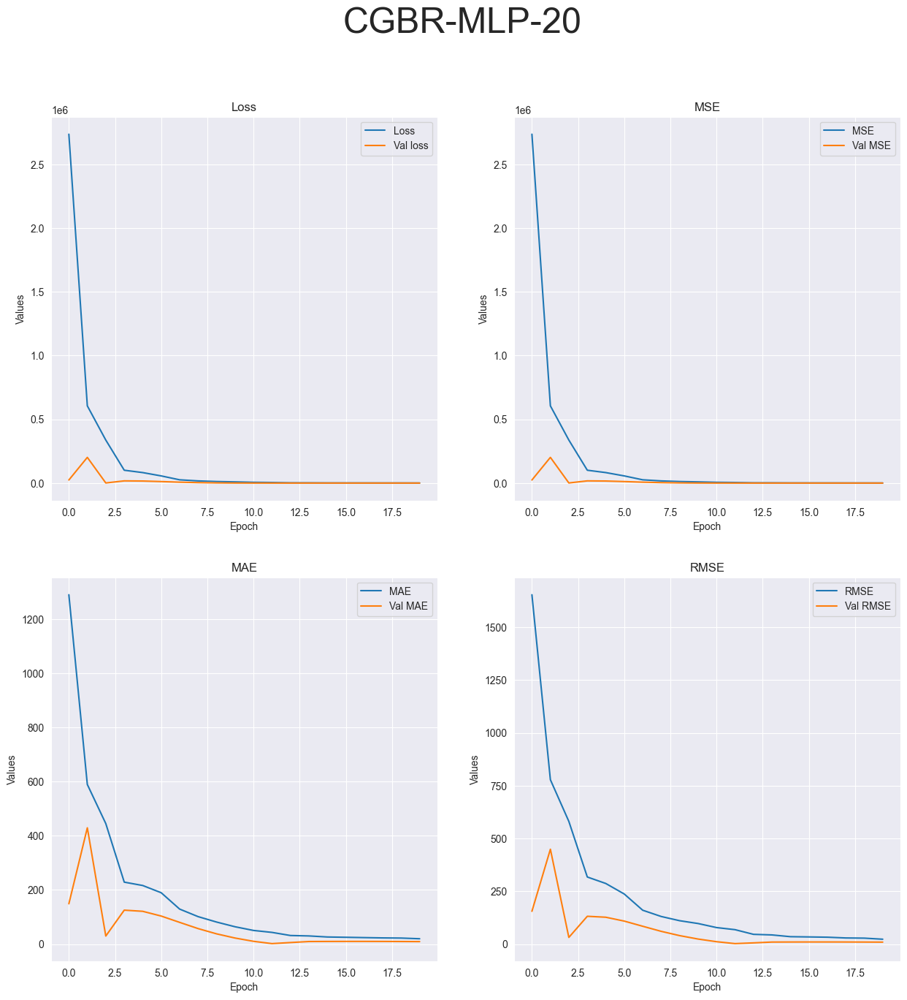

R-squared value: -259.2775


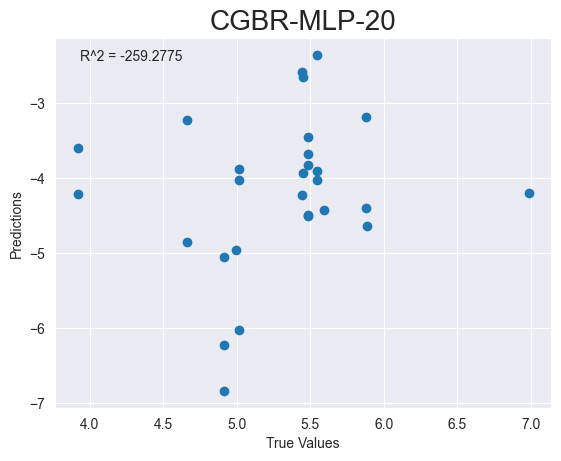

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_308 (Dense)           (None, 64)                192       
                                                                 
 dense_309 (Dense)           (None, 32)                2080      
                                                                 
 dense_310 (Dense)           (None, 16)                528       
                                                                 
 dense_311 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
____________________________________

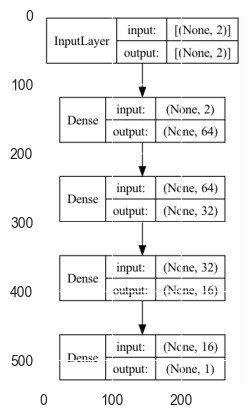

CGBR-FCNN-1


2023-05-02 10:14:08.510895: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 6314433.5000 - mse: 6314433.5000 - mae: 1906.4663 - root_mean_squared_error: 2512.8538 - val_loss: 124213.2812 - val_mse: 124213.2812 - val_mae: 338.1737 - val_root_mean_squared_error: 352.4391


2023-05-02 10:14:09.030574: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 130ms/step - loss: 166702.6719 - mse: 166702.6719 - mae: 390.7466 - root_mean_squared_error: 408.2924
Test loss: [166702.671875, 166702.671875, 390.74664306640625, 408.2923889160156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


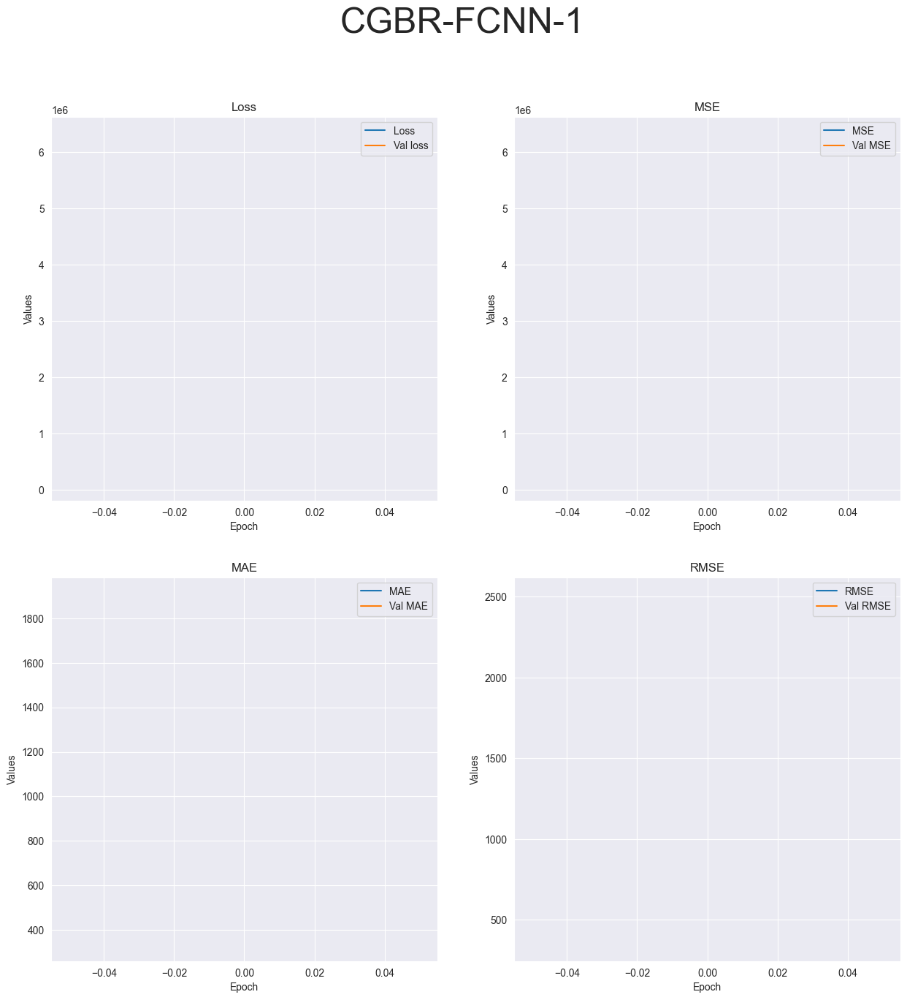

R-squared value: -603378.8153


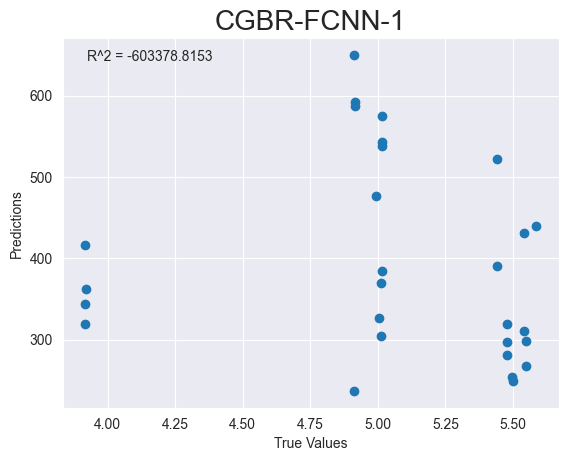

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_312 (Dense)           (None, 64)                192       
                                                                 
 dense_313 (Dense)           (None, 32)                2080      
                                                                 
 dense_314 (Dense)           (None, 16)                528       
                                                                 
 dense_315 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
________________________________________________________________

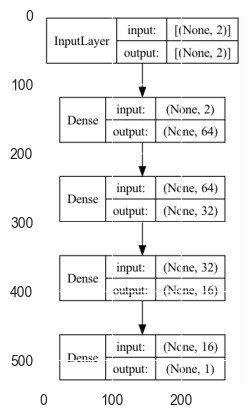

CGBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:11.209421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 178ms/step - loss: 7236614.0000 - mse: 7236614.0000 - mae: 1963.7477 - root_mean_squared_error: 2690.0955 - val_loss: 235005.6562 - val_mse: 235005.6562 - val_mae: 468.9122 - val_root_mean_squared_error: 484.7738
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 224611.2031 - mse: 224611.2031 - mae: 456.3471 - root_mean_squared_error: 473.9316

2023-05-02 10:14:11.848425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 54ms/step - loss: 1687080.1250 - mse: 1687080.1250 - mae: 1131.4564 - root_mean_squared_error: 1298.8765 - val_loss: 3042655.0000 - val_mse: 3042655.0000 - val_mae: 1688.1107 - val_root_mean_squared_error: 1744.3208
Epoch 3/4
3/3 [==============================] - 0s 41ms/step - loss: 1889699.2500 - mse: 1889699.2500 - mae: 1291.8430 - root_mean_squared_error: 1374.6633 - val_loss: 352684.2188 - val_mse: 352684.2188 - val_mae: 574.5160 - val_root_mean_squared_error: 593.8723
Epoch 4/4
1/1 [==============================] - 0s 53ms/step - loss: 39144.0195 - mse: 39144.0195 - mae: 189.6787 - root_mean_squared_error: 197.8485
Test loss: [39144.01953125, 39144.01953125, 189.67868041992188, 197.84848022460938]
['loss', 'mse', 'mae', 'root_mean_squared_error']


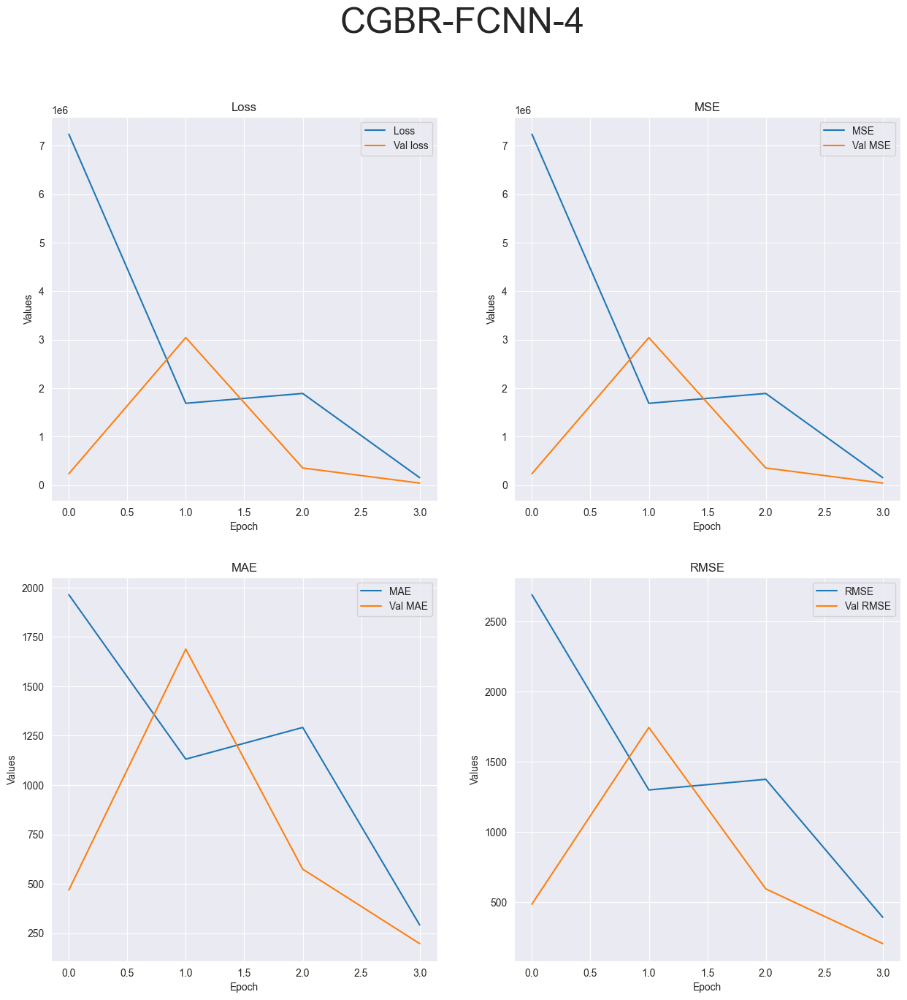

R-squared value: -67265.5389


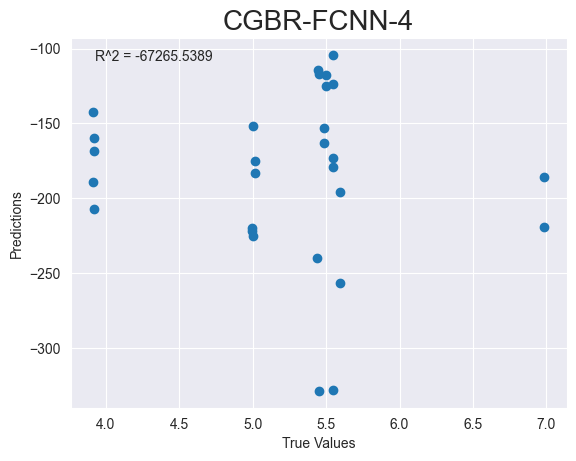

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_316 (Dense)           (None, 64)                192       
                                                                 
 dense_317 (Dense)           (None, 32)                2080      
                                                                 
 dense_318 (Dense)           (None, 16)                528       
                                                                 
 dense_319 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

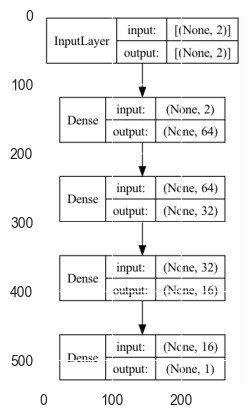

CGBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:13.522041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 6806653.0000 - mse: 6806653.0000 - mae: 1937.9410 - root_mean_squared_error: 2608.9563 - val_loss: 218846.9062 - val_mse: 218846.9062 - val_mae: 451.5173 - val_root_mean_squared_error: 467.8108
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 233807.1250 - mse: 233807.1250 - mae: 470.1488 - root_mean_squared_error: 483.5361

2023-05-02 10:14:14.084627: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 1907987.6250 - mse: 1907987.6250 - mae: 1203.3157 - root_mean_squared_error: 1381.2992 - val_loss: 2250288.2500 - val_mse: 2250288.2500 - val_mae: 1448.6025 - val_root_mean_squared_error: 1500.0961
Epoch 3/10
3/3 [==============================] - 0s 32ms/step - loss: 1703010.1250 - mse: 1703010.1250 - mae: 1223.5930 - root_mean_squared_error: 1304.9943 - val_loss: 195235.2969 - val_mse: 195235.2969 - val_mae: 426.4460 - val_root_mean_squared_error: 441.8544
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 89980.8281 - mse: 89980.8281 - mae: 241.1797 - root_mean_squared_error: 299.9680 - val_loss: 54298.6289 - val_mse: 54298.6289 - val_mae: 225.4088 - val_root_mean_squared_error: 233.0207
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 123582.3359 - mse: 123582.3359 - mae: 332.2378 - root_mean_squared_error: 351.5428 - val_loss: 190976.4375 - val_mse: 190976.4375 - val_mae: 422.4427

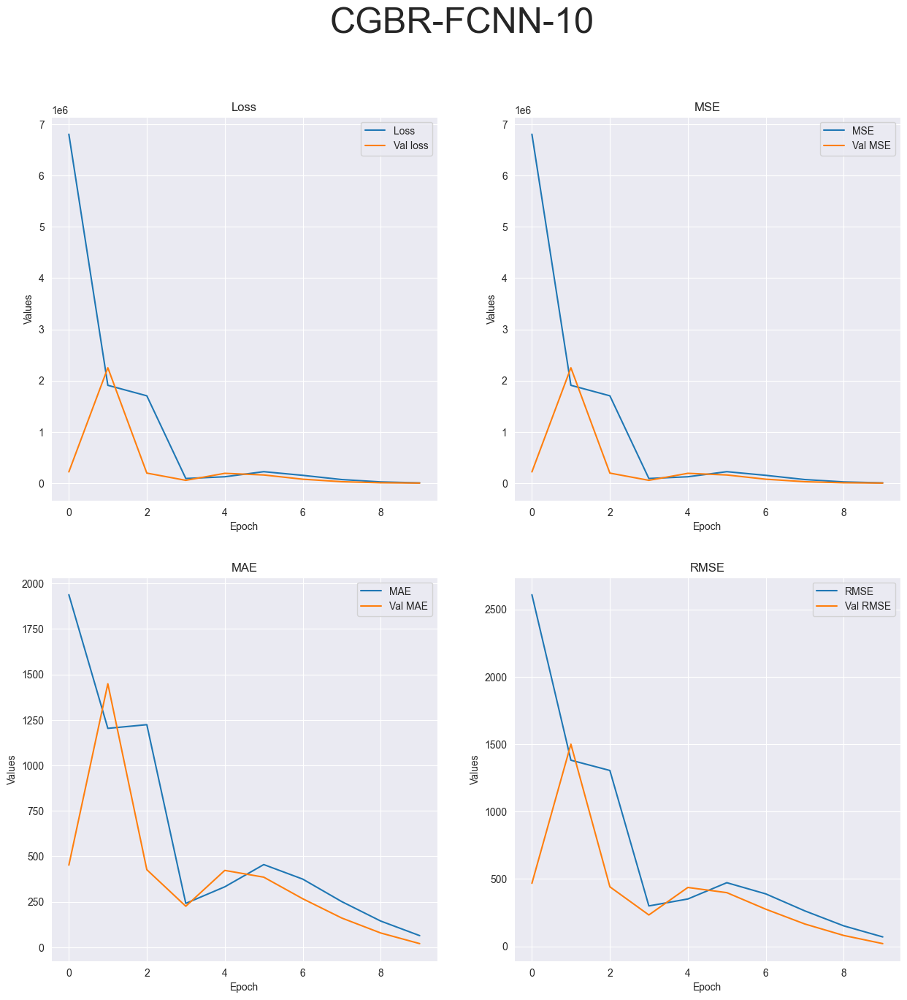

R-squared value: -917.3556


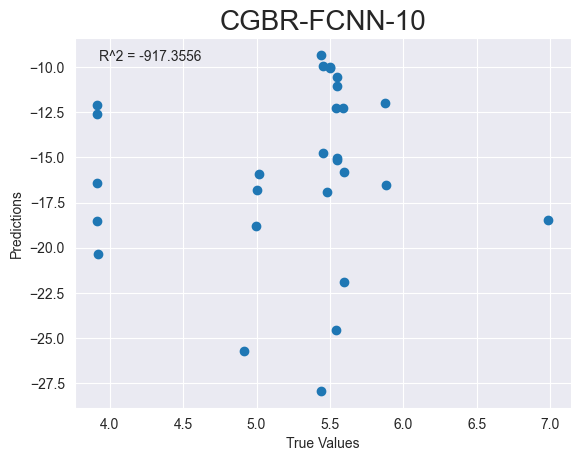

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_320 (Dense)           (None, 64)                192       
                                                                 
 dense_321 (Dense)           (None, 32)                2080      
                                                                 
 dense_322 (Dense)           (None, 16)                528       
                                                                 
 dense_323 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

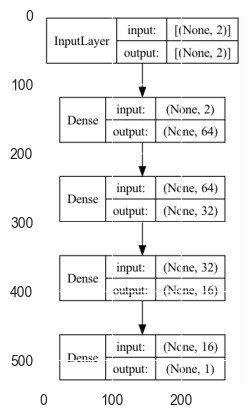

CGBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:15.977271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 6727961.0000 - mse: 6727961.0000 - mae: 1933.4480 - root_mean_squared_error: 2593.8313 - val_loss: 210865.0156 - val_mse: 210865.0156 - val_mae: 439.6473 - val_root_mean_squared_error: 459.2004
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 241104.3438 - mse: 241104.3438 - mae: 468.0579 - root_mean_squared_error: 491.0238

2023-05-02 10:14:16.520212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 30ms/step - loss: 1677465.8750 - mse: 1677465.8750 - mae: 1146.1877 - root_mean_squared_error: 1295.1702 - val_loss: 2464343.7500 - val_mse: 2464343.7500 - val_mae: 1504.0598 - val_root_mean_squared_error: 1569.8229
Epoch 3/20
3/3 [==============================] - 0s 34ms/step - loss: 1785752.2500 - mse: 1785752.2500 - mae: 1260.4187 - root_mean_squared_error: 1336.3204 - val_loss: 242056.6250 - val_mse: 242056.6250 - val_mae: 471.0752 - val_root_mean_squared_error: 491.9925
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 108882.9453 - mse: 108882.9453 - mae: 259.3523 - root_mean_squared_error: 329.9742 - val_loss: 48234.0000 - val_mse: 48234.0000 - val_mae: 210.9215 - val_root_mean_squared_error: 219.6224
Epoch 5/20
3/3 [==============================] - 0s 16ms/step - loss: 114059.2500 - mse: 114059.2500 - mae: 316.1373 - root_mean_squared_error: 337.7266 - val_loss: 194340.7031 - val_mse: 194340.7031 - val_mae: 422.93

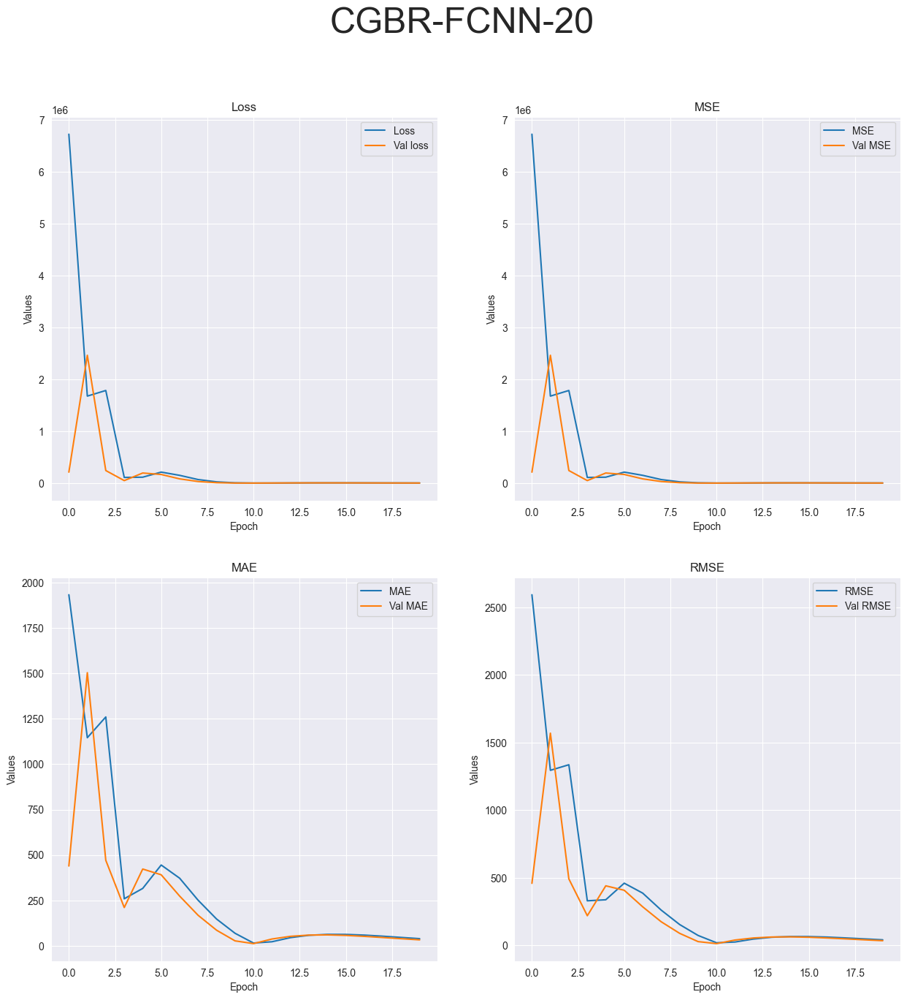

R-squared value: -3031.6609


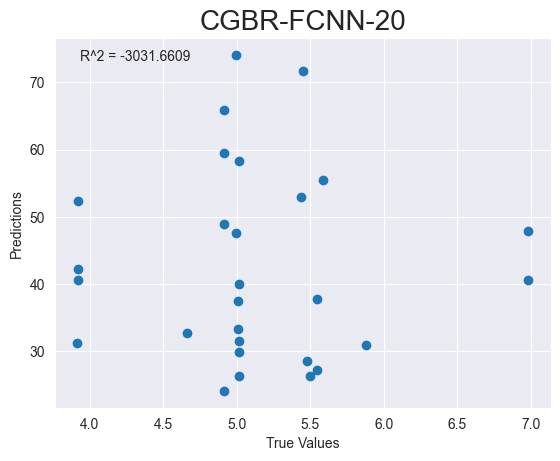

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_324 (Dense)           (None, 128)               384       
                                                                 
 dense_325 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


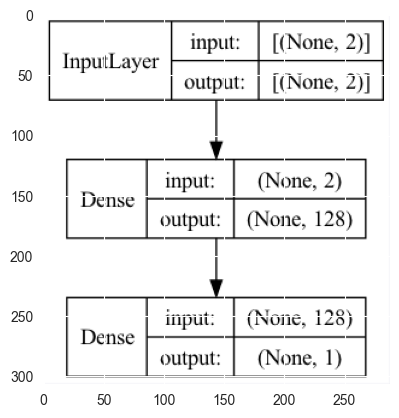

CGBR-DeepSVM-1


2023-05-02 10:14:19.003432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 163ms/step - loss: 648374592.0000 - mse: 648374592.0000 - mae: 24240.5059 - root_mean_squared_error: 25463.2012 - val_loss: 367628608.0000 - val_mse: 367628608.0000 - val_mae: 18319.2637 - val_root_mean_squared_error: 19173.6445


2023-05-02 10:14:19.517714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 51ms/step - loss: 343187616.0000 - mse: 343187616.0000 - mae: 17722.6484 - root_mean_squared_error: 18525.3242
Test loss: [343187616.0, 343187616.0, 17722.6484375, 18525.32421875]
['loss', 'mse', 'mae', 'root_mean_squared_error']


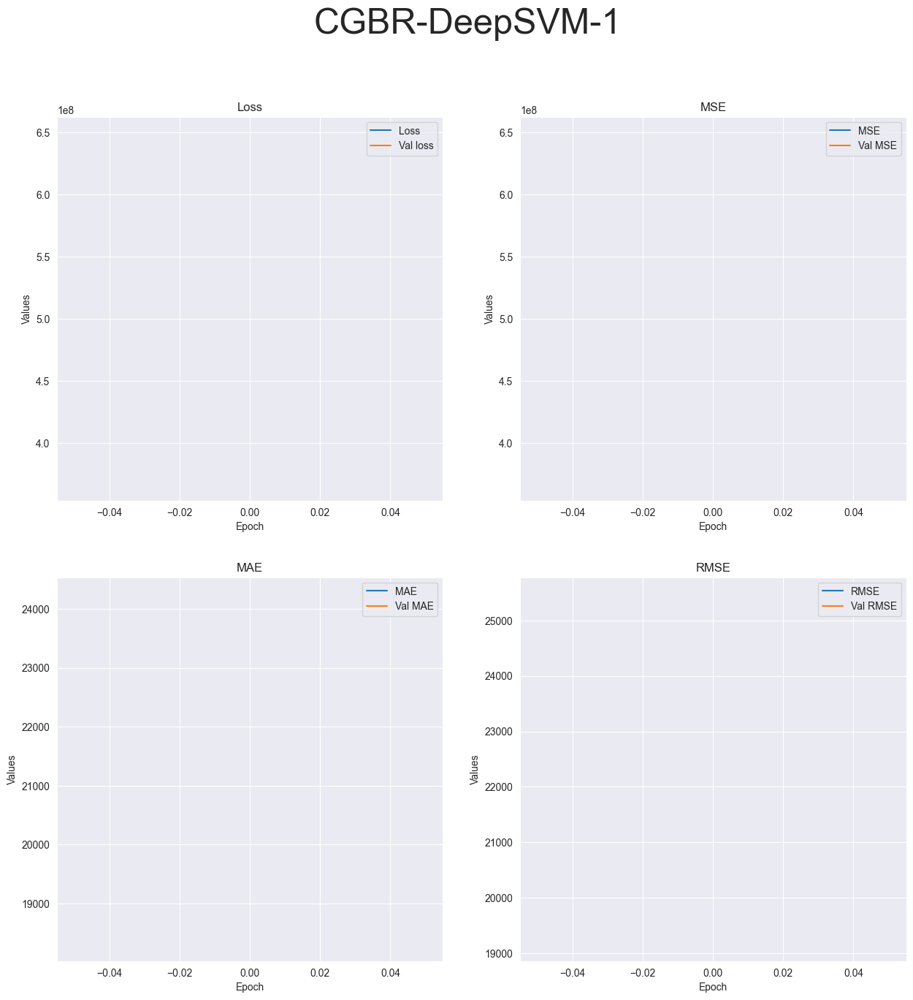

R-squared value: -418208501.7853


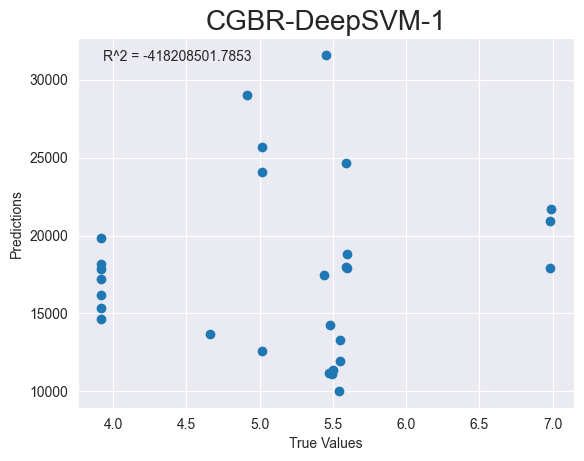

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_326 (Dense)           (None, 128)               384       
                                                                 
 dense_327 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


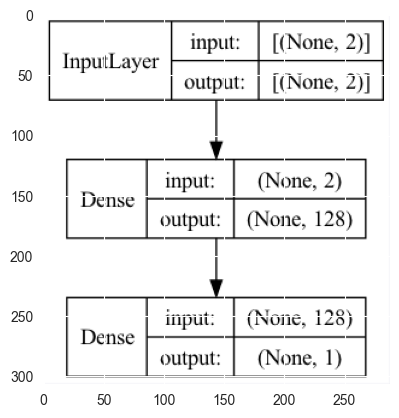

CGBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:21.602387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 209ms/step - loss: 635225920.0000 - mse: 635225920.0000 - mae: 24290.7871 - root_mean_squared_error: 25203.6895 - val_loss: 333567072.0000 - val_mse: 333567072.0000 - val_mae: 17584.3828 - val_root_mean_squared_error: 18263.8184
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 341650336.0000 - mse: 341650336.0000 - mae: 17749.3945 - root_mean_squared_error: 18483.7852

2023-05-02 10:14:22.237199: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 41ms/step - loss: 259014432.0000 - mse: 259014432.0000 - mae: 15367.5264 - root_mean_squared_error: 16093.9258 - val_loss: 126700920.0000 - val_mse: 126700920.0000 - val_mae: 10837.2354 - val_root_mean_squared_error: 11256.1504
Epoch 3/4
3/3 [==============================] - 0s 46ms/step - loss: 96256192.0000 - mse: 96256192.0000 - mae: 9419.2305 - root_mean_squared_error: 9811.0244 - val_loss: 48768992.0000 - val_mse: 48768992.0000 - val_mae: 6723.4155 - val_root_mean_squared_error: 6983.4800
Epoch 4/4
1/1 [==============================] - 0s 47ms/step - loss: 19656900.0000 - mse: 19656900.0000 - mae: 4217.6870 - root_mean_squared_error: 4433.6104
Test loss: [19656900.0, 19656900.0, 4217.68701171875, 4433.6103515625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


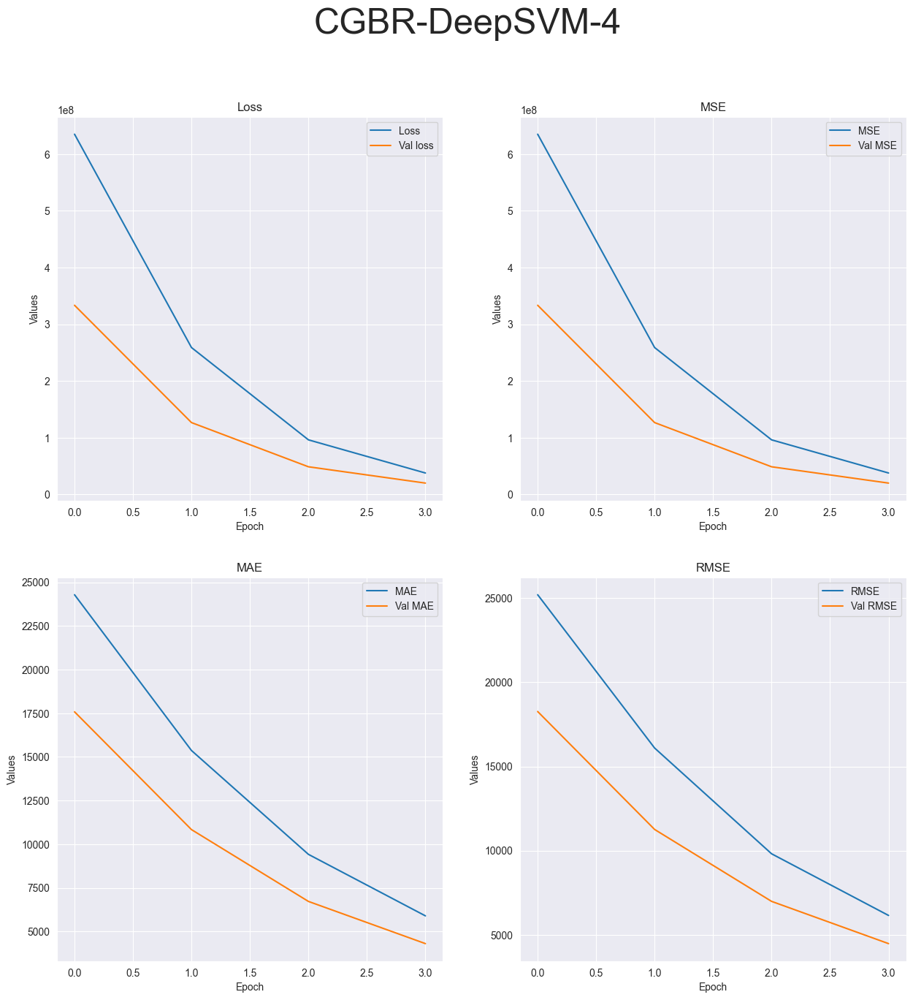

R-squared value: -62441129.7023


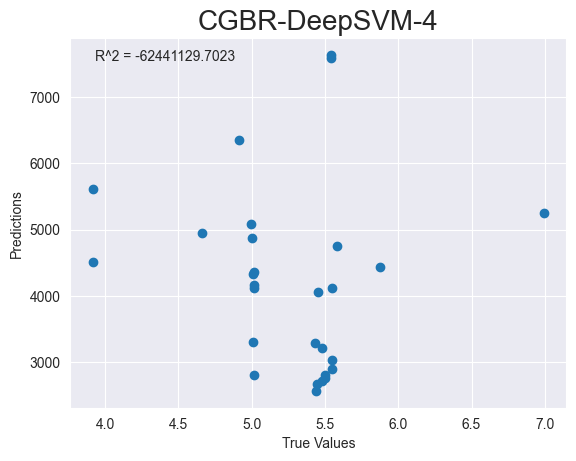

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_328 (Dense)           (None, 128)               384       
                                                                 
 dense_329 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


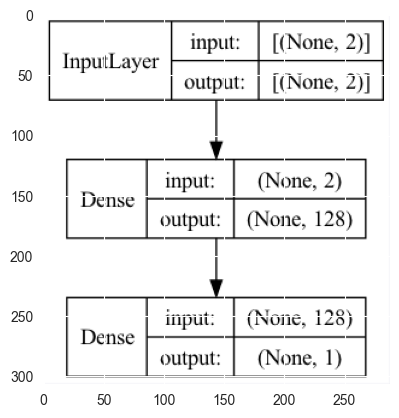

CGBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:14:24.074577: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 153ms/step - loss: 652701760.0000 - mse: 652701760.0000 - mae: 24441.7637 - root_mean_squared_error: 25548.0293 - val_loss: 342012512.0000 - val_mse: 342012512.0000 - val_mae: 17967.2969 - val_root_mean_squared_error: 18493.5801
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 347420480.0000 - mse: 347420480.0000 - mae: 17670.9727 - root_mean_squared_error: 18639.2188

2023-05-02 10:14:24.530709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 43ms/step - loss: 266695392.0000 - mse: 266695392.0000 - mae: 15508.0576 - root_mean_squared_error: 16330.8115 - val_loss: 130994320.0000 - val_mse: 130994320.0000 - val_mae: 11119.4297 - val_root_mean_squared_error: 11445.2754
Epoch 3/10
3/3 [==============================] - 0s 33ms/step - loss: 100132648.0000 - mse: 100132648.0000 - mae: 9553.6602 - root_mean_squared_error: 10006.6299 - val_loss: 50799800.0000 - val_mse: 50799800.0000 - val_mae: 6924.3501 - val_root_mean_squared_error: 7127.3979
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 40202672.0000 - mse: 40202672.0000 - mae: 6023.3945 - root_mean_squared_error: 6340.5576 - val_loss: 20907364.0000 - val_mse: 20907364.0000 - val_mae: 4442.0776 - val_root_mean_squared_error: 4572.4570
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 17280392.0000 - mse: 17280392.0000 - mae: 3928.6790 - root_mean_squared_error: 4156.9692 - val_loss: 9657933.0

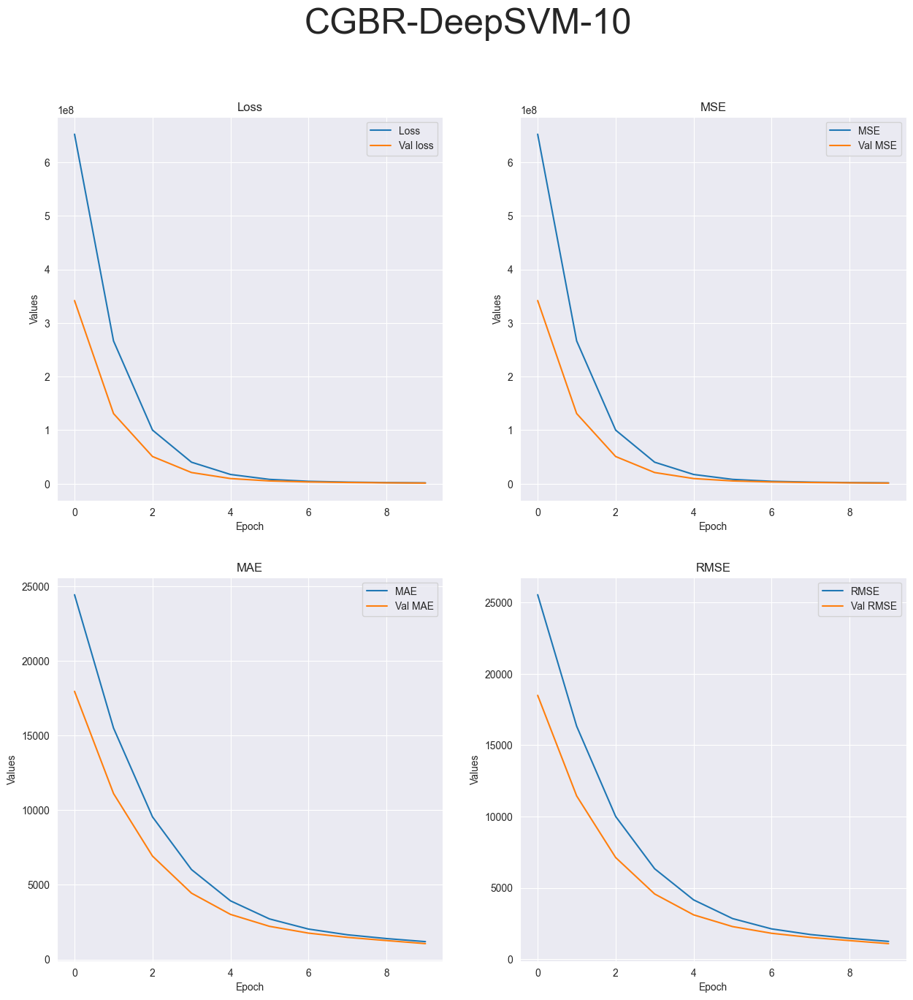

R-squared value: -2598875.6519


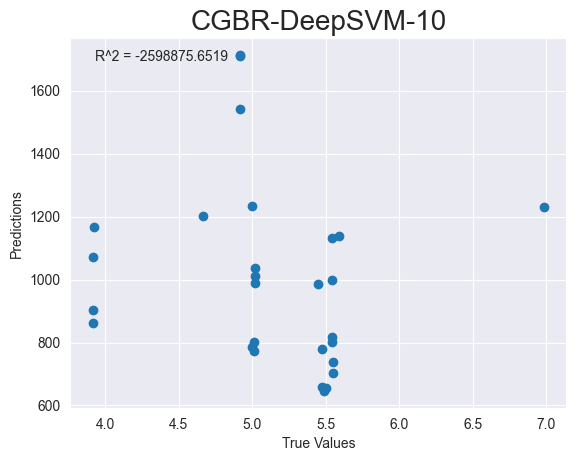

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_330 (Dense)           (None, 128)               384       
                                                                 
 dense_331 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


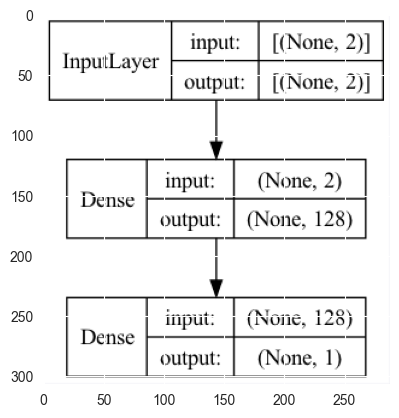

CGBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:14:26.739552: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 194ms/step - loss: 639099712.0000 - mse: 639099712.0000 - mae: 24079.6426 - root_mean_squared_error: 25280.4219 - val_loss: 339436000.0000 - val_mse: 339436000.0000 - val_mae: 17909.3828 - val_root_mean_squared_error: 18423.7891
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 338121760.0000 - mse: 338121760.0000 - mae: 17792.8203 - root_mean_squared_error: 18388.0879

2023-05-02 10:14:27.326920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 21ms/step - loss: 258347312.0000 - mse: 258347312.0000 - mae: 15322.3613 - root_mean_squared_error: 16073.1865 - val_loss: 132754496.0000 - val_mse: 132754496.0000 - val_mae: 11200.0908 - val_root_mean_squared_error: 11521.9141
Epoch 3/20
3/3 [==============================] - 0s 42ms/step - loss: 100334072.0000 - mse: 100334072.0000 - mae: 9547.2832 - root_mean_squared_error: 10016.6895 - val_loss: 52032256.0000 - val_mse: 52032256.0000 - val_mae: 7011.7451 - val_root_mean_squared_error: 7213.3389
Epoch 4/20
3/3 [==============================] - 0s 27ms/step - loss: 40190504.0000 - mse: 40190504.0000 - mae: 6033.7832 - root_mean_squared_error: 6339.5981 - val_loss: 21578740.0000 - val_mse: 21578740.0000 - val_mae: 4515.3647 - val_root_mean_squared_error: 4645.2925
Epoch 5/20
3/3 [==============================] - 0s 28ms/step - loss: 16723177.0000 - mse: 16723177.0000 - mae: 3921.4568 - root_mean_squared_error: 4089.3982 - val_loss: 10014250.

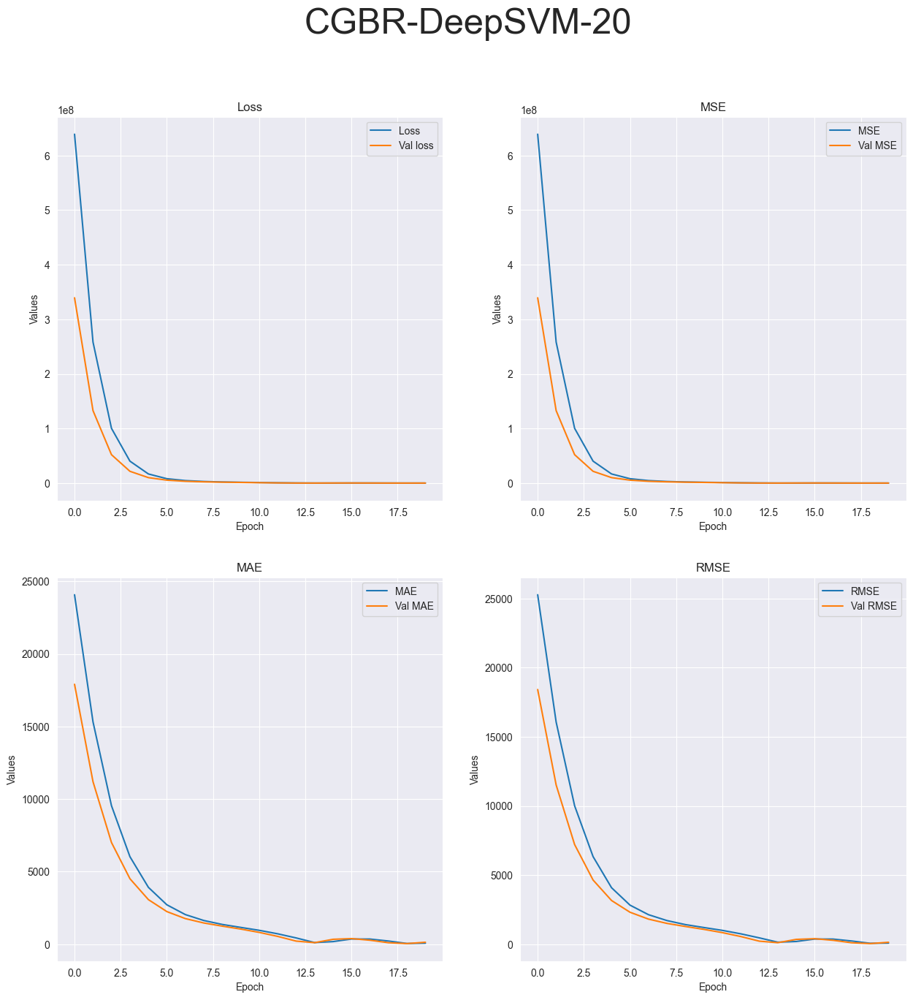

R-squared value: -64949.5615


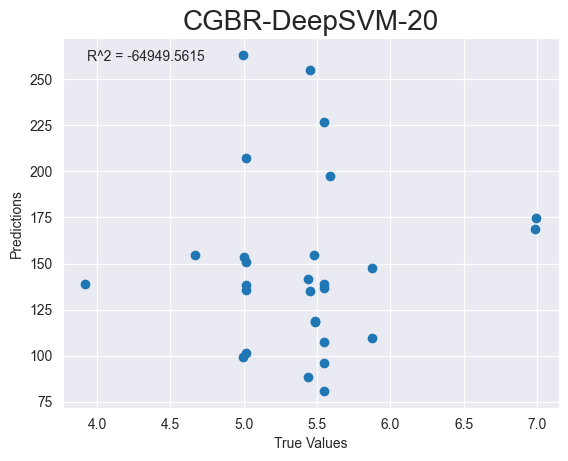

Running tests on FBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_332 (Dense)           (None, 64)                512       
                                                                 
 dropout_74 (Dropout)        (None, 64)                0         
                                                                 
 dense_333 (Dense)           (None, 32)                2080      
                                                                 
 dropout_75 (Dropout)        (None, 32)           

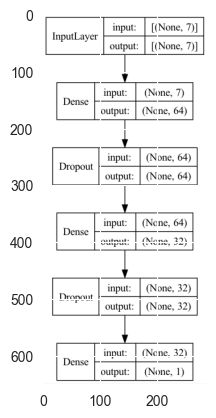

FBR-MLP-1


2023-05-02 10:14:29.885525: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 244ms/step - loss: 32.0309 - mse: 32.0309 - mae: 4.2104 - root_mean_squared_error: 5.6596 - val_loss: 4.9254 - val_mse: 4.9254 - val_mae: 2.0531 - val_root_mean_squared_error: 2.2193


2023-05-02 10:14:30.673354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 112ms/step - loss: 5.2438 - mse: 5.2438 - mae: 2.0209 - root_mean_squared_error: 2.2899
Test loss: [5.243805885314941, 5.243805885314941, 2.0209381580352783, 2.289935827255249]
['loss', 'mse', 'mae', 'root_mean_squared_error']


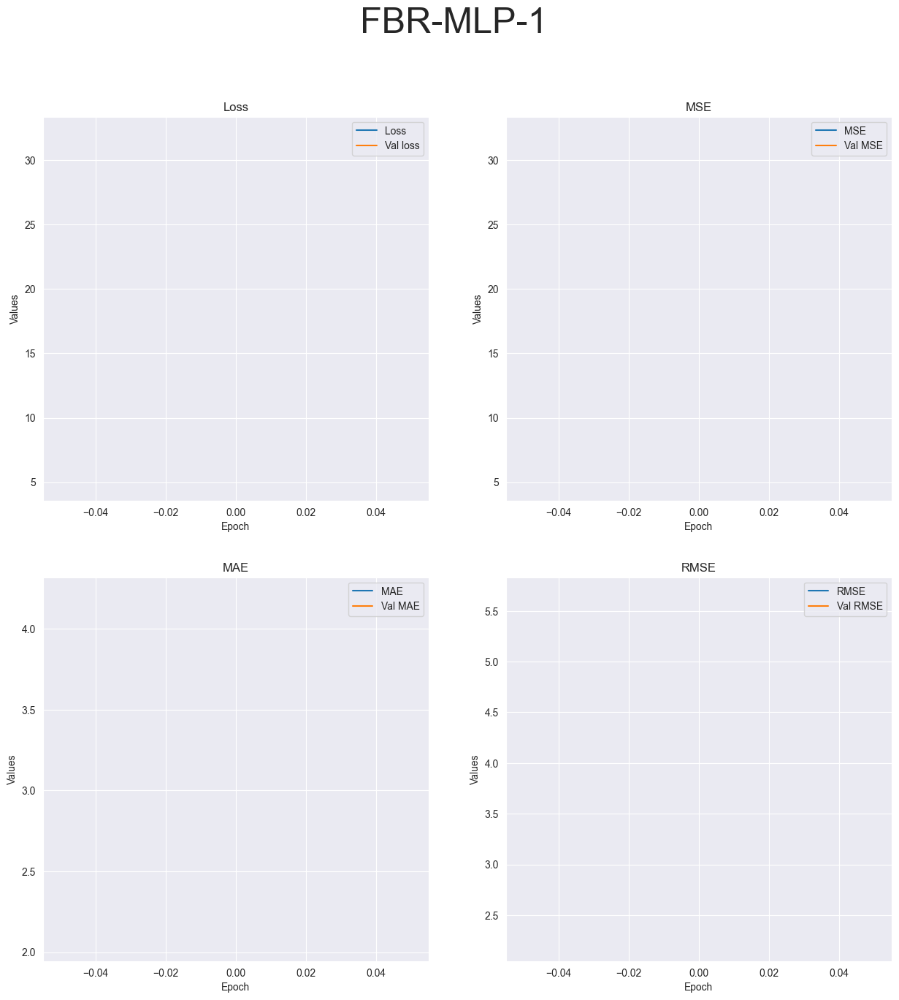

R-squared value: -9.1571


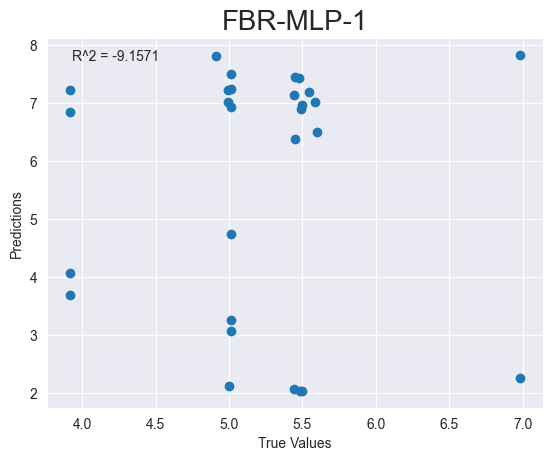

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_335 (Dense)           (None, 64)                512       
                                                                 
 dropout_76 (Dropout)        (None, 64)                0         
                                                                 
 dense_336 (Dense)           (None, 32)                2080      
                                                                 
 dropout_77 (Dropout)        (None, 32)                0         
                                               

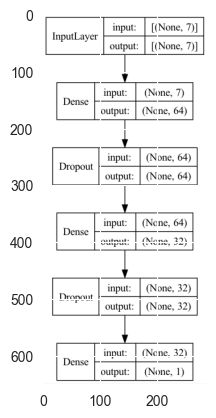

FBR-MLP-4
Epoch 1/4


2023-05-02 10:14:32.872409: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 255ms/step - loss: 21.5323 - mse: 21.5323 - mae: 3.7365 - root_mean_squared_error: 4.6403 - val_loss: 3.7175 - val_mse: 3.7175 - val_mae: 1.5622 - val_root_mean_squared_error: 1.9281
Epoch 2/4


2023-05-02 10:14:33.965234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 12.2608 - mse: 12.2608 - mae: 2.8379 - root_mean_squared_error: 3.5015 - val_loss: 4.0169 - val_mse: 4.0169 - val_mae: 1.8556 - val_root_mean_squared_error: 2.0042
Epoch 3/4
3/3 [==============================] - 0s 33ms/step - loss: 5.3789 - mse: 5.3789 - mae: 1.8792 - root_mean_squared_error: 2.3192 - val_loss: 2.0763 - val_mse: 2.0763 - val_mae: 1.0990 - val_root_mean_squared_error: 1.4409
Epoch 4/4
1/1 [==============================] - 0s 73ms/step - loss: 1.3583 - mse: 1.3583 - mae: 0.9417 - root_mean_squared_error: 1.1655
Test loss: [1.35833740234375, 1.35833740234375, 0.9417212605476379, 1.1654772758483887]
['loss', 'mse', 'mae', 'root_mean_squared_error']


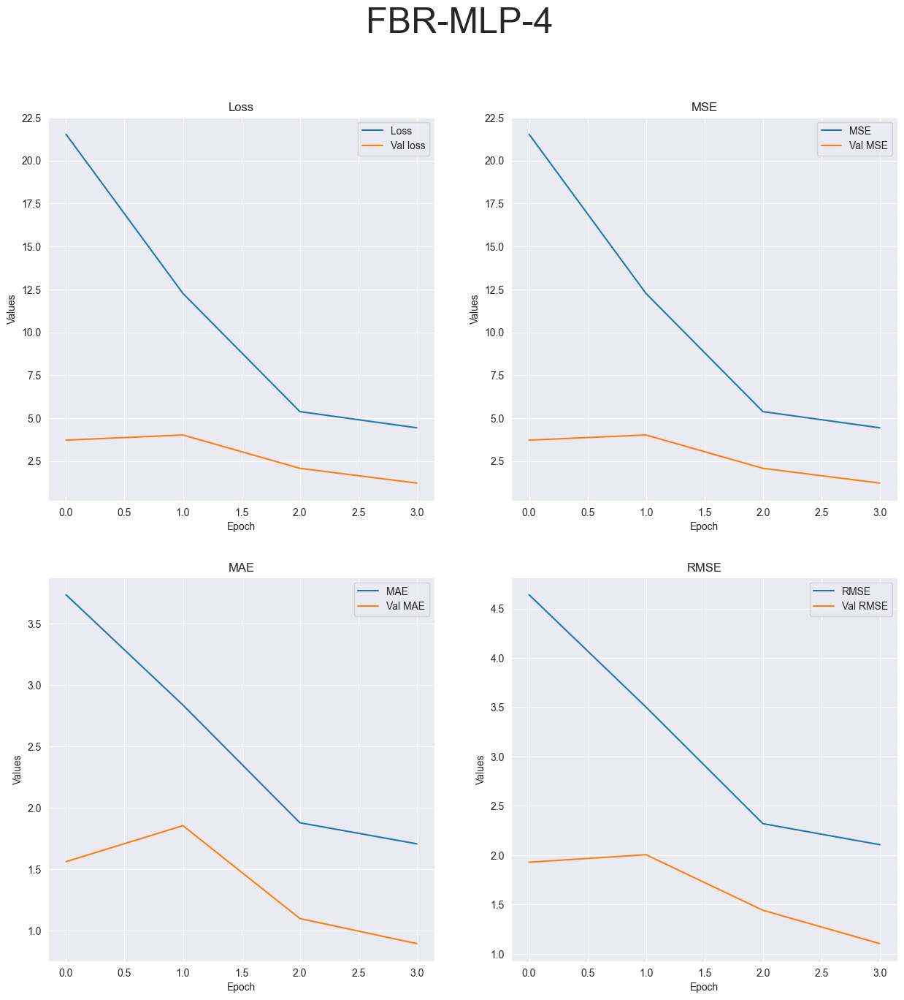

R-squared value: -2.2126


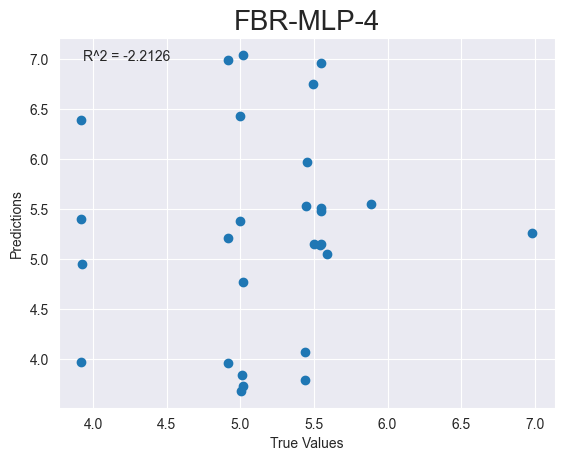

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_338 (Dense)           (None, 64)                512       
                                                                 
 dropout_78 (Dropout)        (None, 64)                0         
                                                                 
 dense_339 (Dense)           (None, 32)                2080      
                                                                 
 dropout_79 (Dropout)        (None, 32)                0         
                                              

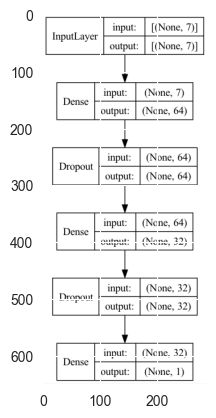

FBR-MLP-10
Epoch 1/10


2023-05-02 10:14:35.705836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 298ms/step - loss: 24.8167 - mse: 24.8167 - mae: 4.1503 - root_mean_squared_error: 4.9816 - val_loss: 9.6615 - val_mse: 9.6615 - val_mae: 2.7035 - val_root_mean_squared_error: 3.1083
Epoch 2/10


2023-05-02 10:14:36.650037: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 12.9072 - mse: 12.9072 - mae: 2.8458 - root_mean_squared_error: 3.5927 - val_loss: 1.1824 - val_mse: 1.1824 - val_mae: 0.8311 - val_root_mean_squared_error: 1.0874
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 5.1126 - mse: 5.1126 - mae: 1.8448 - root_mean_squared_error: 2.2611 - val_loss: 2.3613 - val_mse: 2.3613 - val_mae: 1.3282 - val_root_mean_squared_error: 1.5366
Epoch 4/10
3/3 [==============================] - 0s 27ms/step - loss: 4.0556 - mse: 4.0556 - mae: 1.6842 - root_mean_squared_error: 2.0139 - val_loss: 1.3349 - val_mse: 1.3349 - val_mae: 0.9993 - val_root_mean_squared_error: 1.1554
Epoch 5/10
3/3 [==============================] - 0s 19ms/step - loss: 3.1254 - mse: 3.1254 - mae: 1.3900 - root_mean_squared_error: 1.7679 - val_loss: 0.9880 - val_mse: 0.9880 - val_mae: 0.8853 - val_root_mean_squared_error: 0.9940
Epoch 6/10
3/3 [==============================] - 0s 22ms/step - loss: 2.4728

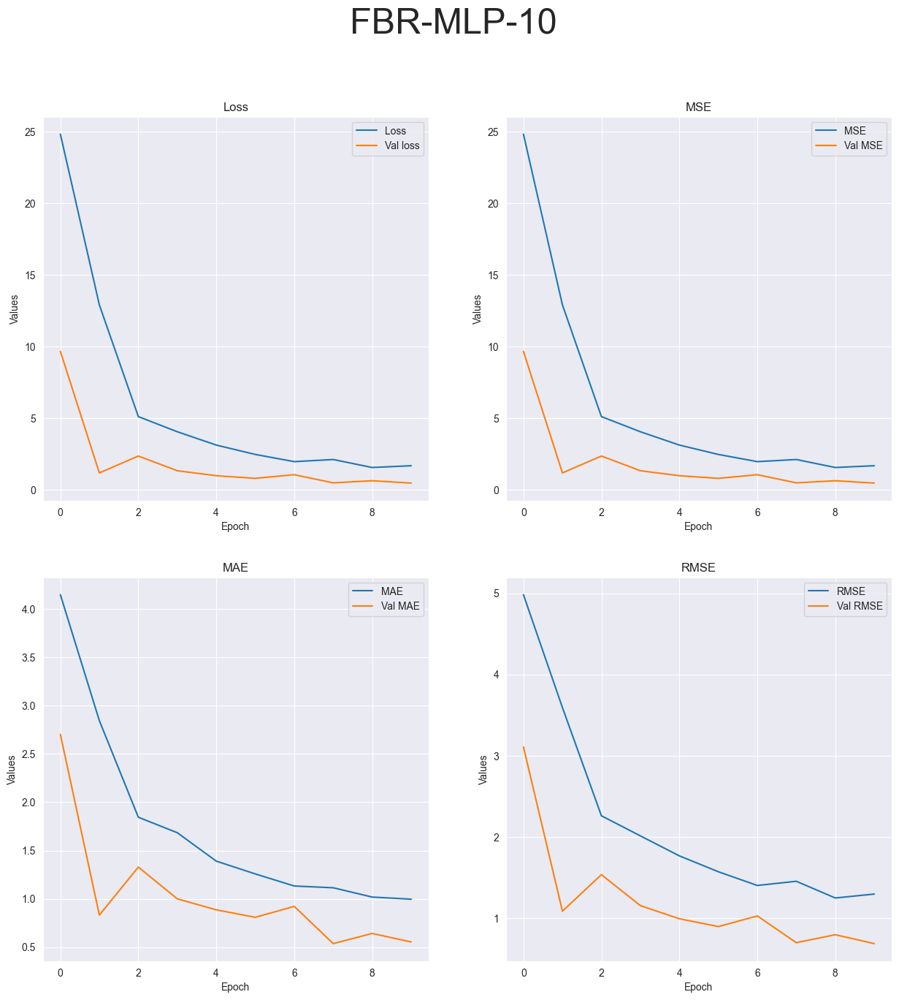

R-squared value: -1.0710


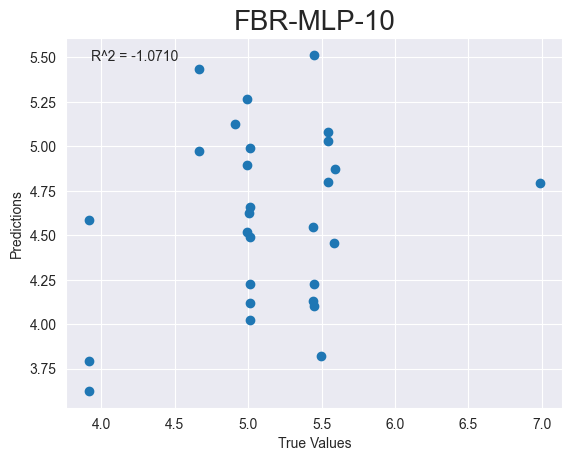

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_341 (Dense)           (None, 64)                512       
                                                                 
 dropout_80 (Dropout)        (None, 64)                0         
                                                                 
 dense_342 (Dense)           (None, 32)                2080      
                                                                 
 dropout_81 (Dropout)        (None, 32)                0         
                                              

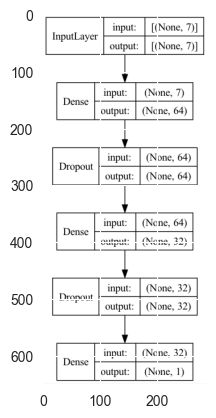

FBR-MLP-20
Epoch 1/20


2023-05-02 10:14:38.690727: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 226ms/step - loss: 22.6884 - mse: 22.6884 - mae: 3.6988 - root_mean_squared_error: 4.7632 - val_loss: 7.5359 - val_mse: 7.5359 - val_mae: 2.5560 - val_root_mean_squared_error: 2.7452
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 11.8493 - mse: 11.8493 - mae: 2.7677 - root_mean_squared_error: 3.4423

2023-05-02 10:14:39.515707: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 81ms/step - loss: 11.0443 - mse: 11.0443 - mae: 2.7611 - root_mean_squared_error: 3.3233 - val_loss: 2.2410 - val_mse: 2.2410 - val_mae: 1.0822 - val_root_mean_squared_error: 1.4970
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 6.6899 - mse: 6.6899 - mae: 2.1364 - root_mean_squared_error: 2.5865 - val_loss: 3.0585 - val_mse: 3.0585 - val_mae: 1.6357 - val_root_mean_squared_error: 1.7489
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 4.2040 - mse: 4.2040 - mae: 1.6353 - root_mean_squared_error: 2.0504 - val_loss: 1.0980 - val_mse: 1.0980 - val_mae: 0.9592 - val_root_mean_squared_error: 1.0479
Epoch 5/20
3/3 [==============================] - 0s 40ms/step - loss: 3.8028 - mse: 3.8028 - mae: 1.5530 - root_mean_squared_error: 1.9501 - val_loss: 0.9863 - val_mse: 0.9863 - val_mae: 0.7696 - val_root_mean_squared_error: 0.9931
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 2.9836

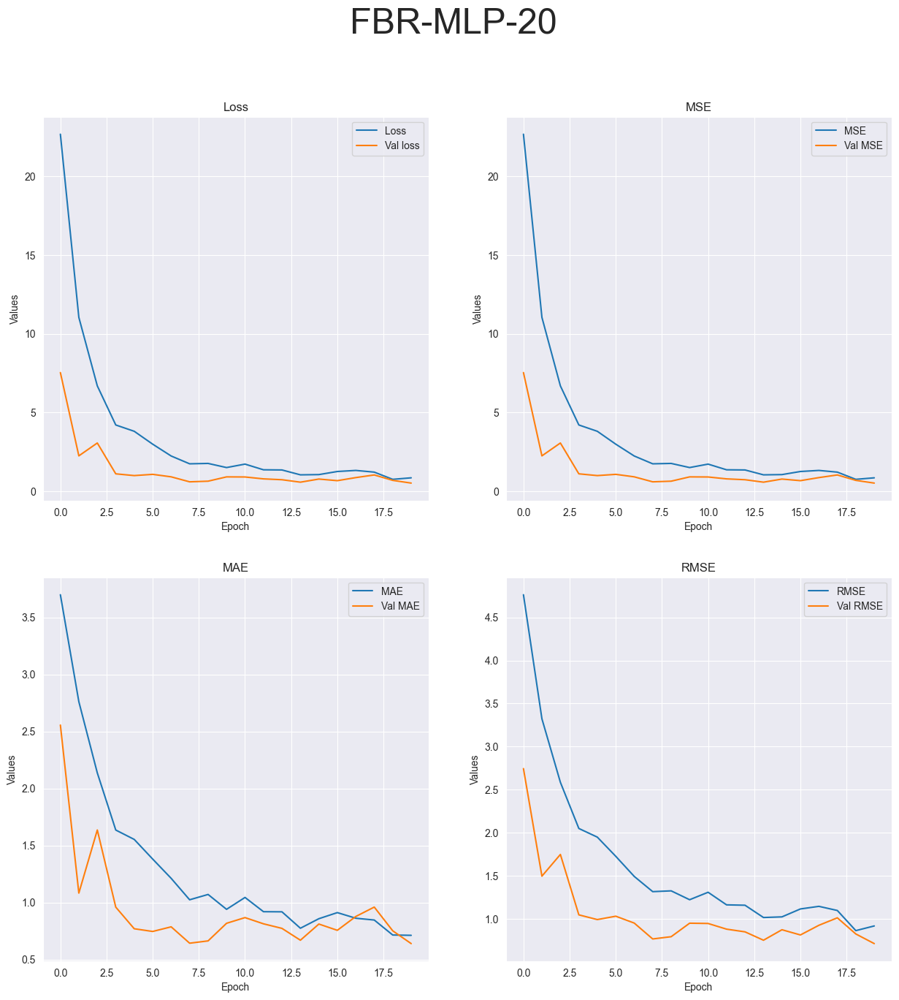

R-squared value: -0.7856


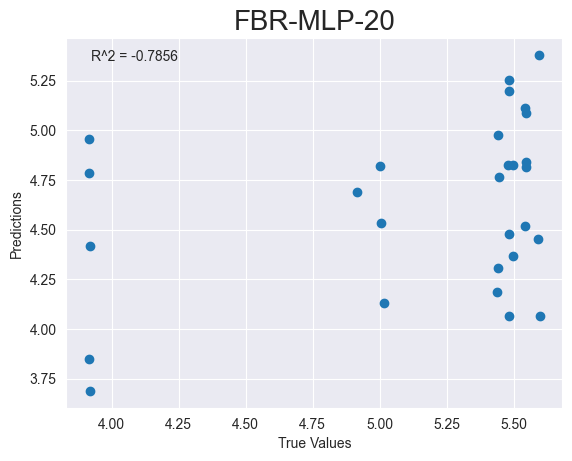

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_344 (Dense)           (None, 64)                512       
                                                                 
 dense_345 (Dense)           (None, 32)                2080      
                                                                 
 dense_346 (Dense)           (None, 16)                528       
                                                                 
 dense_347 (Dense)           (None, 1)                 17        
                   

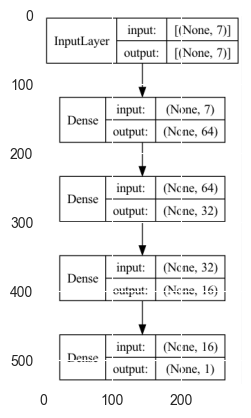

FBR-FCNN-1


2023-05-02 10:14:42.335499: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 236ms/step - loss: 28.5961 - mse: 28.5961 - mae: 4.7138 - root_mean_squared_error: 5.3475 - val_loss: 2.0503 - val_mse: 2.0503 - val_mae: 1.0778 - val_root_mean_squared_error: 1.4319


2023-05-02 10:14:43.114159: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 63ms/step - loss: 3.6836 - mse: 3.6836 - mae: 1.6908 - root_mean_squared_error: 1.9193
Test loss: [3.683612823486328, 3.683612823486328, 1.6908342838287354, 1.919274091720581]
['loss', 'mse', 'mae', 'root_mean_squared_error']


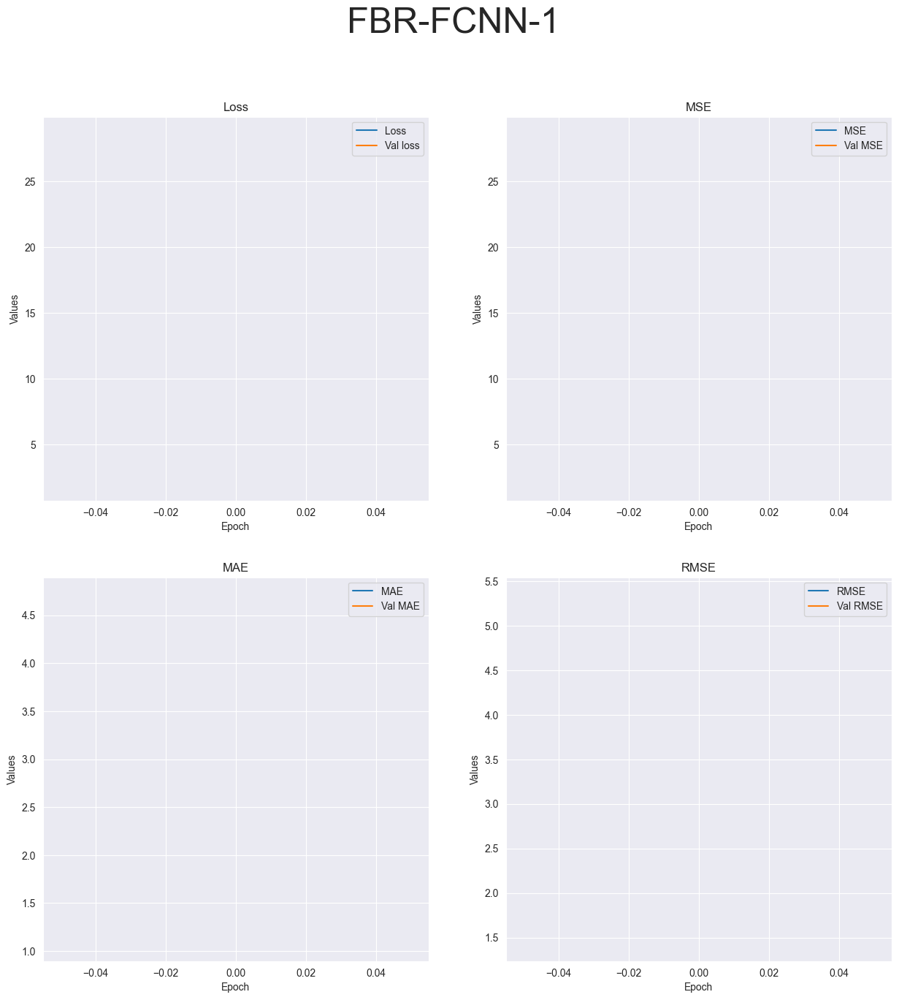

R-squared value: -6.7780


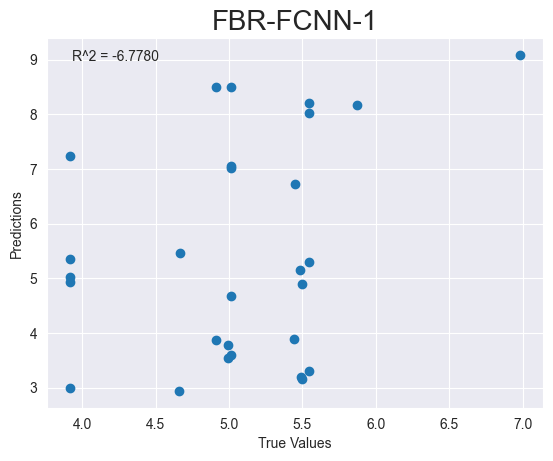

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_348 (Dense)           (None, 64)                512       
                                                                 
 dense_349 (Dense)           (None, 32)                2080      
                                                                 
 dense_350 (Dense)           (None, 16)                528       
                                                                 
 dense_351 (Dense)           (None, 1)                 17        
                                               

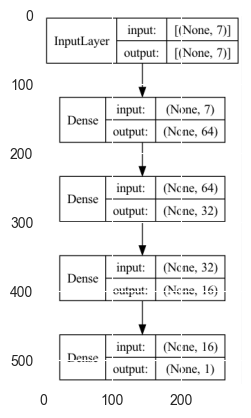

FBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:45.305379: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 230ms/step - loss: 32.1392 - mse: 32.1392 - mae: 4.8628 - root_mean_squared_error: 5.6691 - val_loss: 1.9927 - val_mse: 1.9927 - val_mae: 1.1531 - val_root_mean_squared_error: 1.4116
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 2.7897 - mse: 2.7897 - mae: 1.3901 - root_mean_squared_error: 1.6702

2023-05-02 10:14:46.044043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 37ms/step - loss: 5.6133 - mse: 5.6133 - mae: 2.0771 - root_mean_squared_error: 2.3692 - val_loss: 7.1326 - val_mse: 7.1326 - val_mae: 2.1708 - val_root_mean_squared_error: 2.6707
Epoch 3/4
3/3 [==============================] - 0s 64ms/step - loss: 5.8842 - mse: 5.8842 - mae: 2.0508 - root_mean_squared_error: 2.4257 - val_loss: 2.6699 - val_mse: 2.6699 - val_mae: 1.3062 - val_root_mean_squared_error: 1.6340
Epoch 4/4
1/1 [==============================] - 0s 88ms/step - loss: 1.5042 - mse: 1.5042 - mae: 1.0185 - root_mean_squared_error: 1.2265
Test loss: [1.504243016242981, 1.504243016242981, 1.0184556245803833, 1.2264758348464966]
['loss', 'mse', 'mae', 'root_mean_squared_error']


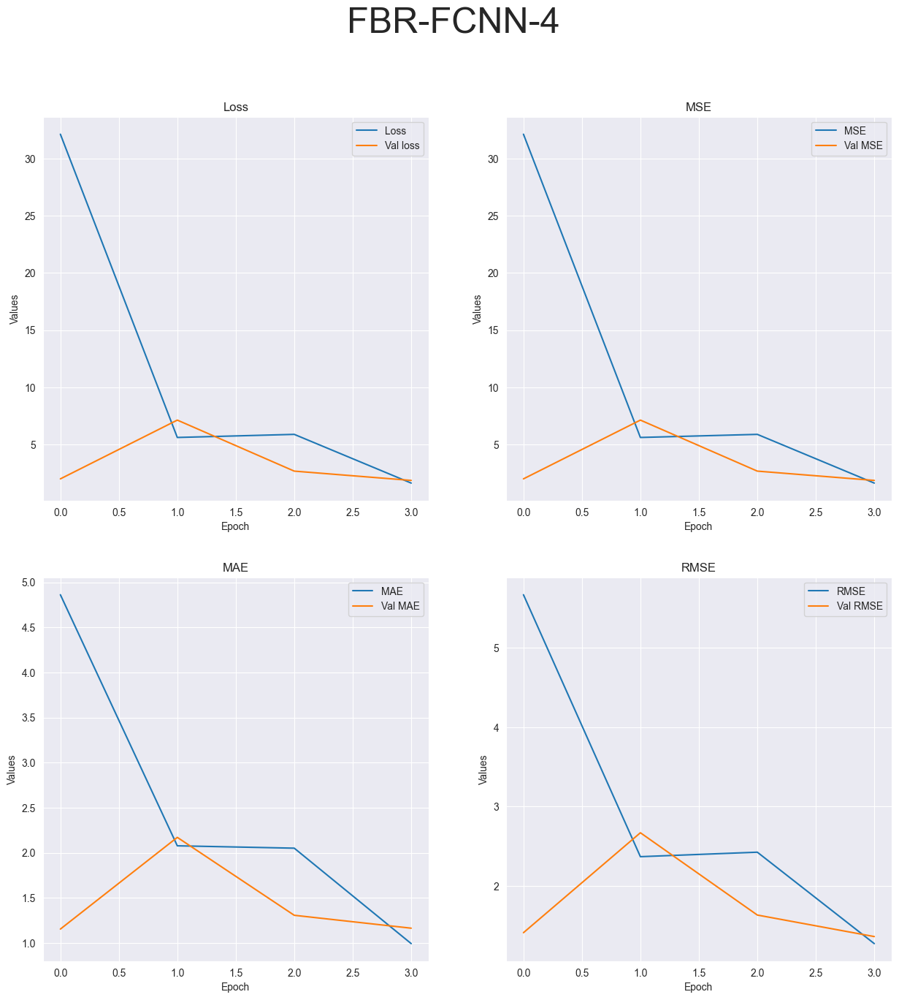

R-squared value: -2.5663


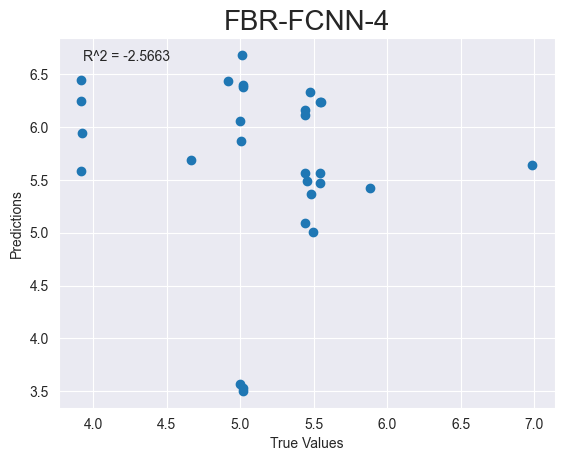

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_352 (Dense)           (None, 64)                512       
                                                                 
 dense_353 (Dense)           (None, 32)                2080      
                                                                 
 dense_354 (Dense)           (None, 16)                528       
                                                                 
 dense_355 (Dense)           (None, 1)                 17        
                                              

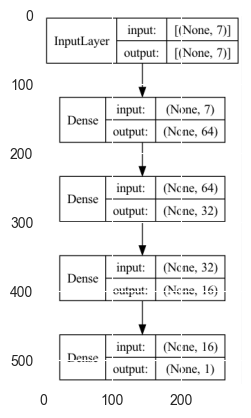

FBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:47.879045: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 204ms/step - loss: 29.5243 - mse: 29.5243 - mae: 4.6581 - root_mean_squared_error: 5.4336 - val_loss: 3.7443 - val_mse: 3.7443 - val_mae: 1.3006 - val_root_mean_squared_error: 1.9350
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 3.4871 - mse: 3.4871 - mae: 1.1986 - root_mean_squared_error: 1.8674

2023-05-02 10:14:48.557882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 59ms/step - loss: 5.0584 - mse: 5.0584 - mae: 1.8289 - root_mean_squared_error: 2.2491 - val_loss: 6.6012 - val_mse: 6.6012 - val_mae: 2.3732 - val_root_mean_squared_error: 2.5693
Epoch 3/10
3/3 [==============================] - 0s 20ms/step - loss: 6.1536 - mse: 6.1536 - mae: 2.2193 - root_mean_squared_error: 2.4806 - val_loss: 2.1227 - val_mse: 2.1227 - val_mae: 1.1758 - val_root_mean_squared_error: 1.4570
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 1.9991 - mse: 1.9991 - mae: 1.0761 - root_mean_squared_error: 1.4139 - val_loss: 3.1343 - val_mse: 3.1343 - val_mae: 1.3647 - val_root_mean_squared_error: 1.7704
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 1.6979 - mse: 1.6979 - mae: 1.0156 - root_mean_squared_error: 1.3030 - val_loss: 1.1539 - val_mse: 1.1539 - val_mae: 0.8649 - val_root_mean_squared_error: 1.0742
Epoch 6/10
3/3 [==============================] - 0s 27ms/step - loss: 0.7796 -

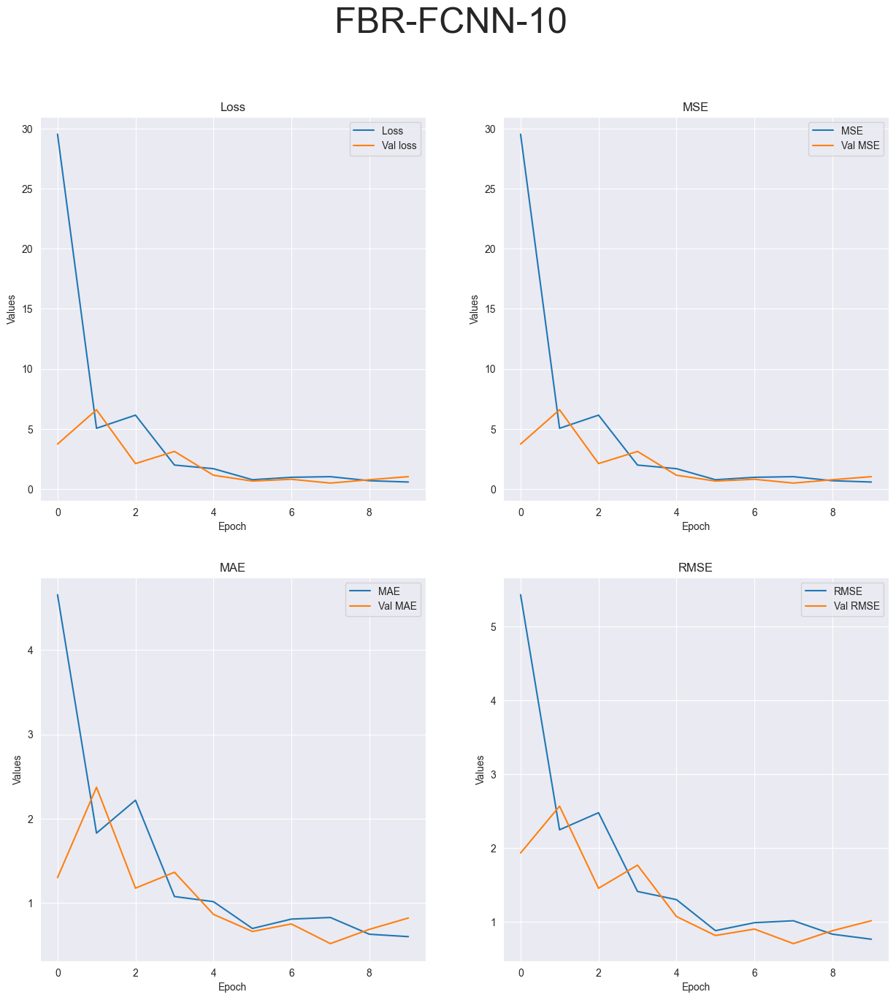

R-squared value: -0.4716


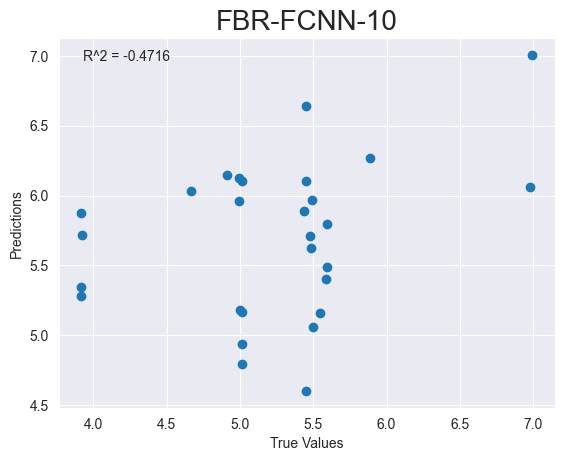

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_356 (Dense)           (None, 64)                512       
                                                                 
 dense_357 (Dense)           (None, 32)                2080      
                                                                 
 dense_358 (Dense)           (None, 16)                528       
                                                                 
 dense_359 (Dense)           (None, 1)                 17        
                                              

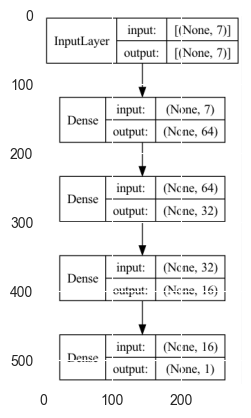

FBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:50.720945: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 33.4494 - mse: 33.4494 - mae: 5.0333 - root_mean_squared_error: 5.7835 - val_loss: 1.1166 - val_mse: 1.1166 - val_mae: 0.9555 - val_root_mean_squared_error: 1.0567
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 1.1296 - mse: 1.1296 - mae: 0.9536 - root_mean_squared_error: 1.0628

2023-05-02 10:14:51.509408: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 105ms/step - loss: 5.2586 - mse: 5.2586 - mae: 1.8986 - root_mean_squared_error: 2.2932 - val_loss: 6.8082 - val_mse: 6.8082 - val_mae: 2.2607 - val_root_mean_squared_error: 2.6093
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 5.7254 - mse: 5.7254 - mae: 1.9969 - root_mean_squared_error: 2.3928 - val_loss: 1.2990 - val_mse: 1.2990 - val_mae: 0.9316 - val_root_mean_squared_error: 1.1397
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 1.3192 - mse: 1.3192 - mae: 0.9187 - root_mean_squared_error: 1.1486 - val_loss: 1.1243 - val_mse: 1.1243 - val_mae: 0.8733 - val_root_mean_squared_error: 1.0603
Epoch 5/20
3/3 [==============================] - 0s 32ms/step - loss: 1.5224 - mse: 1.5224 - mae: 1.0729 - root_mean_squared_error: 1.2339 - val_loss: 0.7127 - val_mse: 0.7127 - val_mae: 0.6690 - val_root_mean_squared_error: 0.8442
Epoch 6/20
3/3 [==============================] - 0s 27ms/step - loss: 0.9632 

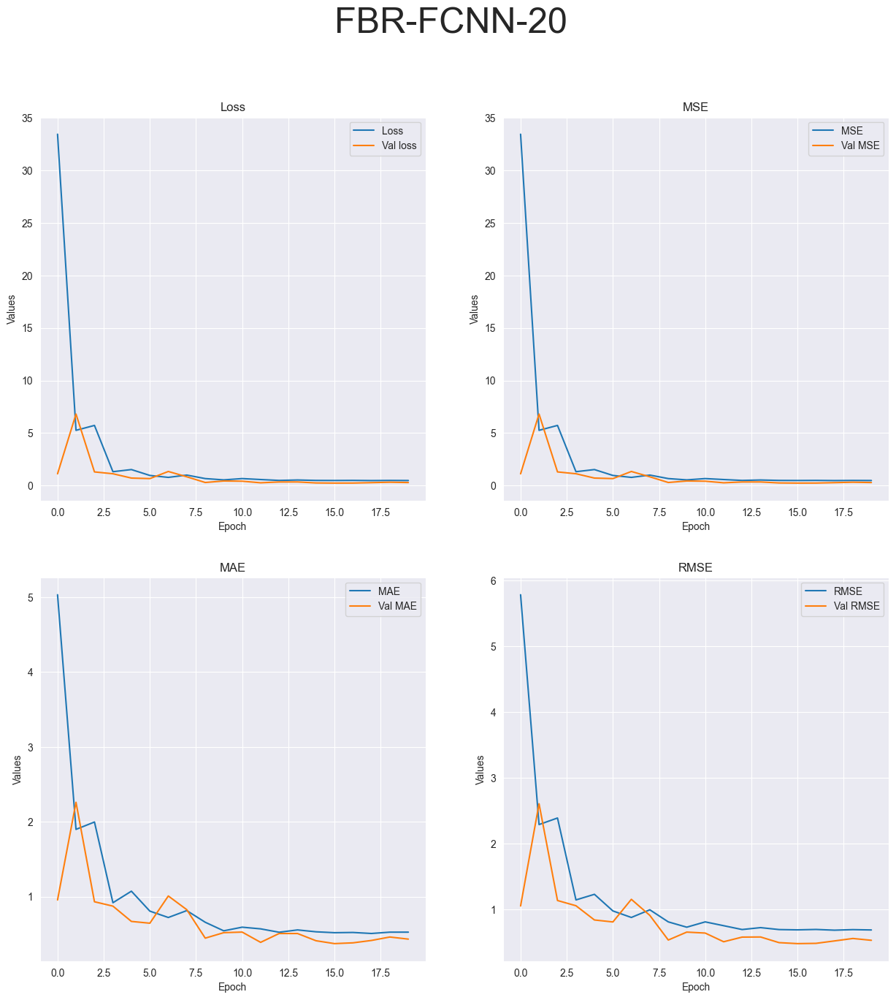

R-squared value: 0.1041


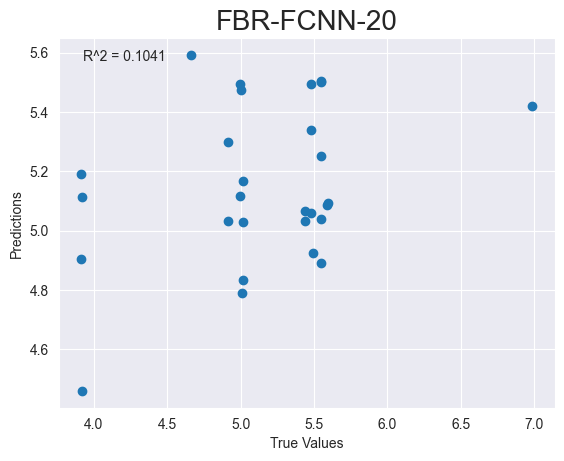

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_360 (Dense)           (None, 128)               1024      
                                                                 
 dense_361 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


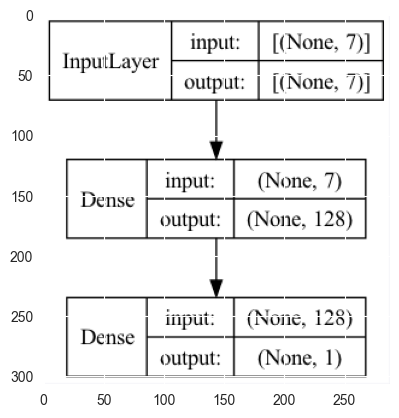

FBR-DeepSVM-1


2023-05-02 10:14:54.338063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 225ms/step - loss: 20.6242 - mse: 20.4889 - mae: 3.7274 - root_mean_squared_error: 4.5265 - val_loss: 4.7996 - val_mse: 4.6659 - val_mae: 1.8354 - val_root_mean_squared_error: 2.1601


2023-05-02 10:14:55.077111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 87ms/step - loss: 5.3515 - mse: 5.2178 - mae: 1.9827 - root_mean_squared_error: 2.2843
Test loss: [5.351540565490723, 5.217797756195068, 1.982715368270874, 2.284250020980835]
['loss', 'mse', 'mae', 'root_mean_squared_error']


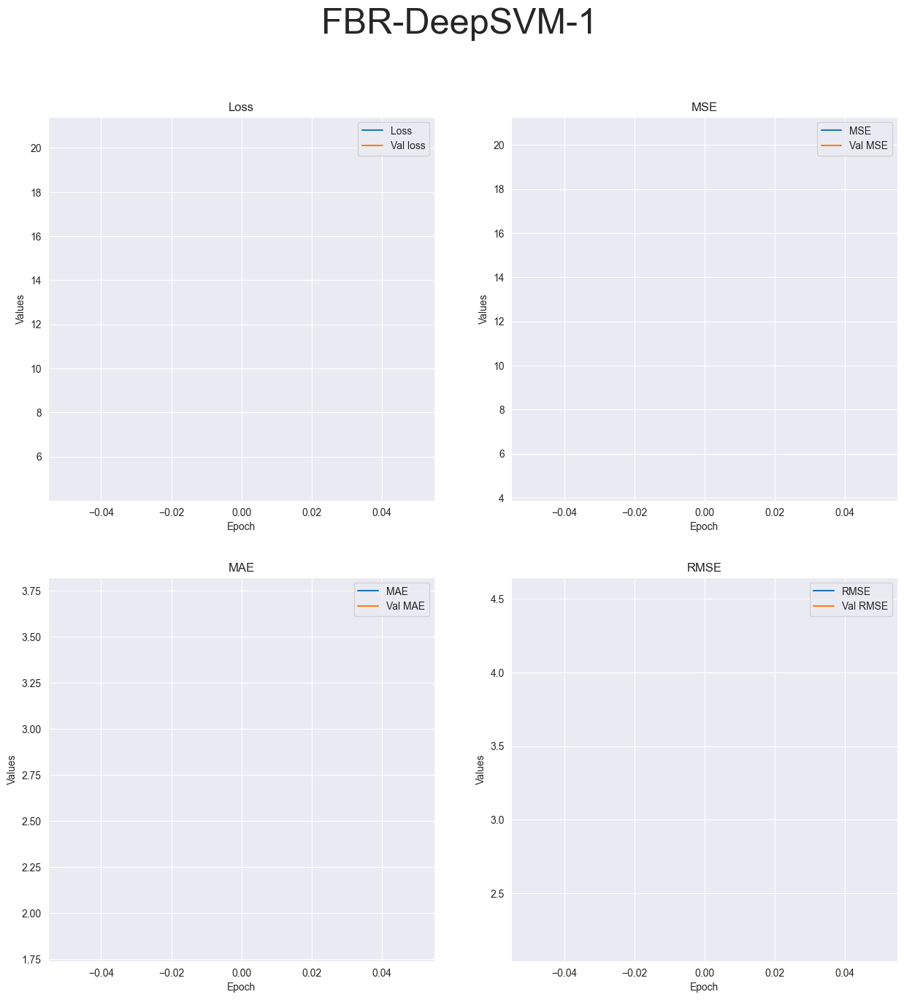

R-squared value: -7.0711


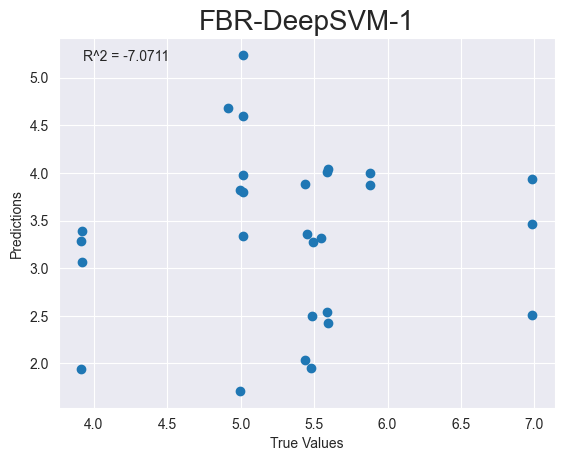

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_362 (Dense)           (None, 128)               1024      
                                                                 
 dense_363 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


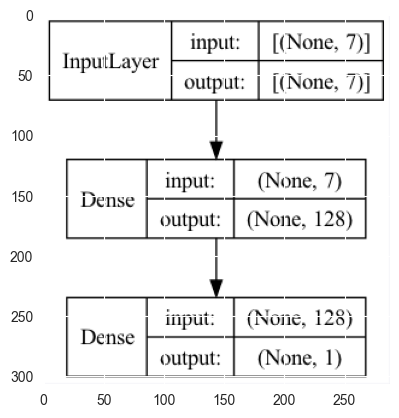

FBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:57.324110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 230ms/step - loss: 22.3093 - mse: 22.1737 - mae: 4.0545 - root_mean_squared_error: 4.7089 - val_loss: 7.4561 - val_mse: 7.3211 - val_mae: 2.2335 - val_root_mean_squared_error: 2.7058
Epoch 2/4


2023-05-02 10:14:58.304056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 9.8224 - mse: 9.6885 - mae: 2.4759 - root_mean_squared_error: 3.1126 - val_loss: 18.6034 - val_mse: 18.4709 - val_mae: 3.7913 - val_root_mean_squared_error: 4.2978
Epoch 3/4
3/3 [==============================] - 0s 29ms/step - loss: 8.4048 - mse: 8.2723 - mae: 2.1322 - root_mean_squared_error: 2.8762 - val_loss: 7.1144 - val_mse: 6.9813 - val_mae: 2.3600 - val_root_mean_squared_error: 2.6422
Epoch 4/4
1/1 [==============================] - 0s 67ms/step - loss: 5.2448 - mse: 5.1128 - mae: 1.9283 - root_mean_squared_error: 2.2612
Test loss: [5.244844913482666, 5.112817287445068, 1.9282782077789307, 2.2611539363861084]
['loss', 'mse', 'mae', 'root_mean_squared_error']


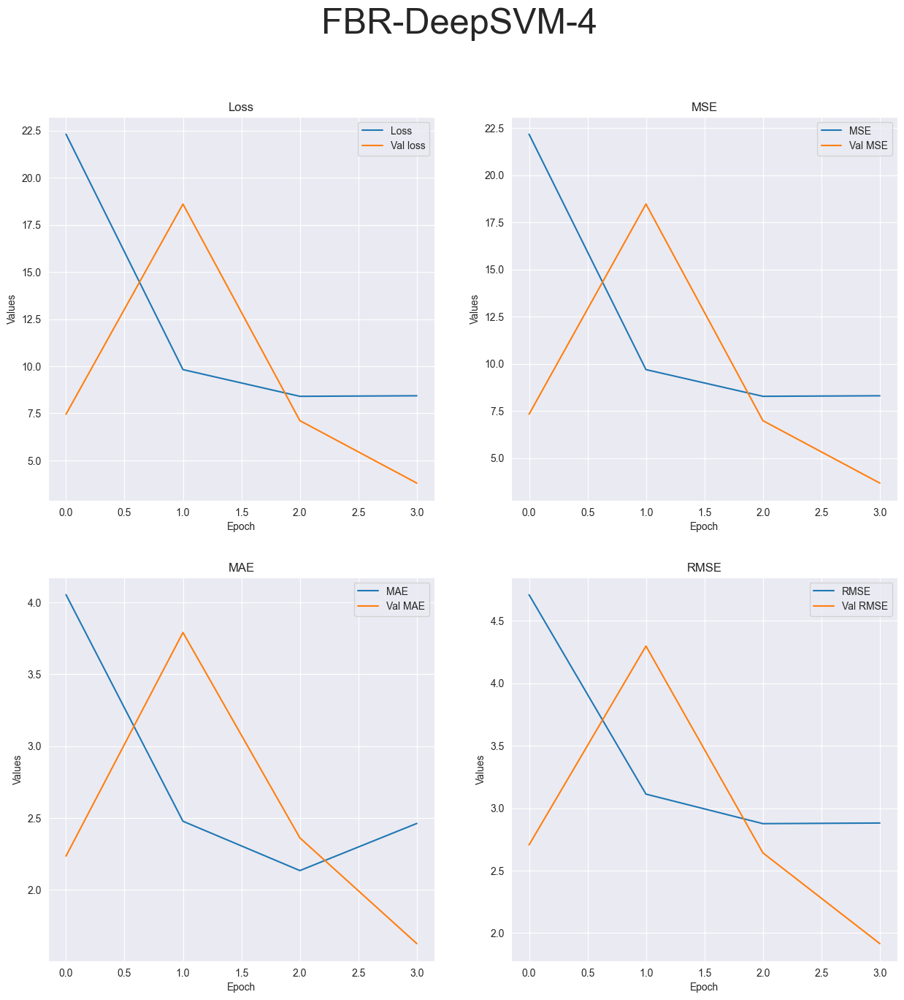

R-squared value: -6.1884


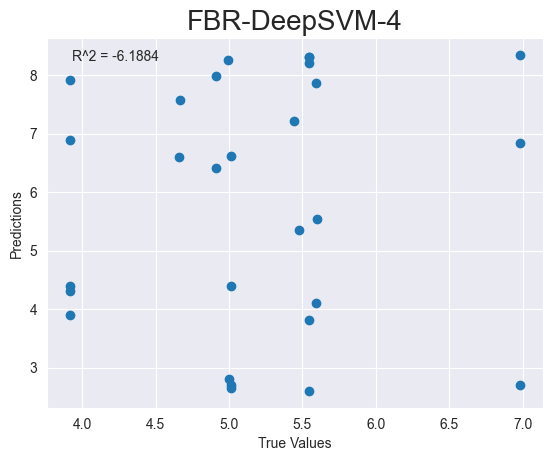

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_364 (Dense)           (None, 128)               1024      
                                                                 
 dense_365 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


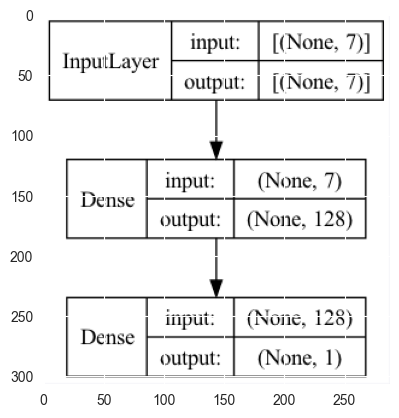

FBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:00.158529: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 26.0199 - mse: 25.8843 - mae: 4.3210 - root_mean_squared_error: 5.0877 - val_loss: 14.4097 - val_mse: 14.2745 - val_mae: 3.5357 - val_root_mean_squared_error: 3.7782
Epoch 2/10


2023-05-02 10:15:00.785093: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 7.8753 - mse: 7.7412 - mae: 2.2532 - root_mean_squared_error: 2.7823 - val_loss: 20.8989 - val_mse: 20.7663 - val_mae: 3.9341 - val_root_mean_squared_error: 4.5570
Epoch 3/10
3/3 [==============================] - 0s 19ms/step - loss: 12.1172 - mse: 11.9846 - mae: 2.7405 - root_mean_squared_error: 3.4619 - val_loss: 1.3642 - val_mse: 1.2312 - val_mae: 0.8868 - val_root_mean_squared_error: 1.1096
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 5.7825 - mse: 5.6494 - mae: 1.8255 - root_mean_squared_error: 2.3768 - val_loss: 10.3697 - val_mse: 10.2370 - val_mae: 2.8550 - val_root_mean_squared_error: 3.1995
Epoch 5/10
3/3 [==============================] - 0s 36ms/step - loss: 5.1152 - mse: 4.9832 - mae: 1.8020 - root_mean_squared_error: 2.2323 - val_loss: 1.4033 - val_mse: 1.2725 - val_mae: 1.0077 - val_root_mean_squared_error: 1.1280
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 3.

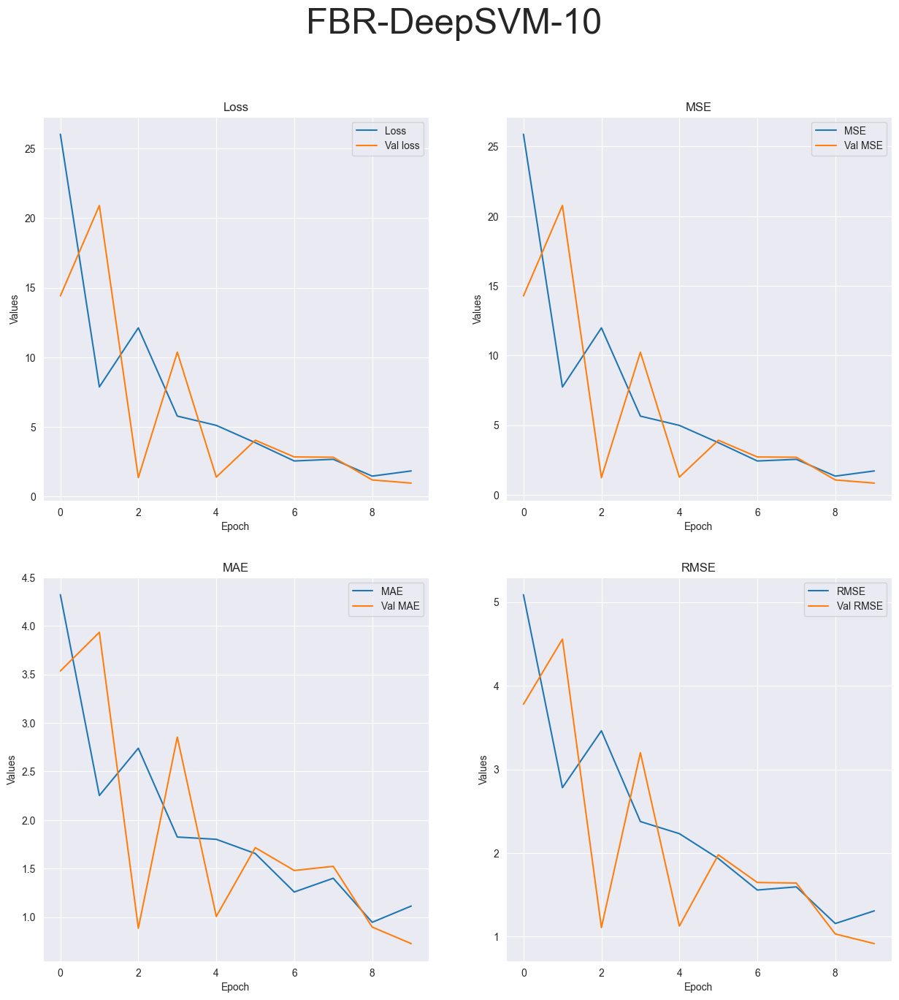

R-squared value: -1.6059


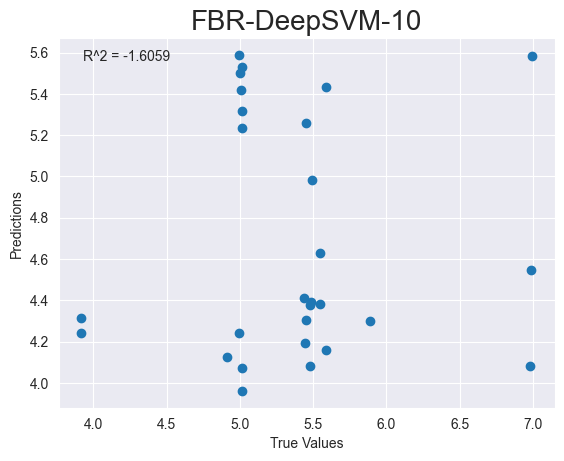

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_366 (Dense)           (None, 128)               1024      
                                                                 
 dense_367 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


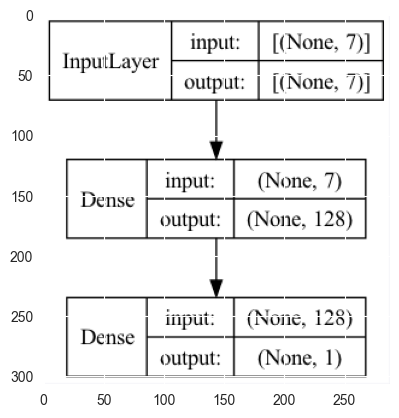

FBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:02.823821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 205ms/step - loss: 20.0001 - mse: 19.8646 - mae: 3.6293 - root_mean_squared_error: 4.4570 - val_loss: 4.6036 - val_mse: 4.4693 - val_mae: 1.8545 - val_root_mean_squared_error: 2.1141
Epoch 2/20


2023-05-02 10:15:03.526383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 72ms/step - loss: 11.2396 - mse: 11.1059 - mae: 2.6535 - root_mean_squared_error: 3.3326 - val_loss: 1.4421 - val_mse: 1.3090 - val_mae: 1.0326 - val_root_mean_squared_error: 1.1441
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 4.1160 - mse: 3.9827 - mae: 1.4945 - root_mean_squared_error: 1.9957 - val_loss: 4.9911 - val_mse: 4.8580 - val_mae: 1.7877 - val_root_mean_squared_error: 2.2041
Epoch 4/20
3/3 [==============================] - 0s 19ms/step - loss: 4.0945 - mse: 3.9619 - mae: 1.5049 - root_mean_squared_error: 1.9905 - val_loss: 3.6095 - val_mse: 3.4779 - val_mae: 1.6051 - val_root_mean_squared_error: 1.8649
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 4.0152 - mse: 3.8837 - mae: 1.6425 - root_mean_squared_error: 1.9707 - val_loss: 2.9200 - val_mse: 2.7883 - val_mae: 1.4779 - val_root_mean_squared_error: 1.6698
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 1.4186

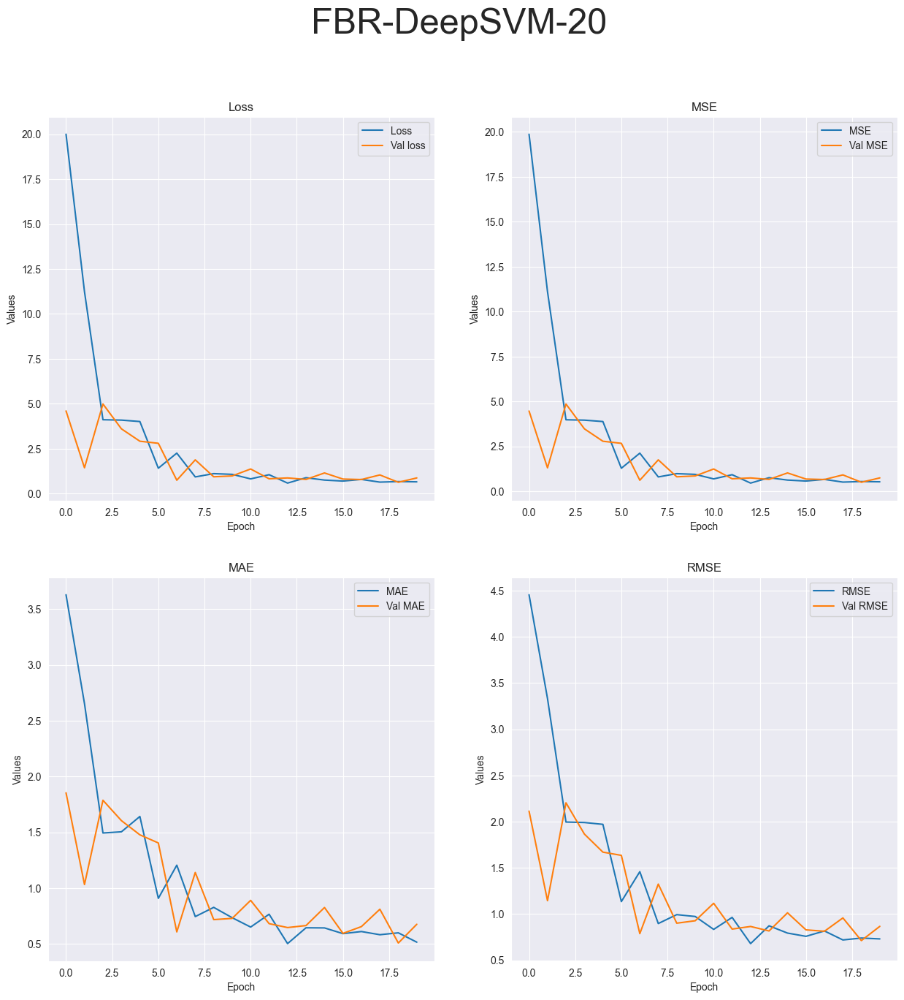

R-squared value: -0.0875


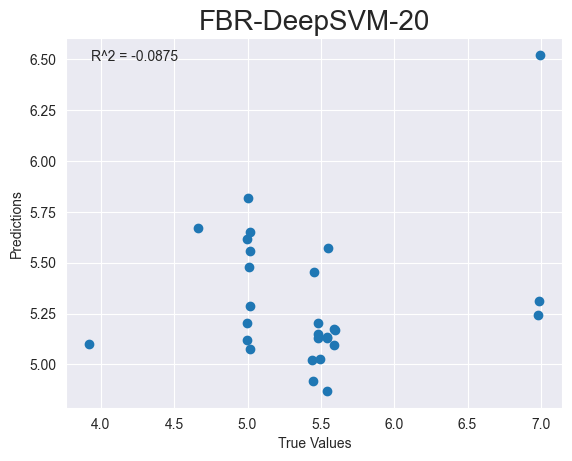

Running tests on CBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_368 (Dense)           (None, 64)                256       
                                                                 
 dropout_82 (Dropout)        (None, 64)                0         
                                                                 
 dense_369 (Dense)           (None, 32)                2080      
                                                                 
 dropout_83 (Dropout)        (None, 32)                0         
                                                                 
 dense_370 (Dense)           (None, 1)                 33

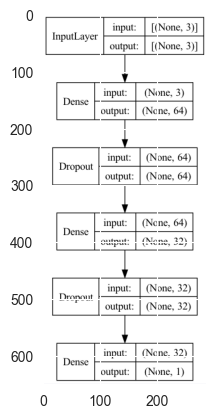

CBR-MLP-1


2023-05-02 10:15:06.623183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 337ms/step - loss: 126.6481 - mse: 126.6481 - mae: 8.9681 - root_mean_squared_error: 11.2538 - val_loss: 0.5738 - val_mse: 0.5738 - val_mae: 0.6720 - val_root_mean_squared_error: 0.7575


2023-05-02 10:15:07.616565: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 100ms/step - loss: 0.6915 - mse: 0.6915 - mae: 0.6921 - root_mean_squared_error: 0.8316
Test loss: [0.6914793252944946, 0.6914793252944946, 0.6920588612556458, 0.8315523862838745]
['loss', 'mse', 'mae', 'root_mean_squared_error']


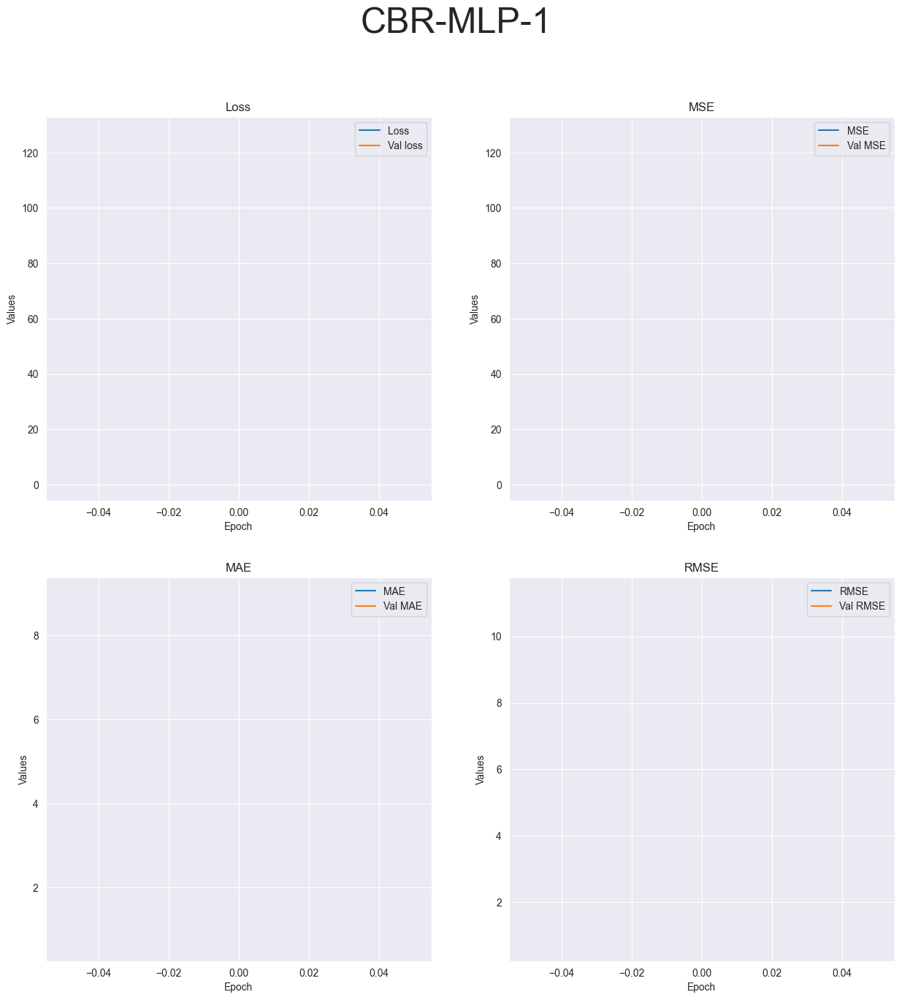

R-squared value: -0.4649


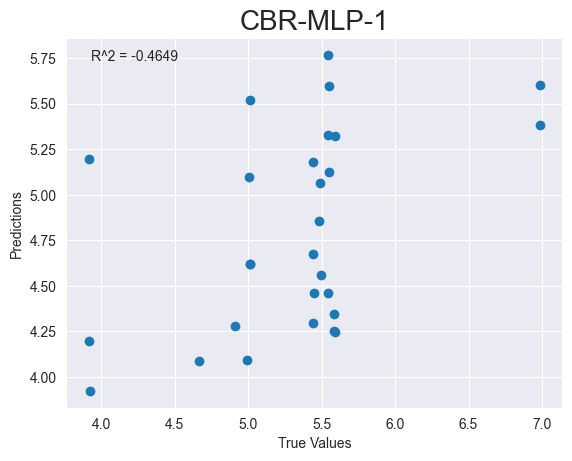

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_371 (Dense)           (None, 64)                256       
                                                                 
 dropout_84 (Dropout)        (None, 64)                0         
                                                                 
 dense_372 (Dense)           (None, 32)                2080      
                                                                 
 dropout_85 (Dropout)        (None, 32)                0         
                                                                 
 dense_373 (Dense)           (None, 1)                 33        
                                                      

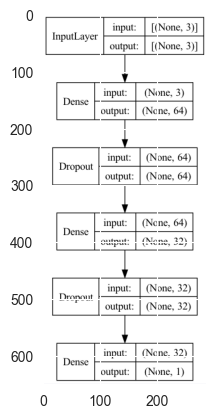

CBR-MLP-4
Epoch 1/4


2023-05-02 10:15:09.831893: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 313ms/step - loss: 101.2844 - mse: 101.2844 - mae: 8.3735 - root_mean_squared_error: 10.0640 - val_loss: 6.5552 - val_mse: 6.5552 - val_mae: 2.3554 - val_root_mean_squared_error: 2.5603
Epoch 2/4


2023-05-02 10:15:11.163028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 87ms/step - loss: 25.4389 - mse: 25.4389 - mae: 3.9139 - root_mean_squared_error: 5.0437 - val_loss: 4.0227 - val_mse: 4.0227 - val_mae: 1.9102 - val_root_mean_squared_error: 2.0057
Epoch 3/4
3/3 [==============================] - 0s 65ms/step - loss: 13.6987 - mse: 13.6987 - mae: 2.9021 - root_mean_squared_error: 3.7012 - val_loss: 0.6364 - val_mse: 0.6364 - val_mae: 0.6263 - val_root_mean_squared_error: 0.7978
Epoch 4/4
1/1 [==============================] - 0s 80ms/step - loss: 12.1008 - mse: 12.1008 - mae: 1.3482 - root_mean_squared_error: 3.4786
Test loss: [12.10079288482666, 12.10079288482666, 1.3482025861740112, 3.478619337081909]
['loss', 'mse', 'mae', 'root_mean_squared_error']


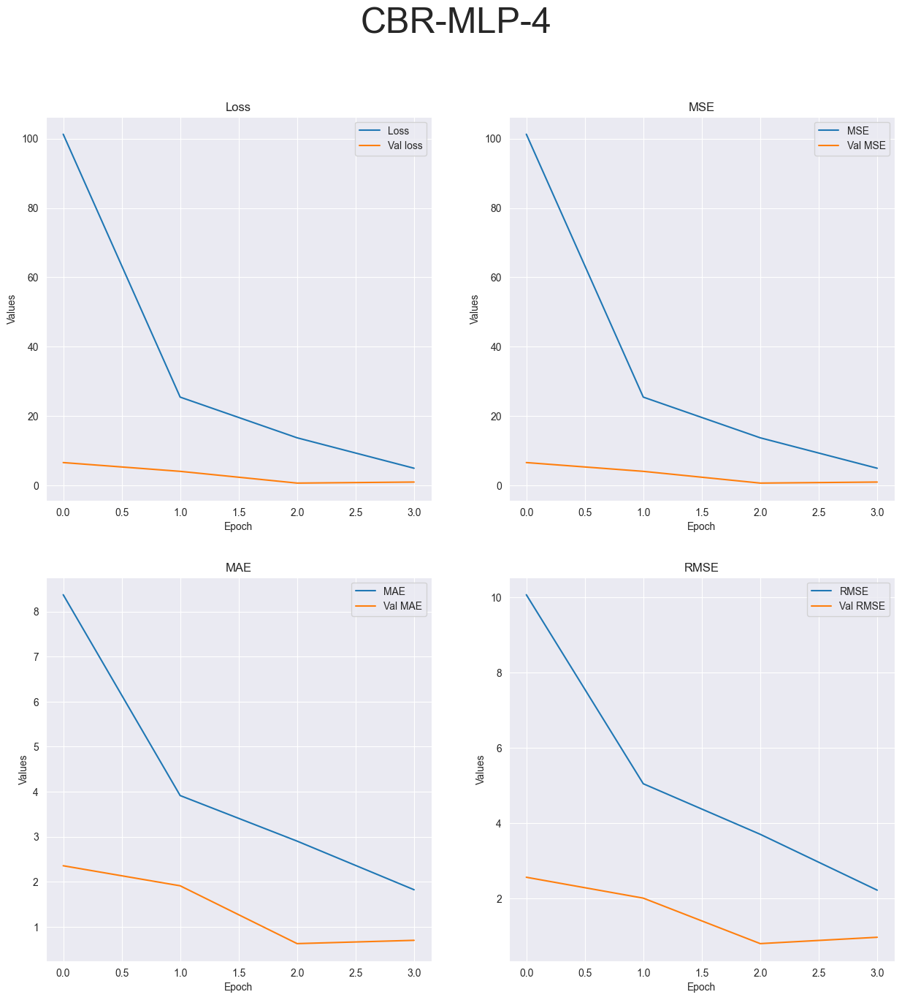

R-squared value: -18.4792


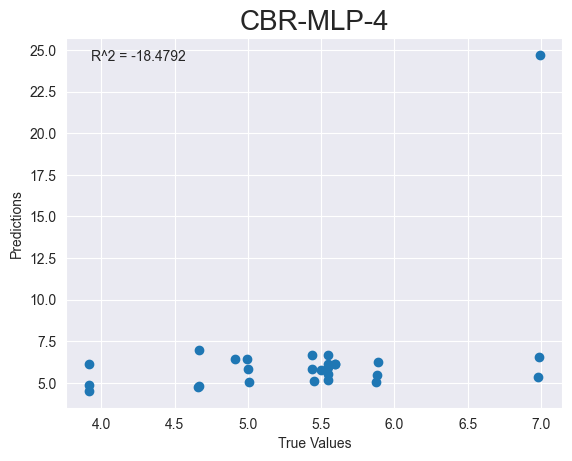

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_374 (Dense)           (None, 64)                256       
                                                                 
 dropout_86 (Dropout)        (None, 64)                0         
                                                                 
 dense_375 (Dense)           (None, 32)                2080      
                                                                 
 dropout_87 (Dropout)        (None, 32)                0         
                                                                 
 dense_376 (Dense)           (None, 1)                 33        
                                                     

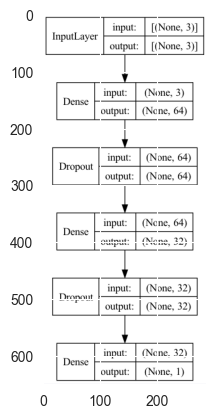

CBR-MLP-10
Epoch 1/10


2023-05-02 10:15:13.105617: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 304ms/step - loss: 84.7448 - mse: 84.7448 - mae: 7.2300 - root_mean_squared_error: 9.2057 - val_loss: 4.4000 - val_mse: 4.4000 - val_mae: 1.9315 - val_root_mean_squared_error: 2.0976
Epoch 2/10


2023-05-02 10:15:14.085403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 52ms/step - loss: 26.3299 - mse: 26.3299 - mae: 3.9629 - root_mean_squared_error: 5.1313 - val_loss: 0.9299 - val_mse: 0.9299 - val_mae: 0.7091 - val_root_mean_squared_error: 0.9643
Epoch 3/10
3/3 [==============================] - 0s 52ms/step - loss: 6.8510 - mse: 6.8510 - mae: 2.1095 - root_mean_squared_error: 2.6174 - val_loss: 0.7861 - val_mse: 0.7861 - val_mae: 0.6525 - val_root_mean_squared_error: 0.8866
Epoch 4/10
3/3 [==============================] - 0s 48ms/step - loss: 3.8183 - mse: 3.8183 - mae: 1.5890 - root_mean_squared_error: 1.9540 - val_loss: 3.2285 - val_mse: 3.2285 - val_mae: 1.6251 - val_root_mean_squared_error: 1.7968
Epoch 5/10
3/3 [==============================] - 0s 26ms/step - loss: 2.6794 - mse: 2.6794 - mae: 1.3155 - root_mean_squared_error: 1.6369 - val_loss: 4.2106 - val_mse: 4.2106 - val_mae: 1.8852 - val_root_mean_squared_error: 2.0520
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 2.0913

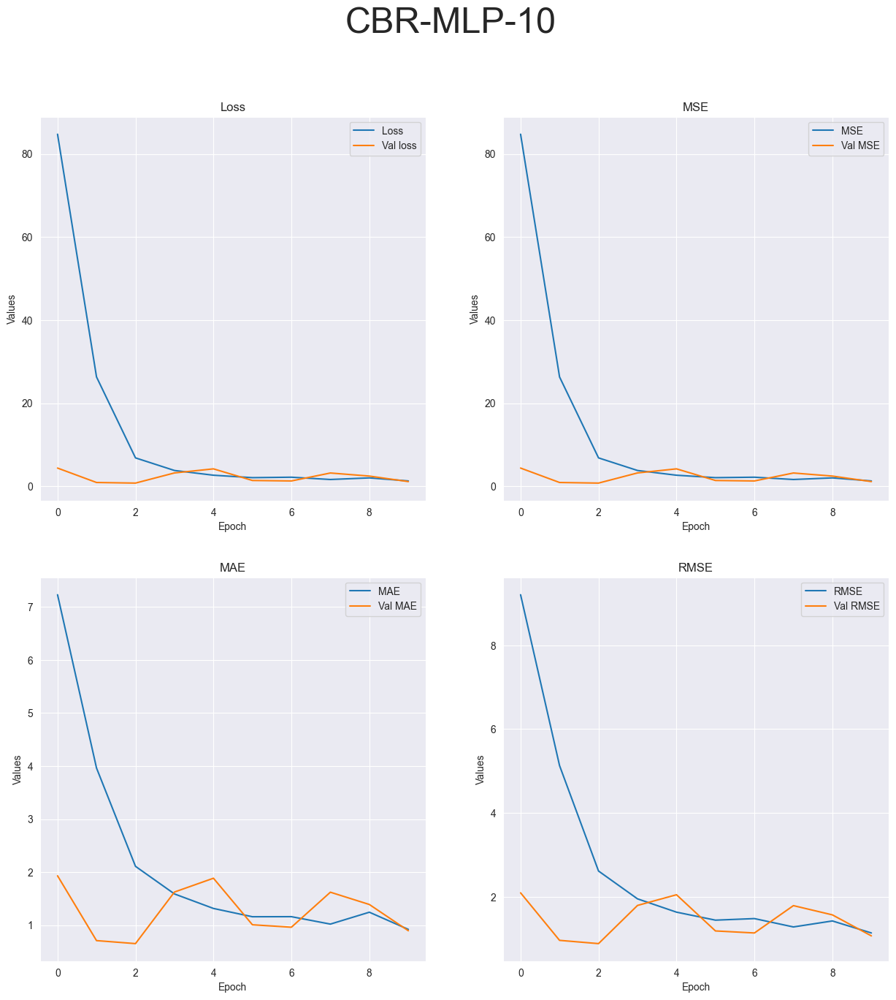

R-squared value: -15.2369


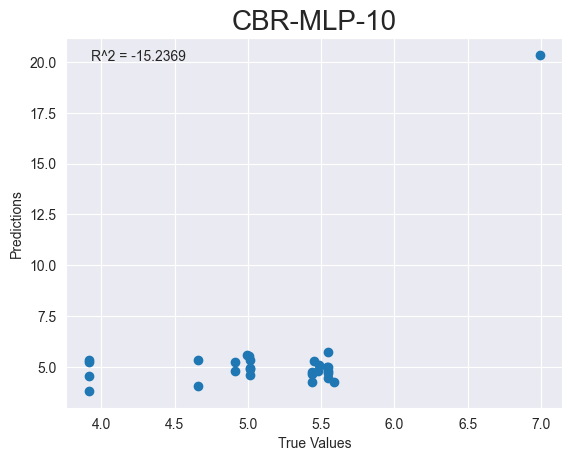

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_377 (Dense)           (None, 64)                256       
                                                                 
 dropout_88 (Dropout)        (None, 64)                0         
                                                                 
 dense_378 (Dense)           (None, 32)                2080      
                                                                 
 dropout_89 (Dropout)        (None, 32)                0         
                                                                 
 dense_379 (Dense)           (None, 1)                 33        
                                                     

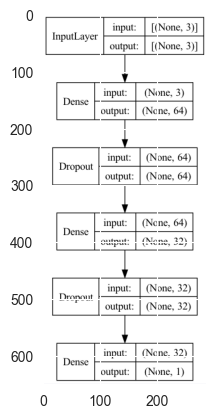

CBR-MLP-20
Epoch 1/20


2023-05-02 10:15:16.399957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 292ms/step - loss: 81.7751 - mse: 81.7751 - mae: 7.3970 - root_mean_squared_error: 9.0430 - val_loss: 0.3627 - val_mse: 0.3627 - val_mae: 0.5039 - val_root_mean_squared_error: 0.6023
Epoch 2/20


2023-05-02 10:15:17.397946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 70ms/step - loss: 27.2962 - mse: 27.2962 - mae: 4.0246 - root_mean_squared_error: 5.2246 - val_loss: 0.5659 - val_mse: 0.5659 - val_mae: 0.6608 - val_root_mean_squared_error: 0.7523
Epoch 3/20
3/3 [==============================] - 0s 27ms/step - loss: 9.4102 - mse: 9.4102 - mae: 2.3717 - root_mean_squared_error: 3.0676 - val_loss: 1.2529 - val_mse: 1.2529 - val_mae: 0.9030 - val_root_mean_squared_error: 1.1193
Epoch 4/20
3/3 [==============================] - 0s 50ms/step - loss: 4.7046 - mse: 4.7046 - mae: 1.7061 - root_mean_squared_error: 2.1690 - val_loss: 0.6125 - val_mse: 0.6125 - val_mae: 0.6889 - val_root_mean_squared_error: 0.7826
Epoch 5/20
3/3 [==============================] - 0s 26ms/step - loss: 3.5561 - mse: 3.5561 - mae: 1.4834 - root_mean_squared_error: 1.8858 - val_loss: 3.6169 - val_mse: 3.6169 - val_mae: 1.8168 - val_root_mean_squared_error: 1.9018
Epoch 6/20
3/3 [==============================] - 0s 26ms/step - loss: 3.0170

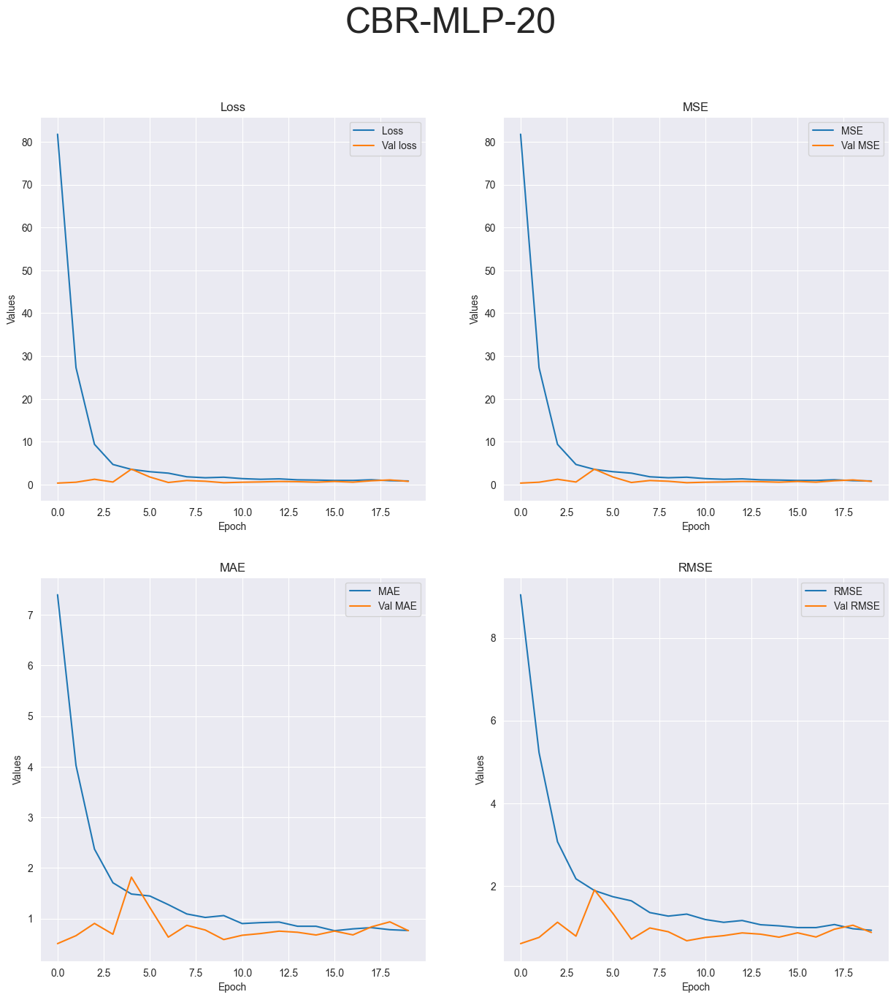

R-squared value: -8.5218


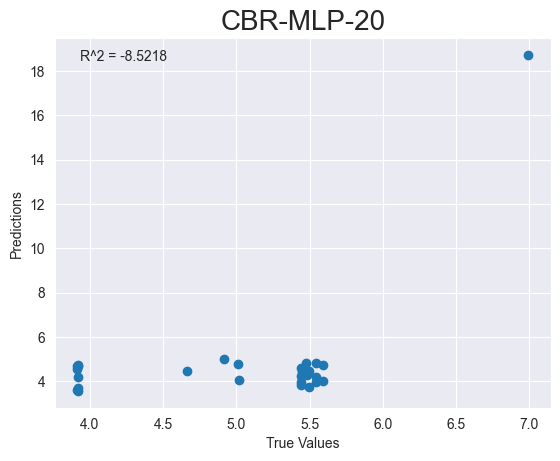

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_380 (Dense)           (None, 64)                256       
                                                                 
 dense_381 (Dense)           (None, 32)                2080      
                                                                 
 dense_382 (Dense)           (None, 16)                528       
                                                                 
 dense_383 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
________________________

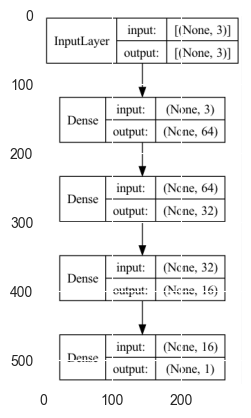

CBR-FCNN-1


2023-05-02 10:15:20.213180: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 242ms/step - loss: 165.5068 - mse: 165.5068 - mae: 10.2151 - root_mean_squared_error: 12.8649 - val_loss: 63.2382 - val_mse: 63.2382 - val_mae: 7.9327 - val_root_mean_squared_error: 7.9522


2023-05-02 10:15:21.015657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 105ms/step - loss: 59.4678 - mse: 59.4678 - mae: 7.6558 - root_mean_squared_error: 7.7115
Test loss: [59.46782684326172, 59.46782684326172, 7.655766010284424, 7.711538314819336]
['loss', 'mse', 'mae', 'root_mean_squared_error']


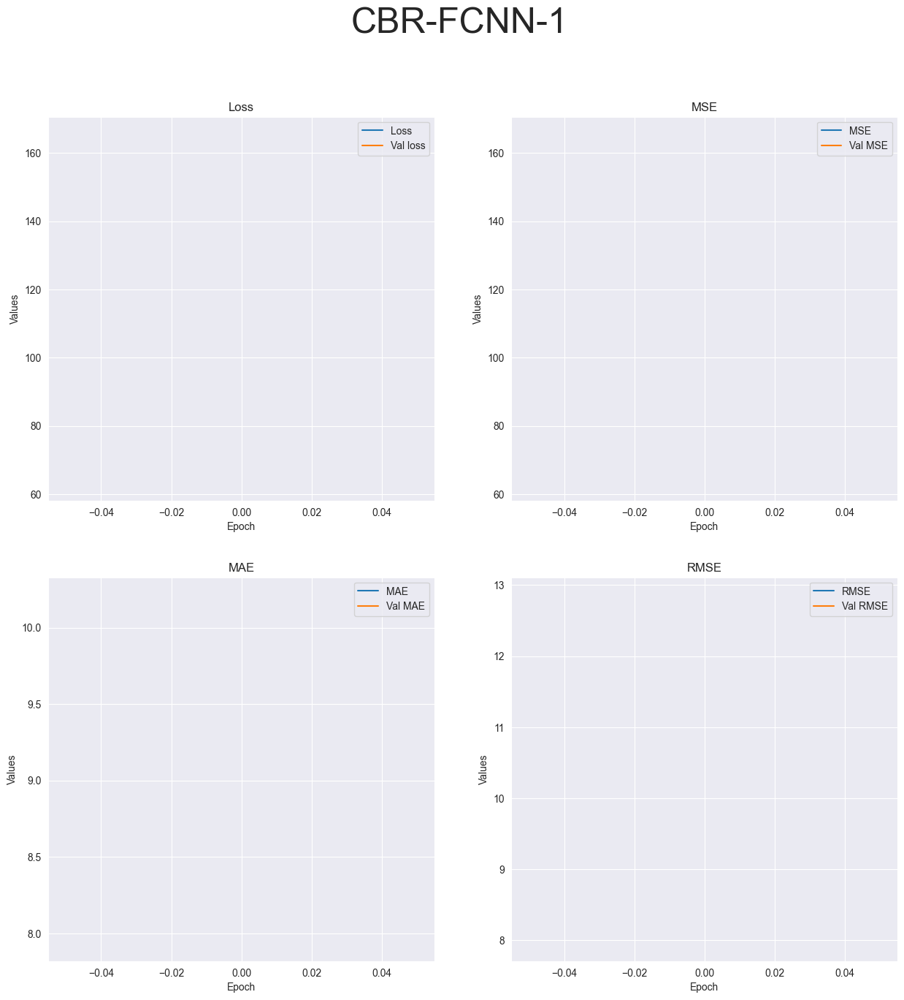

R-squared value: -101.0737


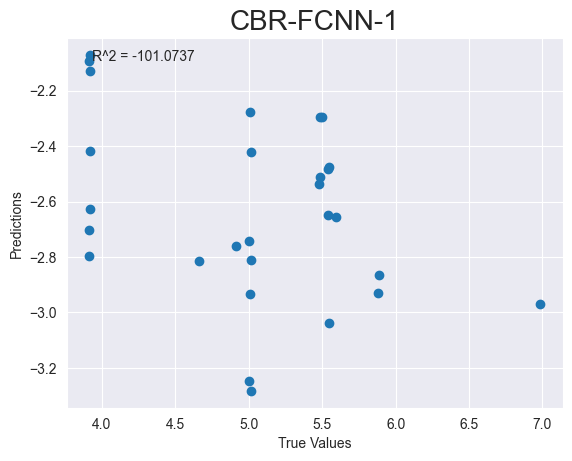

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_130"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_384 (Dense)           (None, 64)                256       
                                                                 
 dense_385 (Dense)           (None, 32)                2080      
                                                                 
 dense_386 (Dense)           (None, 16)                528       
                                                                 
 dense_387 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

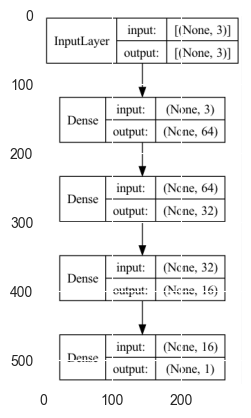

CBR-FCNN-4
Epoch 1/4


2023-05-02 10:15:23.319465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 147.7229 - mse: 147.7229 - mae: 9.8476 - root_mean_squared_error: 12.1541 - val_loss: 33.8551 - val_mse: 33.8551 - val_mae: 5.7627 - val_root_mean_squared_error: 5.8185
Epoch 2/4


2023-05-02 10:15:24.288229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 79.6035 - mse: 79.6035 - mae: 8.3617 - root_mean_squared_error: 8.9221 - val_loss: 36.6885 - val_mse: 36.6885 - val_mae: 6.0018 - val_root_mean_squared_error: 6.0571
Epoch 3/4
3/3 [==============================] - 0s 44ms/step - loss: 14.6505 - mse: 14.6505 - mae: 3.0607 - root_mean_squared_error: 3.8276 - val_loss: 10.0959 - val_mse: 10.0959 - val_mae: 3.0361 - val_root_mean_squared_error: 3.1774
Epoch 4/4
1/1 [==============================] - 0s 94ms/step - loss: 5.2734 - mse: 5.2734 - mae: 2.1533 - root_mean_squared_error: 2.2964
Test loss: [5.273404598236084, 5.273404598236084, 2.1533331871032715, 2.296389579772949]
['loss', 'mse', 'mae', 'root_mean_squared_error']


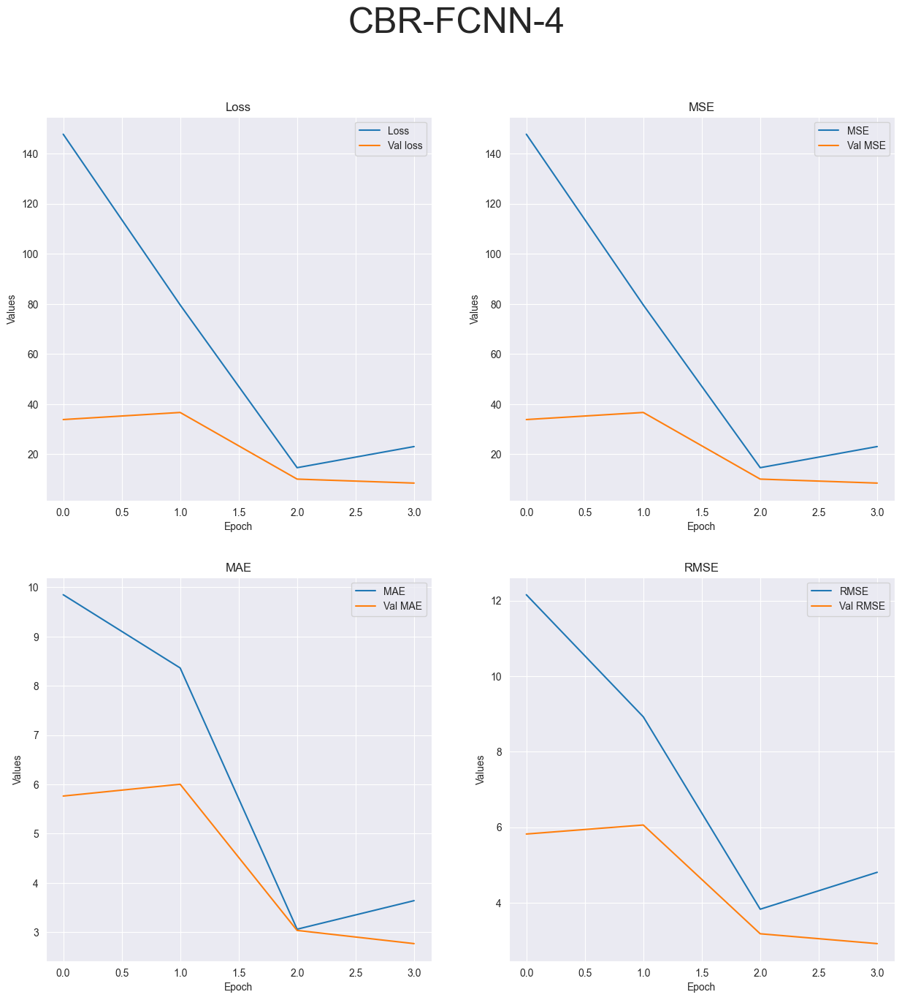

R-squared value: -23.8754


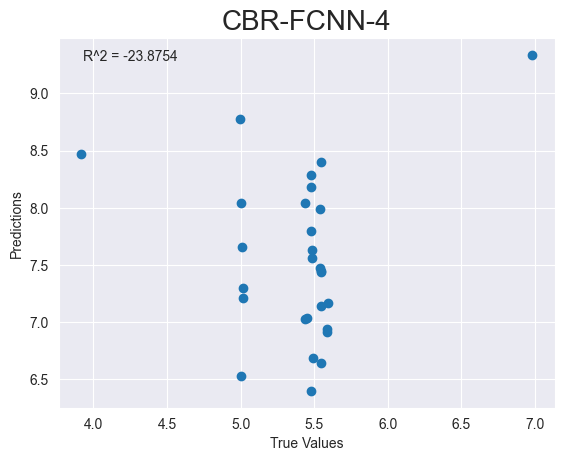

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_388 (Dense)           (None, 64)                256       
                                                                 
 dense_389 (Dense)           (None, 32)                2080      
                                                                 
 dense_390 (Dense)           (None, 16)                528       
                                                                 
 dense_391 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

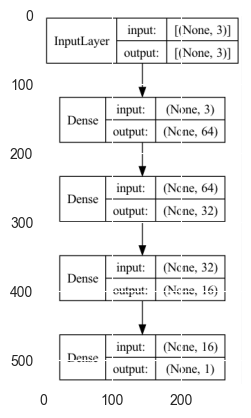

CBR-FCNN-10
Epoch 1/10


2023-05-02 10:15:26.235663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 253ms/step - loss: 249.4460 - mse: 249.4460 - mae: 10.4944 - root_mean_squared_error: 15.7939 - val_loss: 44.9696 - val_mse: 44.9696 - val_mae: 6.6666 - val_root_mean_squared_error: 6.7059
Epoch 2/10


2023-05-02 10:15:27.152436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 86ms/step - loss: 123.8067 - mse: 123.8067 - mae: 10.4240 - root_mean_squared_error: 11.1268 - val_loss: 81.7575 - val_mse: 81.7575 - val_mae: 8.9971 - val_root_mean_squared_error: 9.0420
Epoch 3/10
3/3 [==============================] - 0s 44ms/step - loss: 47.6422 - mse: 47.6422 - mae: 5.9843 - root_mean_squared_error: 6.9023 - val_loss: 1.6170 - val_mse: 1.6170 - val_mae: 1.0223 - val_root_mean_squared_error: 1.2716
Epoch 4/10
3/3 [==============================] - 0s 19ms/step - loss: 15.1329 - mse: 15.1329 - mae: 2.3042 - root_mean_squared_error: 3.8901 - val_loss: 12.6308 - val_mse: 12.6308 - val_mae: 3.3917 - val_root_mean_squared_error: 3.5540
Epoch 5/10
3/3 [==============================] - 0s 42ms/step - loss: 17.5145 - mse: 17.5145 - mae: 2.9789 - root_mean_squared_error: 4.1850 - val_loss: 3.7920 - val_mse: 3.7920 - val_mae: 1.7236 - val_root_mean_squared_error: 1.9473
Epoch 6/10
3/3 [==============================] - 0s 22ms/step 

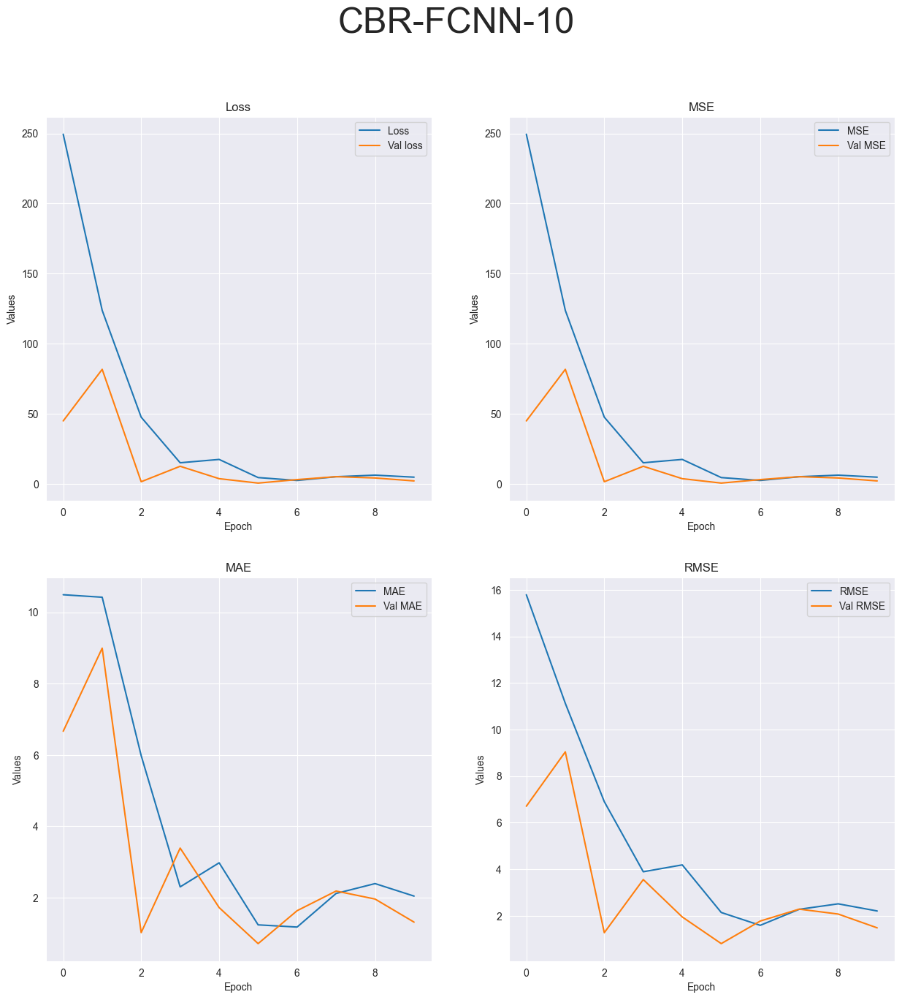

R-squared value: -7.0417


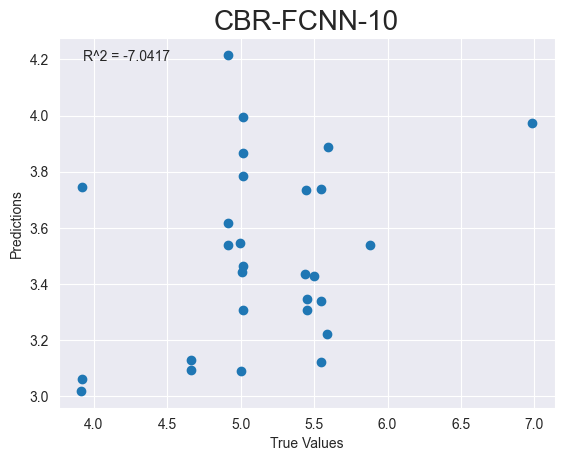

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_132"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_392 (Dense)           (None, 64)                256       
                                                                 
 dense_393 (Dense)           (None, 32)                2080      
                                                                 
 dense_394 (Dense)           (None, 16)                528       
                                                                 
 dense_395 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

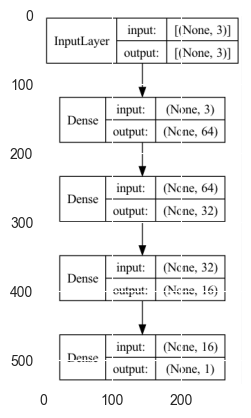

CBR-FCNN-20
Epoch 1/20


2023-05-02 10:15:29.340626: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 231ms/step - loss: 149.7744 - mse: 149.7744 - mae: 9.9618 - root_mean_squared_error: 12.2382 - val_loss: 29.5000 - val_mse: 29.5000 - val_mae: 5.3928 - val_root_mean_squared_error: 5.4314
Epoch 2/20


2023-05-02 10:15:30.208081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 68ms/step - loss: 68.8996 - mse: 68.8996 - mae: 8.0486 - root_mean_squared_error: 8.3006 - val_loss: 41.3070 - val_mse: 41.3070 - val_mae: 6.3929 - val_root_mean_squared_error: 6.4271
Epoch 3/20
3/3 [==============================] - 0s 51ms/step - loss: 19.6761 - mse: 19.6761 - mae: 3.5804 - root_mean_squared_error: 4.4358 - val_loss: 5.8723 - val_mse: 5.8723 - val_mae: 2.2722 - val_root_mean_squared_error: 2.4233
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 20.6946 - mse: 20.6946 - mae: 3.3122 - root_mean_squared_error: 4.5491 - val_loss: 4.3520 - val_mse: 4.3520 - val_mae: 1.9292 - val_root_mean_squared_error: 2.0862
Epoch 5/20
3/3 [==============================] - 0s 33ms/step - loss: 10.7263 - mse: 10.7263 - mae: 1.7059 - root_mean_squared_error: 3.2751 - val_loss: 2.1537 - val_mse: 2.1537 - val_mae: 1.3029 - val_root_mean_squared_error: 1.4675
Epoch 6/20
3/3 [==============================] - 0s 25ms/step - loss

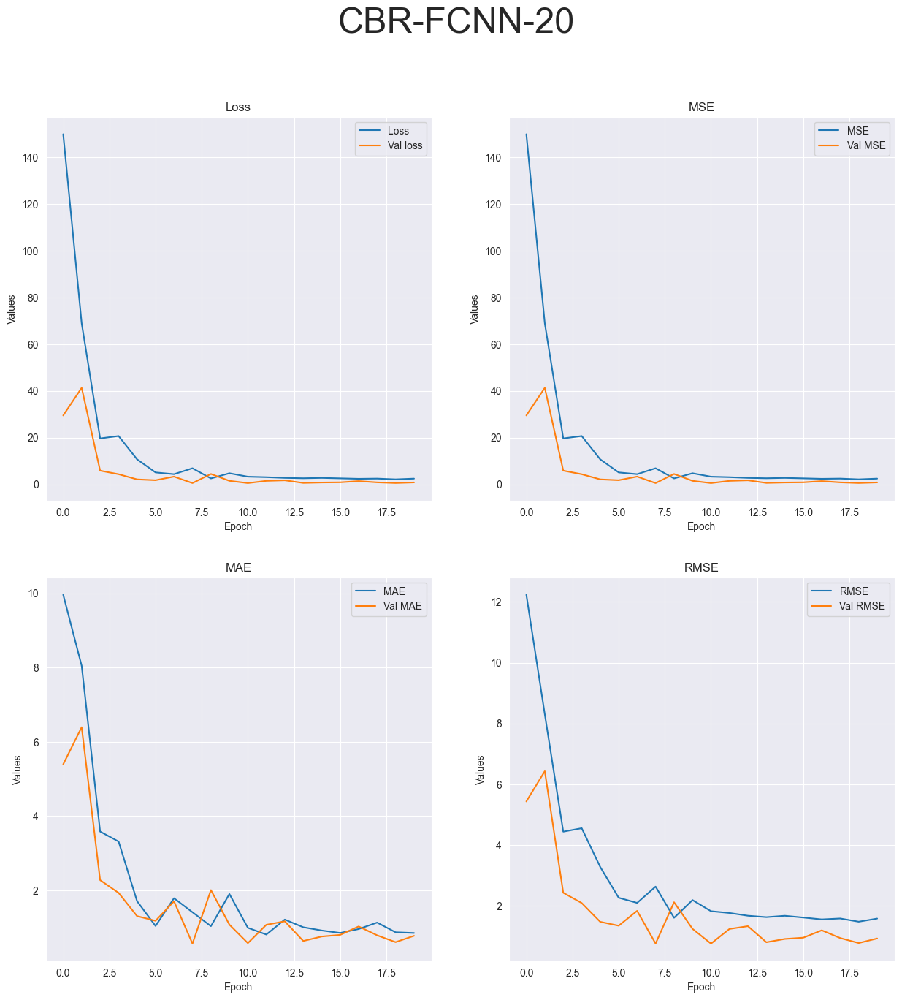

R-squared value: -0.8402


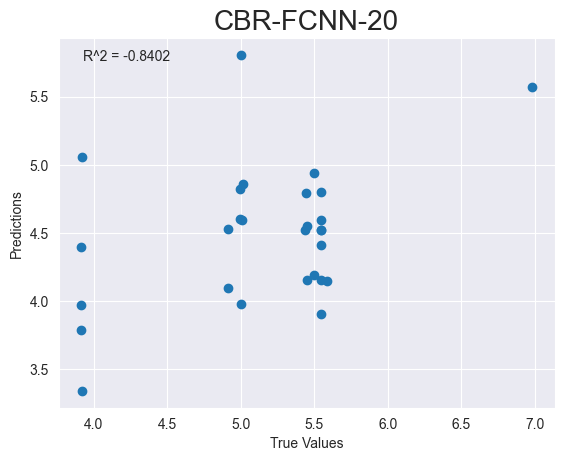

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_396 (Dense)           (None, 128)               512       
                                                                 
 dense_397 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


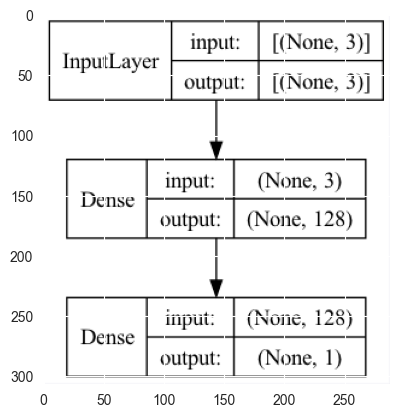

CBR-DeepSVM-1


2023-05-02 10:15:33.033163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 227ms/step - loss: 3884.7043 - mse: 3884.6489 - mae: 55.6956 - root_mean_squared_error: 62.3270 - val_loss: 29.9943 - val_mse: 29.9405 - val_mae: 4.3511 - val_root_mean_squared_error: 5.4718


2023-05-02 10:15:33.782557: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 74ms/step - loss: 23.6924 - mse: 23.6386 - mae: 4.2725 - root_mean_squared_error: 4.8620
Test loss: [23.69243049621582, 23.63859748840332, 4.272491455078125, 4.861954212188721]
['loss', 'mse', 'mae', 'root_mean_squared_error']


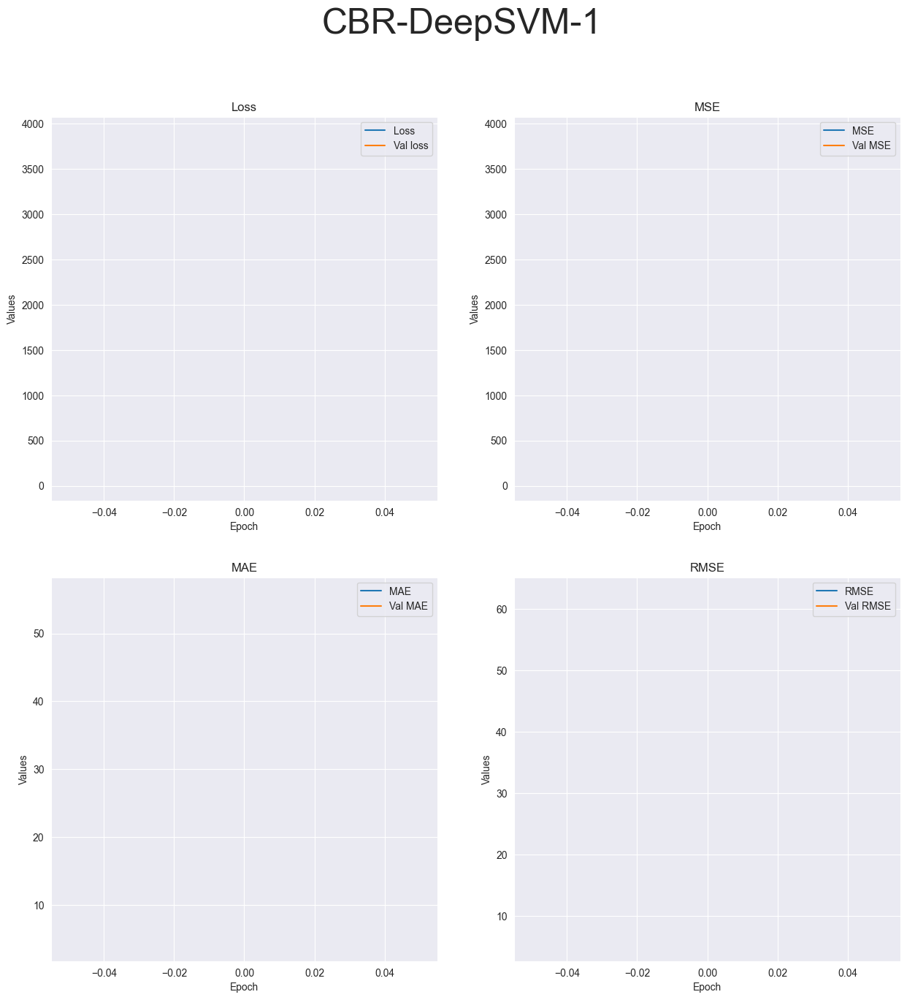

R-squared value: -53.1137


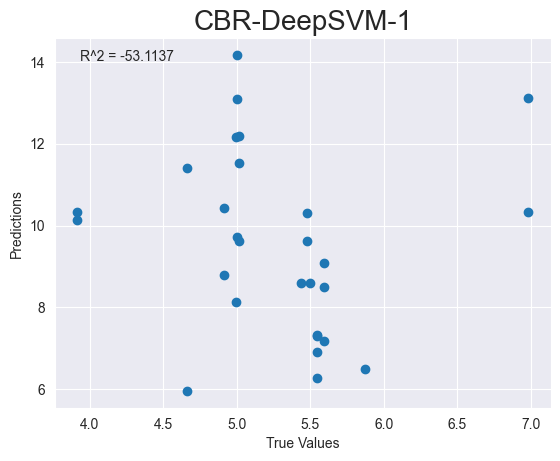

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_134"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_398 (Dense)           (None, 128)               512       
                                                                 
 dense_399 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


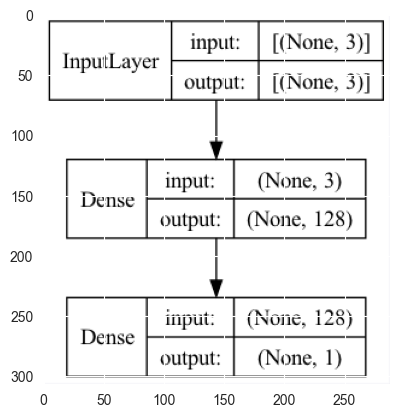

CBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:15:36.005213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 250ms/step - loss: 4757.4282 - mse: 4757.3730 - mae: 58.0742 - root_mean_squared_error: 68.9737 - val_loss: 62.2536 - val_mse: 62.1996 - val_mae: 7.3037 - val_root_mean_squared_error: 7.8867
Epoch 2/4


2023-05-02 10:15:37.184928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 57ms/step - loss: 218.3471 - mse: 218.2928 - mae: 12.9186 - root_mean_squared_error: 14.7747 - val_loss: 909.4910 - val_mse: 909.4363 - val_mae: 30.0902 - val_root_mean_squared_error: 30.1569
Epoch 3/4
3/3 [==============================] - 0s 49ms/step - loss: 1250.6490 - mse: 1250.5946 - mae: 33.1632 - root_mean_squared_error: 35.3637 - val_loss: 798.0588 - val_mse: 798.0056 - val_mae: 28.1871 - val_root_mean_squared_error: 28.2490
Epoch 4/4
1/1 [==============================] - 0s 69ms/step - loss: 97.5919 - mse: 97.5408 - mae: 9.8014 - root_mean_squared_error: 9.8763
Test loss: [97.5919189453125, 97.54084777832031, 9.801376342773438, 9.876276969909668]
['loss', 'mse', 'mae', 'root_mean_squared_error']


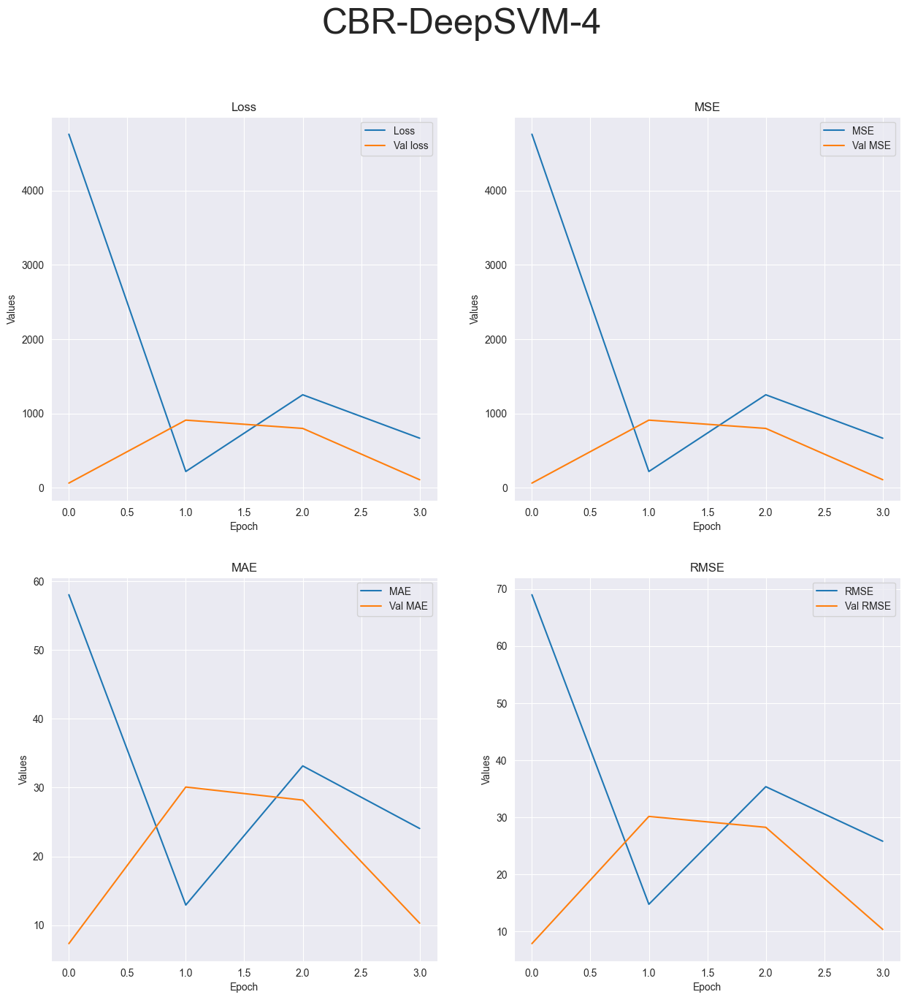

R-squared value: -170.4916


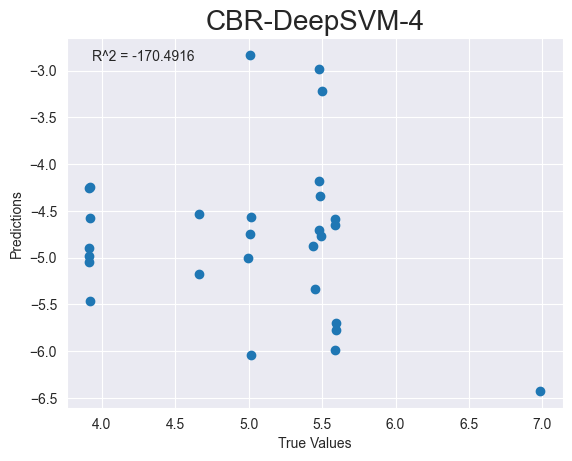

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_400 (Dense)           (None, 128)               512       
                                                                 
 dense_401 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


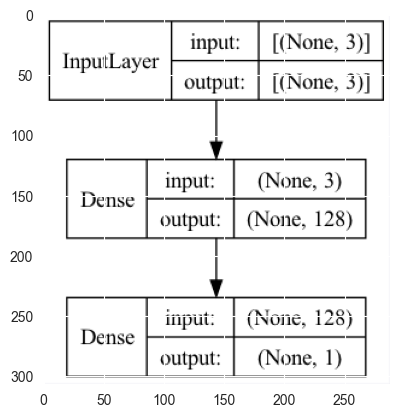

CBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:38.984528: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 241ms/step - loss: 3472.2075 - mse: 3472.1516 - mae: 54.6162 - root_mean_squared_error: 58.9250 - val_loss: 44.4575 - val_mse: 44.4035 - val_mae: 5.5932 - val_root_mean_squared_error: 6.6636


2023-05-02 10:15:39.713848: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 2/10
3/3 [==============================] - 0s 52ms/step - loss: 278.5905 - mse: 278.5362 - mae: 13.8085 - root_mean_squared_error: 16.6894 - val_loss: 1908.7225 - val_mse: 1908.6678 - val_mae: 37.2730 - val_root_mean_squared_error: 43.6883
Epoch 3/10
3/3 [==============================] - 0s 31ms/step - loss: 1091.2365 - mse: 1091.1824 - mae: 32.9248 - root_mean_squared_error: 33.0331 - val_loss: 1171.3112 - val_mse: 1171.2584 - val_mae: 29.3112 - val_root_mean_squared_error: 34.2237
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 429.3842 - mse: 429.3321 - mae: 19.9640 - root_mean_squared_error: 20.7203 - val_loss: 48.9994 - val_mse: 48.9486 - val_mae: 6.0911 - val_root_mean_squared_error: 6.9963
Epoch 5/10
3/3 [==============================] - 0s 33ms/step - loss: 25.2302 - mse: 25.1798 - mae: 4.2736 - root_mean_squared_error: 5.0179 - val_loss: 227.2653 - val_mse: 227.2153 - val_mae: 12.4605 - val_root_mean_squared_error: 15.0737
Epoch 6/10
3/3 [======

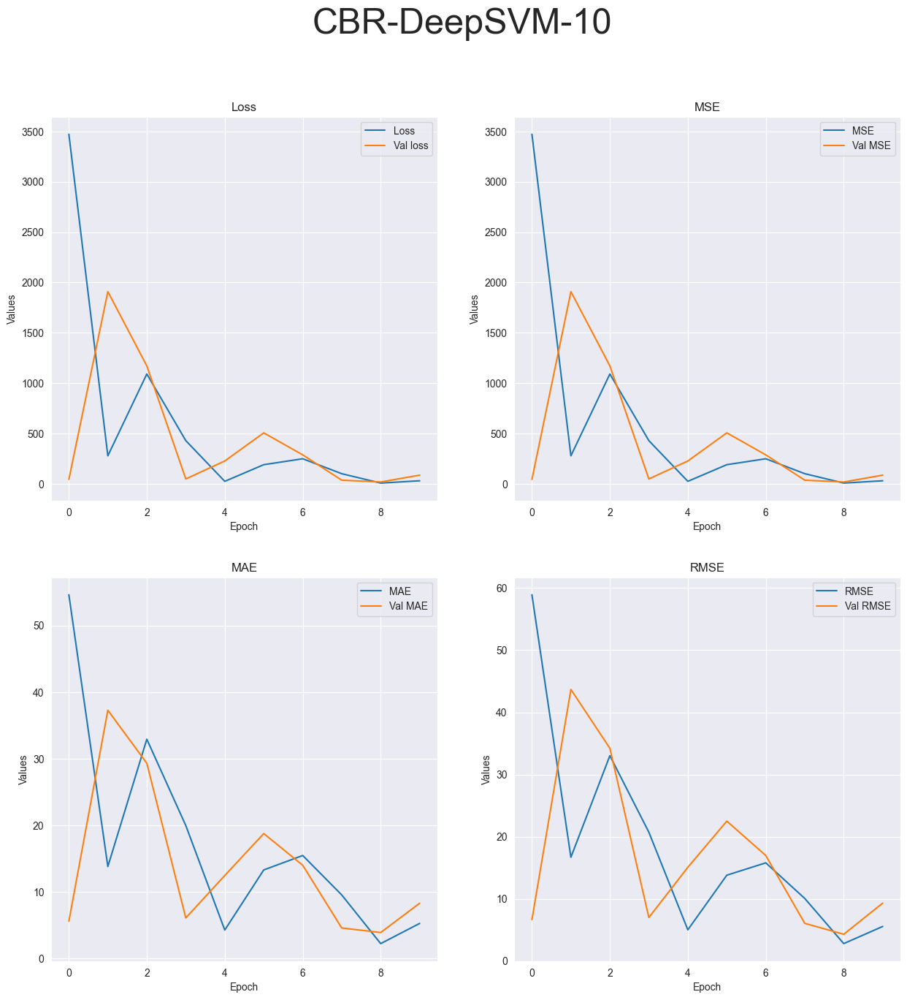

R-squared value: -108.5671


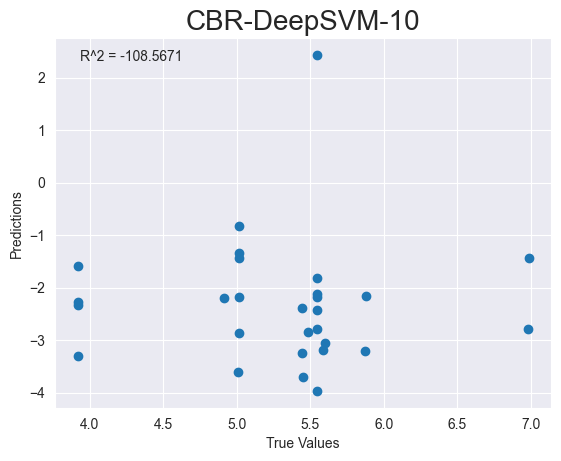

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_402 (Dense)           (None, 128)               512       
                                                                 
 dense_403 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


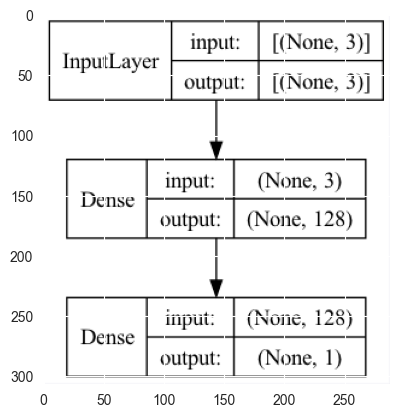

CBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:41.958807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 252ms/step - loss: 3998.0186 - mse: 3997.9631 - mae: 56.3959 - root_mean_squared_error: 63.2295 - val_loss: 19.7188 - val_mse: 19.6650 - val_mae: 3.7105 - val_root_mean_squared_error: 4.4345
Epoch 2/20


2023-05-02 10:15:42.756426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 61ms/step - loss: 327.9505 - mse: 327.8964 - mae: 14.8338 - root_mean_squared_error: 18.1079 - val_loss: 1024.2471 - val_mse: 1024.1927 - val_mae: 31.9045 - val_root_mean_squared_error: 32.0030
Epoch 3/20
3/3 [==============================] - 0s 30ms/step - loss: 1322.6562 - mse: 1322.6023 - mae: 34.4856 - root_mean_squared_error: 36.3676 - val_loss: 695.7592 - val_mse: 695.7065 - val_mae: 26.2968 - val_root_mean_squared_error: 26.3762
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 487.3185 - mse: 487.2665 - mae: 21.1159 - root_mean_squared_error: 22.0741 - val_loss: 36.6997 - val_mse: 36.6489 - val_mae: 5.8832 - val_root_mean_squared_error: 6.0538
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 36.3566 - mse: 36.3060 - mae: 4.9552 - root_mean_squared_error: 6.0255 - val_loss: 137.6275 - val_mse: 137.5774 - val_mae: 11.4052 - val_root_mean_squared_error: 11.7293
Epoch 6/20
3/3 [===================

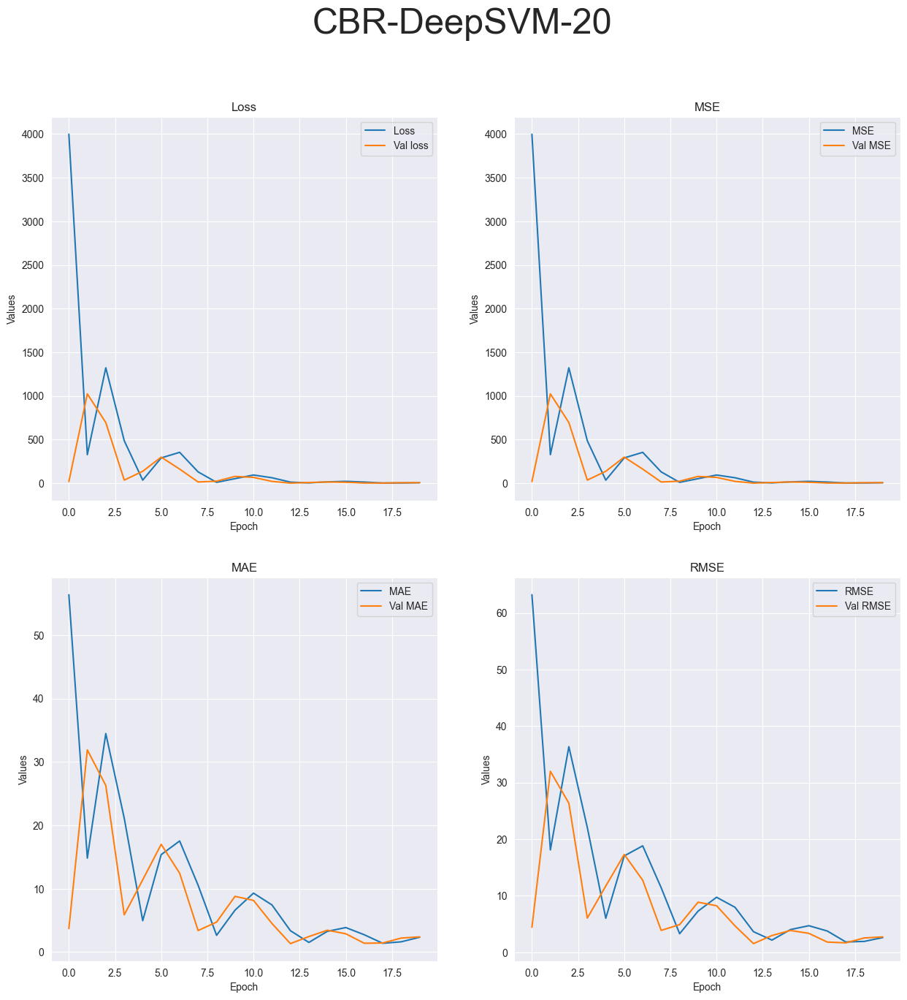

R-squared value: -16.4021


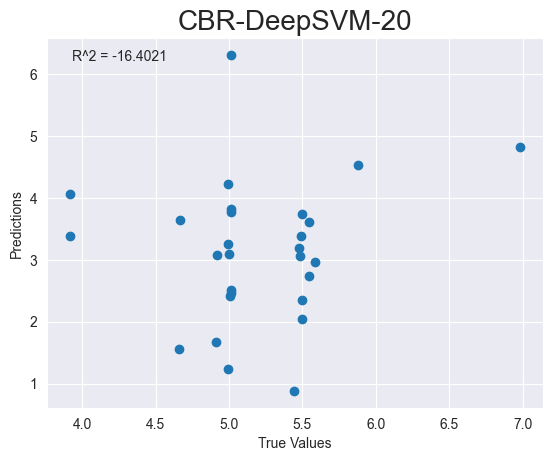

Running tests on ABR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_404 (Dense)           (None, 64)                832       
                                                                 
 dropout_90 (Dropout)        (None, 64)                0         
                            

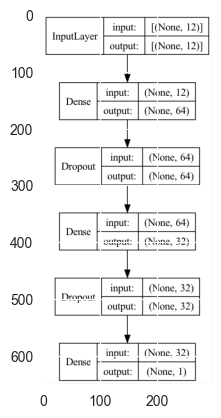

ABR-MLP-1


2023-05-02 10:15:45.558964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 297ms/step - loss: 2203661.0000 - mse: 2203661.0000 - mae: 1118.9017 - root_mean_squared_error: 1484.4733 - val_loss: 49449.8203 - val_mse: 49449.8203 - val_mae: 216.5686 - val_root_mean_squared_error: 222.3732


2023-05-02 10:15:46.668792: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 133ms/step - loss: 61691.4805 - mse: 61691.4805 - mae: 238.2089 - root_mean_squared_error: 248.3777
Test loss: [61691.48046875, 61691.48046875, 238.2089385986328, 248.37770080566406]
['loss', 'mse', 'mae', 'root_mean_squared_error']


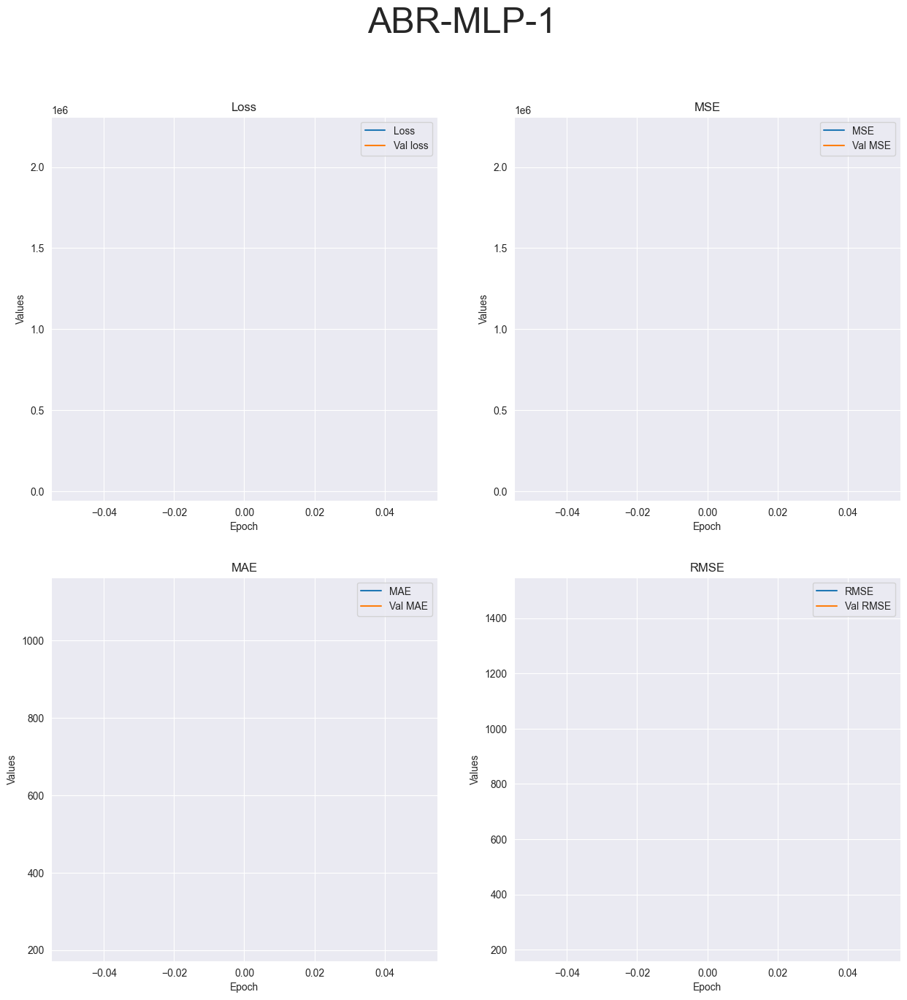

R-squared value: -114960.3807


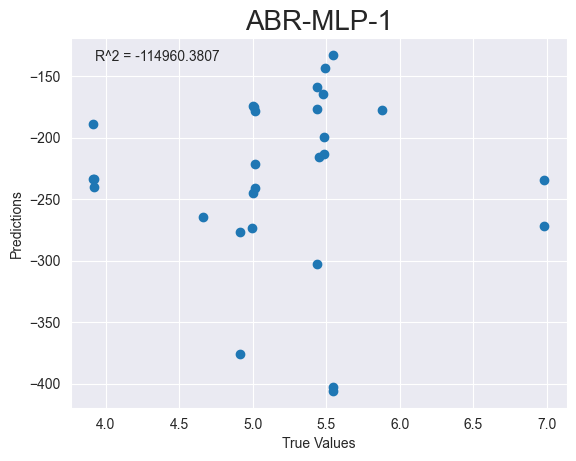

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_138"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_407 (Dense)           (None, 64)                832       
                                                                 
 dropout_92 (Dropout)        (None, 64)                0         
                                                                 
 dense_408 (Dense)       

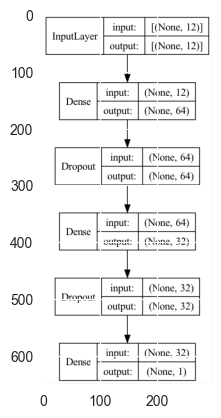

ABR-MLP-4
Epoch 1/4


2023-05-02 10:15:49.006758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 300ms/step - loss: 2089149.2500 - mse: 2089149.2500 - mae: 1139.0323 - root_mean_squared_error: 1445.3889 - val_loss: 79358.4922 - val_mse: 79358.4922 - val_mae: 273.7279 - val_root_mean_squared_error: 281.7064
Epoch 2/4


2023-05-02 10:15:50.307400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 92ms/step - loss: 398098.1562 - mse: 398098.1562 - mae: 502.3143 - root_mean_squared_error: 630.9502 - val_loss: 61433.9492 - val_mse: 61433.9492 - val_mae: 240.8612 - val_root_mean_squared_error: 247.8587
Epoch 3/4
3/3 [==============================] - 0s 40ms/step - loss: 199858.9844 - mse: 199858.9844 - mae: 341.0748 - root_mean_squared_error: 447.0559 - val_loss: 23395.7129 - val_mse: 23395.7129 - val_mae: 148.1154 - val_root_mean_squared_error: 152.9566
Epoch 4/4
1/1 [==============================] - 0s 59ms/step - loss: 23084.4512 - mse: 23084.4512 - mae: 142.9732 - root_mean_squared_error: 151.9357
Test loss: [23084.451171875, 23084.451171875, 142.97317504882812, 151.93568420410156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


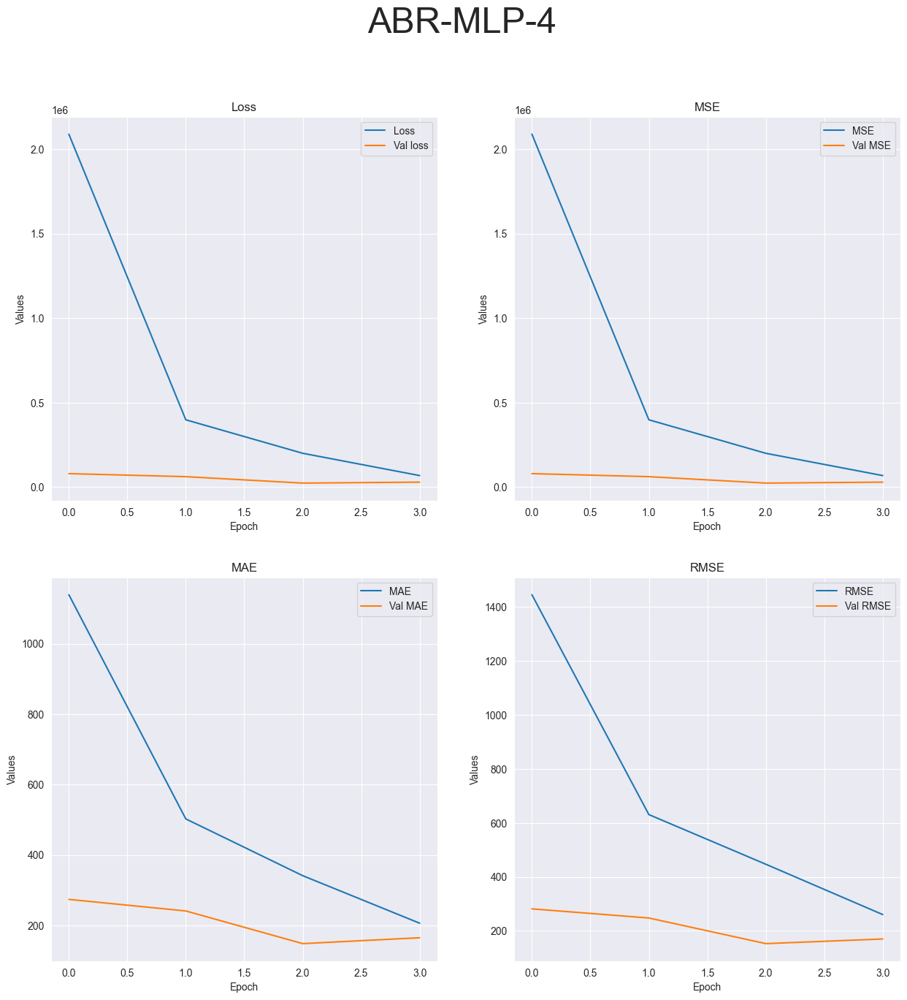

R-squared value: -66322.0838


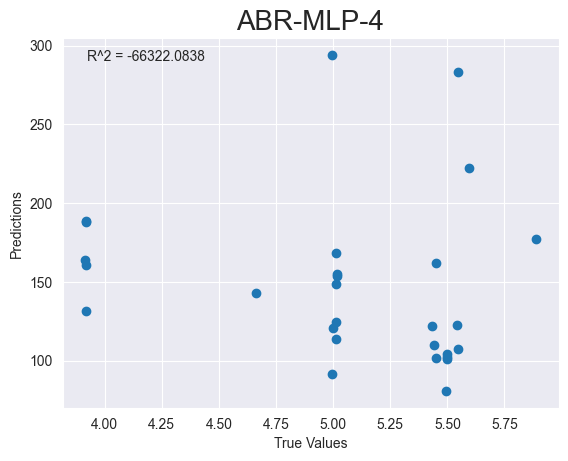

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_410 (Dense)           (None, 64)                832       
                                                                 
 dropout_94 (Dropout)        (None, 64)                0         
                                                                 
 dense_411 (Dense)      

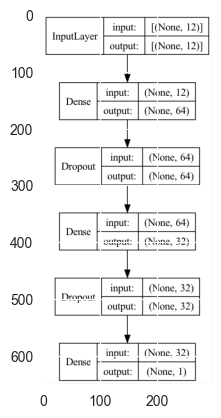

ABR-MLP-10
Epoch 1/10


2023-05-02 10:15:52.386554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 293ms/step - loss: 2038272.0000 - mse: 2038272.0000 - mae: 1124.4602 - root_mean_squared_error: 1427.6807 - val_loss: 379.6456 - val_mse: 379.6456 - val_mae: 19.0960 - val_root_mean_squared_error: 19.4845
Epoch 2/10


2023-05-02 10:15:53.462976: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 98ms/step - loss: 418643.7812 - mse: 418643.7812 - mae: 478.0808 - root_mean_squared_error: 647.0269 - val_loss: 129453.9141 - val_mse: 129453.9141 - val_mae: 343.7494 - val_root_mean_squared_error: 359.7971
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 246446.1406 - mse: 246446.1406 - mae: 391.4757 - root_mean_squared_error: 496.4334 - val_loss: 20.5560 - val_mse: 20.5560 - val_mae: 4.0006 - val_root_mean_squared_error: 4.5339
Epoch 4/10
3/3 [==============================] - 0s 21ms/step - loss: 79099.9922 - mse: 79099.9922 - mae: 216.0839 - root_mean_squared_error: 281.2472 - val_loss: 37879.1914 - val_mse: 37879.1914 - val_mae: 185.1470 - val_root_mean_squared_error: 194.6258
Epoch 5/10
3/3 [==============================] - 0s 67ms/step - loss: 65872.3516 - mse: 65872.3516 - mae: 205.5810 - root_mean_squared_error: 256.6561 - val_loss: 34491.3086 - val_mse: 34491.3086 - val_mae: 176.6465 - val_root_mean_squared_err

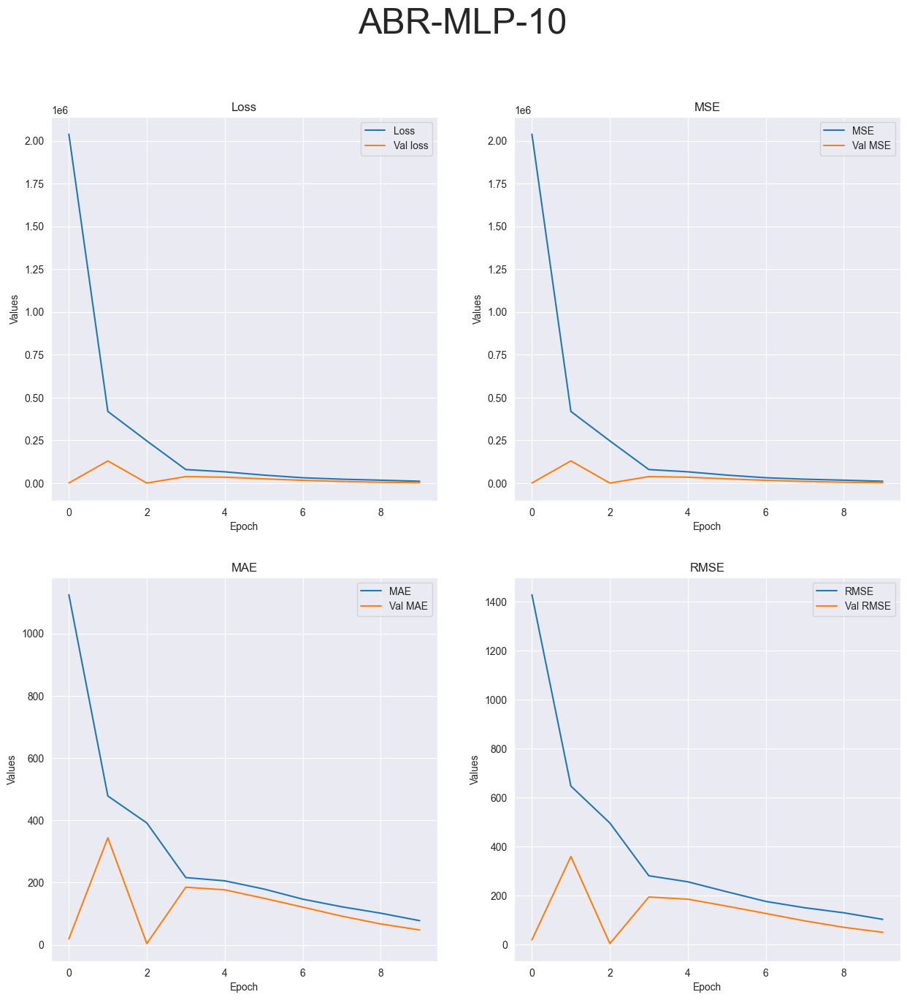

R-squared value: -3436.4455


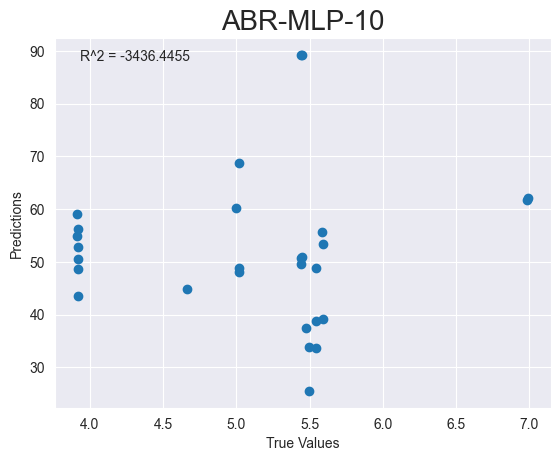

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_140"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_413 (Dense)           (None, 64)                832       
                                                                 
 dropout_96 (Dropout)        (None, 64)                0         
                                                                 
 dense_414 (Dense)      

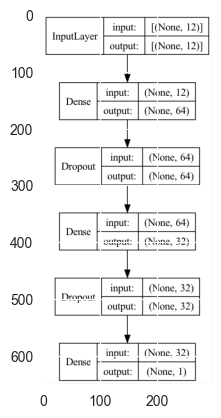

ABR-MLP-20
Epoch 1/20


2023-05-02 10:15:56.415452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 286ms/step - loss: 2466501.7500 - mse: 2466501.7500 - mae: 1195.1296 - root_mean_squared_error: 1570.5100 - val_loss: 45436.5547 - val_mse: 45436.5547 - val_mae: 206.6342 - val_root_mean_squared_error: 213.1585
Epoch 2/20


2023-05-02 10:15:57.499835: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 356214.3750 - mse: 356214.3750 - mae: 464.3078 - root_mean_squared_error: 596.8370 - val_loss: 80972.5547 - val_mse: 80972.5547 - val_mae: 275.8381 - val_root_mean_squared_error: 284.5568
Epoch 3/20
3/3 [==============================] - 0s 47ms/step - loss: 211535.6250 - mse: 211535.6250 - mae: 360.9854 - root_mean_squared_error: 459.9300 - val_loss: 944.3644 - val_mse: 944.3644 - val_mae: 29.5713 - val_root_mean_squared_error: 30.7305
Epoch 4/20
3/3 [==============================] - 0s 41ms/step - loss: 53021.2930 - mse: 53021.2930 - mae: 164.2165 - root_mean_squared_error: 230.2635 - val_loss: 14266.3613 - val_mse: 14266.3613 - val_mae: 115.2213 - val_root_mean_squared_error: 119.4419
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 42381.8320 - mse: 42381.8320 - mae: 160.0607 - root_mean_squared_error: 205.8685 - val_loss: 13604.6689 - val_mse: 13604.6689 - val_mae: 112.5140 - val_root_mean_squared_e

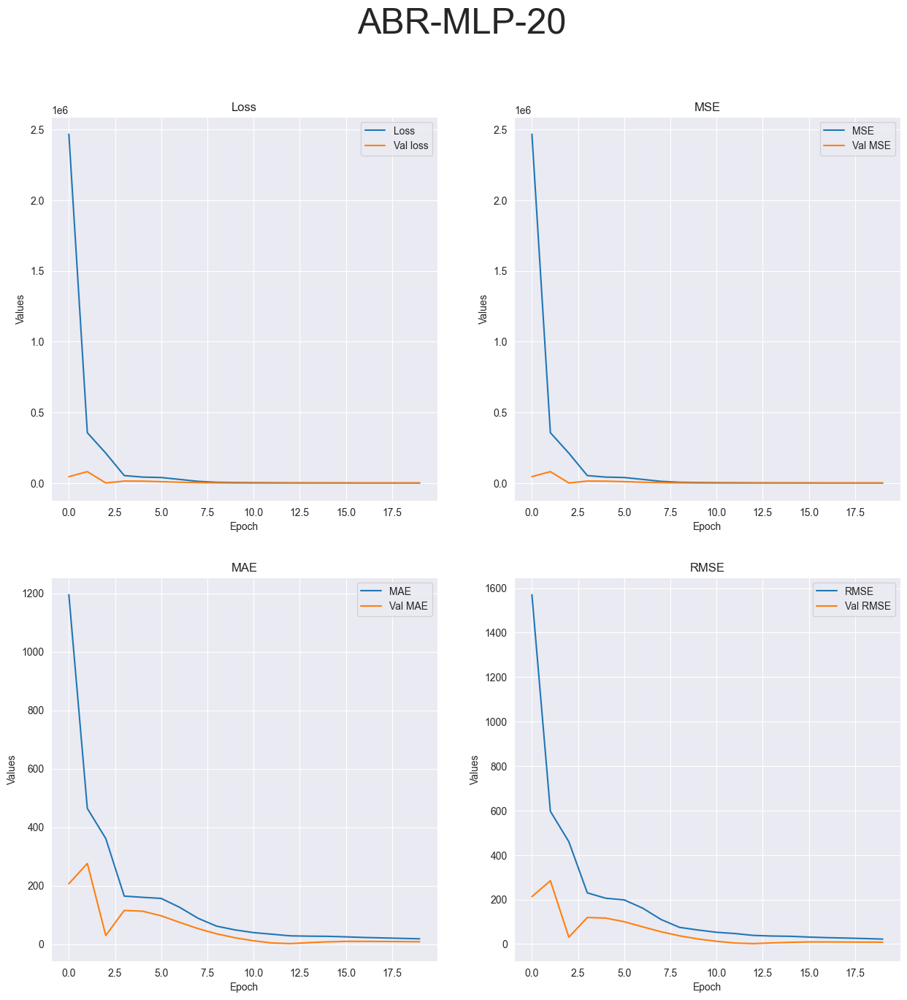

R-squared value: -232.6745


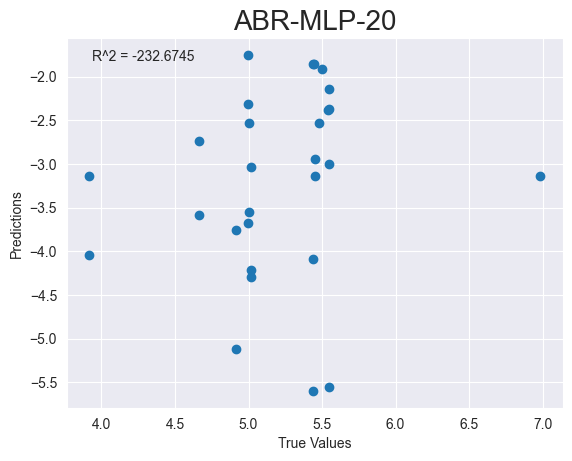

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_416 (Dense)           (None, 64)                832       
                                                                 
 dense_417 (Dense)           (None, 32)                2080      
                                                               

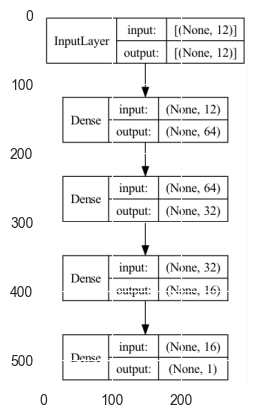

ABR-FCNN-1


2023-05-02 10:16:00.540341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 283ms/step - loss: 4984483.5000 - mse: 4984483.5000 - mae: 1703.2030 - root_mean_squared_error: 2232.5957 - val_loss: 180086.9844 - val_mse: 180086.9844 - val_mae: 409.9193 - val_root_mean_squared_error: 424.3666


2023-05-02 10:16:01.475328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 82ms/step - loss: 189018.5156 - mse: 189018.5156 - mae: 423.5589 - root_mean_squared_error: 434.7626
Test loss: [189018.515625, 189018.515625, 423.5589294433594, 434.7626037597656]
['loss', 'mse', 'mae', 'root_mean_squared_error']


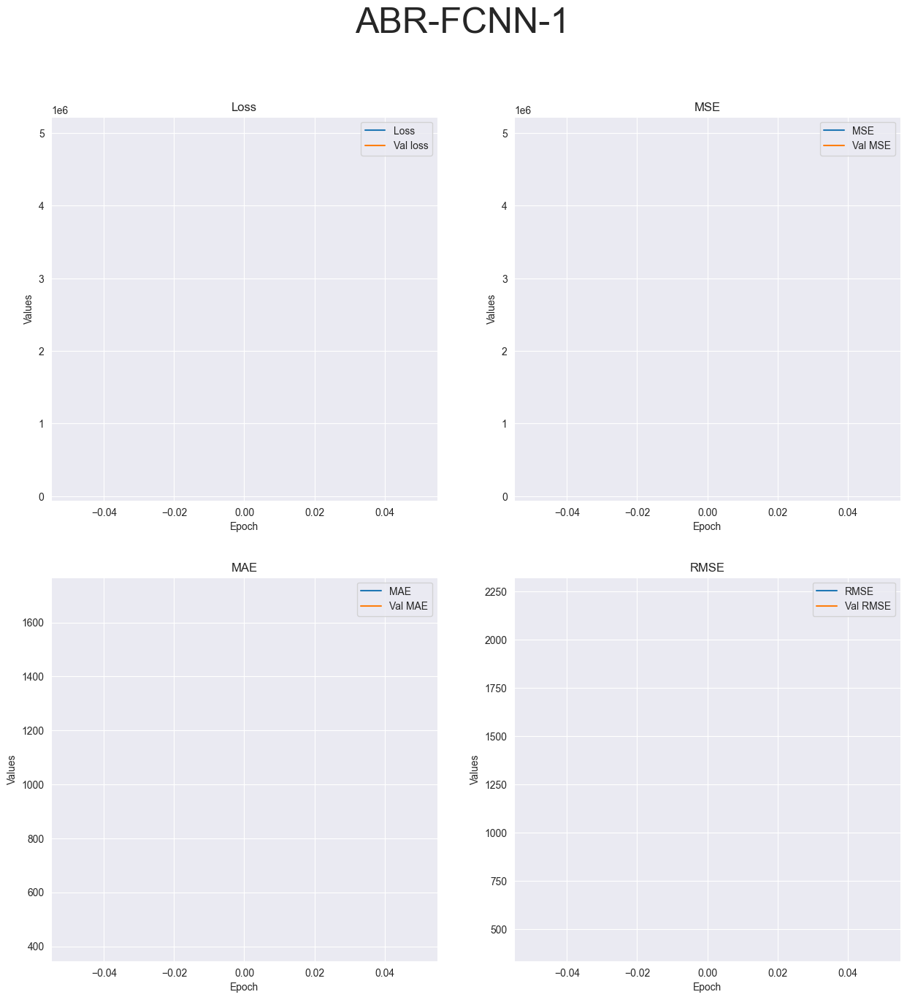

R-squared value: -288872.5313


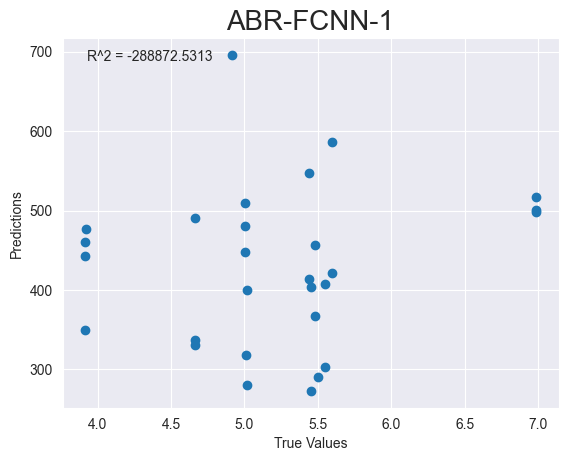

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_142"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_420 (Dense)           (None, 64)                832       
                                                                 
 dense_421 (Dense)           (None, 32)                2080      
                                                                 
 dense_422 (Dense)       

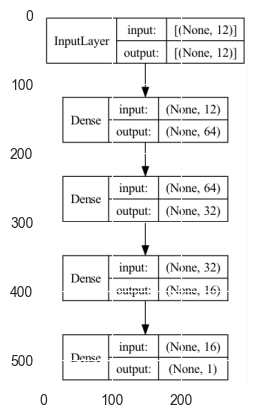

ABR-FCNN-4
Epoch 1/4


2023-05-02 10:16:03.069763: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 262ms/step - loss: 5906438.0000 - mse: 5906438.0000 - mae: 1766.9270 - root_mean_squared_error: 2430.3164 - val_loss: 141723.8750 - val_mse: 141723.8750 - val_mae: 363.6295 - val_root_mean_squared_error: 376.4623
Epoch 2/4


2023-05-02 10:16:03.913680: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 1352509.2500 - mse: 1352509.3750 - mae: 1000.1171 - root_mean_squared_error: 1162.9744 - val_loss: 1766285.2500 - val_mse: 1766285.2500 - val_mae: 1285.0798 - val_root_mean_squared_error: 1329.0166
Epoch 3/4
3/3 [==============================] - 0s 37ms/step - loss: 1173438.8750 - mse: 1173438.8750 - mae: 957.6831 - root_mean_squared_error: 1083.2538 - val_loss: 16.9059 - val_mse: 16.9059 - val_mae: 3.5104 - val_root_mean_squared_error: 4.1117
Epoch 4/4
1/1 [==============================] - 0s 101ms/step - loss: 469540.4062 - mse: 469540.4062 - mae: 675.1917 - root_mean_squared_error: 685.2302
Test loss: [469540.40625, 469540.40625, 675.1917114257812, 685.2301635742188]
['loss', 'mse', 'mae', 'root_mean_squared_error']


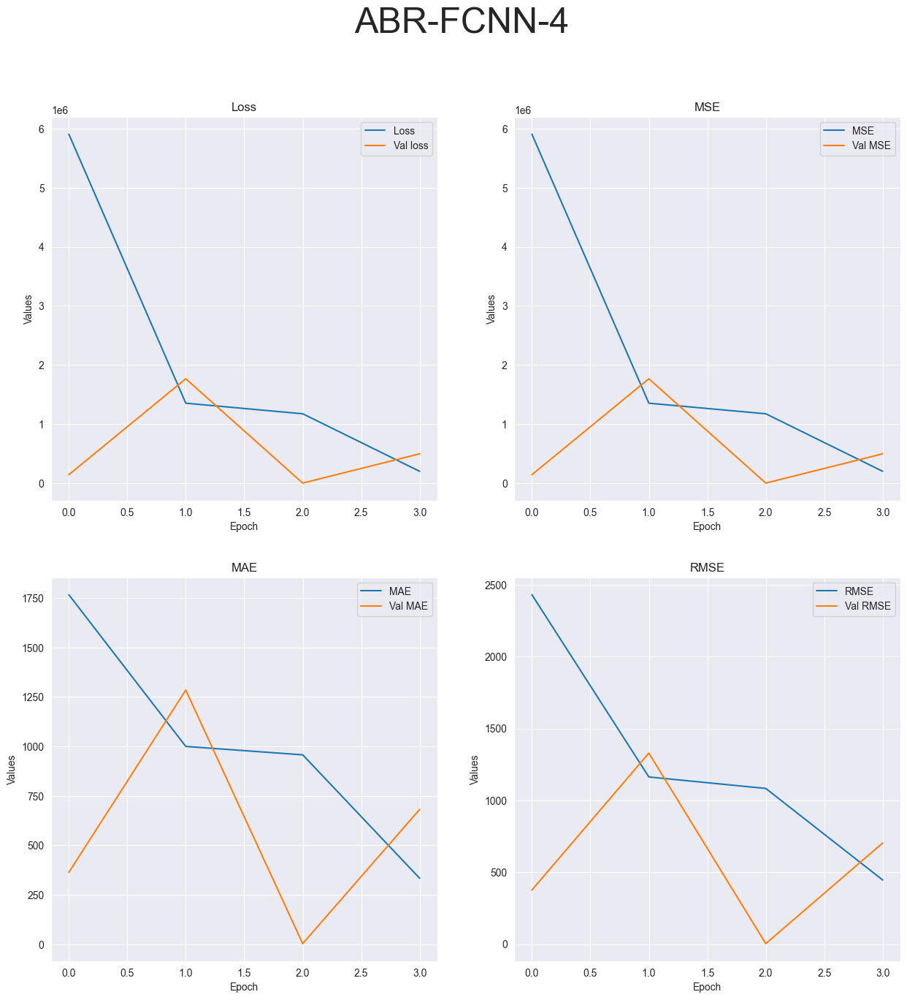

R-squared value: -677675.9041


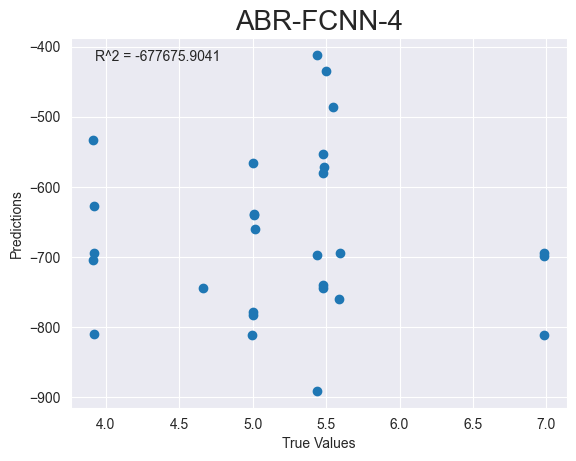

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_424 (Dense)           (None, 64)                832       
                                                                 
 dense_425 (Dense)           (None, 32)                2080      
                                                                 
 dense_426 (Dense)      

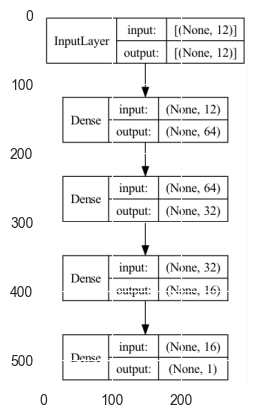

ABR-FCNN-10
Epoch 1/10


2023-05-02 10:16:06.808157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 282ms/step - loss: 6642050.0000 - mse: 6642050.0000 - mae: 1863.1306 - root_mean_squared_error: 2577.2175 - val_loss: 186765.5625 - val_mse: 186765.5625 - val_mae: 410.1829 - val_root_mean_squared_error: 432.1638
Epoch 2/10


2023-05-02 10:16:07.804510: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 73ms/step - loss: 1451948.2500 - mse: 1451948.2500 - mae: 1041.8683 - root_mean_squared_error: 1204.9681 - val_loss: 2335517.5000 - val_mse: 2335517.5000 - val_mae: 1450.3640 - val_root_mean_squared_error: 1528.2400
Epoch 3/10
3/3 [==============================] - 0s 43ms/step - loss: 1356977.1250 - mse: 1356977.1250 - mae: 1069.6499 - root_mean_squared_error: 1164.8936 - val_loss: 20615.8223 - val_mse: 20615.8223 - val_mae: 135.5124 - val_root_mean_squared_error: 143.5821
Epoch 4/10
3/3 [==============================] - 0s 32ms/step - loss: 140300.3750 - mse: 140300.3750 - mae: 319.3690 - root_mean_squared_error: 374.5669 - val_loss: 627710.9375 - val_mse: 627710.9375 - val_mae: 753.1076 - val_root_mean_squared_error: 792.2821
Epoch 5/10
3/3 [==============================] - 0s 28ms/step - loss: 572388.5625 - mse: 572388.5625 - mae: 726.6367 - root_mean_squared_error: 756.5637 - val_loss: 317635.5938 - val_mse: 317635.5938 - val_mae: 535.97

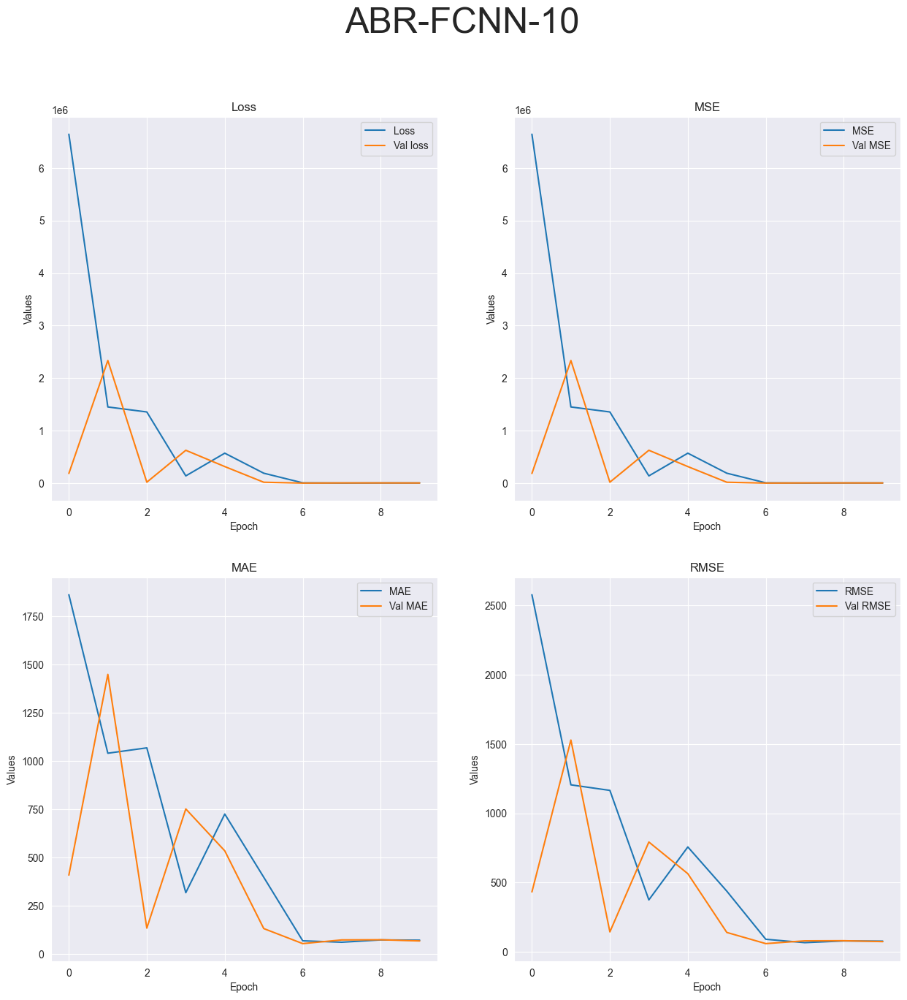

R-squared value: -7778.8296


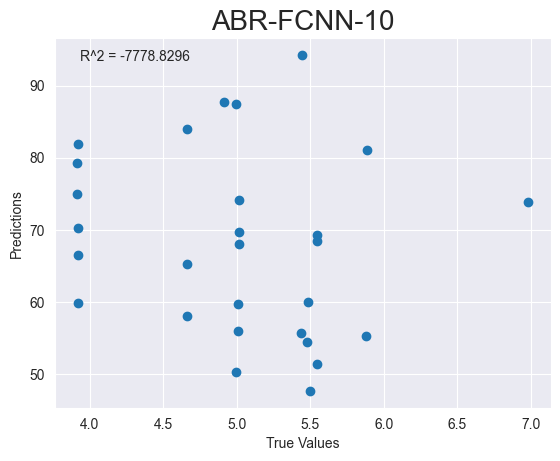

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_144"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_428 (Dense)           (None, 64)                832       
                                                                 
 dense_429 (Dense)           (None, 32)                2080      
                                                                 
 dense_430 (Dense)      

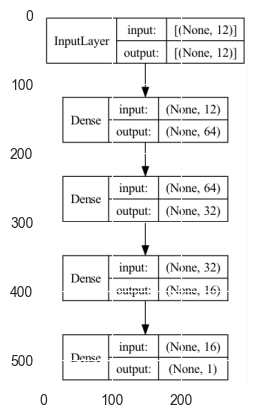

ABR-FCNN-20
Epoch 1/20


2023-05-02 10:16:10.098468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 5837579.0000 - mse: 5837579.0000 - mae: 1765.1699 - root_mean_squared_error: 2416.1082 - val_loss: 205537.0000 - val_mse: 205537.0000 - val_mae: 435.3431 - val_root_mean_squared_error: 453.3619
Epoch 2/20


2023-05-02 10:16:10.921814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 58ms/step - loss: 1408565.6250 - mse: 1408565.6250 - mae: 1032.7714 - root_mean_squared_error: 1186.8301 - val_loss: 2308353.0000 - val_mse: 2308353.0000 - val_mae: 1459.3356 - val_root_mean_squared_error: 1519.3265
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 1186743.7500 - mse: 1186743.7500 - mae: 1002.6860 - root_mean_squared_error: 1089.3777 - val_loss: 18244.3809 - val_mse: 18244.3809 - val_mae: 129.0162 - val_root_mean_squared_error: 135.0718
Epoch 4/20
3/3 [==============================] - 0s 35ms/step - loss: 147982.0000 - mse: 147982.0000 - mae: 313.7894 - root_mean_squared_error: 384.6843 - val_loss: 587789.9375 - val_mse: 587789.9375 - val_mae: 737.4594 - val_root_mean_squared_error: 766.6746
Epoch 5/20
3/3 [==============================] - 0s 30ms/step - loss: 480321.1562 - mse: 480321.1562 - mae: 667.1310 - root_mean_squared_error: 693.0521 - val_loss: 277613.0000 - val_mse: 277613.0000 - val_mae: 507.03

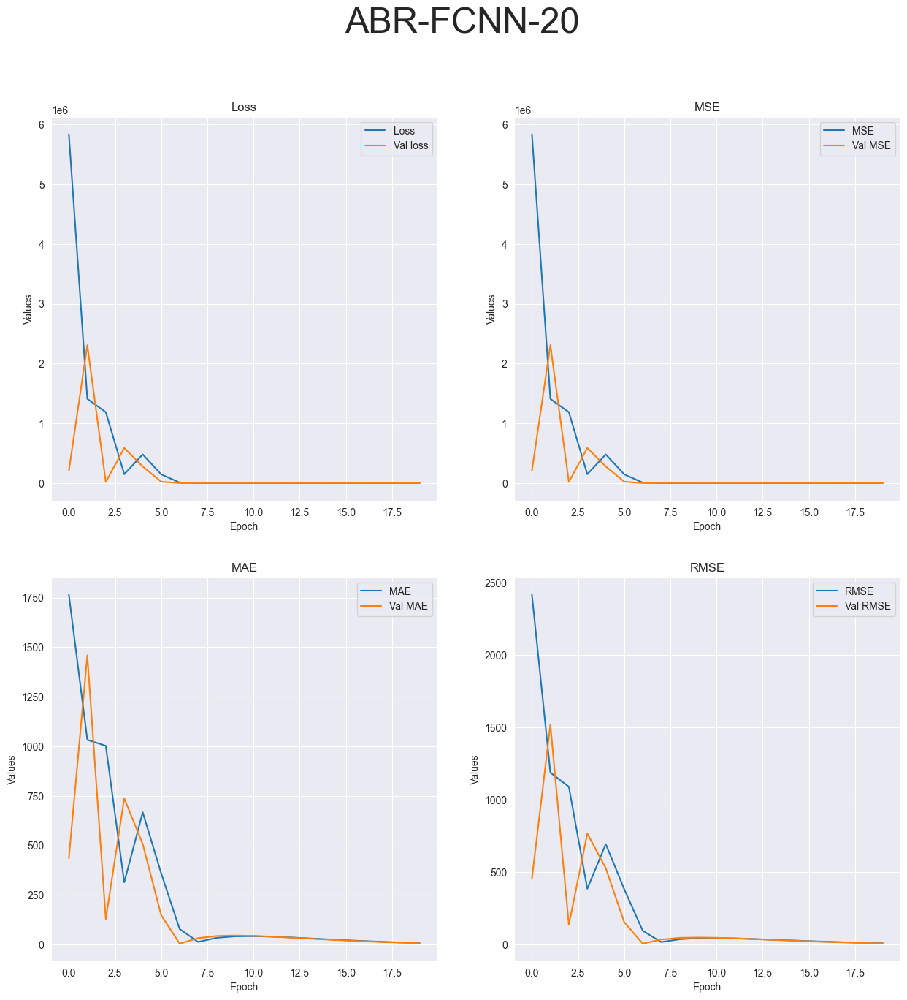

R-squared value: -137.6386


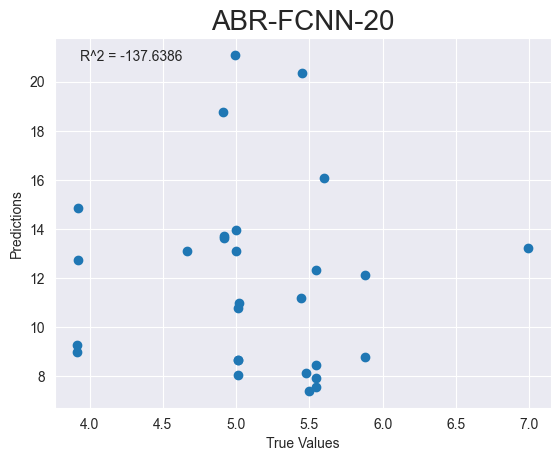

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_145"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_432 (Dense)           (None, 128)               1664      
                                                                 
 dense_433 (Dense)           (None, 1)                 129       
                                                            

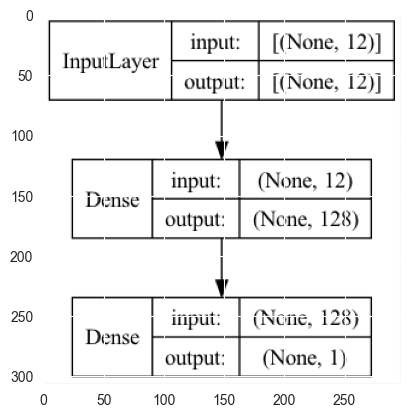

ABR-DeepSVM-1


2023-05-02 10:16:13.848714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 238ms/step - loss: 588123776.0000 - mse: 588123776.0000 - mae: 23172.6582 - root_mean_squared_error: 24251.2637 - val_loss: 291107776.0000 - val_mse: 291107776.0000 - val_mae: 16633.5352 - val_root_mean_squared_error: 17061.8809


2023-05-02 10:16:14.681197: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 86ms/step - loss: 334054752.0000 - mse: 334054752.0000 - mae: 17336.0605 - root_mean_squared_error: 18277.1641
Test loss: [334054752.0, 334054752.0, 17336.060546875, 18277.1640625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


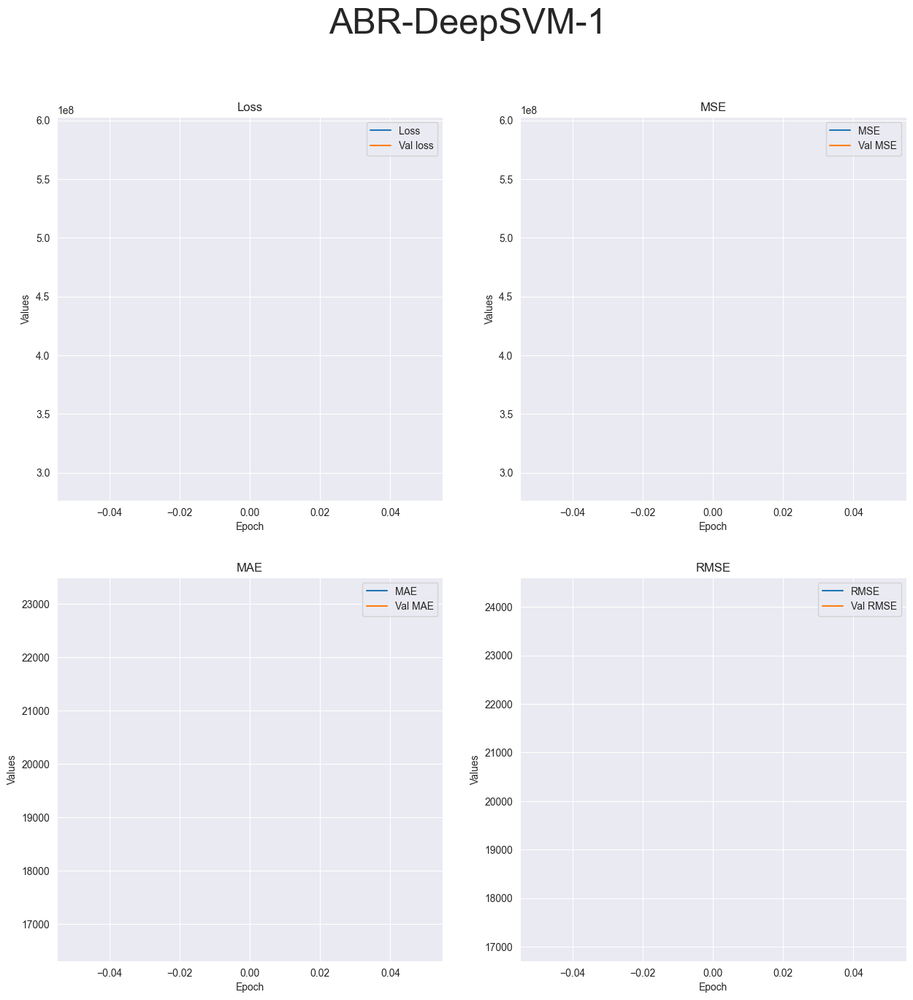

R-squared value: -940235628.6118


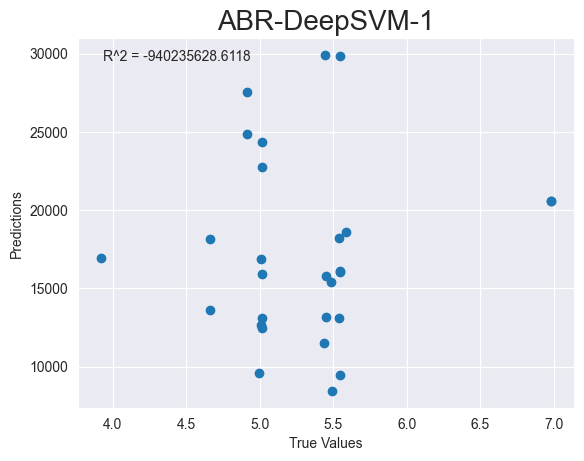

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_146"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_434 (Dense)           (None, 128)               1664      
                                                                 
 dense_435 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

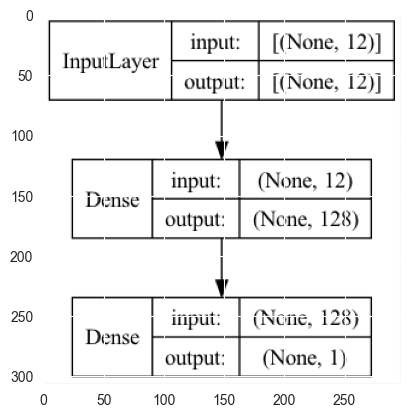

ABR-DeepSVM-4
Epoch 1/4


2023-05-02 10:16:16.288581: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 565566208.0000 - mse: 565566208.0000 - mae: 22883.9863 - root_mean_squared_error: 23781.6367 - val_loss: 330653824.0000 - val_mse: 330653824.0000 - val_mae: 17350.5586 - val_root_mean_squared_error: 18183.8887
Epoch 2/4


2023-05-02 10:16:16.959100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 83ms/step - loss: 220031184.0000 - mse: 220031184.0000 - mae: 14270.5508 - root_mean_squared_error: 14833.4482 - val_loss: 123969224.0000 - val_mse: 123969224.0000 - val_mae: 10619.8984 - val_root_mean_squared_error: 11134.1465
Epoch 3/4
3/3 [==============================] - 0s 36ms/step - loss: 84642520.0000 - mse: 84642520.0000 - mae: 8759.4463 - root_mean_squared_error: 9200.1367 - val_loss: 45048204.0000 - val_mse: 45048204.0000 - val_mae: 6398.8765 - val_root_mean_squared_error: 6711.7959
Epoch 4/4
1/1 [==============================] - 0s 97ms/step - loss: 16199115.0000 - mse: 16199115.0000 - mae: 3808.3008 - root_mean_squared_error: 4024.8125
Test loss: [16199115.0, 16199115.0, 3808.30078125, 4024.8125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


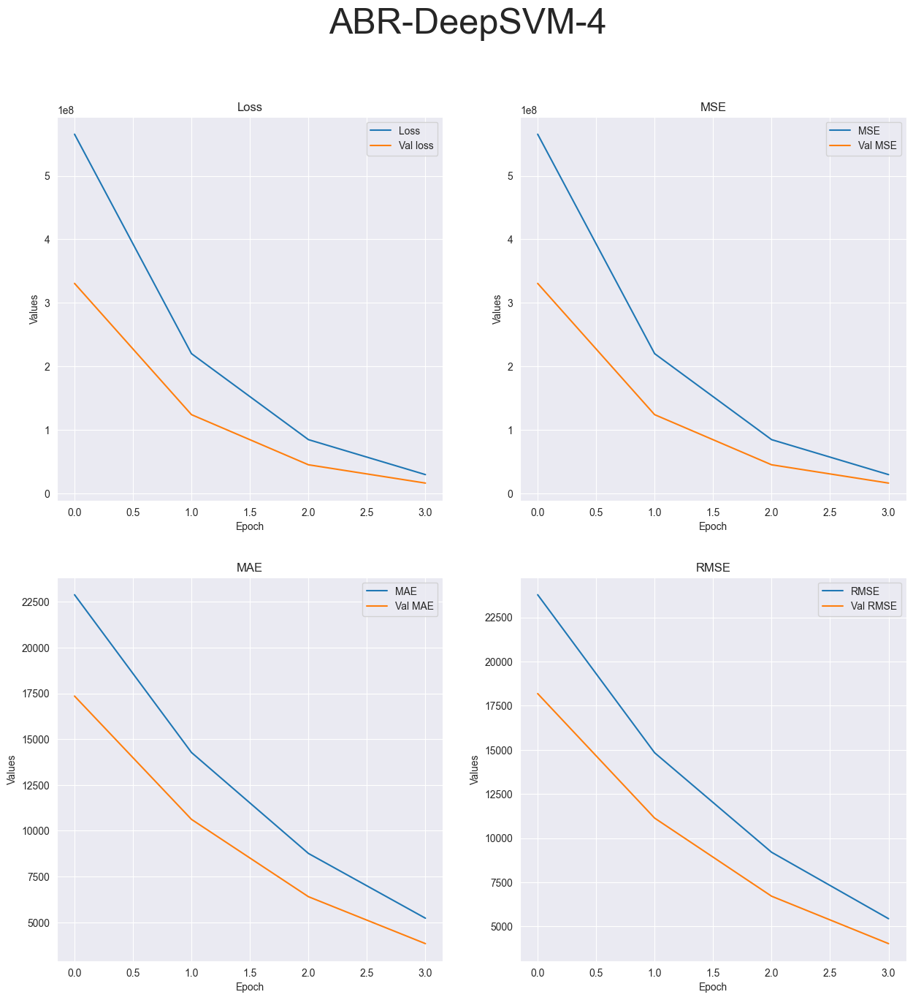

R-squared value: -64532544.1417


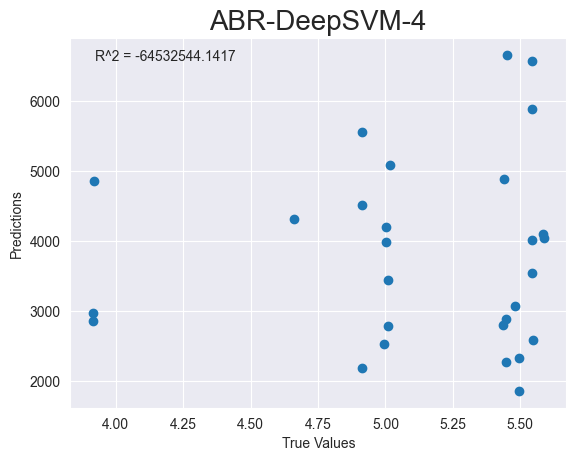

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_147"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_436 (Dense)           (None, 128)               1664      
                                                                 
 dense_437 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

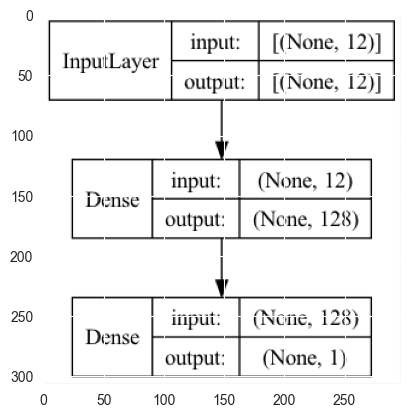

ABR-DeepSVM-10
Epoch 1/10


2023-05-02 10:16:19.820183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 240ms/step - loss: 606229696.0000 - mse: 606229696.0000 - mae: 23572.6406 - root_mean_squared_error: 24621.7324 - val_loss: 319439680.0000 - val_mse: 319439680.0000 - val_mae: 17293.5898 - val_root_mean_squared_error: 17872.8750
Epoch 2/10


2023-05-02 10:16:20.687124: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 113ms/step - loss: 239935584.0000 - mse: 239935584.0000 - mae: 14718.5479 - root_mean_squared_error: 15489.8545 - val_loss: 118890216.0000 - val_mse: 118890216.0000 - val_mae: 10547.6865 - val_root_mean_squared_error: 10903.6787
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 88417520.0000 - mse: 88417520.0000 - mae: 8945.1758 - root_mean_squared_error: 9403.0586 - val_loss: 43405496.0000 - val_mse: 43405496.0000 - val_mae: 6371.2866 - val_root_mean_squared_error: 6588.2847
Epoch 4/10
3/3 [==============================] - 0s 28ms/step - loss: 32350634.0000 - mse: 32350634.0000 - mae: 5400.4131 - root_mean_squared_error: 5687.7617 - val_loss: 15564435.0000 - val_mse: 15564435.0000 - val_mae: 3813.7805 - val_root_mean_squared_error: 3945.1787
Epoch 5/10
3/3 [==============================] - 0s 21ms/step - loss: 11737284.0000 - mse: 11737284.0000 - mae: 3223.7603 - root_mean_squared_error: 3425.9719 - val_loss: 5029107.000

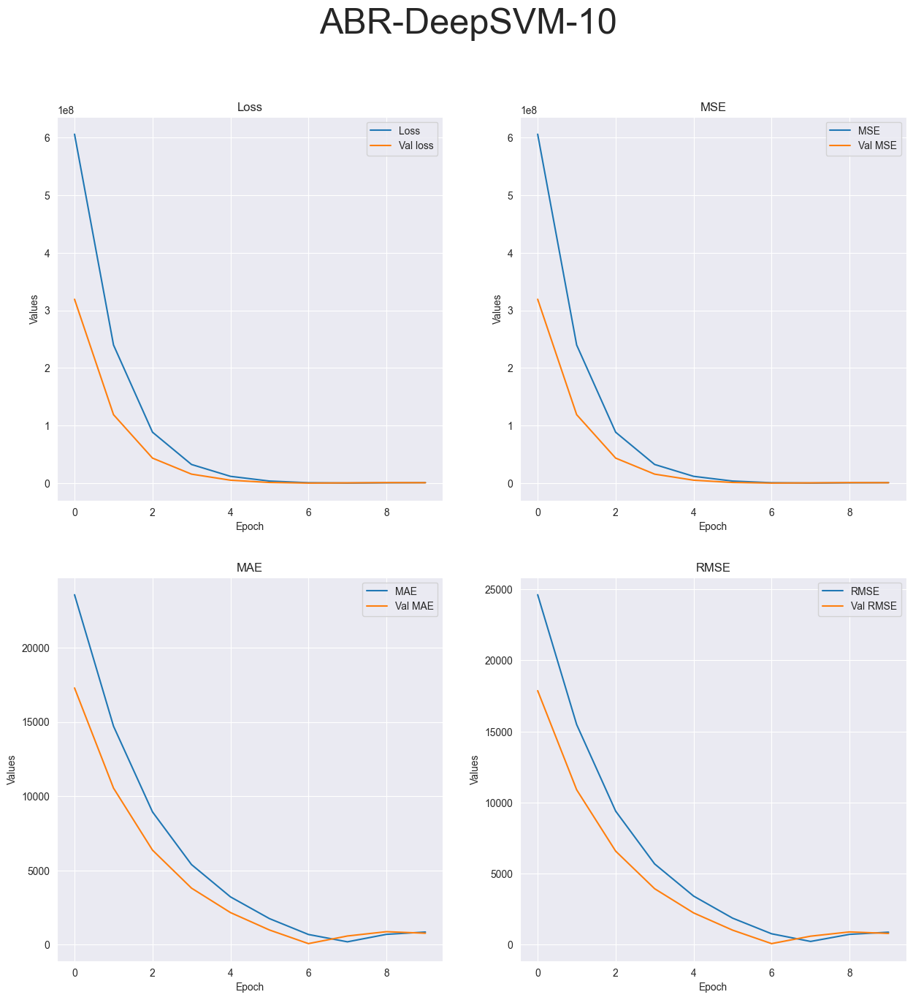

R-squared value: -1223863.1347


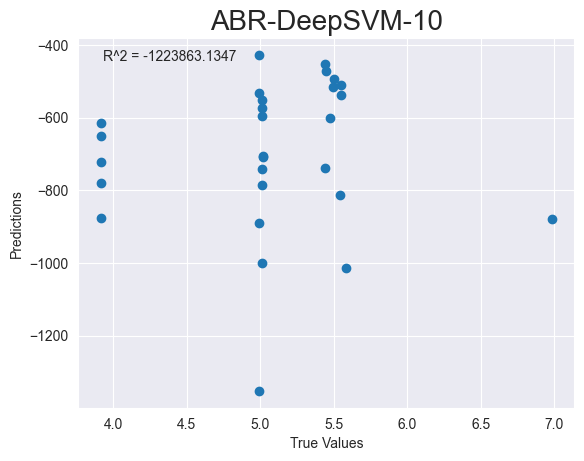

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_148"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_438 (Dense)           (None, 128)               1664      
                                                                 
 dense_439 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

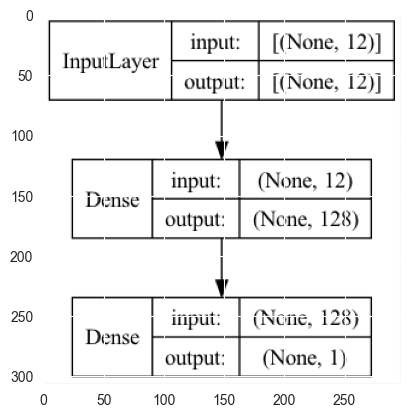

ABR-DeepSVM-20
Epoch 1/20


2023-05-02 10:16:23.328399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 249ms/step - loss: 570789312.0000 - mse: 570789312.0000 - mae: 22938.3574 - root_mean_squared_error: 23891.1973 - val_loss: 282859648.0000 - val_mse: 282859648.0000 - val_mae: 16221.9346 - val_root_mean_squared_error: 16818.4316
Epoch 2/20


2023-05-02 10:16:24.041309: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 35ms/step - loss: 225871440.0000 - mse: 225871440.0000 - mae: 14295.2979 - root_mean_squared_error: 15029.0195 - val_loss: 105078120.0000 - val_mse: 105078120.0000 - val_mae: 9883.9043 - val_root_mean_squared_error: 10250.7617
Epoch 3/20
3/3 [==============================] - 0s 28ms/step - loss: 83318672.0000 - mse: 83318672.0000 - mae: 8695.4678 - root_mean_squared_error: 9127.9062 - val_loss: 38262752.0000 - val_mse: 38262752.0000 - val_mae: 5961.8721 - val_root_mean_squared_error: 6185.6895
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 30236848.0000 - mse: 30236848.0000 - mae: 5234.1509 - root_mean_squared_error: 5498.8042 - val_loss: 13698020.0000 - val_mse: 13698020.0000 - val_mae: 3565.2954 - val_root_mean_squared_error: 3701.0837
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 10682936.0000 - mse: 10682936.0000 - mae: 3106.0552 - root_mean_squared_error: 3268.4761 - val_loss: 4403153.0000 

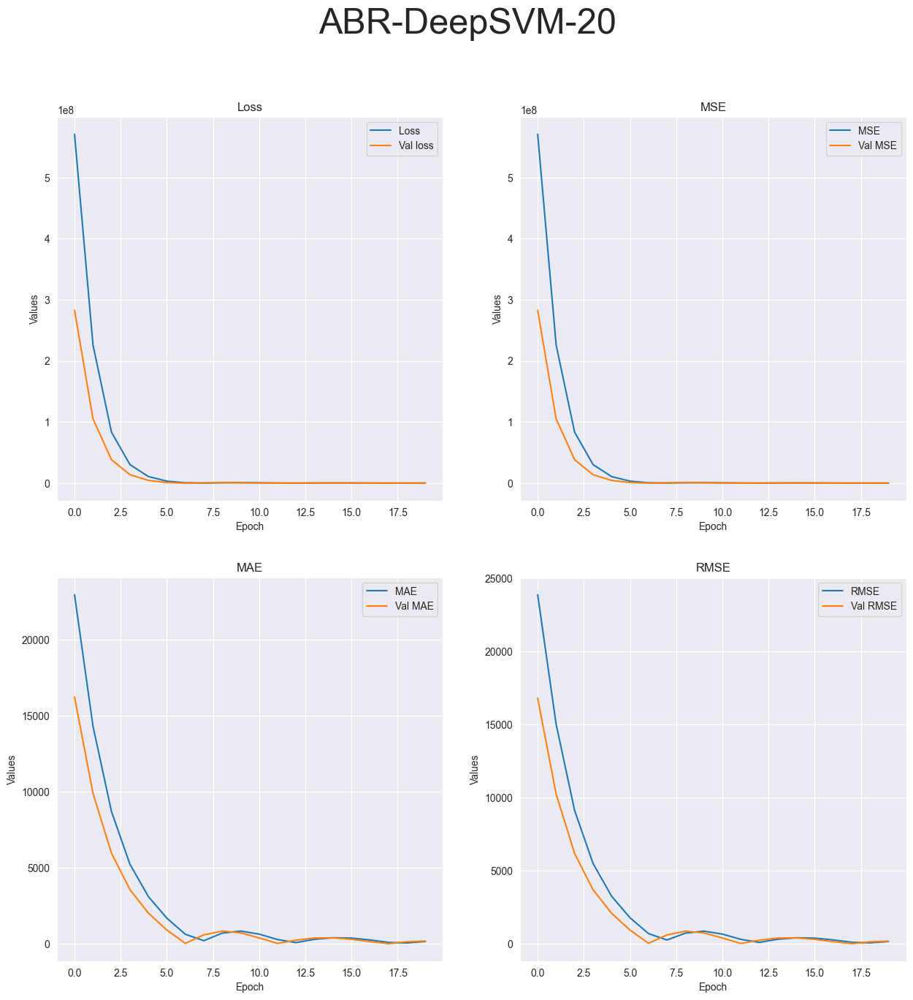

R-squared value: -88383.9283


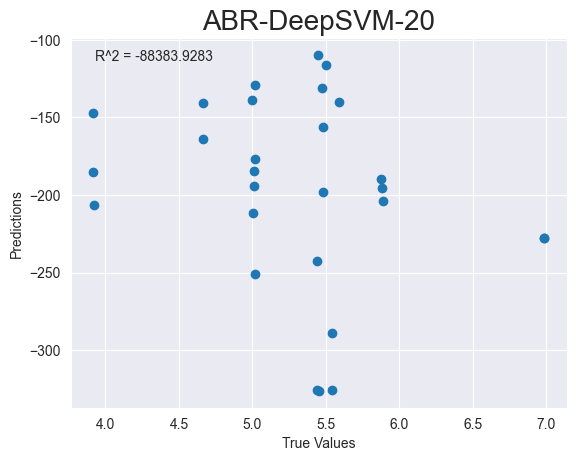

Running MachineLearning tests...
Running tests on CGBR.csv dataset...
Running Linear model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-Linear-1
Running SVR model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-SVR
plotting linear


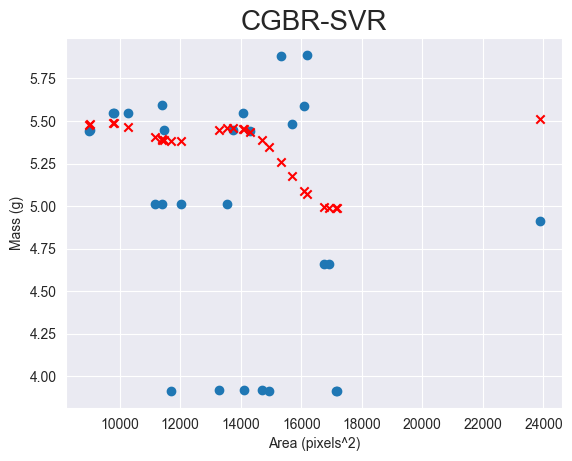

R-squared value: -0.2219


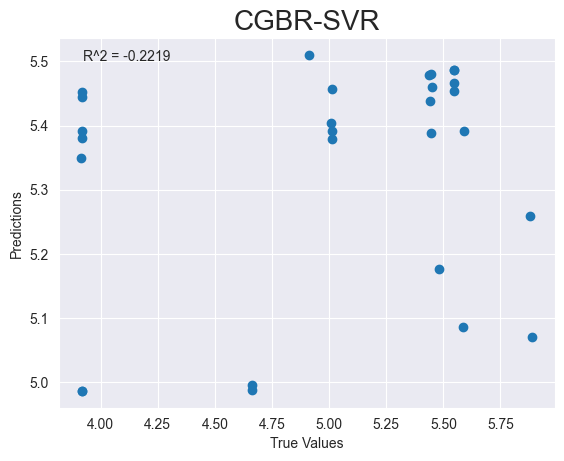

Running Images tests...
Running tests on CIBR.pkl dataset...
Running CNN model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_149"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 33, 33,

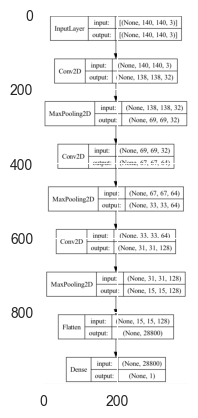

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:28.857767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741

2023-05-02 10:16:30.953547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 714ms/step - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741 - val_loss: 26.3567 - val_mse: 26.3567 - val_mae: 5.0999 - val_root_mean_squared_error: 5.1339
Epoch 2/2
1/1 [==============================] - 2s 2s/step - loss: 2.2656 - mse: 2.2656 - mae: 1.3285 - root_mean_squared_error: 1.5052
Test loss: [2.2655551433563232, 2.2655551433563232, 1.328501582145691, 1.505176067352295]
['loss', 'mse', 'mae', 'root_mean_squared_error']


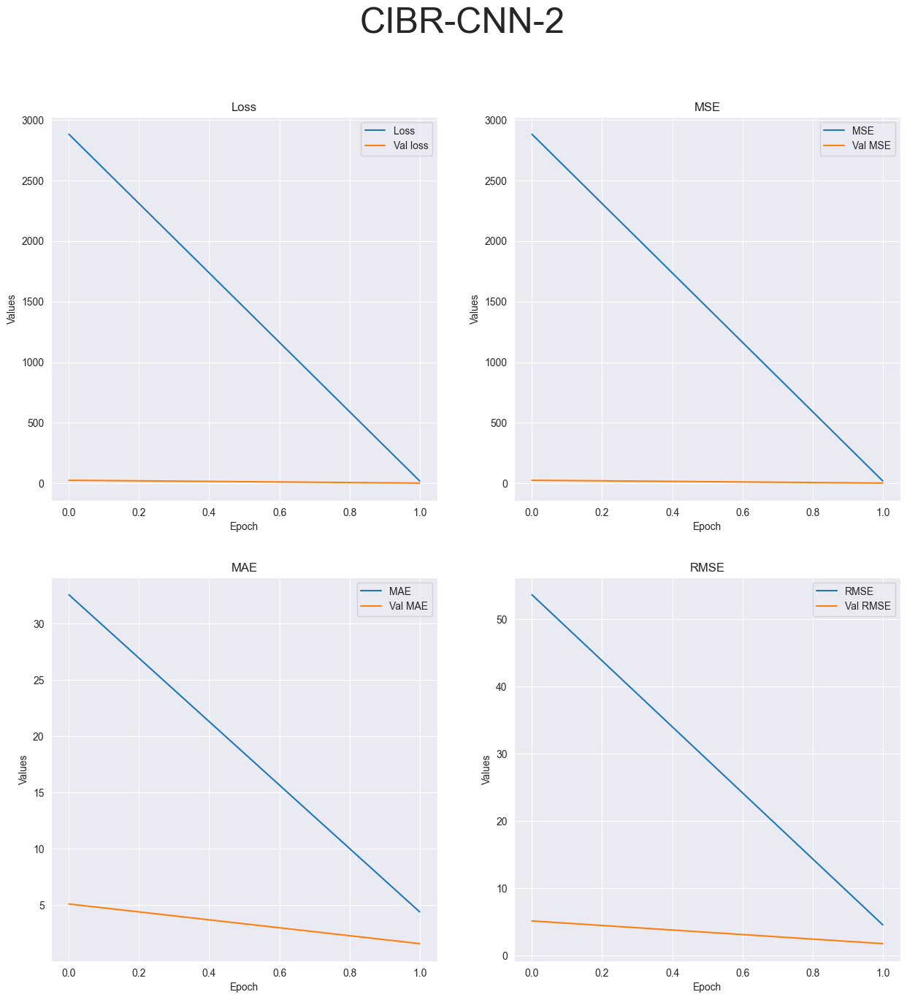

R-squared value: -3.4812


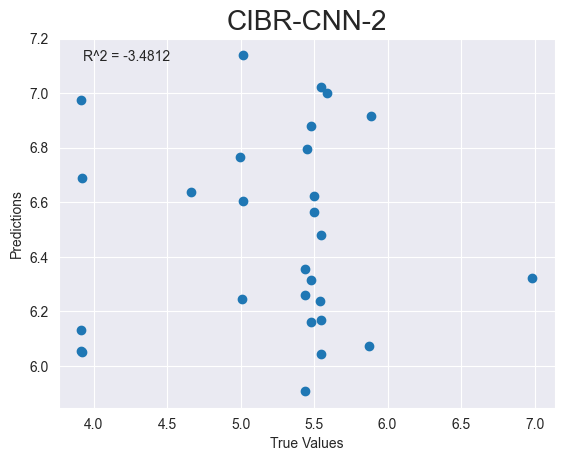

Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_150"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_16 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


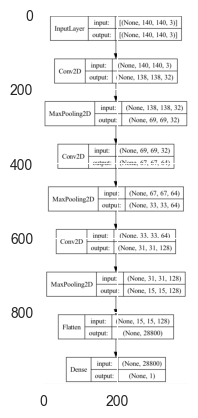

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:37.447853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548

2023-05-02 10:16:40.289807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548 - val_loss: 32.1273 - val_mse: 32.1273 - val_mae: 5.6418 - val_root_mean_squared_error: 5.6681
Epoch 2/2
1/1 [==============================] - 0s 226ms/step - loss: 9.7261 - mse: 9.7261 - mae: 3.0519 - root_mean_squared_error: 3.1187
Test loss: [9.726109504699707, 9.726109504699707, 3.051875352859497, 3.118671178817749]
['loss', 'mse', 'mae', 'root_mean_squared_error']


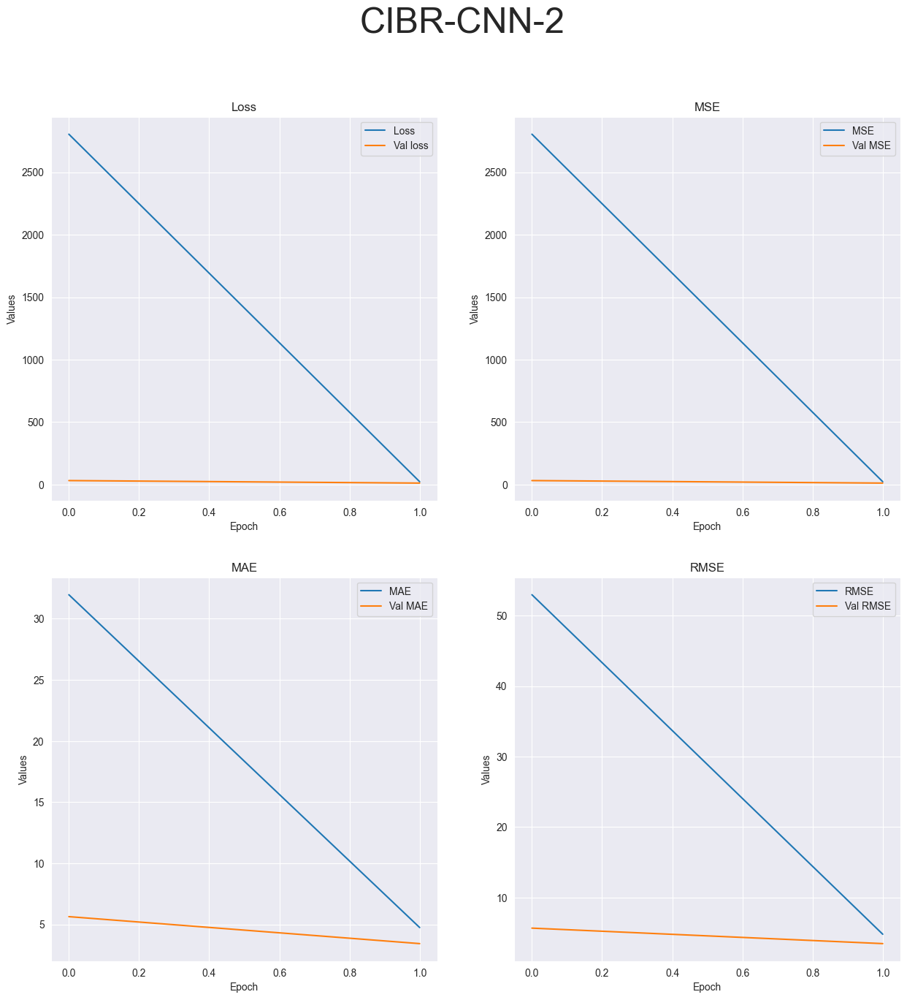

R-squared value: -19.9187


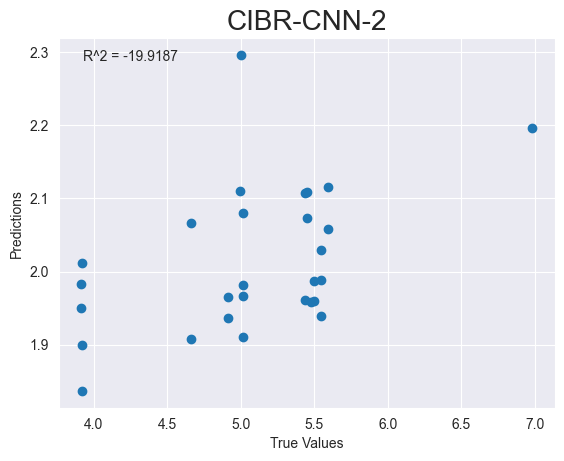

Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_151"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_19 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


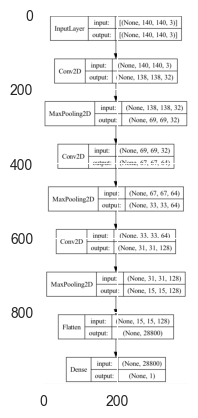

CIBR-CNN-1


2023-05-02 10:16:44.331028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2888.8225 - mse: 2888.8225 - mae: 32.5586 - root_mean_squared_error: 53.7478

2023-05-02 10:16:45.589908: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 228ms/step - loss: 32.2065 - mse: 32.2065 - mae: 5.6447 - root_mean_squared_error: 5.6751
Test loss: [32.206459045410156, 32.206459045410156, 5.644664287567139, 5.675073623657227]
['loss', 'mse', 'mae', 'root_mean_squared_error']


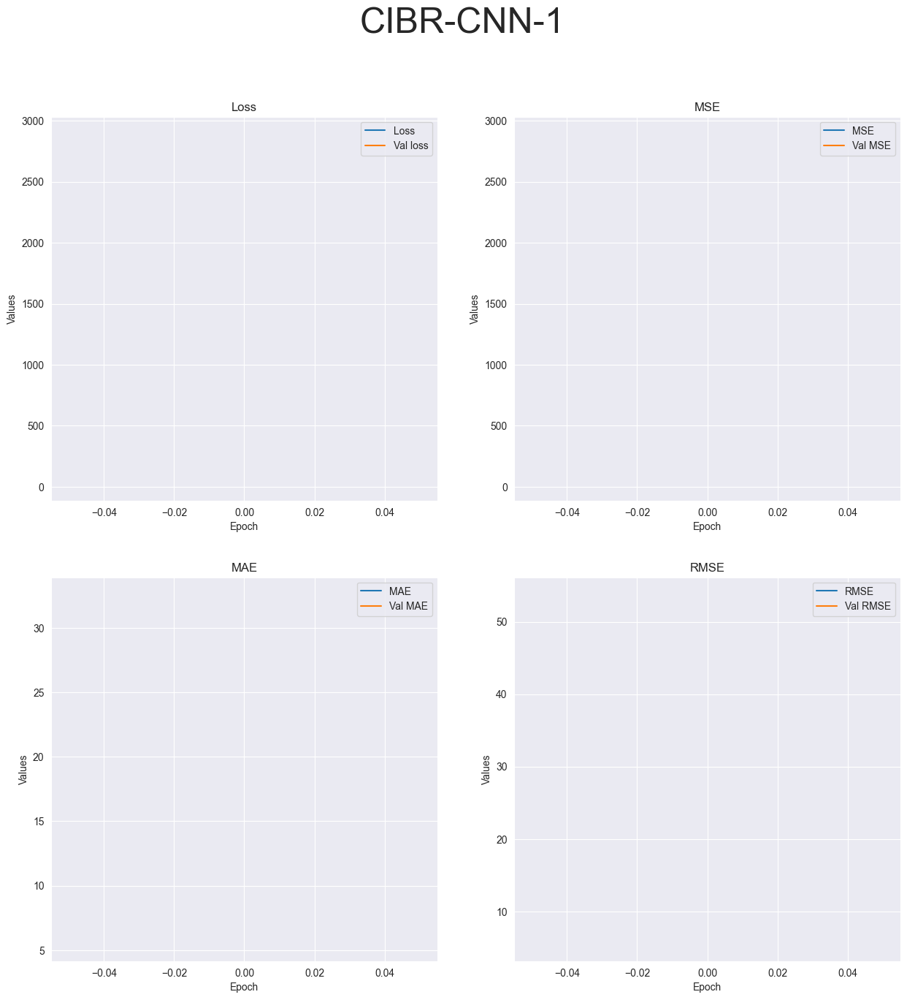

R-squared value: -98.8921


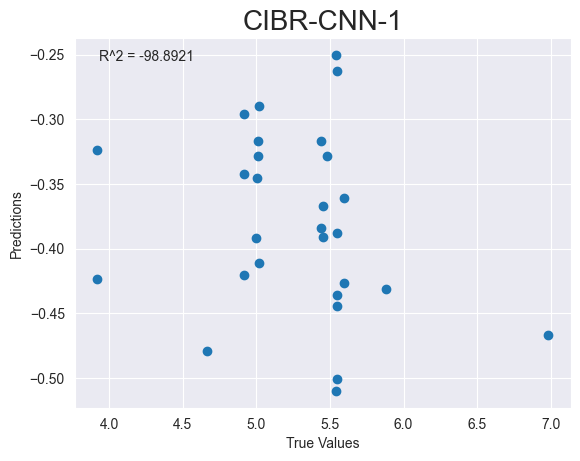

Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_152"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_22 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


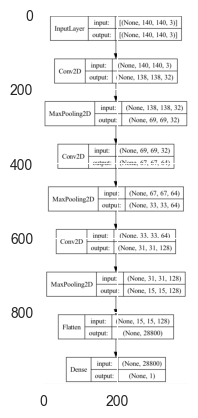

CIBR-CNN-4
Epoch 1/4


2023-05-02 10:16:48.829951: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203

2023-05-02 10:16:49.971937: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 394ms/step - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203 - val_loss: 32.6012 - val_mse: 32.6012 - val_mae: 5.6549 - val_root_mean_squared_error: 5.7097
Epoch 2/4
3/3 [==============================] - 0s 136ms/step - loss: 28.2030 - mse: 28.2030 - mae: 5.2608 - root_mean_squared_error: 5.3106 - val_loss: 16.5220 - val_mse: 16.5220 - val_mae: 4.0171 - val_root_mean_squared_error: 4.0647
Epoch 3/4
3/3 [==============================] - 0s 99ms/step - loss: 8.6688 - mse: 8.6688 - mae: 2.5160 - root_mean_squared_error: 2.9443 - val_loss: 11.6433 - val_mse: 11.6433 - val_mae: 3.3587 - val_root_mean_squared_error: 3.4122
Epoch 4/4
1/1 [==============================] - 0s 178ms/step - loss: 1.3824 - mse: 1.3824 - mae: 0.9653 - root_mean_squared_error: 1.1757
Test loss: [1.3823765516281128, 1.3823765516281128, 0.9653481245040894, 1.1757451295852661]
['loss', 'mse', 'mae', 'root_mean_squared_error']


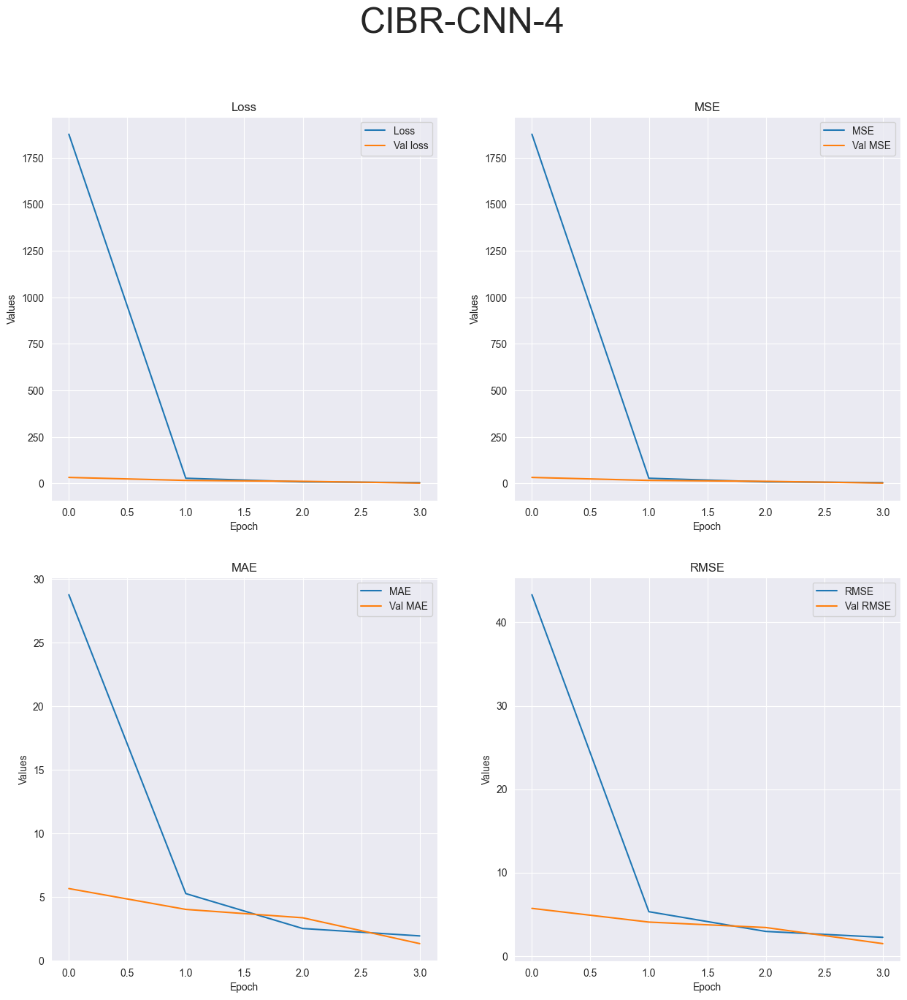

R-squared value: -1.8824


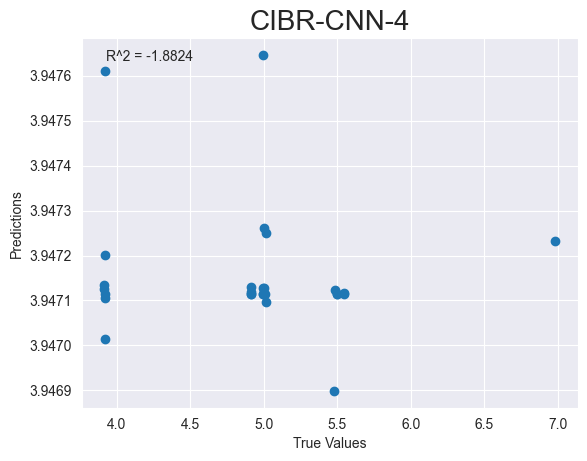

Running RestNet model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-1
Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86,

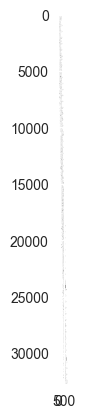

CIBR-DenseNet-2


ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type numpy.ndarray).

In [56]:
for experiment_name, experiment_data in RawExperiments.items():
    print(f"Running experiments for {experiment_name}...")
    for test_name, test_data in experiment_data["Tests"].items():
        print(f"Running {test_name} tests...")
        for dataset in test_data["Datasets"]:
            print(f"Running tests on {dataset + test_data['Extention']} dataset...")
            for model in test_data["Models"]:
                print(f"Running {model} model tests...")
                if "Epochs" in test_data:
                    for epochs in test_data["Epochs"]:
                        print(f"Running tests with {epochs} epochs...")

                        # Call the function that runs the test with the given dataset, model, and epoch

                        dataframe = None
                        if(test_data["Extention"] == '.pkl'):
                            dataframe = pd.read_pickle(dataset + test_data['Extention'])
                        else:
                            dataframe = pd.read_csv(dataset + test_data['Extention'])
                        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                        test.buildData()
                        test.buildModel()
                        test.train(epochs)
                        test.plot(experiment_name +'-'+)


In [ ]:
import json

# create a dictionary to store the results of each test
results = {}

# iterate over each test in the JSON
for test_name, test_params in Experiments['Raw']['Blueberries']['Tests'].items():
    # iterate over the datasets for this test
    for dataset_name in test_params['Datasets']:
        # load the dataset using the dataset_name and test_params['Extention']
        #dataset = load_dataset(dataset_name + test_params['Extention'])
        
        # iterate over the models for this test
        for model_name in test_params['Models']:
            # create an instance of the class for this model
            #model = create_model_instance(model_name)
            
            # iterate over the epochs for this test
            for epoch in test_params.get('Epochs', [None]):
                # run the model on the dataset for the specified number of epochs
                #result = model.run(dataset, epoch)
                dataframe = None
                if(test_data["Extention"] == '.pkl'):
                    dataframe = pd.read_pickle(dataset + test_data['Extention'])
                else:
                    dataframe = pd.read_csv(dataset + test_data['Extention'])
                test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                test.buildData()
                test.buildModel()
                test.train(epochs)
                test.plot(save = True, show = False)

                # add the results to the dictionary
                if test_name not in results:
                    results[test_name] = {}
                if dataset_name not in results[test_name]:
                    results[test_name][dataset_name] = {}
                if model_name not in results[test_name][dataset_name]:
                    results[test_name][dataset_name][model_name] = {}
                if epoch not in results[test_name][dataset_name][model_name]:
                    results[test_name][dataset_name][model_name][epoch] = {}
                    
                results[test_name][dataset_name][model_name][epoch] = test.gather_data()
                
# calculate the average performance for each test based on the evaluation metrics
average_results = {}

for test_name, test_results in results.items():
    # create a dictionary to store the average performance for this test
    average_results[test_name] = {}
    
    for dataset_name, dataset_results in test_results.items():
        # create a dictionary to store the average performance for this dataset
        average_results[test_name][dataset_name] = {}
        
        # get the evaluation metrics for the first model and epoch
        metrics = list(dataset_results.values())[0][0]
        
        # calculate the average performance for each metric across all models and epochs
        for metric in metrics:
            metric_results = []
            
            for model_results in dataset_results.values():
                for epoch_results in model_results.values():
                    metric_results.append(epoch_results[metric])
            
            metric_average = sum(metric_results) / len(metric_results)
            
            average_results[test_name][dataset_name][metric] = metric_average


In [95]:


import os
import pandas as pd
import numpy as np
import json

# Data loading function
def load_data(dataset_name, ext):
    # Replace this with your own data loading code
    if ext == ".csv":
        data = pd.read_csv(dataset_name + ext)
    elif ext == ".pkl":
        data = pd.read_pickle(dataset_name + ext)
    else:
        raise ValueError("Invalid extension: {}".format(ext))
    return data

# Experiment runner function
def run_experiments(experiments, results_dir):
    for experiment_name, experiment in experiments.items():
        print("Running experiment:", experiment_name)
        for fruit_name, fruit in experiment.items():
            print("Fruit:", fruit_name)
            for test_name, test in fruit["Tests"].items():
                print("Test:", test_name)
                for dataset_name in test["Datasets"]:
                    print("Dataset:", dataset_name)
                    print(test['Extention'])
                    data = load_data(dataset_name, test["Extention"])
                    for model_name in test["Models"]:
                        print("Model:", model_name)
                        for epoch in test["Epochs"]:
                            print("Epoch:", epoch)
                            result = execute_test(model_name, data, epoch)
                            save_result(result, experiment_name, fruit_name, test_name, dataset_name, model_name, epoch, results_dir)

# Experiment executer function
def execute_test(model_name, data, epoch):
     dataframe = None
     if(test_data["Extention"] == '.pkl'):
        dataframe = pd.read_pickle(dataset + test_data['Extention'])
     else:
        dataframe = pd.read_csv(dataset + test_data['Extention'])
        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
        test.buildData()
        test.buildModel()
        test.train(epochs)
        test.plot(save = True, show = False)
        result = test.gather_data()
        return result

# Result saving function
def save_result(result, experiment_name, fruit_name, test_name, dataset_name, model_name, epoch, results_dir):
    # Create the directory structure for the results if it doesn't exist
    experiment_dir = os.path.join(results_dir, experiment_name)
    fruit_dir = os.path.join(experiment_dir, fruit_name)
    test_dir = os.path.join(fruit_dir, test_name)
    if not os.path.exists(test_dir):
        os.makedirs(test_dir)

    # Save the result to a file
    result_file = os.path.join(test_dir, "{}_{}_{}_{}_{}.json".format(dataset_name, model_name, epoch, result["loss"], result["accuracy"]))
    with open(result_file, "w") as f:
        json.dump(result, f)

# Main function
if __name__ == "__main__":

    experiments = {
        "Raw" : {
            "Blueberries": {
                    "Tests" : {
                            "DeepLearning": {
                                    "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                    "Extention" : ".csv",
                                    "Models" : ["MLP", "FCNN", "DeepSVM"],
                                    "Epochs" : [2, 4, 10, 20]
                            },
                            "MachineLearning": {
                                    "Datasets" : ["CGBR"],
                                    "Extention" : ".csv",
                                    "Models" : ["Linear", "SVR"],
                                    "Epochs" : [1]
                            },
                            "Images" : {
                                    "Datasets" : ["CIBR"],
                                    "Extention" : ".pkl",
                                    "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                    "Epochs" : [2, 3, 4, 5]
                            }
                    }
            },
            "Raspberries": {
                    "Tests" : {
                            "DeepLearning": {
                                    "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                    "Extention" : ".csv",
                                    "Models" : ["MLP", "FCNN", "DeepSVM"],
                                    "Epochs" : [2, 4, 10, 20]
                            },
                            "MachineLearning": {
                                    "Datasets" : ["CGRR"],
                                    "Extention" : ".csv",
                                    "Models" : ["Linear", "SVR"],
                                    "Epochs" : [1]
                            },
                            "Images" : {
                                    "Datasets" : ["CIRR"],
                                    "Extention" : ".pkl",
                                    "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                    "Epochs" : [2, 3, 4, 5]
                            }
                    }
            }
        },
        "YOLO" : {
            "Blueberries": {
                    "Tests" : {
                            "DeepLearning": {
                                    "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                    "Extention" : ".csv",
                                    "Models" : ["MLP", "FCNN", "DeepSVM"],
                                    "Epochs" : [2, 4, 10, 20]
                            },
                            "MachineLearning": {
                                    "Datasets" : ["CGBY"],
                                    "Extention" : ".csv",
                                    "Models" : ["Linear", "SVR"],
                                    "Epochs" : [1]
                            },
                            "Images" : {
                                    "Datasets" : ["CIBY"],
                                    "Extention" : ".pkl",
                                    "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                    "Epochs" : [2, 3, 4, 5]
                            }
                    }
            },
            "Raspberries": {
                    "Tests" : {
                            "DeepLearning": {
                                    "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                    "Extention" : ".csv",
                                    "Models" : ["MLP", "FCNN", "DeepSVM"],
                                    "Epochs" : [2, 4, 10, 20]
                            },
                            "MachineLearning": {
                                    "Datasets" : ["CGRY"],
                                    "Extention" : ".csv",
                                    "Models" : ["Linear", "SVR"],
                                    "Epochs" : [1]
                            },
                            "Images" : {
                                    "Datasets" : ["CIRY"],
                                    "Extention" : ".pkl",
                                    "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                    "Epochs" : [2, 3, 4, 5]
                            }
                    }
            }
        }
    }


    results_dir = "./"

    run_experiments(experiments, results_dir)





Running experiment: Raw
Fruit: Blueberries
Test: DeepLearning
Dataset: CGBR
.csv
Model: MLP
Epoch: 2


TypeError: 'NoneType' object is not subscriptable

Running experiment: Raw
Berry Type: Blueberries
Test Name: DeepLearning
Dataset Name: CGBR
Model Name: MLP
Epoch: 2
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 2
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-MLP-2
Epoch 1/2


2023-05-02 15:45:41.901737: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 307ms/step - loss: 3085258.0000 - mse: 3085258.0000 - mae: 1374.4303 - root_mean_squared_error: 1756.4902 - val_loss: 67092.7188 - val_mse: 67092.7188 - val_mae: 247.7979 - val_root_mean_squared_error: 259.0226
Epoch 2/2


2023-05-02 15:45:43.163243: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 98ms/step - loss: 171308.3594 - mse: 171308.3594 - mae: 400.5224 - root_mean_squared_error: 413.8941
Test loss: [171308.359375, 171308.359375, 400.5223693847656, 413.8941345214844]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


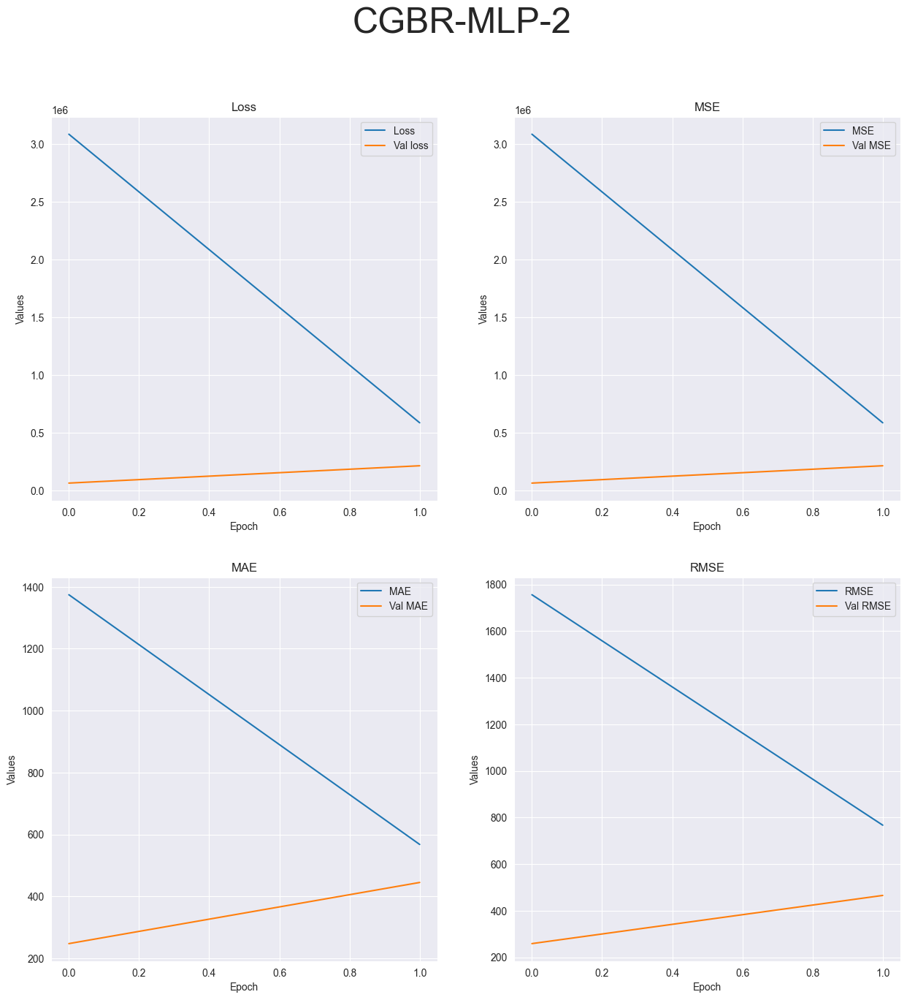

R-squared value: -411804.8608


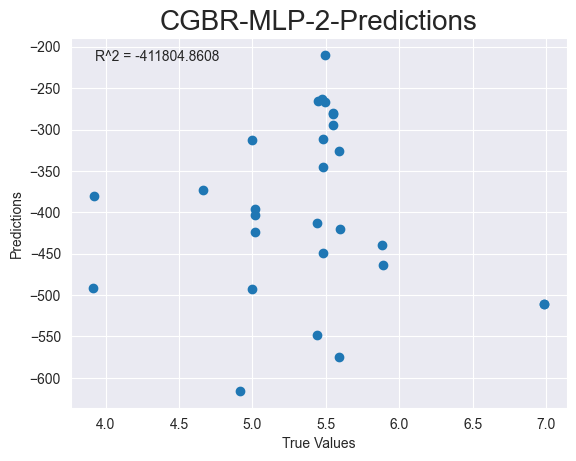

Epoch: 4
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 4
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-MLP-4
Epoch 1/4


2023-05-02 15:45:44.996907: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 297ms/step - loss: 2211644.0000 - mse: 2211644.0000 - mae: 1167.5111 - root_mean_squared_error: 1487.1597 - val_loss: 275122.7500 - val_mse: 275122.7500 - val_mae: 502.2436 - val_root_mean_squared_error: 524.5214
Epoch 2/4


2023-05-02 15:45:45.958173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 64ms/step - loss: 591775.2500 - mse: 591775.2500 - mae: 584.2825 - root_mean_squared_error: 769.2693 - val_loss: 195232.2969 - val_mse: 195232.2969 - val_mae: 423.1539 - val_root_mean_squared_error: 441.8510
Epoch 3/4
3/3 [==============================] - 0s 78ms/step - loss: 302592.6250 - mse: 302592.6250 - mae: 399.7987 - root_mean_squared_error: 550.0842 - val_loss: 31314.2383 - val_mse: 31314.2383 - val_mae: 168.8302 - val_root_mean_squared_error: 176.9583
Epoch 4/4
1/1 [==============================] - 0s 107ms/step - loss: 56071.9922 - mse: 56071.9922 - mae: 224.9469 - root_mean_squared_error: 236.7953
Test loss: [56071.9921875, 56071.9921875, 224.9468536376953, 236.79525756835938]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


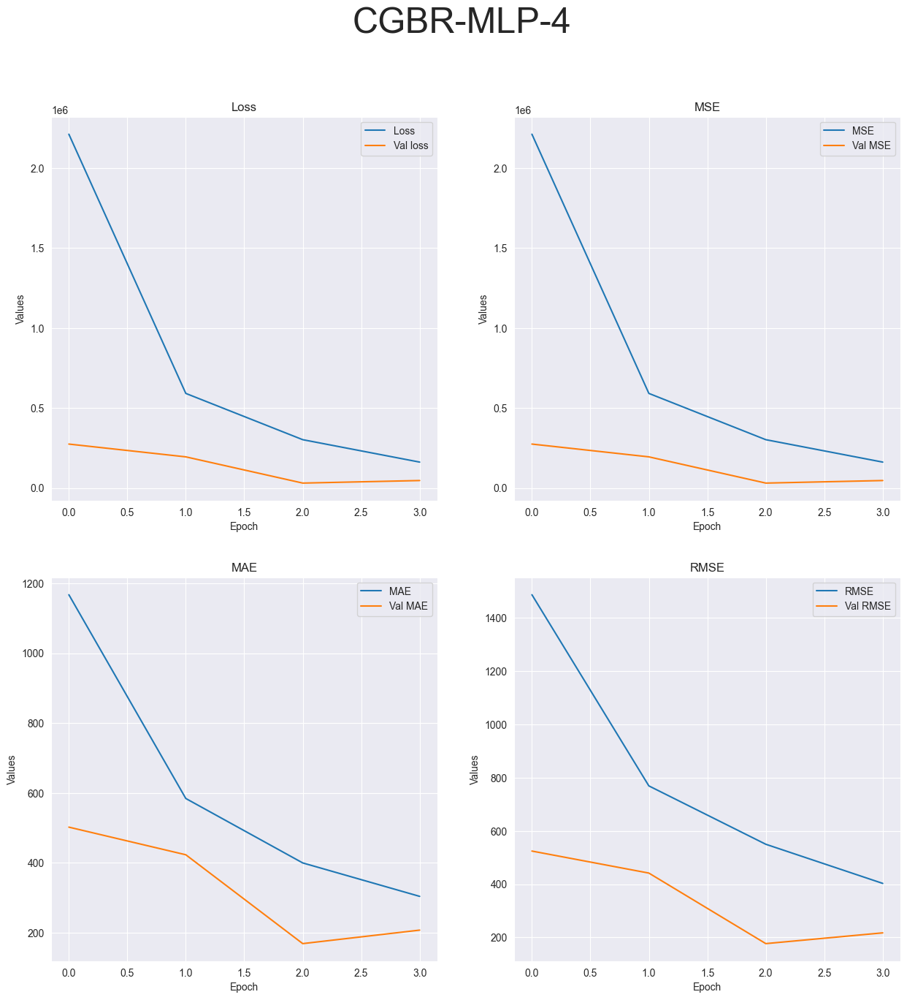

R-squared value: -143928.6829


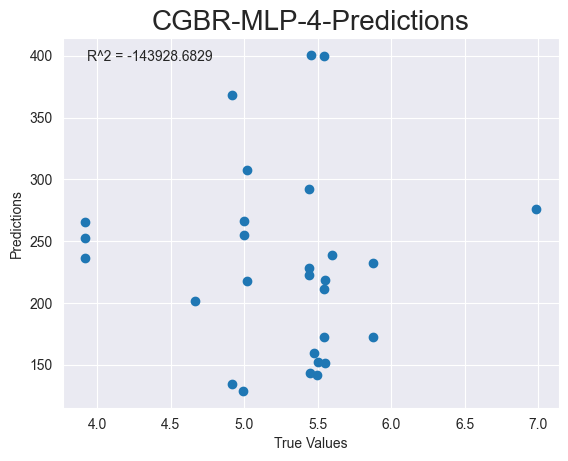

Epoch: 10
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 10
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-MLP-10
Epoch 1/10


2023-05-02 15:45:51.765372: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 248ms/step - loss: 3045123.2500 - mse: 3045123.2500 - mae: 1398.2772 - root_mean_squared_error: 1745.0282 - val_loss: 96838.6484 - val_mse: 96838.6484 - val_mae: 302.9744 - val_root_mean_squared_error: 311.1891
Epoch 2/10


2023-05-02 15:45:52.770445: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 58ms/step - loss: 648737.0000 - mse: 648737.0000 - mae: 616.9432 - root_mean_squared_error: 805.4421 - val_loss: 510239.9062 - val_mse: 510239.9062 - val_mae: 695.0638 - val_root_mean_squared_error: 714.3108
Epoch 3/10
3/3 [==============================] - 0s 50ms/step - loss: 540505.8750 - mse: 540505.8750 - mae: 592.2707 - root_mean_squared_error: 735.1910 - val_loss: 835.4995 - val_mse: 835.4995 - val_mae: 27.7715 - val_root_mean_squared_error: 28.9050
Epoch 4/10
3/3 [==============================] - 0s 39ms/step - loss: 131644.7344 - mse: 131644.7344 - mae: 287.2914 - root_mean_squared_error: 362.8288 - val_loss: 90796.9922 - val_mse: 90796.9922 - val_mae: 292.7641 - val_root_mean_squared_error: 301.3254
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 107861.0938 - mse: 107861.0938 - mae: 258.6646 - root_mean_squared_error: 328.4221 - val_loss: 52490.3750 - val_mse: 52490.3750 - val_mae: 222.5224 - val_root_mean_squ

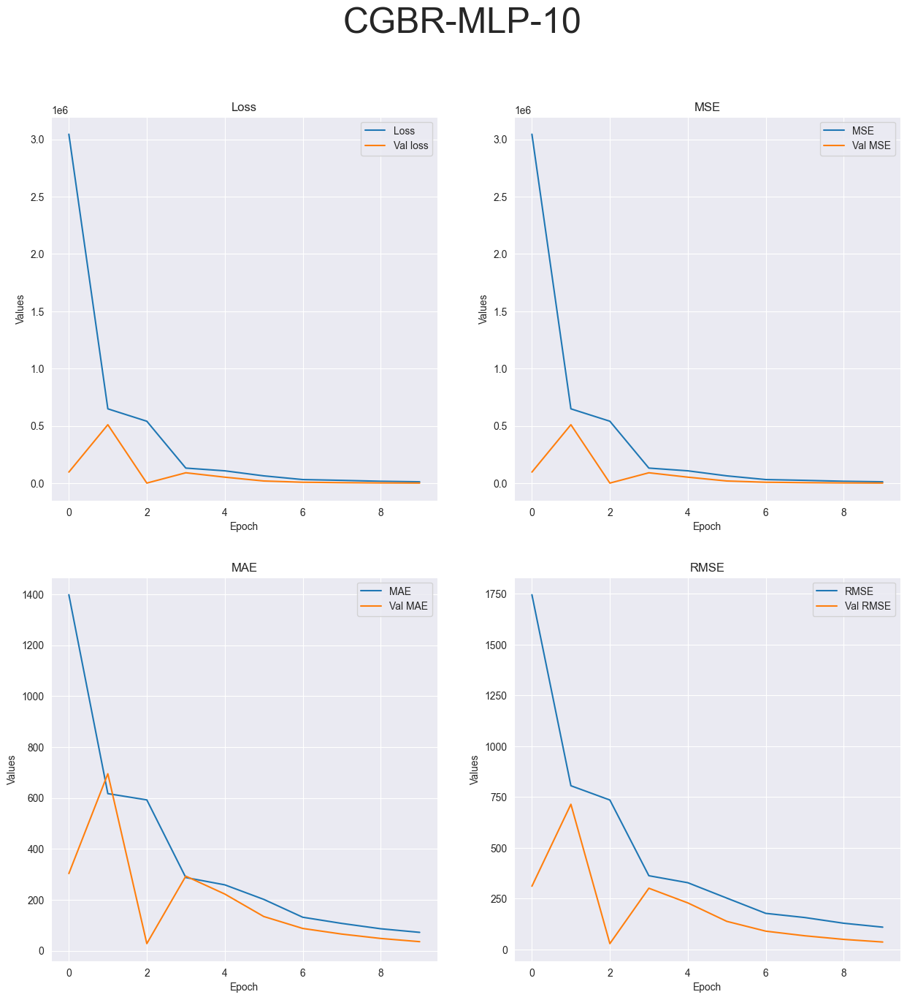

R-squared value: -2744.5313


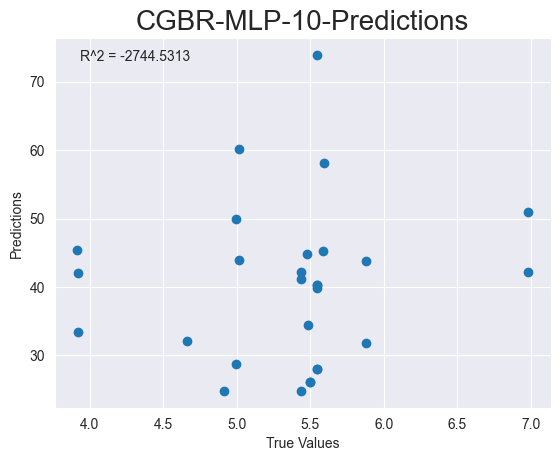

Epoch: 20
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 20
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-MLP-20
Epoch 1/20


2023-05-02 15:45:54.709305: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2681151.0000 - mse: 2681151.0000 - mae: 1307.8274 - root_mean_squared_error: 1637.4221

2023-05-02 15:45:55.791322: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 366ms/step - loss: 2681151.0000 - mse: 2681151.0000 - mae: 1307.8274 - root_mean_squared_error: 1637.4221 - val_loss: 2.0672 - val_mse: 2.0672 - val_mae: 1.2223 - val_root_mean_squared_error: 1.4378
Epoch 2/20
3/3 [==============================] - 0s 75ms/step - loss: 509748.3125 - mse: 509748.3125 - mae: 548.4432 - root_mean_squared_error: 713.9666 - val_loss: 198977.1719 - val_mse: 198977.1719 - val_mae: 434.3956 - val_root_mean_squared_error: 446.0686
Epoch 3/20
3/3 [==============================] - 0s 50ms/step - loss: 377239.5625 - mse: 377239.5625 - mae: 485.3460 - root_mean_squared_error: 614.1983 - val_loss: 4801.5195 - val_mse: 4801.5195 - val_mae: 67.1684 - val_root_mean_squared_error: 69.2930
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 82702.5938 - mse: 82702.5938 - mae: 219.4837 - root_mean_squared_error: 287.5806 - val_loss: 29309.5469 - val_mse: 29309.5469 - val_mae: 166.3581 - val_root_mean_squared_er

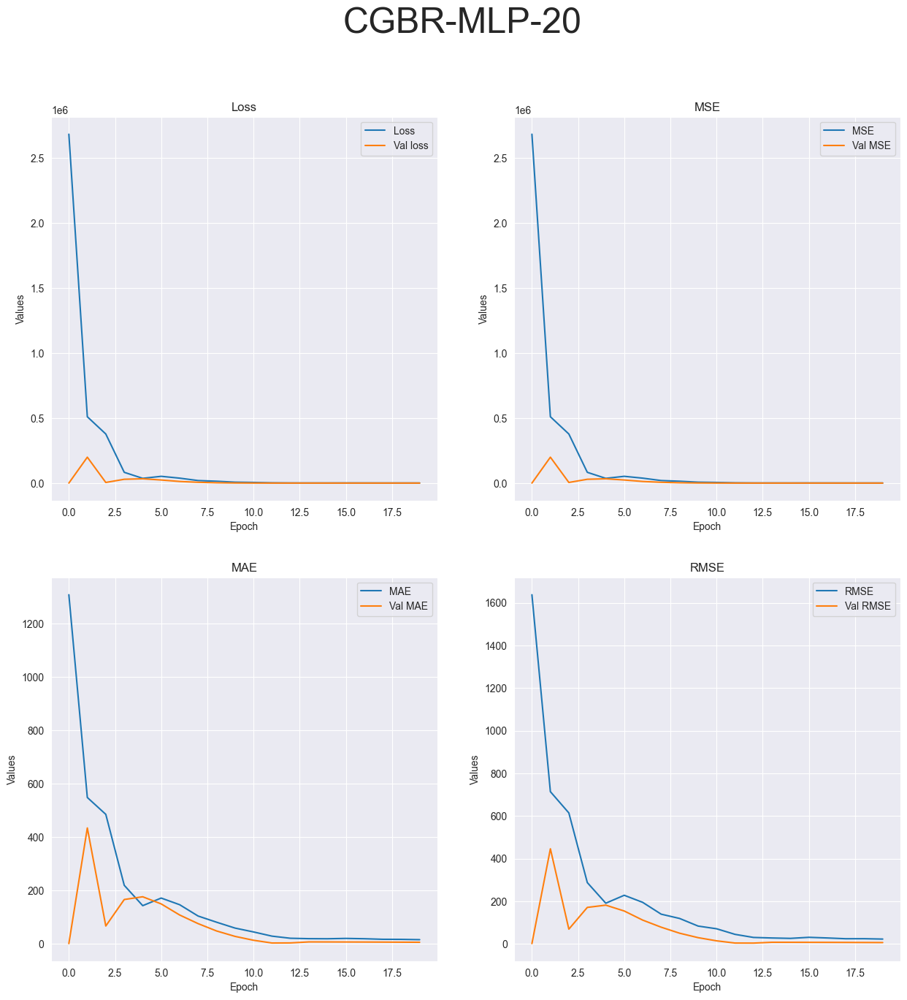

R-squared value: -96.2714


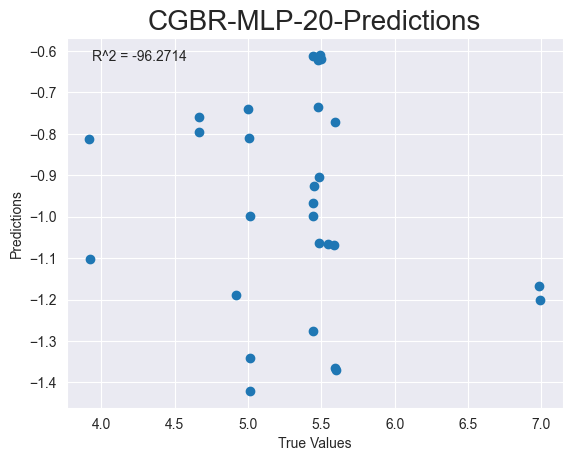

Model Name: FCNN
Epoch: 2
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 2
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-FCNN-2
Epoch 1/2


2023-05-02 15:45:58.893065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6822321.5000 - mse: 6822321.5000 - mae: 1920.0027 - root_mean_squared_error: 2611.9575

2023-05-02 15:45:59.847756: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 303ms/step - loss: 6822321.5000 - mse: 6822321.5000 - mae: 1920.0027 - root_mean_squared_error: 2611.9575 - val_loss: 182691.6719 - val_mse: 182691.6719 - val_mae: 405.3844 - val_root_mean_squared_error: 427.4245
Epoch 2/2
1/1 [==============================] - 0s 151ms/step - loss: 2565874.5000 - mse: 2565874.5000 - mae: 1529.6741 - root_mean_squared_error: 1601.8347
Test loss: [2565874.5, 2565874.5, 1529.674072265625, 1601.834716796875]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


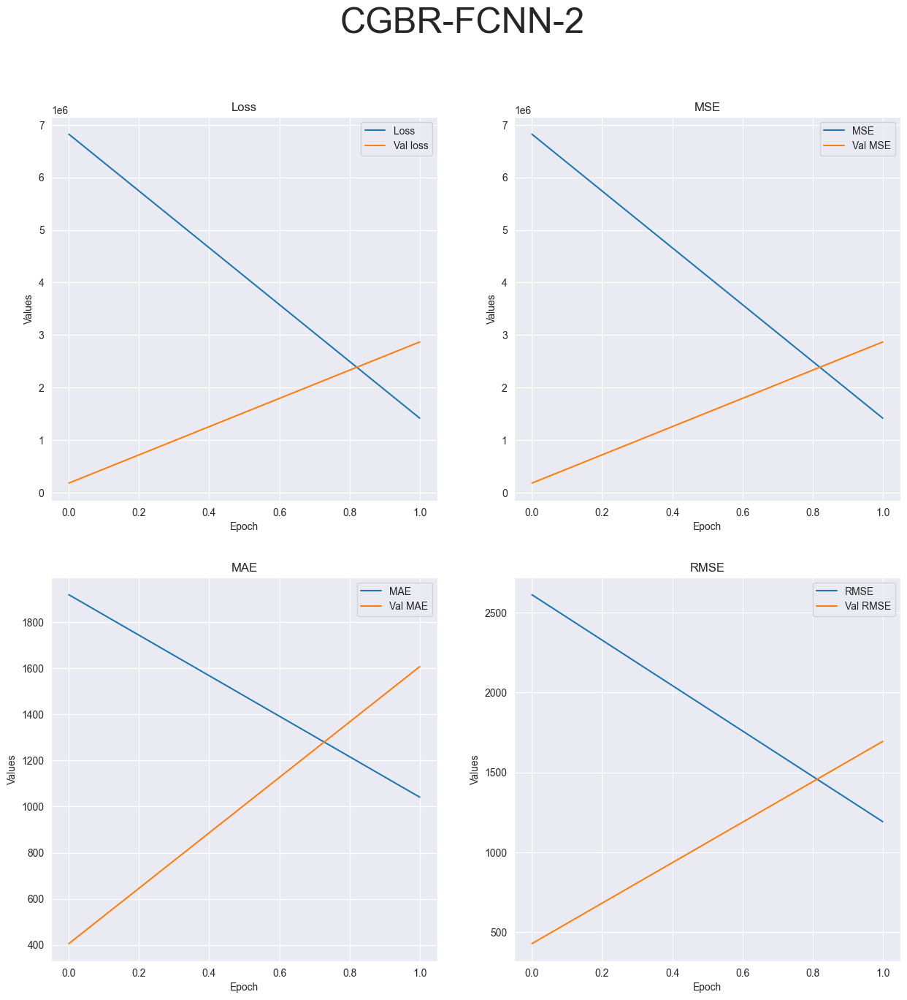

R-squared value: -6798875.2395


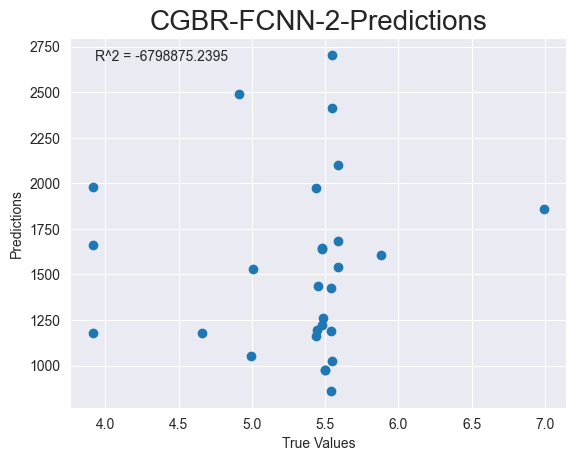

Epoch: 4
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 4
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-FCNN-4
Epoch 1/4


2023-05-02 15:46:01.408347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 7561767.5000 - mse: 7561767.5000 - mae: 2017.9161 - root_mean_squared_error: 2749.8667

2023-05-02 15:46:02.779551: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 486ms/step - loss: 7561767.5000 - mse: 7561767.5000 - mae: 2017.9161 - root_mean_squared_error: 2749.8667 - val_loss: 143079.4062 - val_mse: 143079.4062 - val_mae: 365.4094 - val_root_mean_squared_error: 378.2584
Epoch 2/4
3/3 [==============================] - 0s 56ms/step - loss: 2035566.3750 - mse: 2035566.3750 - mae: 1208.1558 - root_mean_squared_error: 1426.7328 - val_loss: 1963795.5000 - val_mse: 1963795.5000 - val_mae: 1354.7808 - val_root_mean_squared_error: 1401.3549
Epoch 3/4
3/3 [==============================] - 0s 68ms/step - loss: 1778734.2500 - mse: 1778734.2500 - mae: 1244.1532 - root_mean_squared_error: 1333.6920 - val_loss: 150414.9531 - val_mse: 150414.9531 - val_mae: 374.6693 - val_root_mean_squared_error: 387.8337
Epoch 4/4
1/1 [==============================] - 0s 159ms/step - loss: 70141.5469 - mse: 70141.5469 - mae: 255.9044 - root_mean_squared_error: 264.8425
Test loss: [70141.546875, 70141.546875, 255.90440368652344, 2

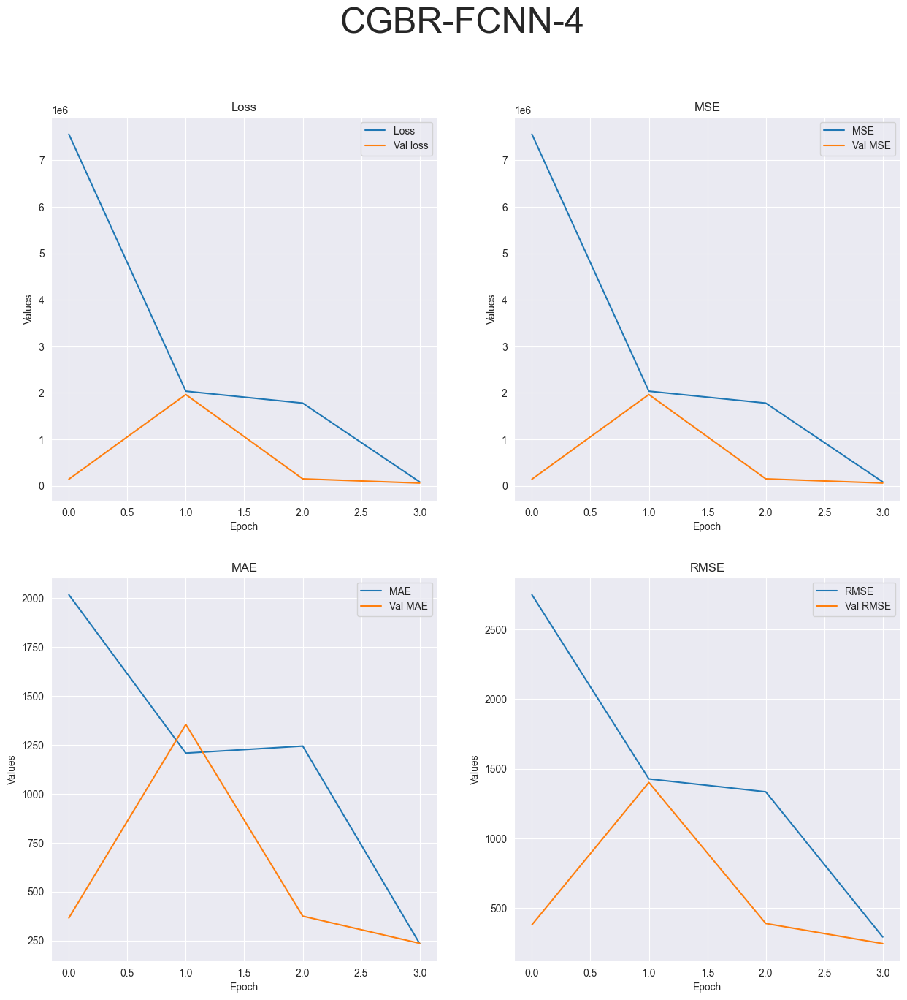

R-squared value: -148678.7691


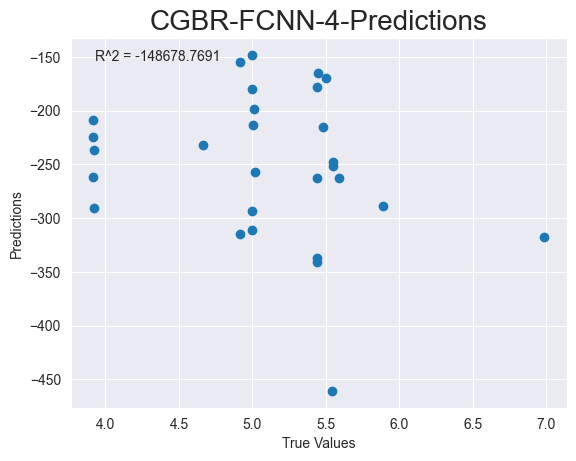

Epoch: 10
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 10
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-FCNN-10
Epoch 1/10


2023-05-02 15:46:04.610983: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 7148423.0000 - mse: 7148423.0000 - mae: 1978.9630 - root_mean_squared_error: 2673.6536

2023-05-02 15:46:05.724372: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 399ms/step - loss: 7148423.0000 - mse: 7148423.0000 - mae: 1978.9630 - root_mean_squared_error: 2673.6536 - val_loss: 197245.0000 - val_mse: 197245.0000 - val_mae: 429.9921 - val_root_mean_squared_error: 444.1227
Epoch 2/10
3/3 [==============================] - 0s 80ms/step - loss: 1679539.7500 - mse: 1679539.7500 - mae: 1128.9476 - root_mean_squared_error: 1295.9706 - val_loss: 2443743.7500 - val_mse: 2443743.7500 - val_mae: 1514.3928 - val_root_mean_squared_error: 1563.2478
Epoch 3/10
3/3 [==============================] - 0s 45ms/step - loss: 1750730.7500 - mse: 1750730.7500 - mae: 1237.2692 - root_mean_squared_error: 1323.1519 - val_loss: 254579.0000 - val_mse: 254579.0000 - val_mae: 488.5529 - val_root_mean_squared_error: 504.5582
Epoch 4/10
3/3 [==============================] - 0s 85ms/step - loss: 107649.5625 - mse: 107649.5625 - mae: 258.5345 - root_mean_squared_error: 328.0999 - val_loss: 48705.6094 - val_mse: 48705.6094 - val_mae: 2

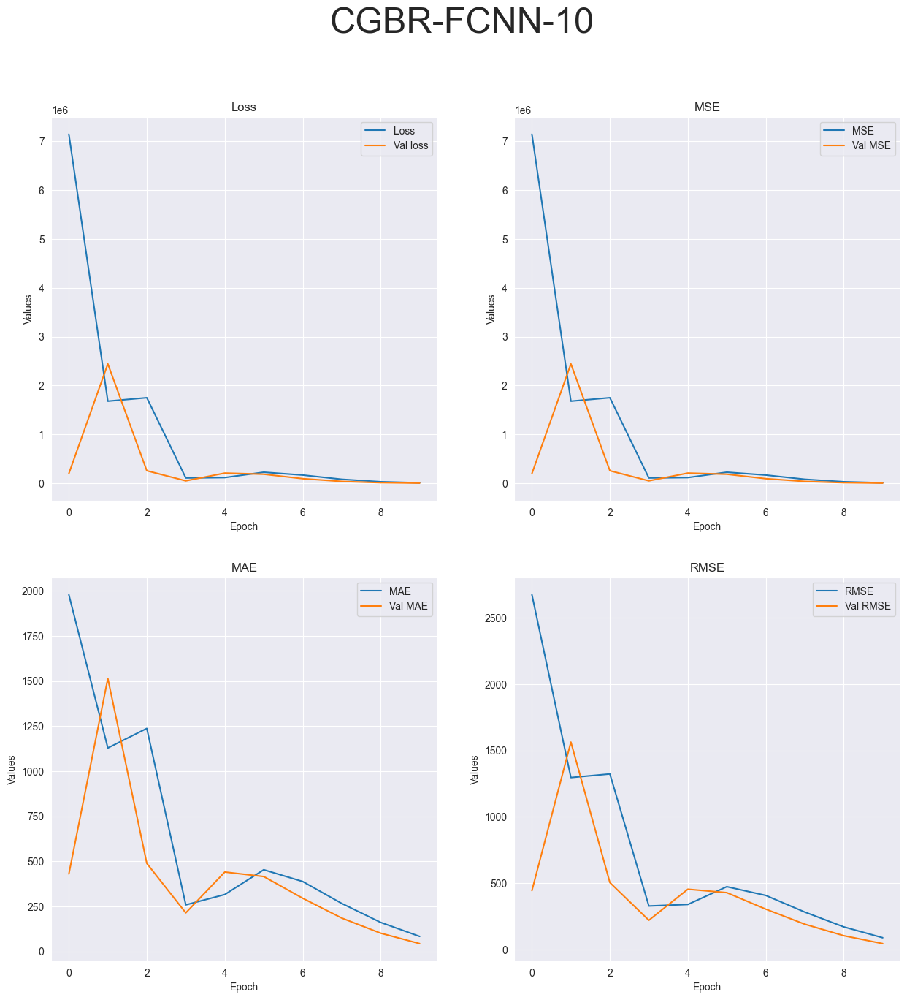

R-squared value: -4430.3586


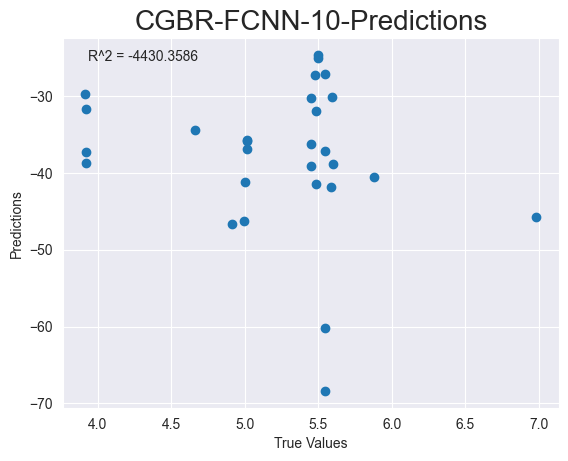

Epoch: 20
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 20
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-FCNN-20
Epoch 1/20


2023-05-02 15:46:07.852451: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 7288374.5000 - mse: 7288374.5000 - mae: 1969.4448 - root_mean_squared_error: 2699.6990

2023-05-02 15:46:09.155998: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 414ms/step - loss: 7288374.5000 - mse: 7288374.5000 - mae: 1969.4448 - root_mean_squared_error: 2699.6990 - val_loss: 155660.8281 - val_mse: 155660.8281 - val_mae: 381.0763 - val_root_mean_squared_error: 394.5388
Epoch 2/20
3/3 [==============================] - 0s 52ms/step - loss: 1626614.2500 - mse: 1626614.2500 - mae: 1101.6614 - root_mean_squared_error: 1275.3879 - val_loss: 2296280.0000 - val_mse: 2296280.0000 - val_mae: 1464.6685 - val_root_mean_squared_error: 1515.3481
Epoch 3/20
3/3 [==============================] - 0s 84ms/step - loss: 1876599.0000 - mse: 1876599.0000 - mae: 1276.3970 - root_mean_squared_error: 1369.8901 - val_loss: 233309.2969 - val_mse: 233309.2969 - val_mae: 466.6209 - val_root_mean_squared_error: 483.0210
Epoch 4/20
3/3 [==============================] - 0s 32ms/step - loss: 133943.0156 - mse: 133943.0156 - mae: 278.3451 - root_mean_squared_error: 365.9823 - val_loss: 48431.5820 - val_mse: 48431.5820 - val_mae: 2

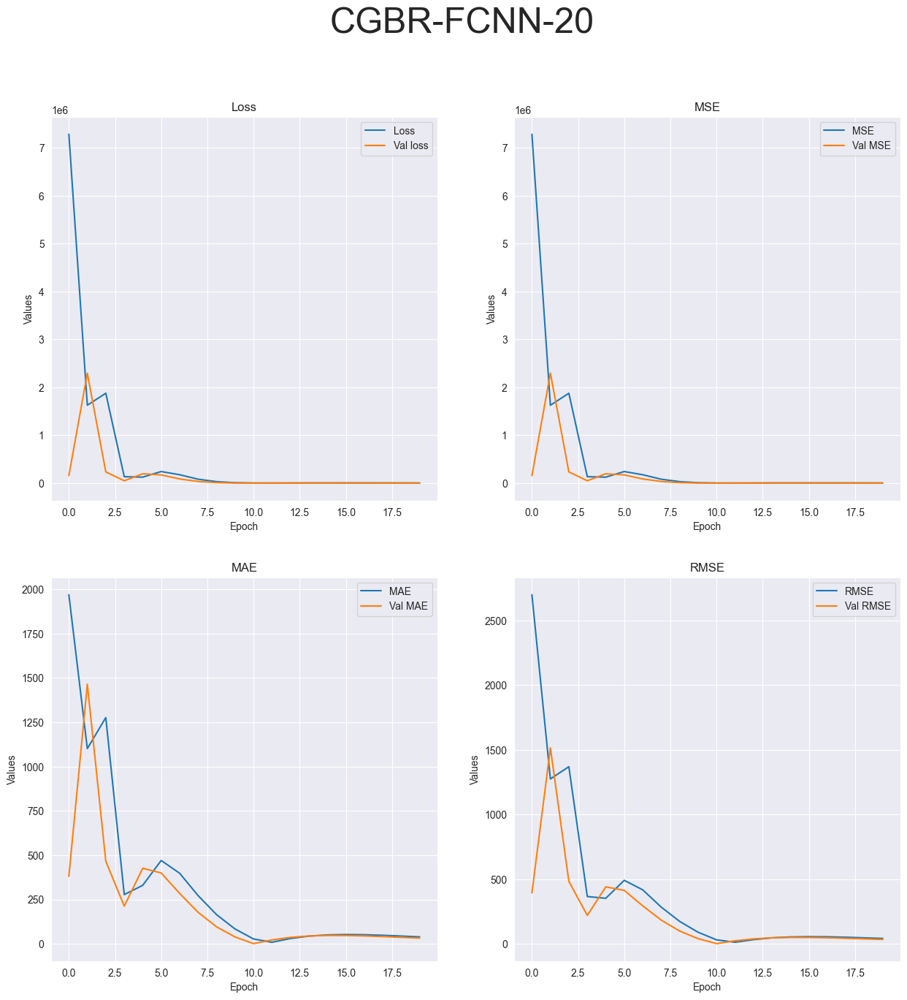

R-squared value: -2537.5938


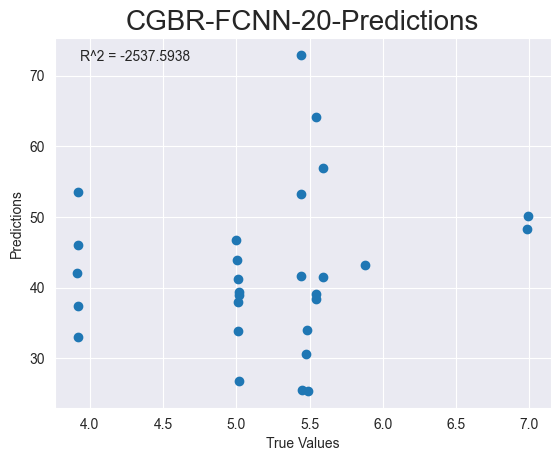

Model Name: DeepSVM
Epoch: 2
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 2
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-DeepSVM-2
Epoch 1/2


2023-05-02 15:46:12.450787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 682863232.0000 - mse: 682863232.0000 - mae: 24799.4473 - root_mean_squared_error: 26131.6523

2023-05-02 15:46:15.136380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 682863232.0000 - mse: 682863232.0000 - mae: 24799.4473 - root_mean_squared_error: 26131.6523 - val_loss: 332485056.0000 - val_mse: 332485056.0000 - val_mae: 17764.9922 - val_root_mean_squared_error: 18234.1719
Epoch 2/2
1/1 [==============================] - 0s 93ms/step - loss: 121383608.0000 - mse: 121383608.0000 - mae: 10573.1182 - root_mean_squared_error: 11017.4229
Test loss: [121383608.0, 121383608.0, 10573.1181640625, 11017.4228515625]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


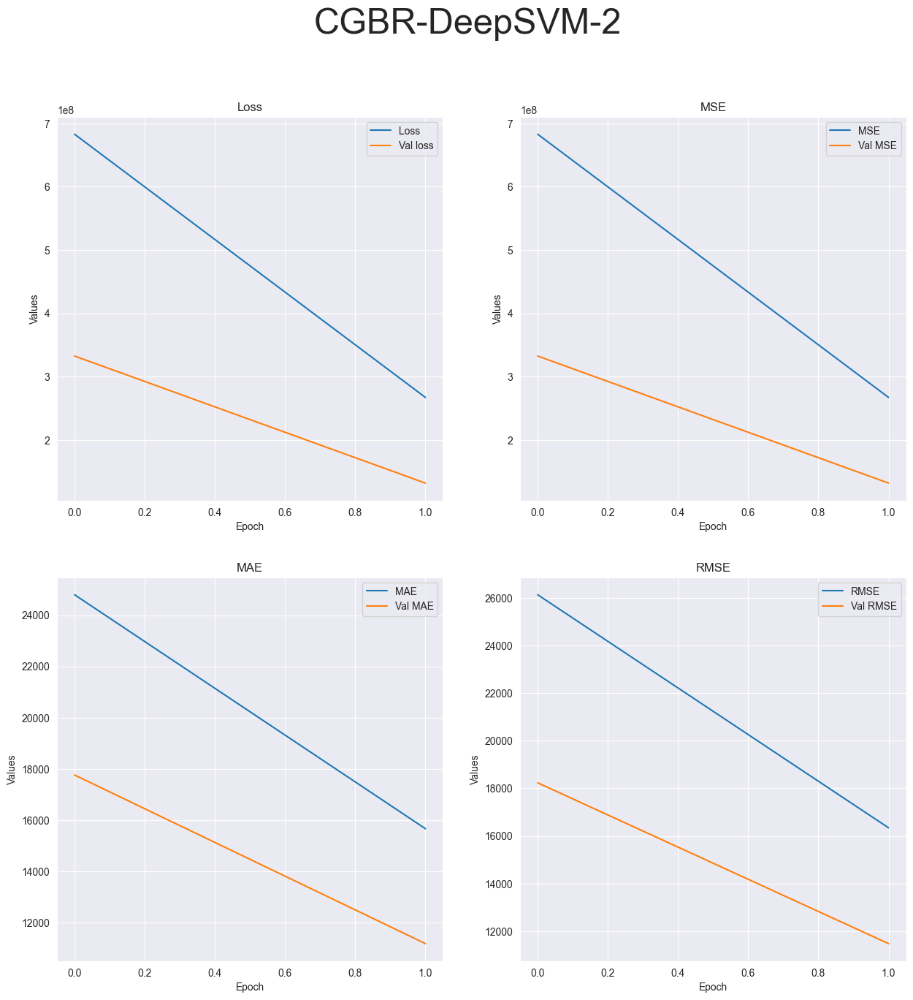

R-squared value: -172399677.6534


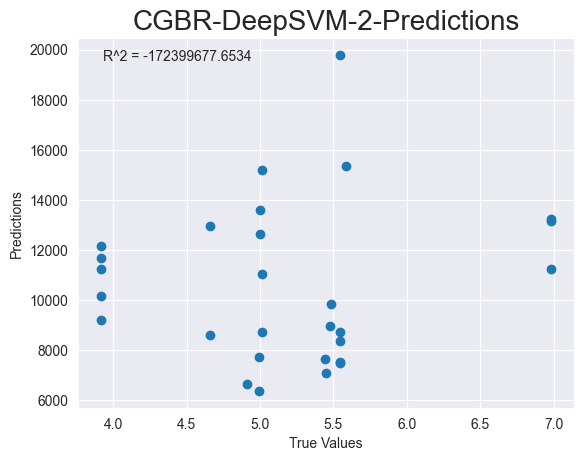

Epoch: 4
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 4
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-DeepSVM-4
Epoch 1/4


2023-05-02 15:46:17.184282: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 642920064.0000 - mse: 642920064.0000 - mae: 24162.2520 - root_mean_squared_error: 25355.8691

2023-05-02 15:46:18.219113: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 336ms/step - loss: 642920064.0000 - mse: 642920064.0000 - mae: 24162.2520 - root_mean_squared_error: 25355.8691 - val_loss: 307394784.0000 - val_mse: 307394784.0000 - val_mae: 16899.9746 - val_root_mean_squared_error: 17532.6777
Epoch 2/4
3/3 [==============================] - 1s 481ms/step - loss: 264967504.0000 - mse: 264967504.0000 - mae: 15375.7959 - root_mean_squared_error: 16277.8223 - val_loss: 118049536.0000 - val_mse: 118049536.0000 - val_mae: 10472.7881 - val_root_mean_squared_error: 10865.0605
Epoch 3/4
3/3 [==============================] - 0s 50ms/step - loss: 98663232.0000 - mse: 98663232.0000 - mae: 9464.7178 - root_mean_squared_error: 9932.9365 - val_loss: 46105740.0000 - val_mse: 46105740.0000 - val_mae: 6544.7964 - val_root_mean_squared_error: 6790.1206
Epoch 4/4
1/1 [==============================] - 0s 109ms/step - loss: 22726930.0000 - mse: 22726930.0000 - mae: 4616.1729 - root_mean_squared_error: 4767.2769
Test loss: [2272

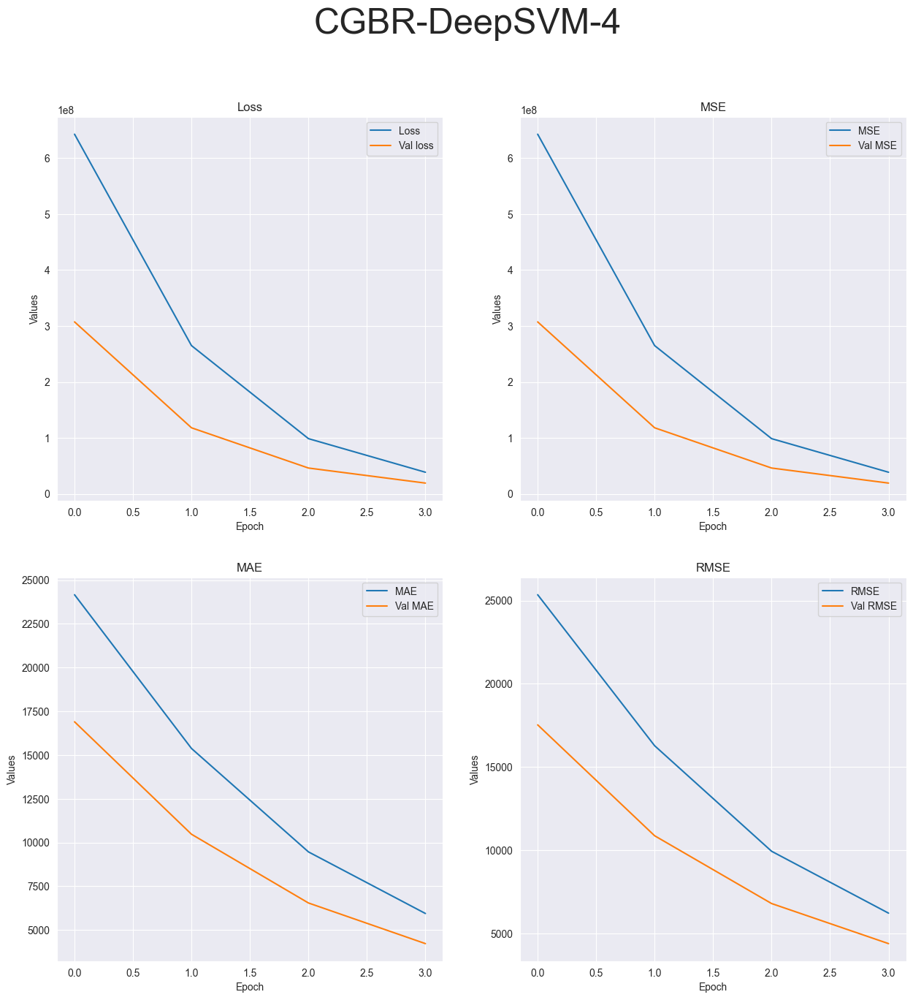

R-squared value: -36935378.7602


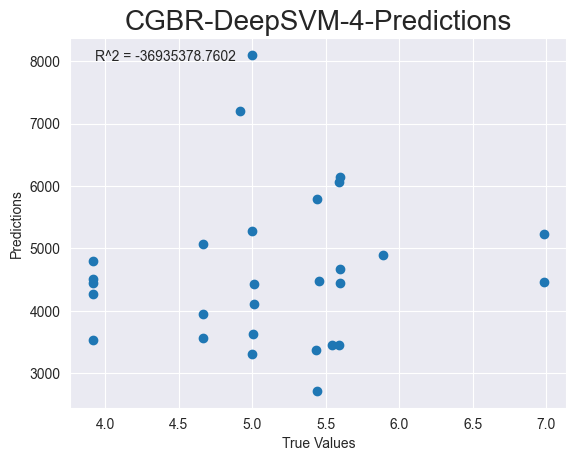

Epoch: 10
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 10
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-DeepSVM-10
Epoch 1/10


2023-05-02 15:46:21.321713: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 253ms/step - loss: 649395712.0000 - mse: 649395712.0000 - mae: 24207.1797 - root_mean_squared_error: 25483.2441 - val_loss: 331608864.0000 - val_mse: 331608864.0000 - val_mae: 17276.1133 - val_root_mean_squared_error: 18210.1309
Epoch 2/10


2023-05-02 15:46:22.541272: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 199ms/step - loss: 262188912.0000 - mse: 262188912.0000 - mae: 15418.3711 - root_mean_squared_error: 16192.2480 - val_loss: 131199952.0000 - val_mse: 131199952.0000 - val_mae: 10866.5127 - val_root_mean_squared_error: 11454.2549
Epoch 3/10
3/3 [==============================] - 0s 57ms/step - loss: 103771896.0000 - mse: 103771880.0000 - mae: 9695.5742 - root_mean_squared_error: 10186.8486 - val_loss: 51837976.0000 - val_mse: 51837976.0000 - val_mae: 6830.1895 - val_root_mean_squared_error: 7199.8594
Epoch 4/10
3/3 [==============================] - 0s 39ms/step - loss: 41552792.0000 - mse: 41552792.0000 - mae: 6145.3525 - root_mean_squared_error: 6446.1455 - val_loss: 21666924.0000 - val_mse: 21666924.0000 - val_mae: 4415.5713 - val_root_mean_squared_error: 4654.7744
Epoch 5/10
3/3 [==============================] - 0s 33ms/step - loss: 17437618.0000 - mse: 17437618.0000 - mae: 4003.5310 - root_mean_squared_error: 4175.8374 - val_loss: 10093046

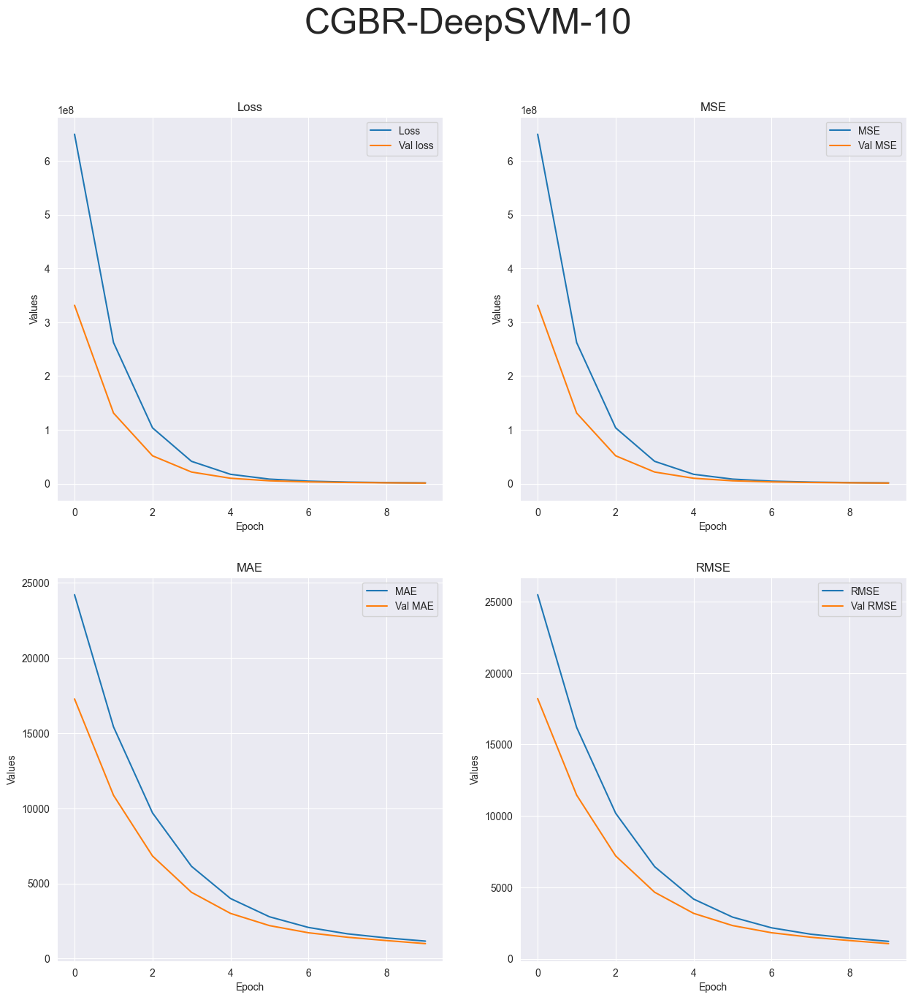

R-squared value: -2278946.4898


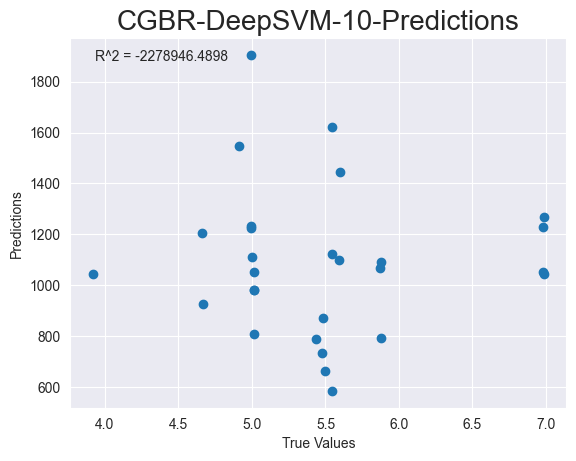

Epoch: 20
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 20
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-DeepSVM-20
Epoch 1/20


2023-05-02 15:46:25.000877: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 674066304.0000 - mse: 674066240.0000 - mae: 24874.8125 - root_mean_squared_error: 25962.7852

2023-05-02 15:46:25.933393: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 312ms/step - loss: 674066304.0000 - mse: 674066240.0000 - mae: 24874.8125 - root_mean_squared_error: 25962.7852 - val_loss: 354090112.0000 - val_mse: 354090112.0000 - val_mae: 17946.4688 - val_root_mean_squared_error: 18817.2832
Epoch 2/20
3/3 [==============================] - 0s 93ms/step - loss: 275340544.0000 - mse: 275340544.0000 - mae: 15801.0195 - root_mean_squared_error: 16593.3887 - val_loss: 136770048.0000 - val_mse: 136770048.0000 - val_mae: 11153.4473 - val_root_mean_squared_error: 11694.8730
Epoch 3/20
3/3 [==============================] - 0s 59ms/step - loss: 102702640.0000 - mse: 102702640.0000 - mae: 9741.3145 - root_mean_squared_error: 10134.2314 - val_loss: 53527652.0000 - val_mse: 53527652.0000 - val_mae: 6977.3438 - val_root_mean_squared_error: 7316.2593
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 42010556.0000 - mse: 42010556.0000 - mae: 6177.8511 - root_mean_squared_error: 6481.5552 - val_loss: 

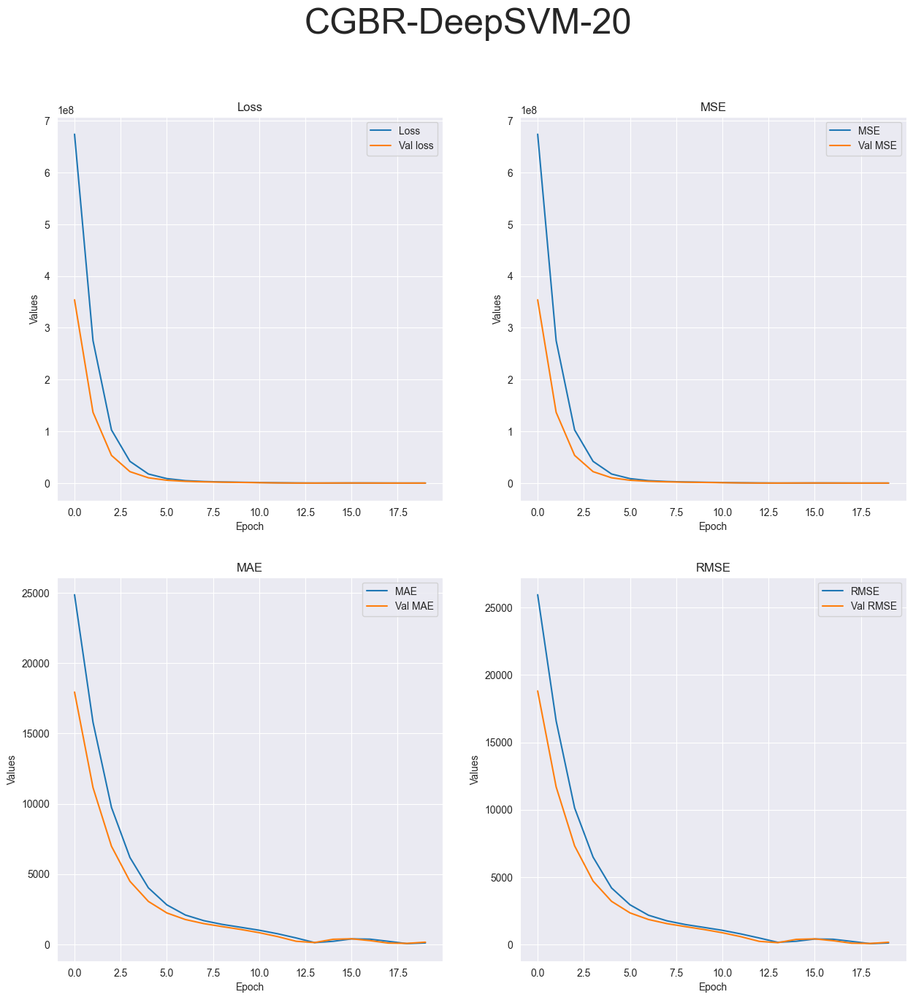

R-squared value: -31948.7748


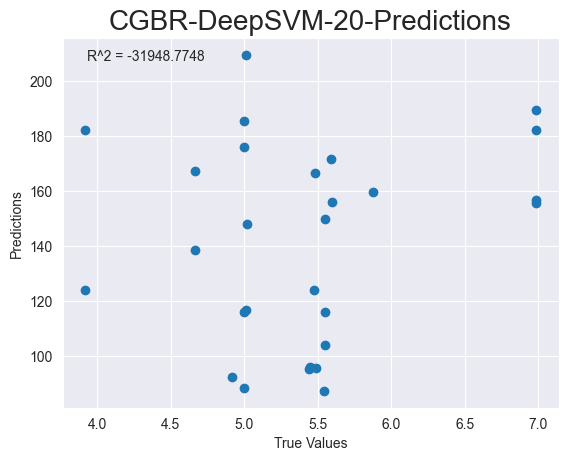

Dataset Name: FBR
Model Name: MLP
Epoch: 2
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 2
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-MLP-2
Epoch 1/2


2023-05-02 15:46:28.840559: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 24.7947 - mse: 24.7947 - mae: 3.9032 - root_mean_squared_error: 4.9794

2023-05-02 15:46:30.139143: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 338ms/step - loss: 24.7947 - mse: 24.7947 - mae: 3.9032 - root_mean_squared_error: 4.9794 - val_loss: 4.1624 - val_mse: 4.1624 - val_mae: 1.5099 - val_root_mean_squared_error: 2.0402
Epoch 2/2
1/1 [==============================] - 0s 80ms/step - loss: 1.1922 - mse: 1.1922 - mae: 0.9851 - root_mean_squared_error: 1.0919
Test loss: [1.1922094821929932, 1.1922094821929932, 0.9851264357566833, 1.0918834209442139]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


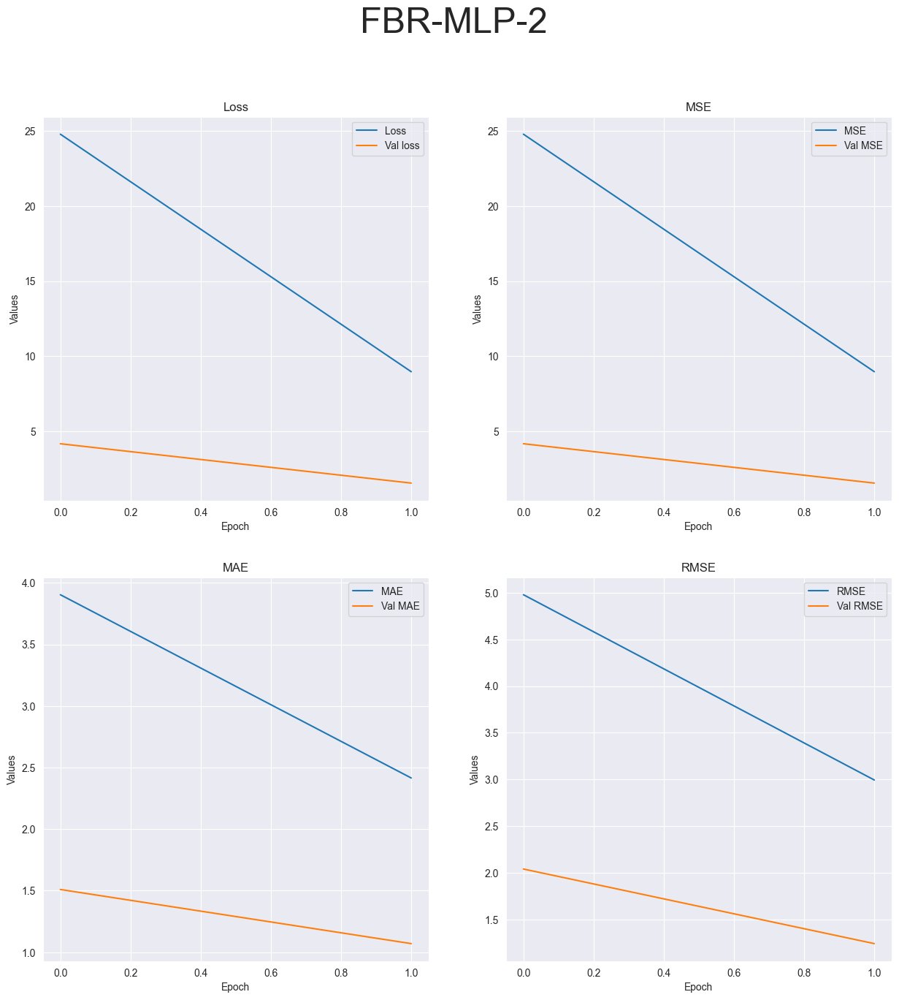

R-squared value: -1.8615


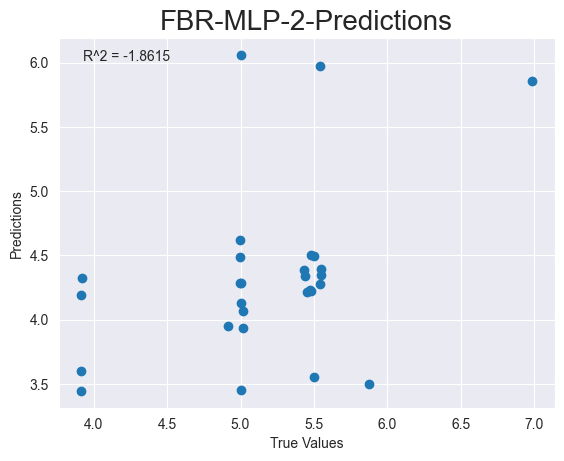

Epoch: 4
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 4
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-MLP-4
Epoch 1/4


2023-05-02 15:46:31.714281: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 394ms/step - loss: 22.8667 - mse: 22.8667 - mae: 3.7278 - root_mean_squared_error: 4.7819 - val_loss: 5.5259 - val_mse: 5.5259 - val_mae: 1.9092 - val_root_mean_squared_error: 2.3507
Epoch 2/4


2023-05-02 15:46:33.299513: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 227ms/step - loss: 8.2575 - mse: 8.2575 - mae: 2.2963 - root_mean_squared_error: 2.8736 - val_loss: 1.1828 - val_mse: 1.1828 - val_mae: 0.9053 - val_root_mean_squared_error: 1.0876
Epoch 3/4
3/3 [==============================] - 0s 65ms/step - loss: 5.3849 - mse: 5.3849 - mae: 1.9206 - root_mean_squared_error: 2.3205 - val_loss: 2.2258 - val_mse: 2.2258 - val_mae: 1.2915 - val_root_mean_squared_error: 1.4919
Epoch 4/4
1/1 [==============================] - 0s 80ms/step - loss: 2.6881 - mse: 2.6881 - mae: 1.3540 - root_mean_squared_error: 1.6395
Test loss: [2.6881027221679688, 2.6881027221679688, 1.3540003299713135, 1.6395434141159058]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


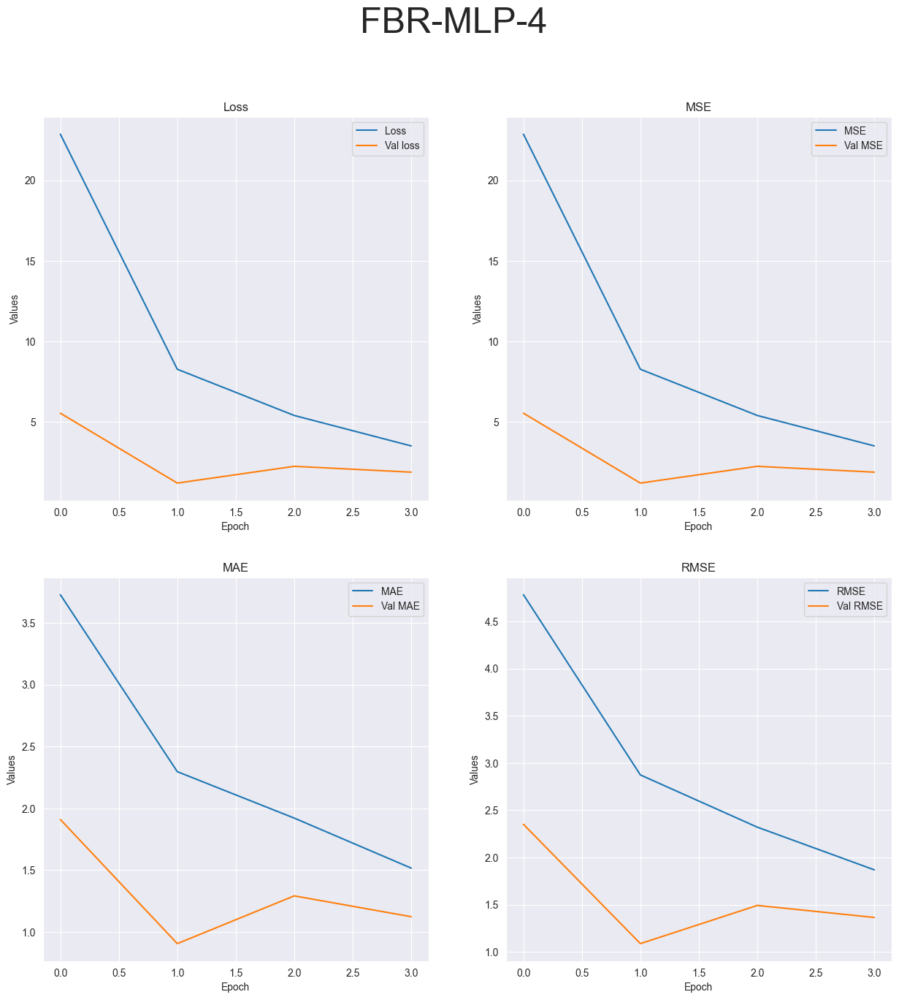

R-squared value: -9.6066


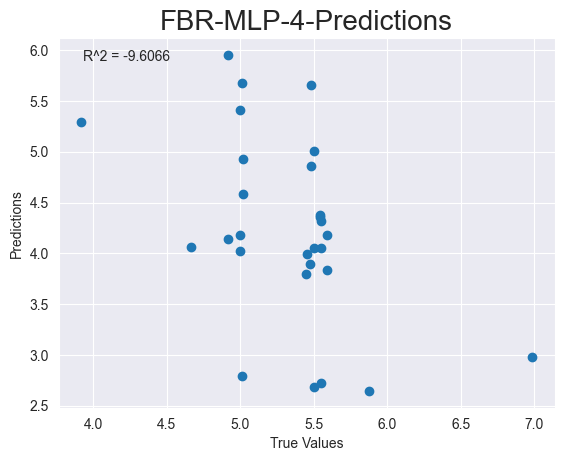

Epoch: 10
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 10
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-MLP-10
Epoch 1/10


2023-05-02 15:46:35.225588: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 16.6995 - mse: 16.6995 - mae: 3.3632 - root_mean_squared_error: 4.0865

2023-05-02 15:46:36.590636: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 460ms/step - loss: 16.6995 - mse: 16.6995 - mae: 3.3632 - root_mean_squared_error: 4.0865 - val_loss: 4.0038 - val_mse: 4.0038 - val_mae: 1.7913 - val_root_mean_squared_error: 2.0010
Epoch 2/10
3/3 [==============================] - 0s 80ms/step - loss: 9.9200 - mse: 9.9200 - mae: 2.6049 - root_mean_squared_error: 3.1496 - val_loss: 4.5727 - val_mse: 4.5727 - val_mae: 1.8170 - val_root_mean_squared_error: 2.1384
Epoch 3/10
3/3 [==============================] - 0s 78ms/step - loss: 5.0672 - mse: 5.0672 - mae: 1.8529 - root_mean_squared_error: 2.2510 - val_loss: 1.4368 - val_mse: 1.4368 - val_mae: 1.0061 - val_root_mean_squared_error: 1.1987
Epoch 4/10
3/3 [==============================] - 0s 52ms/step - loss: 3.3516 - mse: 3.3516 - mae: 1.4661 - root_mean_squared_error: 1.8307 - val_loss: 1.2441 - val_mse: 1.2441 - val_mae: 0.9113 - val_root_mean_squared_error: 1.1154
Epoch 5/10
3/3 [==============================] - 0s 56ms/step - loss: 2.176

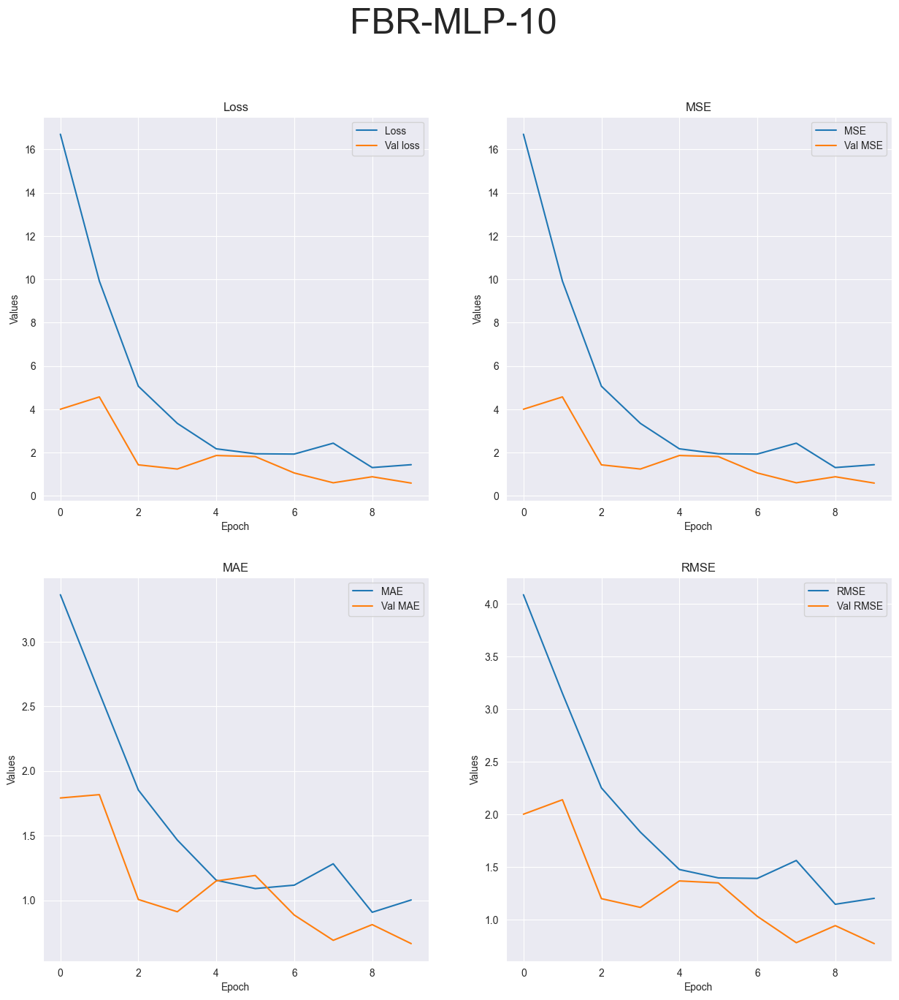

R-squared value: -3.2667


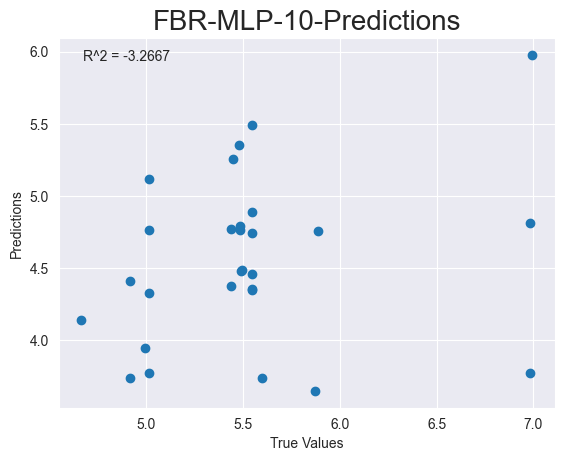

Epoch: 20
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 20
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-MLP-20
Epoch 1/20


2023-05-02 15:46:40.545177: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 24.1872 - mse: 24.1872 - mae: 3.6859 - root_mean_squared_error: 4.9181

2023-05-02 15:46:42.044164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 333ms/step - loss: 24.1872 - mse: 24.1872 - mae: 3.6859 - root_mean_squared_error: 4.9181 - val_loss: 3.9437 - val_mse: 3.9437 - val_mae: 1.8445 - val_root_mean_squared_error: 1.9859
Epoch 2/20
3/3 [==============================] - 0s 54ms/step - loss: 12.6556 - mse: 12.6556 - mae: 2.8086 - root_mean_squared_error: 3.5575 - val_loss: 2.6336 - val_mse: 2.6336 - val_mae: 1.4993 - val_root_mean_squared_error: 1.6228
Epoch 3/20
3/3 [==============================] - 0s 66ms/step - loss: 7.2997 - mse: 7.2997 - mae: 2.0911 - root_mean_squared_error: 2.7018 - val_loss: 1.7287 - val_mse: 1.7287 - val_mae: 1.1865 - val_root_mean_squared_error: 1.3148
Epoch 4/20
3/3 [==============================] - 0s 53ms/step - loss: 3.0364 - mse: 3.0364 - mae: 1.3899 - root_mean_squared_error: 1.7425 - val_loss: 1.2043 - val_mse: 1.2043 - val_mae: 0.9973 - val_root_mean_squared_error: 1.0974
Epoch 5/20
3/3 [==============================] - 0s 93ms/step - loss: 3.6

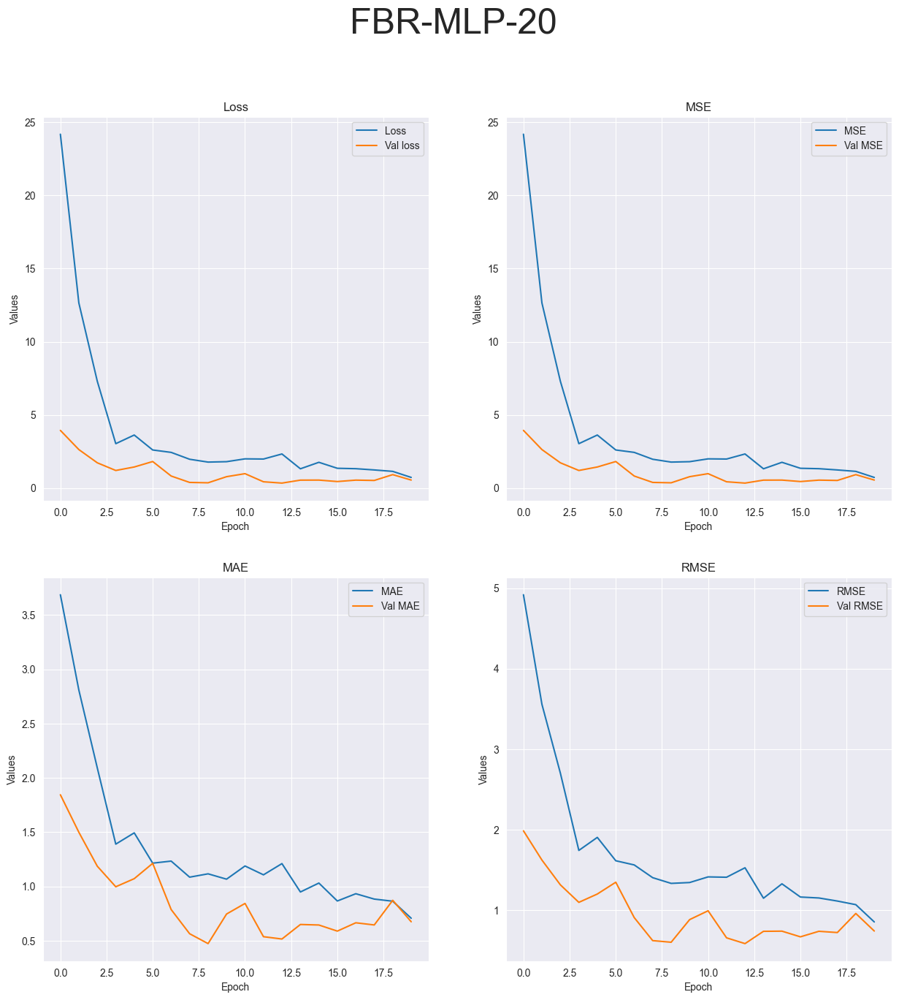

R-squared value: -2.7549


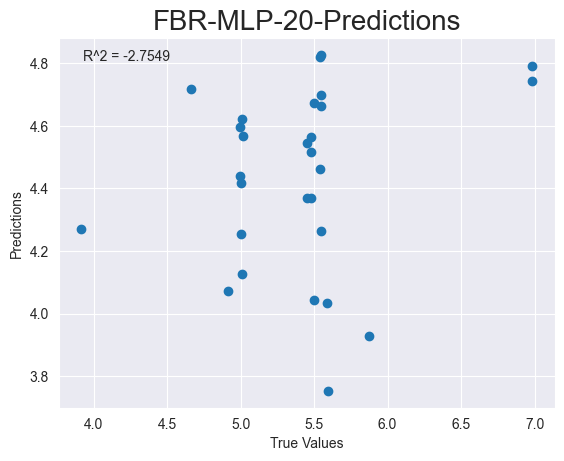

Model Name: FCNN
Epoch: 2
Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 2
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-FCNN-2
Epoch 1/2


2023-05-02 15:46:44.838832: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 26.1511 - mse: 26.1511 - mae: 4.3847 - root_mean_squared_error: 5.1138

2023-05-02 15:46:45.932142: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 275ms/step - loss: 26.1511 - mse: 26.1511 - mae: 4.3847 - root_mean_squared_error: 5.1138 - val_loss: 2.1595 - val_mse: 2.1595 - val_mae: 1.2299 - val_root_mean_squared_error: 1.4695
Epoch 2/2
1/1 [==============================] - 0s 148ms/step - loss: 7.5723 - mse: 7.5723 - mae: 2.4041 - root_mean_squared_error: 2.7518
Test loss: [7.572314739227295, 7.572314739227295, 2.404096841812134, 2.751783847808838]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


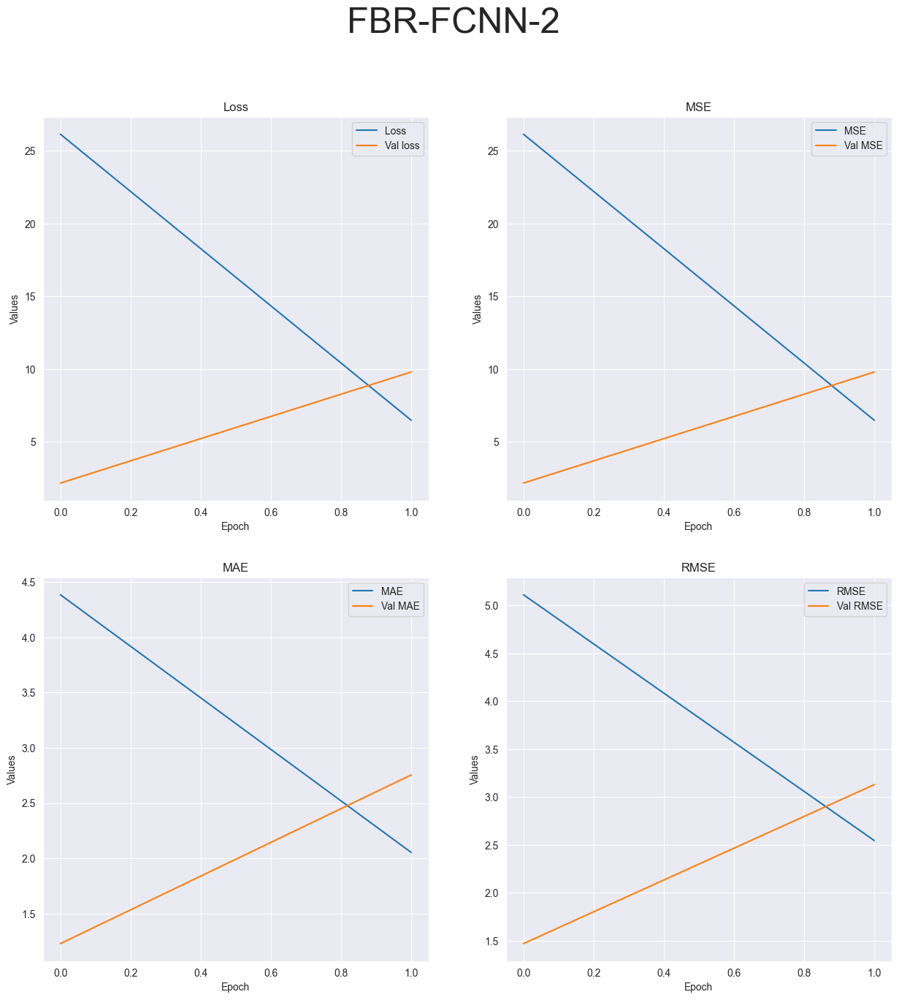

R-squared value: -8.3827


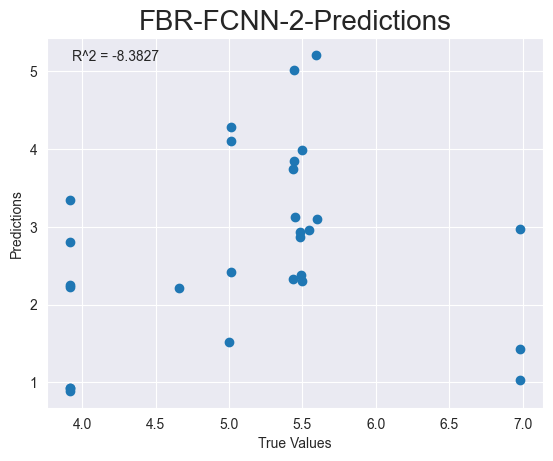

Epoch: 4
Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 4
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-FCNN-4
Epoch 1/4


2023-05-02 15:46:47.497411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 27.3976 - mse: 27.3976 - mae: 4.4953 - root_mean_squared_error: 5.2343

2023-05-02 15:46:48.494228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 318ms/step - loss: 27.3976 - mse: 27.3976 - mae: 4.4953 - root_mean_squared_error: 5.2343 - val_loss: 1.0230 - val_mse: 1.0230 - val_mae: 0.7571 - val_root_mean_squared_error: 1.0114
Epoch 2/4
3/3 [==============================] - 0s 62ms/step - loss: 5.0065 - mse: 5.0065 - mae: 1.8250 - root_mean_squared_error: 2.2375 - val_loss: 7.8509 - val_mse: 7.8509 - val_mae: 2.5160 - val_root_mean_squared_error: 2.8019
Epoch 3/4
3/3 [==============================] - 0s 64ms/step - loss: 5.6711 - mse: 5.6711 - mae: 1.9609 - root_mean_squared_error: 2.3814 - val_loss: 1.7939 - val_mse: 1.7939 - val_mae: 1.1556 - val_root_mean_squared_error: 1.3394
Epoch 4/4
1/1 [==============================] - 0s 114ms/step - loss: 1.6510 - mse: 1.6510 - mae: 1.0888 - root_mean_squared_error: 1.2849
Test loss: [1.6509696245193481, 1.6509696245193481, 1.0888481140136719, 1.2849006652832031]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


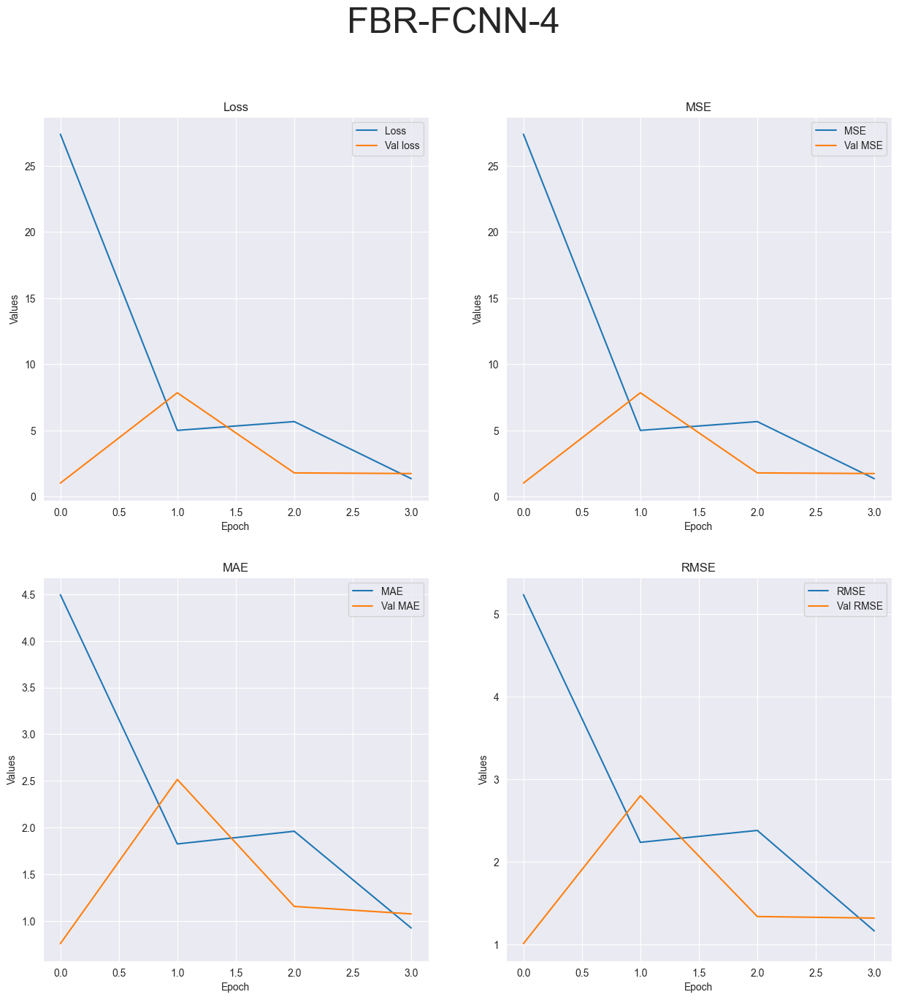

R-squared value: -5.0993


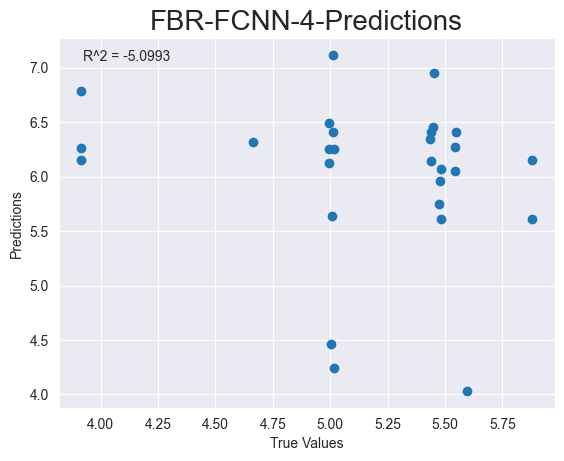

Epoch: 10
Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 10
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-FCNN-10
Epoch 1/10


2023-05-02 15:46:50.291215: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 29.8992 - mse: 29.8992 - mae: 4.6957 - root_mean_squared_error: 5.4680

2023-05-02 15:46:53.444306: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 346ms/step - loss: 29.8992 - mse: 29.8992 - mae: 4.6957 - root_mean_squared_error: 5.4680 - val_loss: 3.2775 - val_mse: 3.2775 - val_mae: 1.5198 - val_root_mean_squared_error: 1.8104
Epoch 2/10
3/3 [==============================] - 0s 122ms/step - loss: 6.1800 - mse: 6.1800 - mae: 2.1429 - root_mean_squared_error: 2.4860 - val_loss: 6.0094 - val_mse: 6.0094 - val_mae: 2.2771 - val_root_mean_squared_error: 2.4514
Epoch 3/10
3/3 [==============================] - 0s 53ms/step - loss: 6.0449 - mse: 6.0449 - mae: 2.1577 - root_mean_squared_error: 2.4586 - val_loss: 1.0410 - val_mse: 1.0410 - val_mae: 0.7770 - val_root_mean_squared_error: 1.0203
Epoch 4/10
3/3 [==============================] - 0s 29ms/step - loss: 1.3585 - mse: 1.3585 - mae: 0.9601 - root_mean_squared_error: 1.1656 - val_loss: 2.6774 - val_mse: 2.6774 - val_mae: 1.4206 - val_root_mean_squared_error: 1.6363
Epoch 5/10
3/3 [==============================] - 0s 64ms/step - loss: 1.77

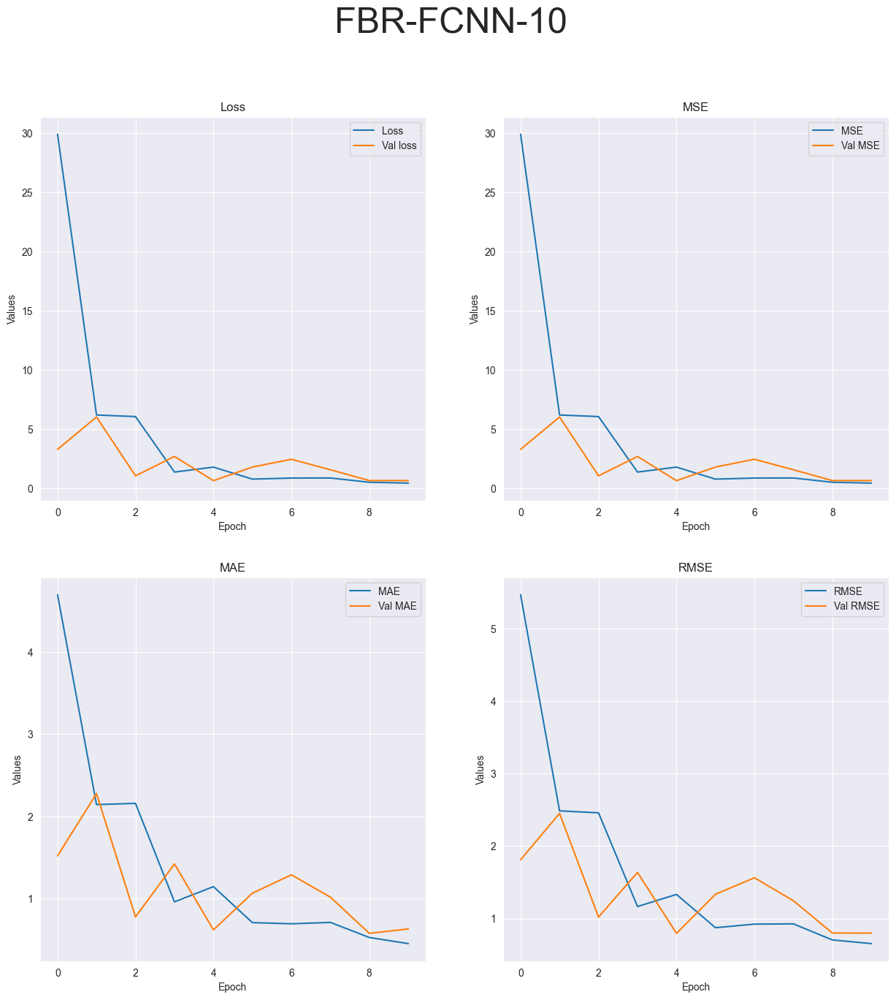

R-squared value: -0.2784


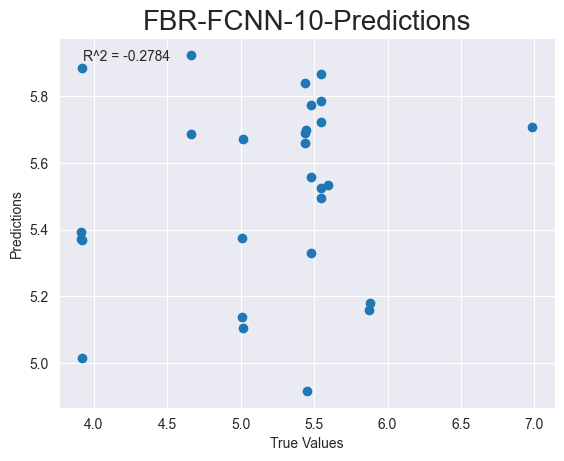

Epoch: 20
Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 20
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-FCNN-20
Epoch 1/20


2023-05-02 15:46:55.896383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 31.9852 - mse: 31.9852 - mae: 5.0231 - root_mean_squared_error: 5.6555

2023-05-02 15:46:57.381587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 467ms/step - loss: 31.9852 - mse: 31.9852 - mae: 5.0231 - root_mean_squared_error: 5.6555 - val_loss: 2.9490 - val_mse: 2.9490 - val_mae: 1.4845 - val_root_mean_squared_error: 1.7173
Epoch 2/20
3/3 [==============================] - 0s 123ms/step - loss: 5.7512 - mse: 5.7512 - mae: 1.8524 - root_mean_squared_error: 2.3982 - val_loss: 12.9171 - val_mse: 12.9171 - val_mae: 3.1047 - val_root_mean_squared_error: 3.5940
Epoch 3/20
3/3 [==============================] - 0s 130ms/step - loss: 6.2063 - mse: 6.2063 - mae: 2.0840 - root_mean_squared_error: 2.4912 - val_loss: 3.4805 - val_mse: 3.4805 - val_mae: 1.5339 - val_root_mean_squared_error: 1.8656
Epoch 4/20
3/3 [==============================] - 0s 93ms/step - loss: 1.3238 - mse: 1.3238 - mae: 0.9254 - root_mean_squared_error: 1.1506 - val_loss: 0.7312 - val_mse: 0.7312 - val_mae: 0.7107 - val_root_mean_squared_error: 0.8551
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 1

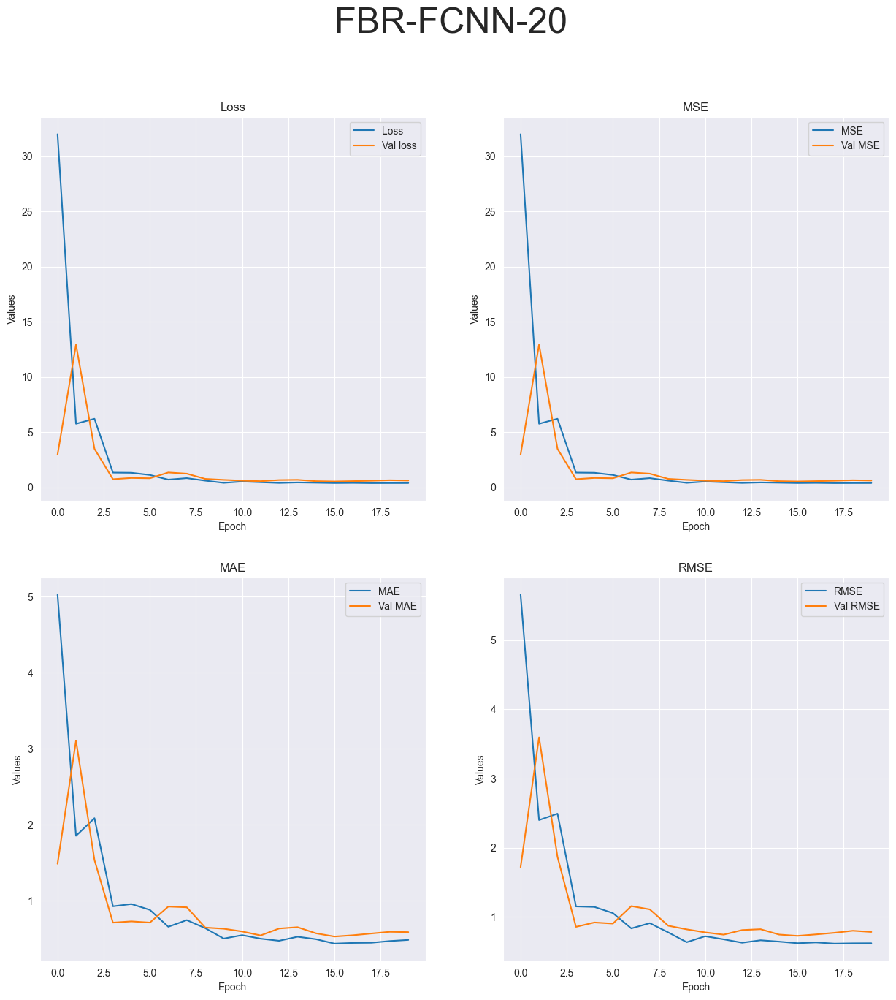

R-squared value: -0.2228


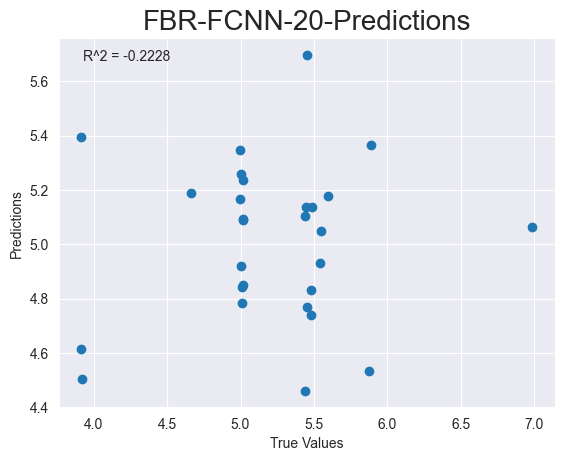

Model Name: DeepSVM
Epoch: 2
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 2
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-DeepSVM-2
Epoch 1/2


2023-05-02 15:47:01.595275: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 21.9217 - mse: 21.7862 - mae: 4.0220 - root_mean_squared_error: 4.6676

2023-05-02 15:47:02.880261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 316ms/step - loss: 21.9217 - mse: 21.7862 - mae: 4.0220 - root_mean_squared_error: 4.6676 - val_loss: 0.7589 - val_mse: 0.6245 - val_mae: 0.6319 - val_root_mean_squared_error: 0.7902
Epoch 2/2
1/1 [==============================] - 0s 132ms/step - loss: 5.5135 - mse: 5.3807 - mae: 1.9496 - root_mean_squared_error: 2.3196
Test loss: [5.513547420501709, 5.380683898925781, 1.9495956897735596, 2.3196301460266113]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


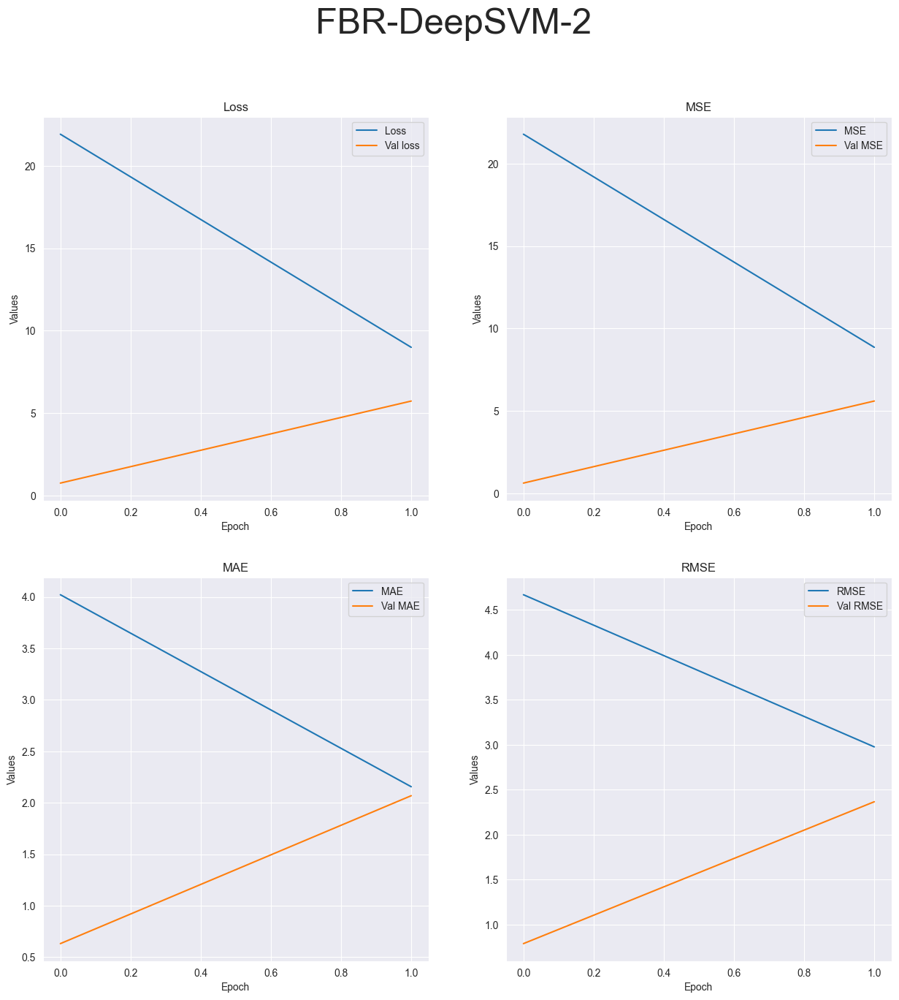

R-squared value: -6.4436


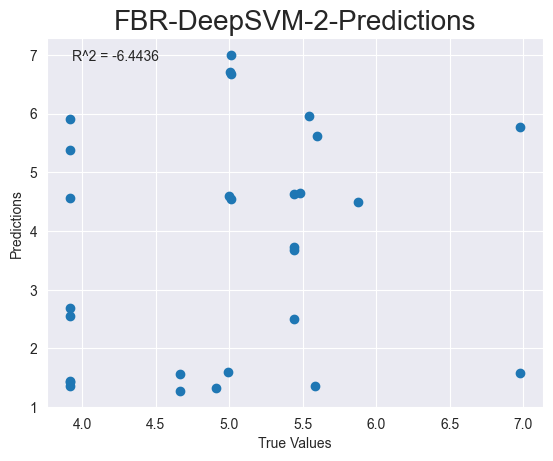

Epoch: 4
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 4
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-DeepSVM-4
Epoch 1/4


2023-05-02 15:47:06.494125: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 21.3300 - mse: 21.1944 - mae: 3.9623 - root_mean_squared_error: 4.6037

2023-05-02 15:47:07.661670: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 293ms/step - loss: 21.3300 - mse: 21.1944 - mae: 3.9623 - root_mean_squared_error: 4.6037 - val_loss: 2.5926 - val_mse: 2.4576 - val_mae: 1.1207 - val_root_mean_squared_error: 1.5677
Epoch 2/4
3/3 [==============================] - 0s 84ms/step - loss: 7.2497 - mse: 7.1158 - mae: 2.2544 - root_mean_squared_error: 2.6675 - val_loss: 4.6800 - val_mse: 4.5474 - val_mae: 1.8246 - val_root_mean_squared_error: 2.1325
Epoch 3/4
3/3 [==============================] - 1s 305ms/step - loss: 3.7282 - mse: 3.5955 - mae: 1.5307 - root_mean_squared_error: 1.8962 - val_loss: 6.5111 - val_mse: 6.3779 - val_mae: 2.2753 - val_root_mean_squared_error: 2.5255
Epoch 4/4
1/1 [==============================] - 0s 105ms/step - loss: 1.7378 - mse: 1.6054 - mae: 0.9941 - root_mean_squared_error: 1.2671
Test loss: [1.7378005981445312, 1.6054496765136719, 0.9941461682319641, 1.2670633792877197]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


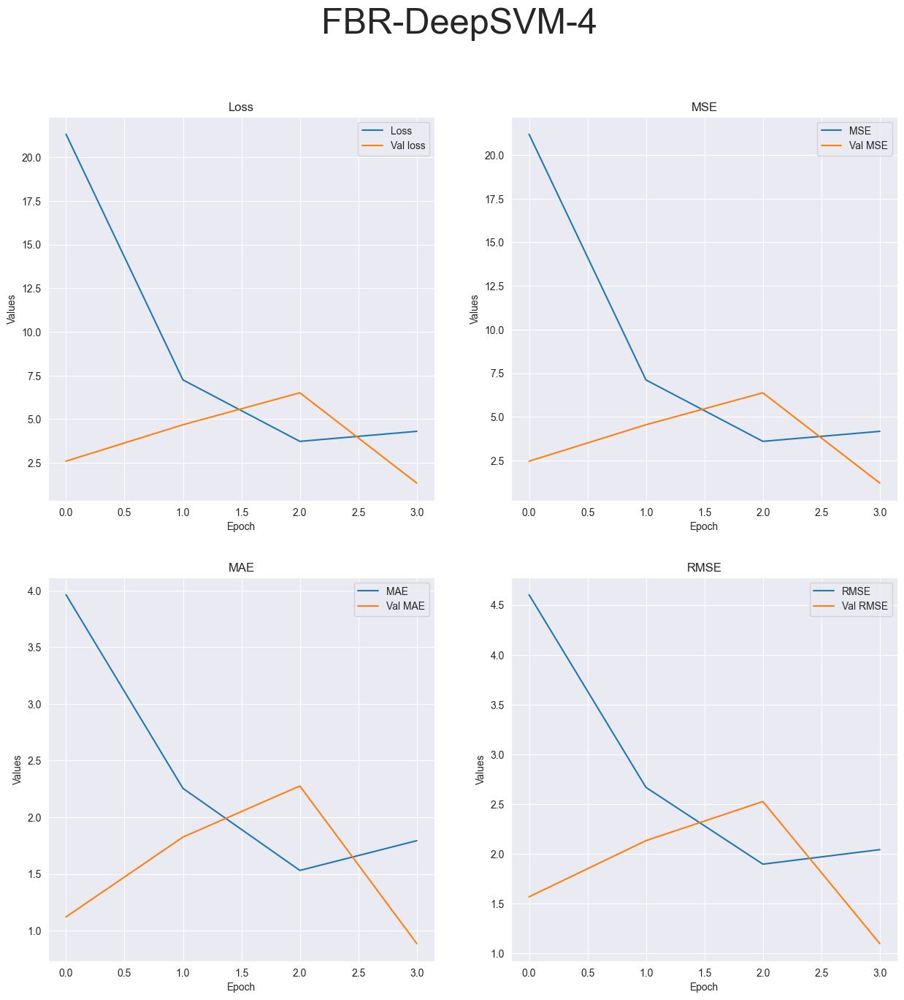

R-squared value: -1.6297


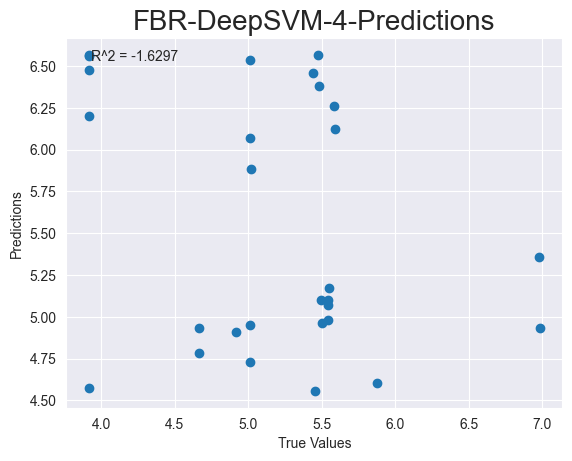

Epoch: 10
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 10
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-DeepSVM-10
Epoch 1/10


2023-05-02 15:47:10.056977: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 245ms/step - loss: 21.0991 - mse: 20.9635 - mae: 3.9249 - root_mean_squared_error: 4.5786 - val_loss: 1.4268 - val_mse: 1.2922 - val_mae: 0.9240 - val_root_mean_squared_error: 1.1367
Epoch 2/10


2023-05-02 15:47:10.976505: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 161ms/step - loss: 10.6661 - mse: 10.5323 - mae: 2.4112 - root_mean_squared_error: 3.2454 - val_loss: 6.2446 - val_mse: 6.1119 - val_mae: 2.1776 - val_root_mean_squared_error: 2.4722
Epoch 3/10
3/3 [==============================] - 0s 43ms/step - loss: 3.6577 - mse: 3.5248 - mae: 1.4892 - root_mean_squared_error: 1.8775 - val_loss: 10.3297 - val_mse: 10.1966 - val_mae: 2.5504 - val_root_mean_squared_error: 3.1932
Epoch 4/10
3/3 [==============================] - 0s 102ms/step - loss: 7.7091 - mse: 7.5761 - mae: 2.2478 - root_mean_squared_error: 2.7525 - val_loss: 1.0765 - val_mse: 0.9445 - val_mae: 0.7758 - val_root_mean_squared_error: 0.9719
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 1.9665 - mse: 1.8349 - mae: 1.0798 - root_mean_squared_error: 1.3546 - val_loss: 4.7308 - val_mse: 4.5996 - val_mae: 1.7816 - val_root_mean_squared_error: 2.1447
Epoch 6/10
3/3 [==============================] - 0s 29ms/step - loss: 4.

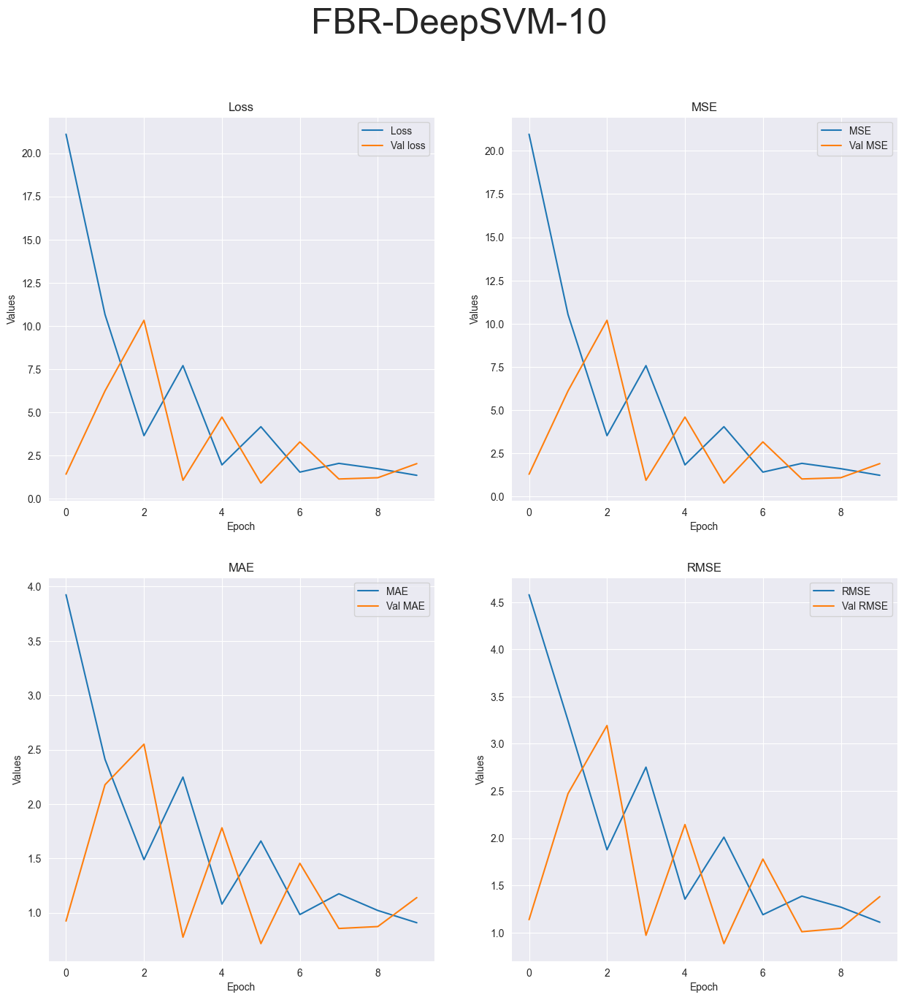

R-squared value: -5.6482


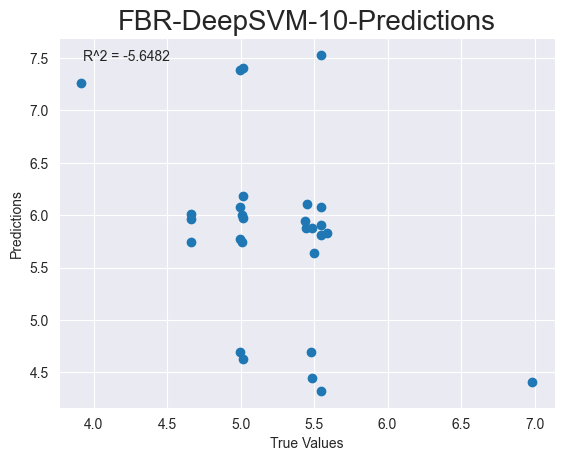

Epoch: 20
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 20
FBR
EXTENTION .csv
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
no ha tronado
FBR-DeepSVM-20
Epoch 1/20


2023-05-02 15:47:13.233086: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 25.6100 - mse: 25.4744 - mae: 4.3265 - root_mean_squared_error: 5.0472

2023-05-02 15:47:14.197019: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 333ms/step - loss: 25.6100 - mse: 25.4744 - mae: 4.3265 - root_mean_squared_error: 5.0472 - val_loss: 2.8591 - val_mse: 2.7246 - val_mae: 1.2589 - val_root_mean_squared_error: 1.6506
Epoch 2/20
3/3 [==============================] - 0s 49ms/step - loss: 12.7886 - mse: 12.6552 - mae: 2.7809 - root_mean_squared_error: 3.5574 - val_loss: 8.8103 - val_mse: 8.6779 - val_mae: 2.5872 - val_root_mean_squared_error: 2.9458
Epoch 3/20
3/3 [==============================] - 0s 69ms/step - loss: 4.7139 - mse: 4.5813 - mae: 1.7329 - root_mean_squared_error: 2.1404 - val_loss: 7.9362 - val_mse: 7.8028 - val_mae: 2.4036 - val_root_mean_squared_error: 2.7934
Epoch 4/20
3/3 [==============================] - 0s 23ms/step - loss: 7.9341 - mse: 7.8009 - mae: 2.3582 - root_mean_squared_error: 2.7930 - val_loss: 0.8842 - val_mse: 0.7518 - val_mae: 0.7117 - val_root_mean_squared_error: 0.8671
Epoch 5/20
3/3 [==============================] - 0s 21ms/step - loss: 1.9

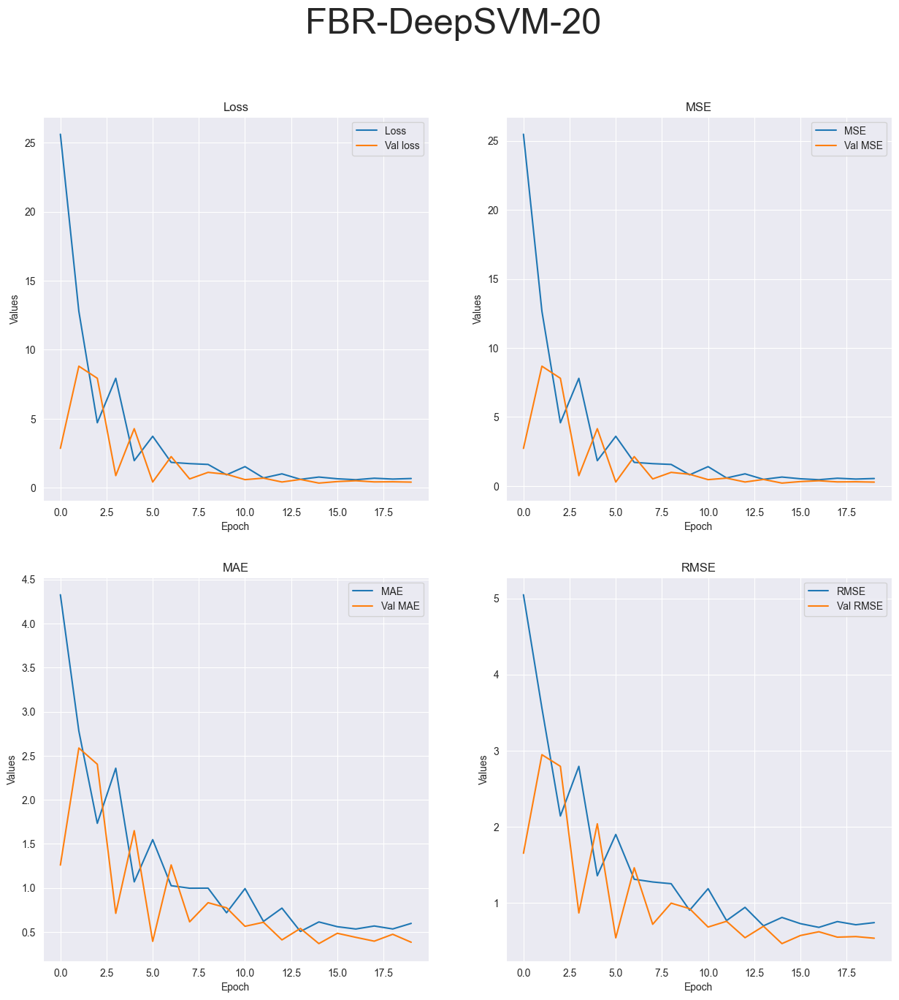

R-squared value: 0.0545


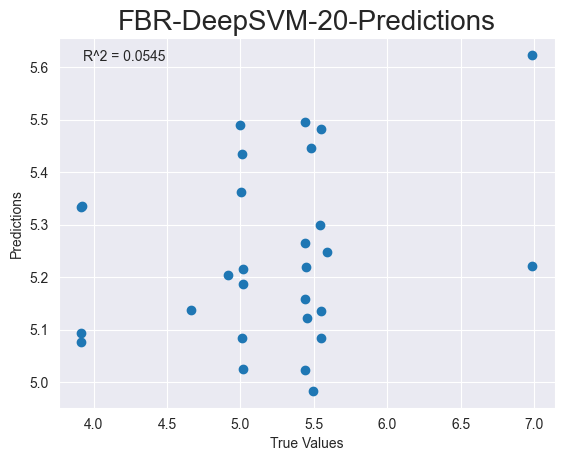

Dataset Name: CBR
Model Name: MLP
Epoch: 2
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 2
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-MLP-2
Epoch 1/2


2023-05-02 15:47:17.315018: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 95.6959 - mse: 95.6959 - mae: 8.0194 - root_mean_squared_error: 9.7824   

2023-05-02 15:47:18.854682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 462ms/step - loss: 95.6959 - mse: 95.6959 - mae: 8.0194 - root_mean_squared_error: 9.7824 - val_loss: 18.2379 - val_mse: 18.2379 - val_mae: 2.0225 - val_root_mean_squared_error: 4.2706
Epoch 2/2
1/1 [==============================] - 0s 106ms/step - loss: 3.5546 - mse: 3.5546 - mae: 1.6606 - root_mean_squared_error: 1.8854
Test loss: [3.55458402633667, 3.55458402633667, 1.6605775356292725, 1.8853604793548584]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


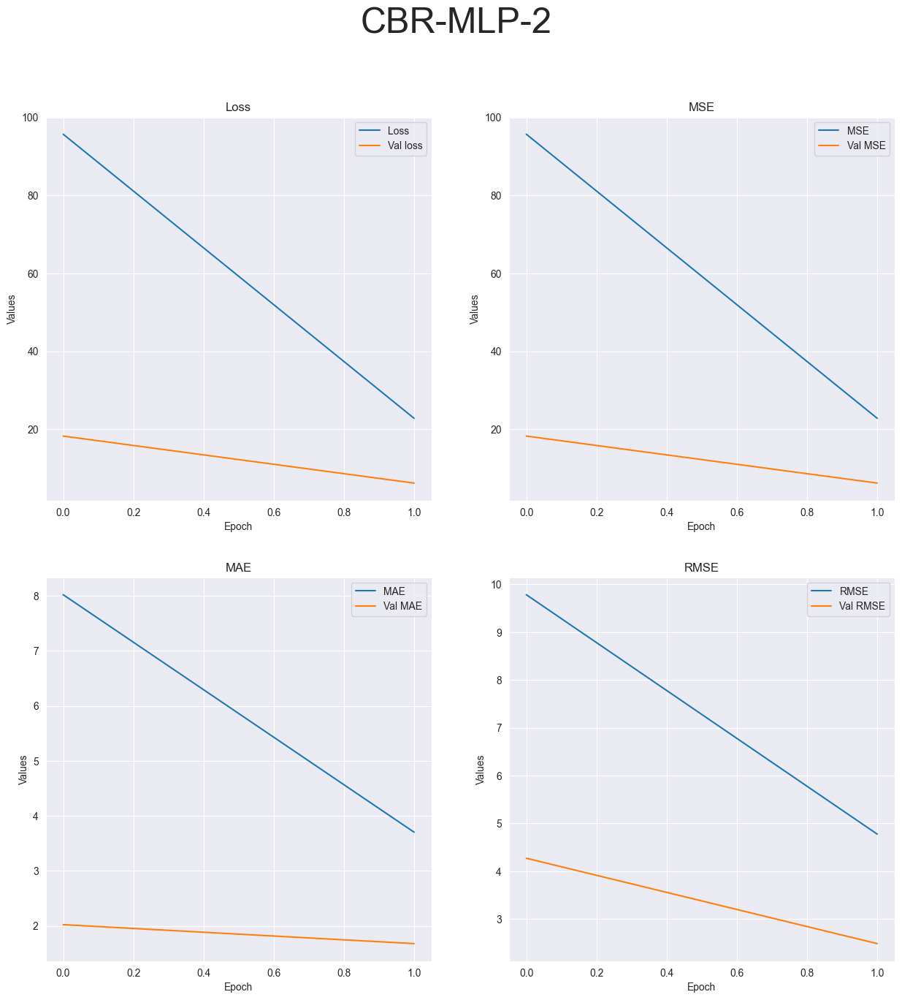

R-squared value: -3.3769


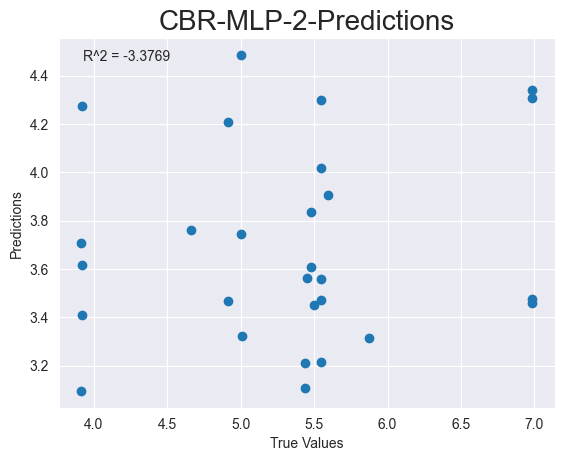

Epoch: 4
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 4
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-MLP-4
Epoch 1/4


2023-05-02 15:47:20.432147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 96.6453 - mse: 96.6453 - mae: 7.9571 - root_mean_squared_error: 9.8308

2023-05-02 15:47:22.037168: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 532ms/step - loss: 96.6453 - mse: 96.6453 - mae: 7.9571 - root_mean_squared_error: 9.8308 - val_loss: 1.3348 - val_mse: 1.3348 - val_mae: 0.9392 - val_root_mean_squared_error: 1.1553
Epoch 2/4
3/3 [==============================] - 1s 216ms/step - loss: 31.5078 - mse: 31.5078 - mae: 4.1882 - root_mean_squared_error: 5.6132 - val_loss: 3.8671 - val_mse: 3.8671 - val_mae: 1.8260 - val_root_mean_squared_error: 1.9665
Epoch 3/4
3/3 [==============================] - 0s 101ms/step - loss: 16.4677 - mse: 16.4677 - mae: 2.9465 - root_mean_squared_error: 4.0580 - val_loss: 7.5372 - val_mse: 7.5372 - val_mae: 2.5975 - val_root_mean_squared_error: 2.7454
Epoch 4/4
1/1 [==============================] - 1s 1s/step - loss: 1.5557 - mse: 1.5557 - mae: 1.1230 - root_mean_squared_error: 1.2473
Test loss: [1.5557079315185547, 1.5557079315185547, 1.1229835748672485, 1.247280240058899]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


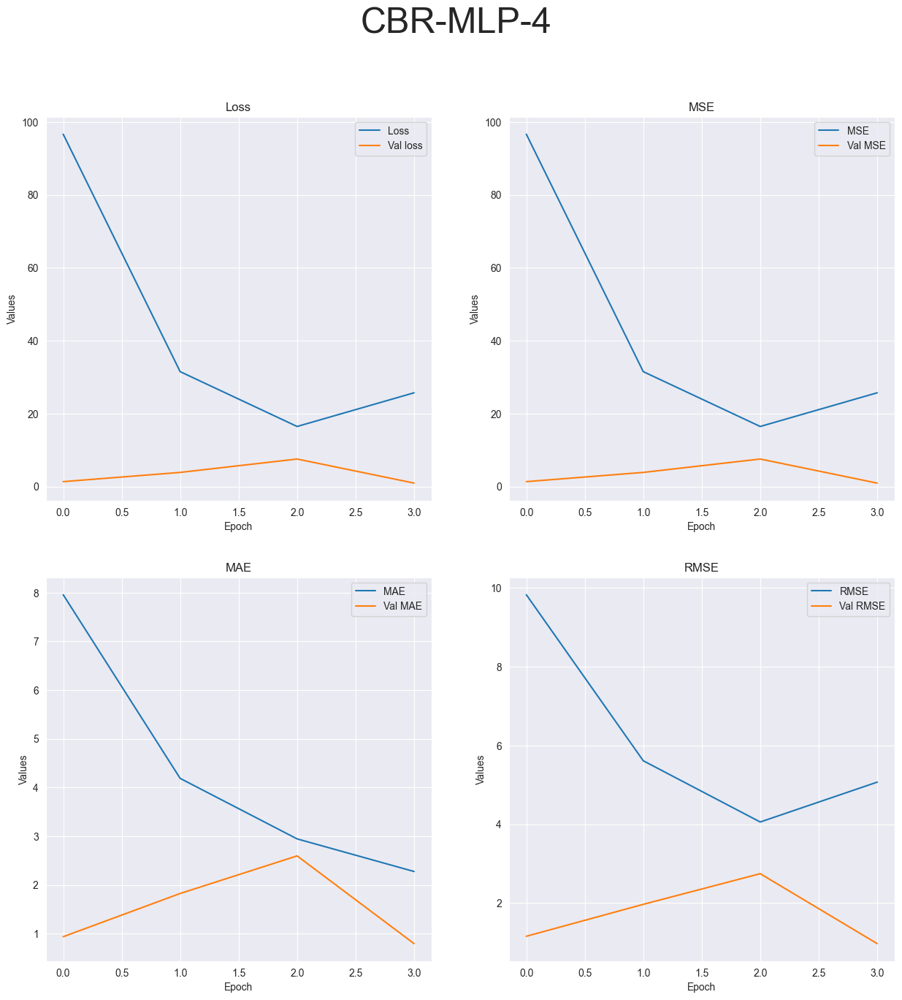

R-squared value: -4.0649


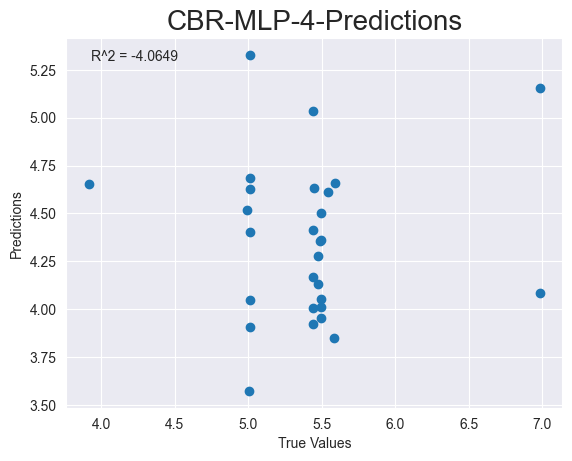

Epoch: 10
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 10
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-MLP-10
Epoch 1/10


2023-05-02 15:47:27.371946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 112.3281 - mse: 112.3281 - mae: 8.3249 - root_mean_squared_error: 10.5985

2023-05-02 15:47:29.521058: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 601ms/step - loss: 112.3281 - mse: 112.3281 - mae: 8.3249 - root_mean_squared_error: 10.5985 - val_loss: 1.8956 - val_mse: 1.8956 - val_mae: 1.1960 - val_root_mean_squared_error: 1.3768
Epoch 2/10
3/3 [==============================] - 0s 54ms/step - loss: 47.4686 - mse: 47.4686 - mae: 4.9697 - root_mean_squared_error: 6.8897 - val_loss: 0.7435 - val_mse: 0.7435 - val_mae: 0.6906 - val_root_mean_squared_error: 0.8623
Epoch 3/10
3/3 [==============================] - 0s 37ms/step - loss: 17.3575 - mse: 17.3575 - mae: 3.1643 - root_mean_squared_error: 4.1662 - val_loss: 9.0040 - val_mse: 9.0040 - val_mae: 2.8948 - val_root_mean_squared_error: 3.0007
Epoch 4/10
3/3 [==============================] - 0s 70ms/step - loss: 14.8431 - mse: 14.8431 - mae: 2.8606 - root_mean_squared_error: 3.8527 - val_loss: 1.0546 - val_mse: 1.0546 - val_mae: 0.8301 - val_root_mean_squared_error: 1.0269
Epoch 5/10
3/3 [==============================] - 0s 68ms/step - lo

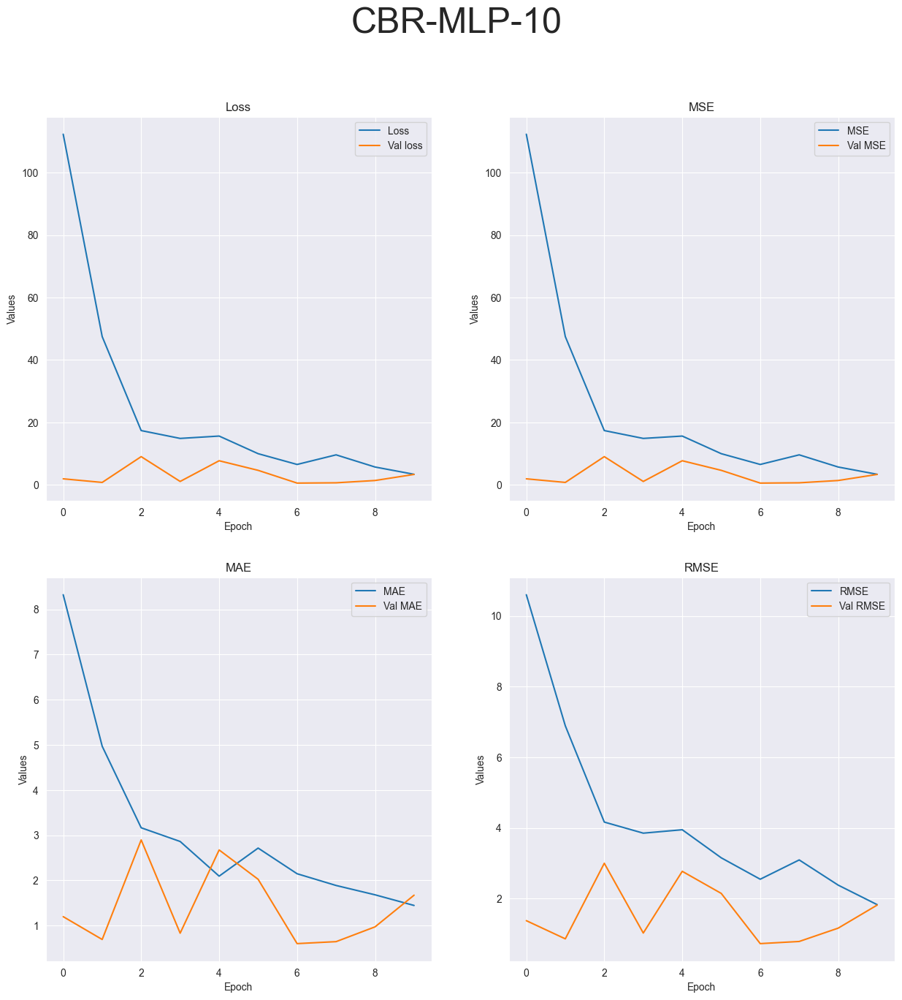

R-squared value: -8.8297


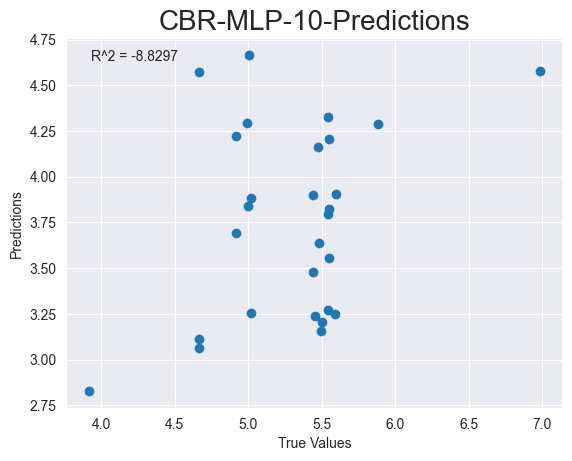

Epoch: 20
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 20
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-MLP-20
Epoch 1/20


2023-05-02 15:47:31.819931: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 106.4708 - mse: 106.4708 - mae: 8.3315 - root_mean_squared_error: 10.3185

2023-05-02 15:47:34.598558: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 974ms/step - loss: 106.4708 - mse: 106.4708 - mae: 8.3315 - root_mean_squared_error: 10.3185 - val_loss: 3.8583 - val_mse: 3.8583 - val_mae: 1.6861 - val_root_mean_squared_error: 1.9643
Epoch 2/20
3/3 [==============================] - 1s 392ms/step - loss: 25.8580 - mse: 25.8580 - mae: 3.9955 - root_mean_squared_error: 5.0851 - val_loss: 3.1362 - val_mse: 3.1362 - val_mae: 1.6336 - val_root_mean_squared_error: 1.7709
Epoch 3/20
3/3 [==============================] - 0s 175ms/step - loss: 15.3029 - mse: 15.3029 - mae: 2.9055 - root_mean_squared_error: 3.9119 - val_loss: 0.9159 - val_mse: 0.9159 - val_mae: 0.8375 - val_root_mean_squared_error: 0.9570
Epoch 4/20
3/3 [==============================] - 1s 180ms/step - loss: 6.3227 - mse: 6.3227 - mae: 1.9986 - root_mean_squared_error: 2.5145 - val_loss: 0.7410 - val_mse: 0.7410 - val_mae: 0.6999 - val_root_mean_squared_error: 0.8608
Epoch 5/20
3/3 [==============================] - 2s 814ms/step - 

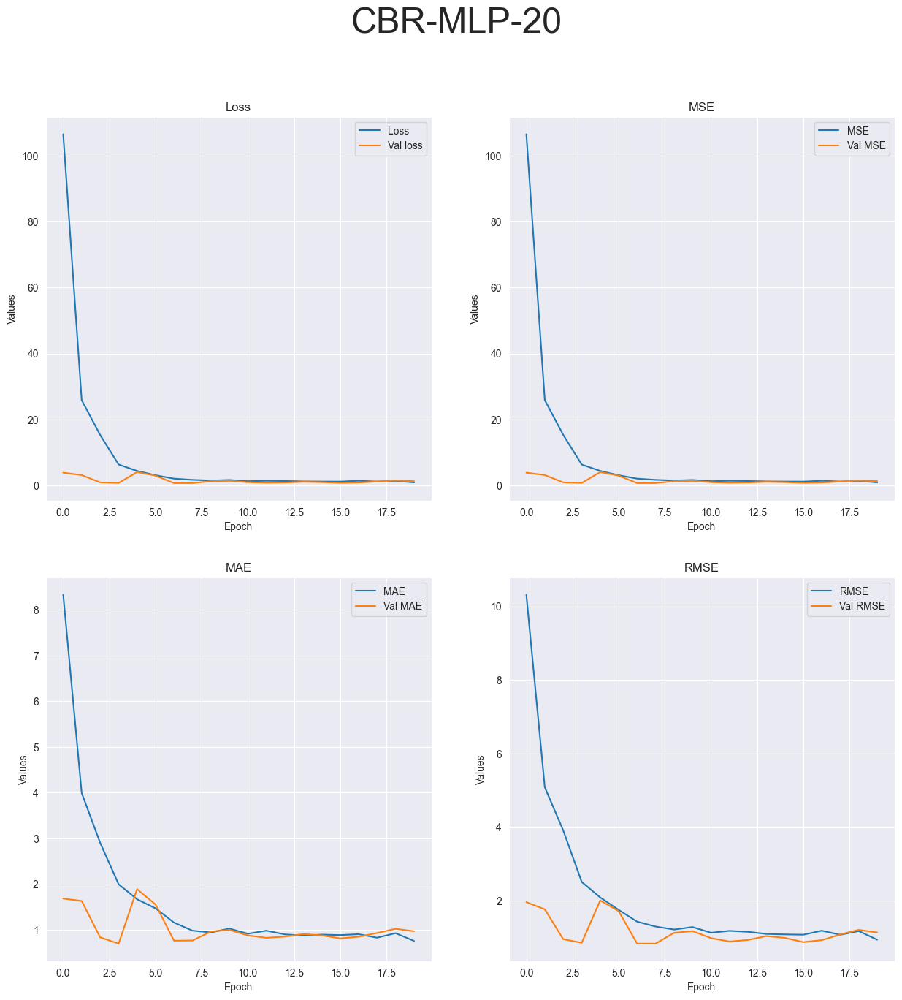

R-squared value: -8.6726


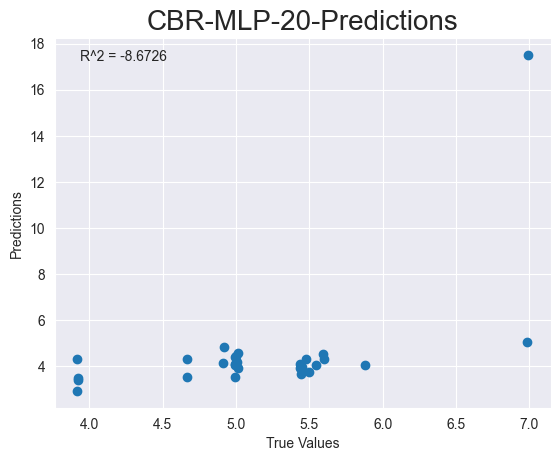

Model Name: FCNN
Epoch: 2
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 2
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-FCNN-2
Epoch 1/2


2023-05-02 15:47:44.627503: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 161.8055 - mse: 161.8055 - mae: 10.1955 - root_mean_squared_error: 12.7203

2023-05-02 15:47:45.942147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 306ms/step - loss: 161.8055 - mse: 161.8055 - mae: 10.1955 - root_mean_squared_error: 12.7203 - val_loss: 60.8353 - val_mse: 60.8353 - val_mae: 7.7704 - val_root_mean_squared_error: 7.7997
Epoch 2/2
1/1 [==============================] - 0s 178ms/step - loss: 70.6952 - mse: 70.6952 - mae: 8.3499 - root_mean_squared_error: 8.4080
Test loss: [70.6951904296875, 70.6951904296875, 8.349879264831543, 8.408042907714844]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


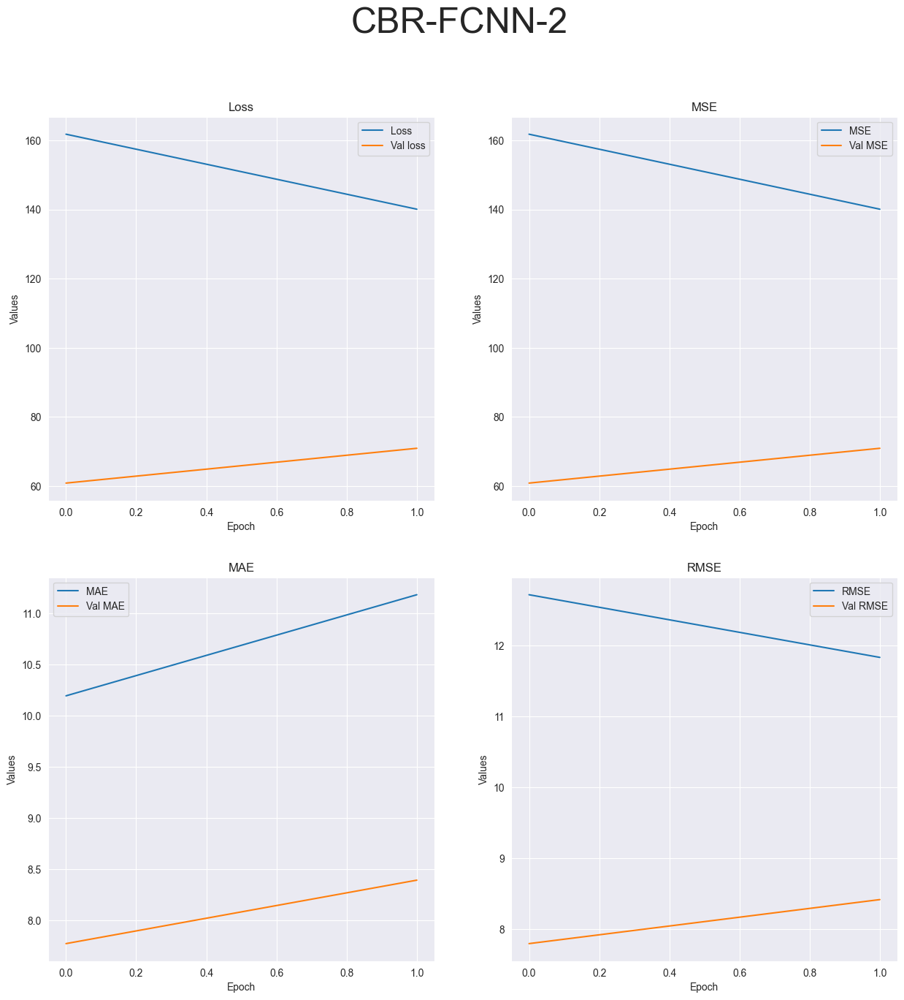

R-squared value: -119.8739


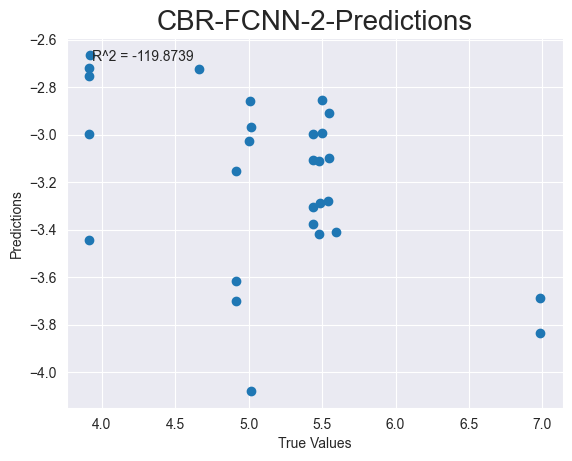

Epoch: 4
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 4
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-FCNN-4
Epoch 1/4


2023-05-02 15:47:47.705819: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 150.1160 - mse: 150.1160 - mae: 9.9990 - root_mean_squared_error: 12.2522 

2023-05-02 15:47:48.592760: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 265ms/step - loss: 150.1160 - mse: 150.1160 - mae: 9.9990 - root_mean_squared_error: 12.2522 - val_loss: 26.6840 - val_mse: 26.6840 - val_mae: 5.1073 - val_root_mean_squared_error: 5.1657
Epoch 2/4
3/3 [==============================] - 0s 89ms/step - loss: 83.1398 - mse: 83.1398 - mae: 8.6085 - root_mean_squared_error: 9.1181 - val_loss: 37.0584 - val_mse: 37.0584 - val_mae: 6.0331 - val_root_mean_squared_error: 6.0876
Epoch 3/4
3/3 [==============================] - 0s 39ms/step - loss: 18.7490 - mse: 18.7490 - mae: 3.5292 - root_mean_squared_error: 4.3300 - val_loss: 12.3164 - val_mse: 12.3164 - val_mae: 3.3908 - val_root_mean_squared_error: 3.5095
Epoch 4/4
1/1 [==============================] - 0s 157ms/step - loss: 8.3911 - mse: 8.3911 - mae: 2.7201 - root_mean_squared_error: 2.8967
Test loss: [8.39113712310791, 8.39113712310791, 2.7201087474823, 2.8967459201812744]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING Tr

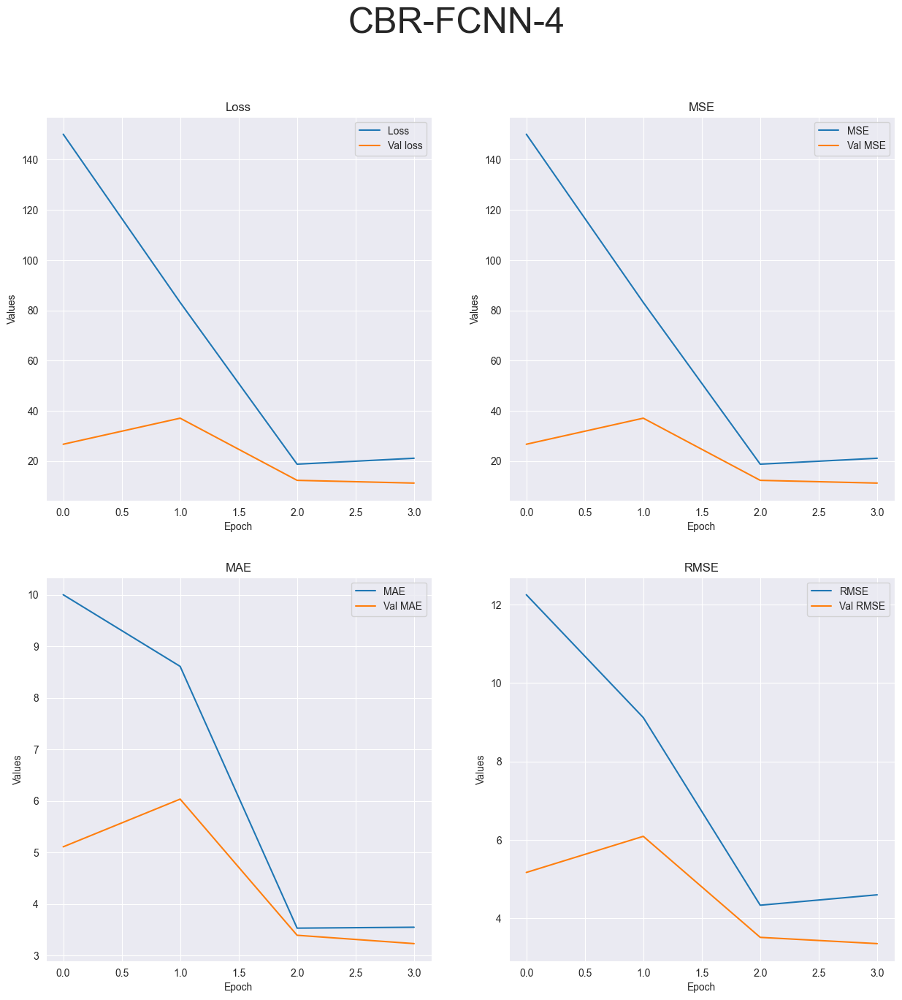

R-squared value: -29.0337


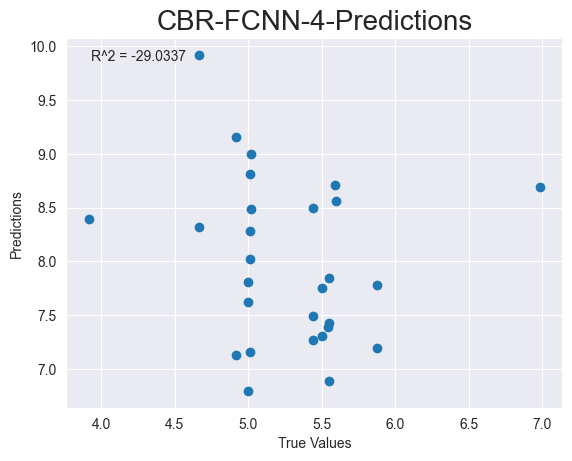

Epoch: 10
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 10
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-FCNN-10
Epoch 1/10


2023-05-02 15:47:50.330651: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 242.0610 - mse: 242.0610 - mae: 10.3627 - root_mean_squared_error: 15.5583

2023-05-02 15:47:51.297263: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 274ms/step - loss: 242.0610 - mse: 242.0610 - mae: 10.3627 - root_mean_squared_error: 15.5583 - val_loss: 47.5614 - val_mse: 47.5614 - val_mae: 6.8761 - val_root_mean_squared_error: 6.8965
Epoch 2/10
3/3 [==============================] - 0s 62ms/step - loss: 114.6717 - mse: 114.6717 - mae: 10.0880 - root_mean_squared_error: 10.7085 - val_loss: 71.7011 - val_mse: 71.7011 - val_mae: 8.4484 - val_root_mean_squared_error: 8.4677
Epoch 3/10
3/3 [==============================] - 0s 74ms/step - loss: 42.0123 - mse: 42.0123 - mae: 5.7139 - root_mean_squared_error: 6.4817 - val_loss: 0.8316 - val_mse: 0.8316 - val_mae: 0.6850 - val_root_mean_squared_error: 0.9119
Epoch 4/10
3/3 [==============================] - 0s 32ms/step - loss: 12.2712 - mse: 12.2712 - mae: 1.9512 - root_mean_squared_error: 3.5030 - val_loss: 5.6557 - val_mse: 5.6557 - val_mae: 2.2328 - val_root_mean_squared_error: 2.3782
Epoch 5/10
3/3 [==============================] - 0s 43ms/

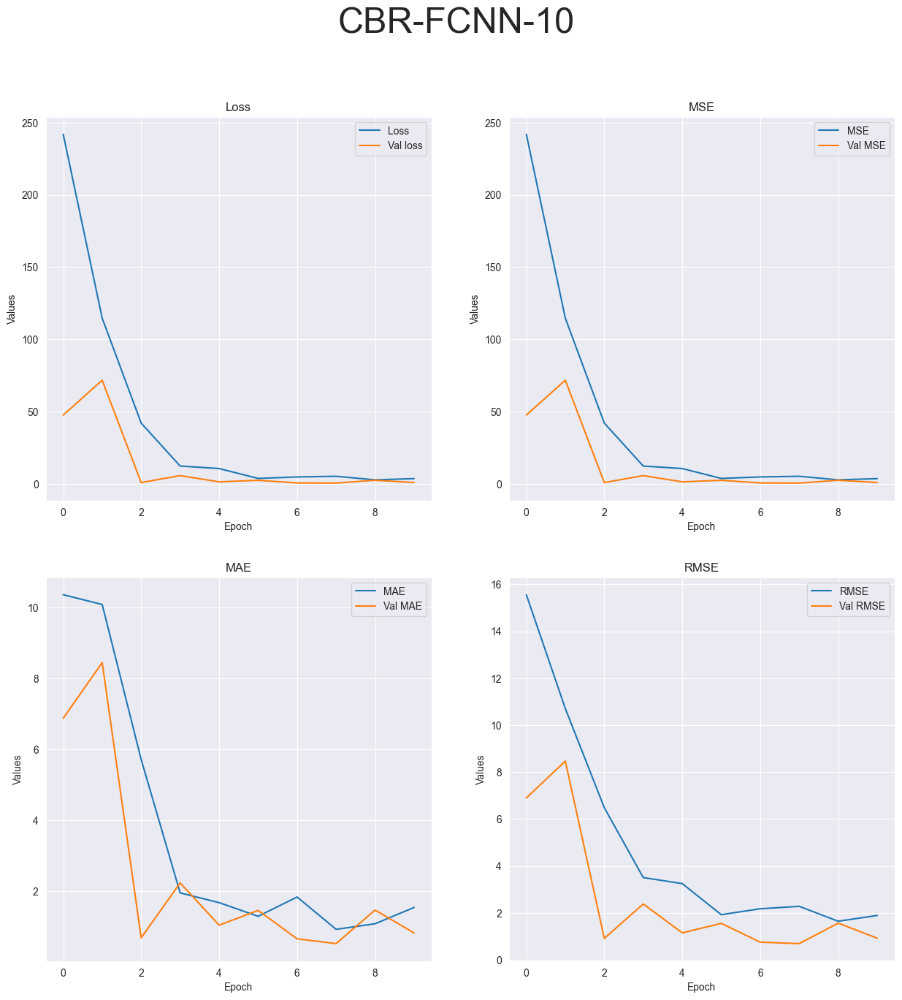

R-squared value: -0.9953


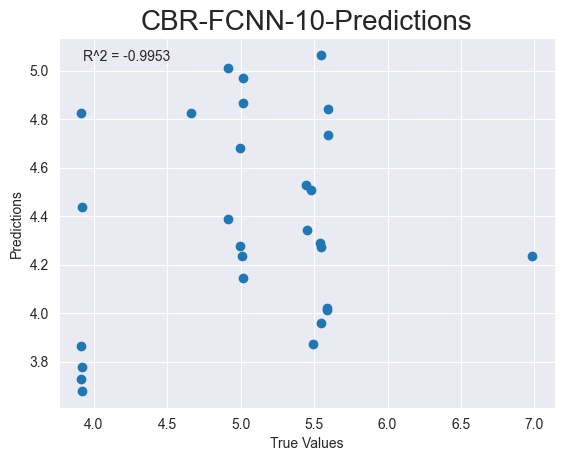

Epoch: 20
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 20
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-FCNN-20
Epoch 1/20


2023-05-02 15:47:53.478418: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 167.8156 - mse: 167.8156 - mae: 10.3132 - root_mean_squared_error: 12.9544

2023-05-02 15:47:54.466938: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 368ms/step - loss: 167.8156 - mse: 167.8156 - mae: 10.3132 - root_mean_squared_error: 12.9544 - val_loss: 61.6463 - val_mse: 61.6463 - val_mae: 7.7969 - val_root_mean_squared_error: 7.8515
Epoch 2/20
3/3 [==============================] - 0s 94ms/step - loss: 128.5972 - mse: 128.5972 - mae: 10.6562 - root_mean_squared_error: 11.3401 - val_loss: 64.1404 - val_mse: 64.1404 - val_mae: 7.9547 - val_root_mean_squared_error: 8.0088
Epoch 3/20
3/3 [==============================] - 0s 20ms/step - loss: 30.7364 - mse: 30.7364 - mae: 4.6049 - root_mean_squared_error: 5.5440 - val_loss: 1.6867 - val_mse: 1.6867 - val_mae: 1.0120 - val_root_mean_squared_error: 1.2987
Epoch 4/20
3/3 [==============================] - 0s 46ms/step - loss: 11.1200 - mse: 11.1200 - mae: 1.9786 - root_mean_squared_error: 3.3347 - val_loss: 1.6726 - val_mse: 1.6726 - val_mae: 1.0125 - val_root_mean_squared_error: 1.2933
Epoch 5/20
3/3 [==============================] - 0s 63ms/

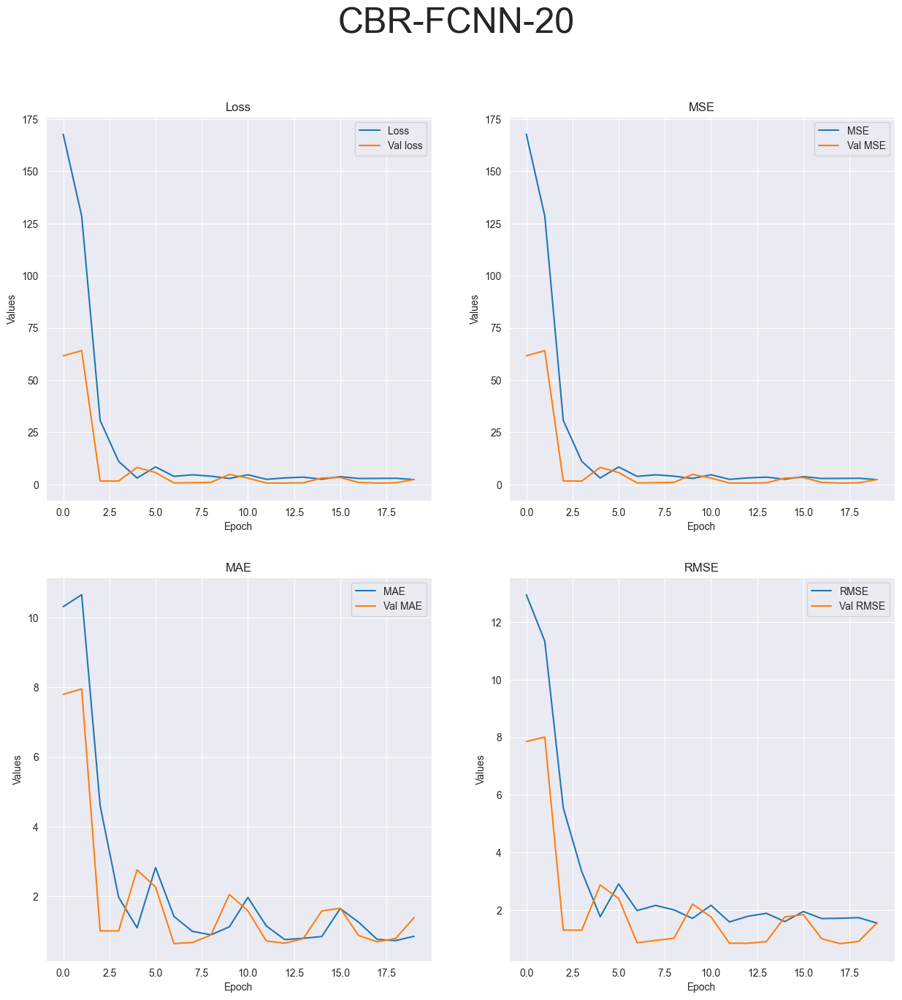

R-squared value: -3.3238


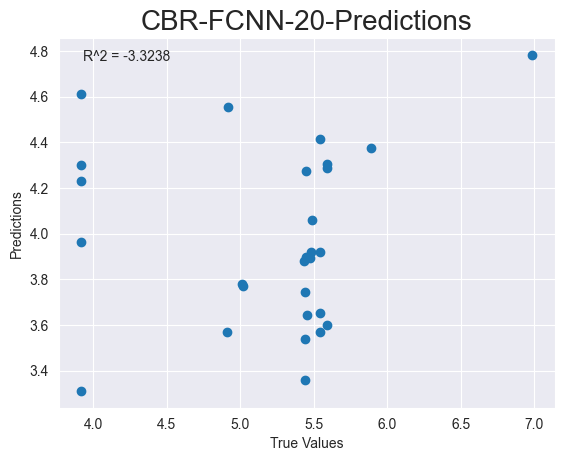

Model Name: DeepSVM
Epoch: 2
Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 2
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-DeepSVM-2
Epoch 1/2


2023-05-02 15:47:57.511436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 241ms/step - loss: 3680.0193 - mse: 3679.9631 - mae: 55.7626 - root_mean_squared_error: 60.6627 - val_loss: 17.8403 - val_mse: 17.7863 - val_mae: 3.6236 - val_root_mean_squared_error: 4.2174
Epoch 2/2


2023-05-02 15:47:58.535729: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 117ms/step - loss: 1119.1986 - mse: 1119.1442 - mae: 33.3335 - root_mean_squared_error: 33.4536
Test loss: [1119.1986083984375, 1119.1441650390625, 33.33353805541992, 33.45361328125]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


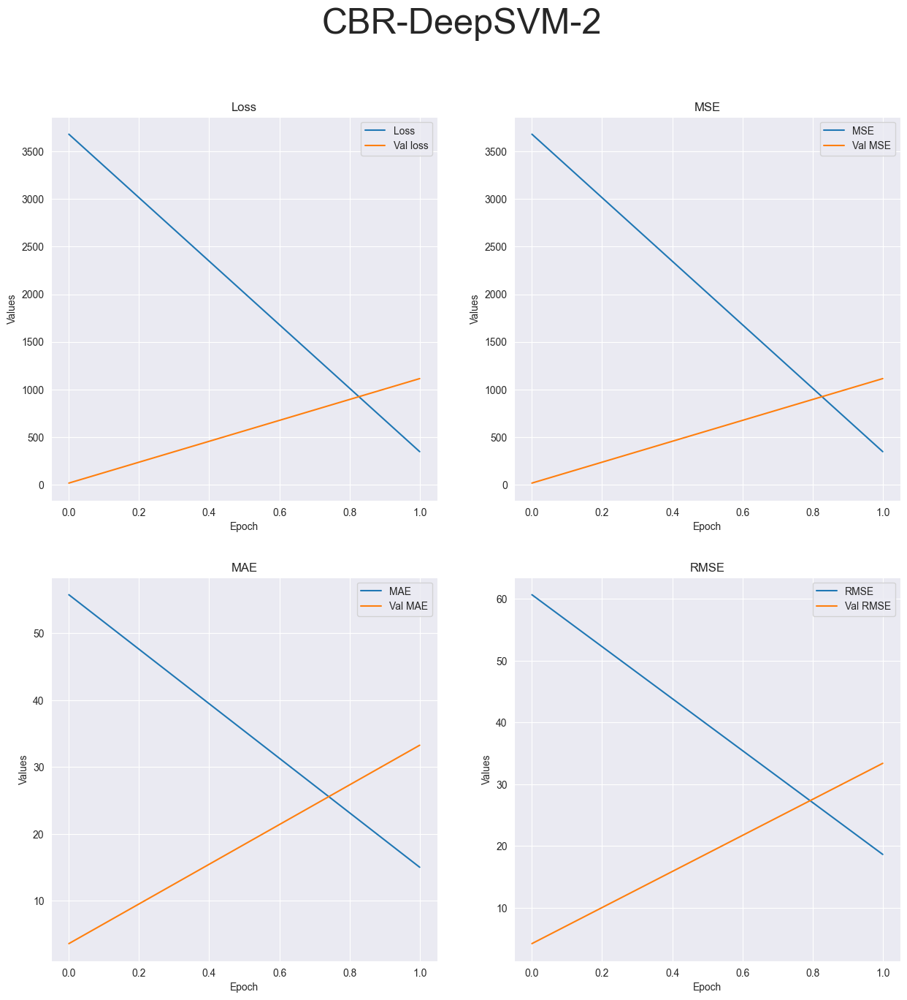

R-squared value: -1926.8617


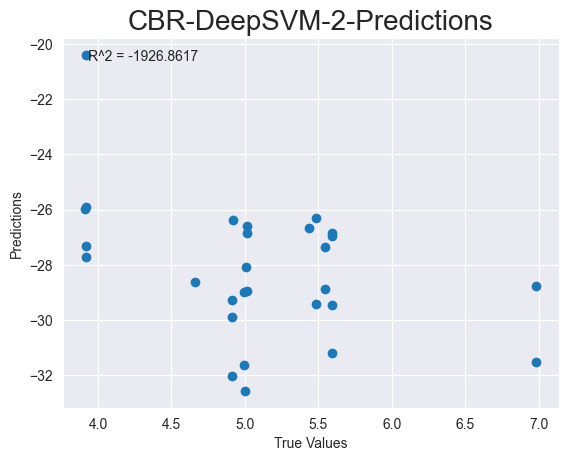

Epoch: 4
Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 4
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-DeepSVM-4
Epoch 1/4


2023-05-02 15:48:00.107757: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 4681.0215 - mse: 4680.9658 - mae: 57.4347 - root_mean_squared_error: 68.4176

2023-05-02 15:48:03.764732: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 4681.0215 - mse: 4680.9658 - mae: 57.4347 - root_mean_squared_error: 68.4176 - val_loss: 114.3398 - val_mse: 114.2858 - val_mae: 9.9580 - val_root_mean_squared_error: 10.6905
Epoch 2/4
3/3 [==============================] - 0s 64ms/step - loss: 196.3299 - mse: 196.2756 - mae: 12.2852 - root_mean_squared_error: 14.0098 - val_loss: 906.2872 - val_mse: 906.2325 - val_mae: 30.0316 - val_root_mean_squared_error: 30.1037
Epoch 3/4
3/3 [==============================] - 0s 71ms/step - loss: 1094.6741 - mse: 1094.6198 - mae: 31.3316 - root_mean_squared_error: 33.0850 - val_loss: 776.6957 - val_mse: 776.6426 - val_mae: 27.8023 - val_root_mean_squared_error: 27.8683
Epoch 4/4
1/1 [==============================] - 0s 77ms/step - loss: 97.6137 - mse: 97.5626 - mae: 9.8043 - root_mean_squared_error: 9.8774
Test loss: [97.6136703491211, 97.56261444091797, 9.804322242736816, 9.877378463745117]
['loss', 'mse', 'mae', 'root_mean_squared_error']

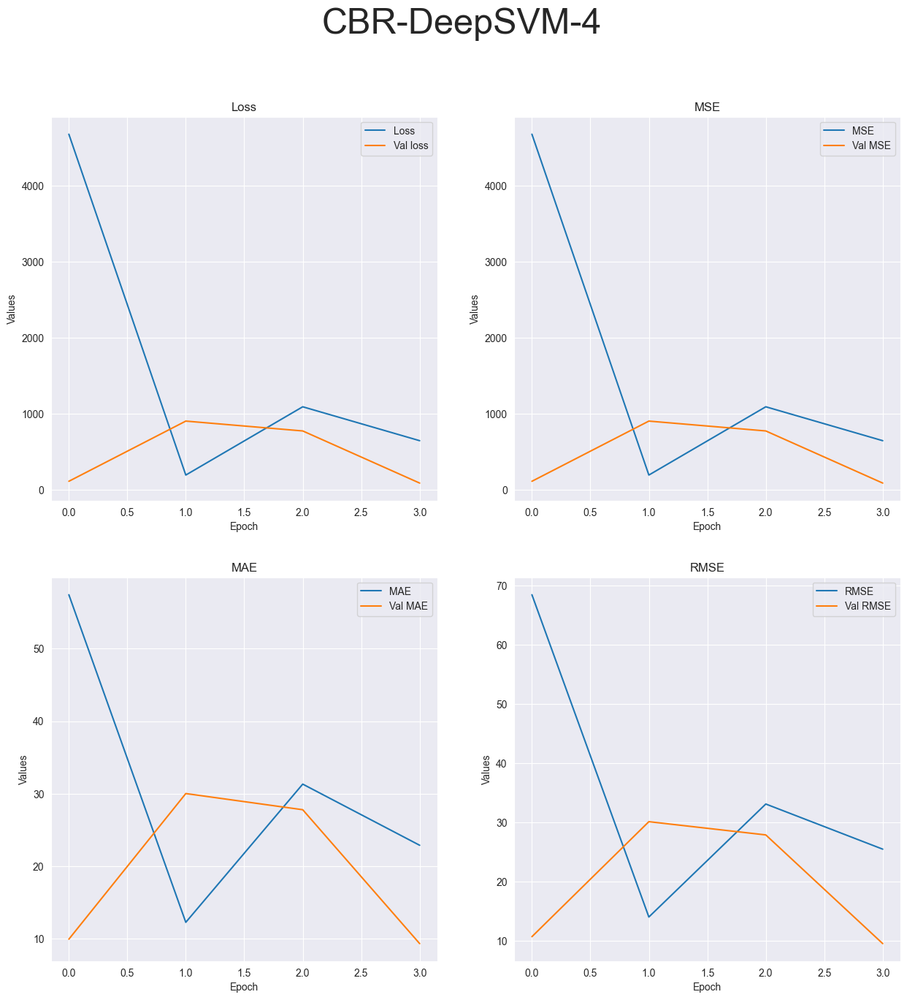

R-squared value: -213.9315


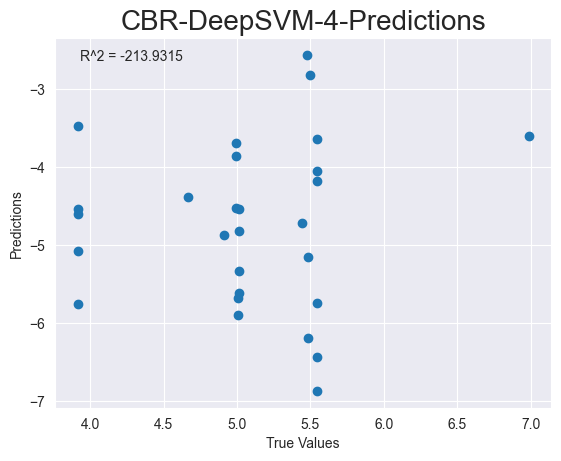

Epoch: 10
Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 10
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-DeepSVM-10
Epoch 1/10


2023-05-02 15:48:07.508661: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 3646.1328 - mse: 3646.0769 - mae: 55.7008 - root_mean_squared_error: 60.3828

2023-05-02 15:48:08.798175: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 418ms/step - loss: 3646.1328 - mse: 3646.0769 - mae: 55.7008 - root_mean_squared_error: 60.3828 - val_loss: 15.5468 - val_mse: 15.4929 - val_mae: 3.2528 - val_root_mean_squared_error: 3.9361
Epoch 2/10
3/3 [==============================] - 0s 55ms/step - loss: 359.6853 - mse: 359.6310 - mae: 15.1044 - root_mean_squared_error: 18.9639 - val_loss: 1163.2301 - val_mse: 1163.1757 - val_mae: 33.9851 - val_root_mean_squared_error: 34.1054
Epoch 3/10
3/3 [==============================] - 0s 35ms/step - loss: 1349.7095 - mse: 1349.6555 - mae: 34.4544 - root_mean_squared_error: 36.7377 - val_loss: 645.7628 - val_mse: 645.7103 - val_mae: 25.3334 - val_root_mean_squared_error: 25.4108
Epoch 4/10
3/3 [==============================] - 0s 35ms/step - loss: 489.5822 - mse: 489.5304 - mae: 19.0823 - root_mean_squared_error: 22.1253 - val_loss: 12.6074 - val_mse: 12.5568 - val_mae: 3.2411 - val_root_mean_squared_error: 3.5436
Epoch 5/10
3/3 [================

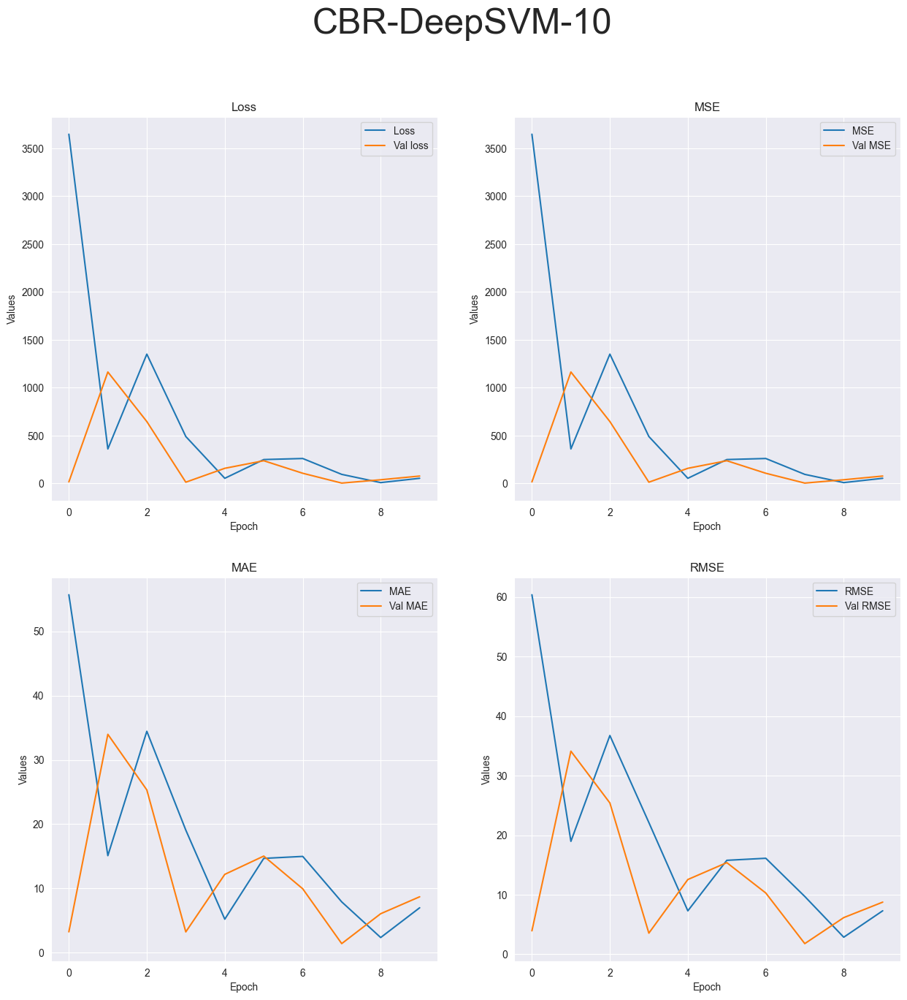

R-squared value: -293.5993


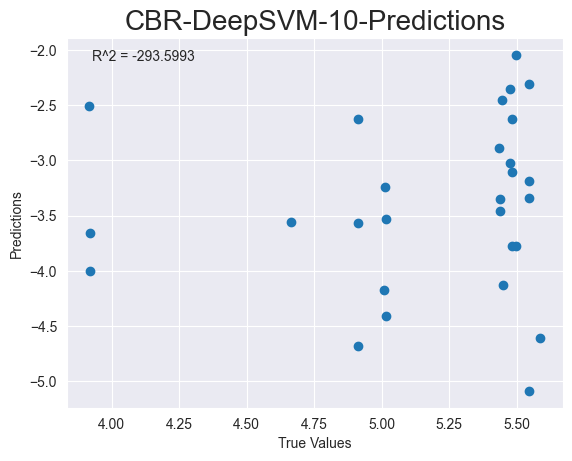

Epoch: 20
Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 20
CBR
EXTENTION .csv
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
no ha tronado
CBR-DeepSVM-20
Epoch 1/20


2023-05-02 15:48:11.307802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 4712.1094 - mse: 4712.0542 - mae: 58.0547 - root_mean_squared_error: 68.6444

2023-05-02 15:48:12.260216: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 363ms/step - loss: 4712.1094 - mse: 4712.0542 - mae: 58.0547 - root_mean_squared_error: 68.6444 - val_loss: 71.1291 - val_mse: 71.0751 - val_mae: 7.8089 - val_root_mean_squared_error: 8.4306
Epoch 2/20
3/3 [==============================] - 0s 72ms/step - loss: 216.6459 - mse: 216.5916 - mae: 12.8448 - root_mean_squared_error: 14.7171 - val_loss: 901.9106 - val_mse: 901.8560 - val_mae: 29.9535 - val_root_mean_squared_error: 30.0309
Epoch 3/20
3/3 [==============================] - 0s 45ms/step - loss: 1240.9791 - mse: 1240.9248 - mae: 33.0332 - root_mean_squared_error: 35.2268 - val_loss: 781.3051 - val_mse: 781.2519 - val_mae: 27.8786 - val_root_mean_squared_error: 27.9509
Epoch 4/20
3/3 [==============================] - 0s 50ms/step - loss: 642.9792 - mse: 642.9268 - mae: 23.6284 - root_mean_squared_error: 25.3560 - val_loss: 98.9517 - val_mse: 98.9006 - val_mae: 9.8250 - val_root_mean_squared_error: 9.9449
Epoch 5/20
3/3 [==================

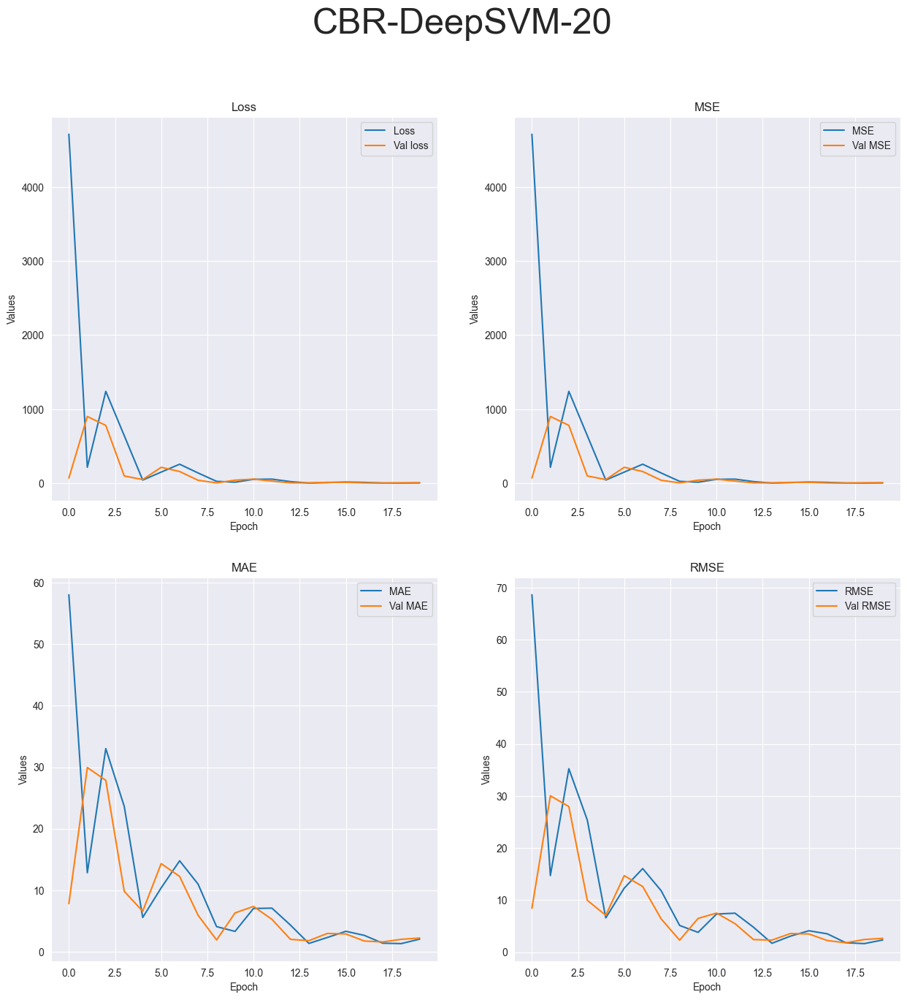

R-squared value: -13.1093


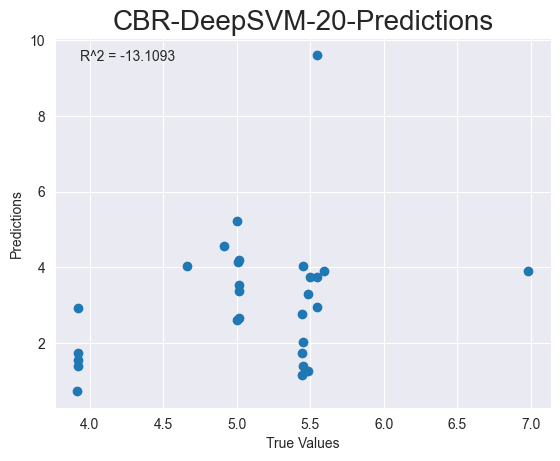

Dataset Name: ABR
Model Name: MLP
Epoch: 2
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 2
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-MLP-2
Epoch 1/2


2023-05-02 15:48:15.611609: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 389ms/step - loss: 2502523.7500 - mse: 2502523.7500 - mae: 1243.9624 - root_mean_squared_error: 1581.9368 - val_loss: 54929.4062 - val_mse: 54929.4062 - val_mae: 225.1999 - val_root_mean_squared_error: 234.3702
Epoch 2/2


2023-05-02 15:48:17.346404: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 95ms/step - loss: 14186.7832 - mse: 14186.7832 - mae: 115.7008 - root_mean_squared_error: 119.1083
Test loss: [14186.783203125, 14186.783203125, 115.70082092285156, 119.10828399658203]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


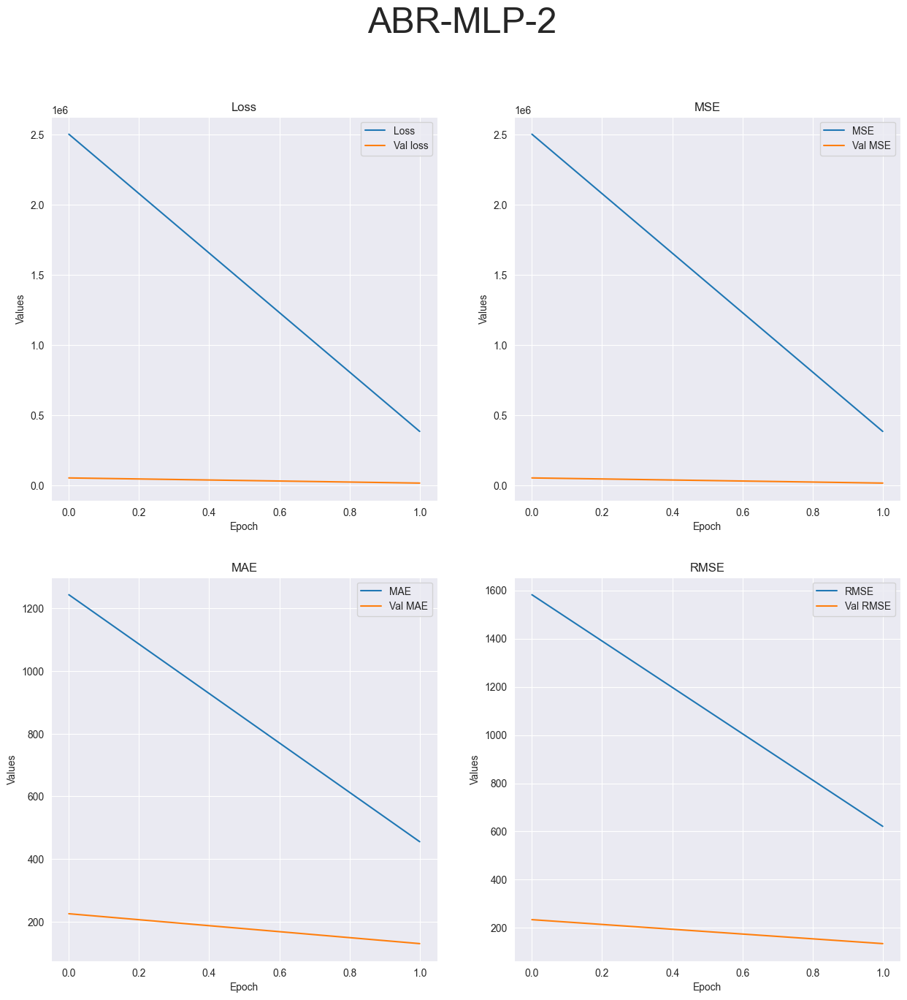

R-squared value: -40887.8276


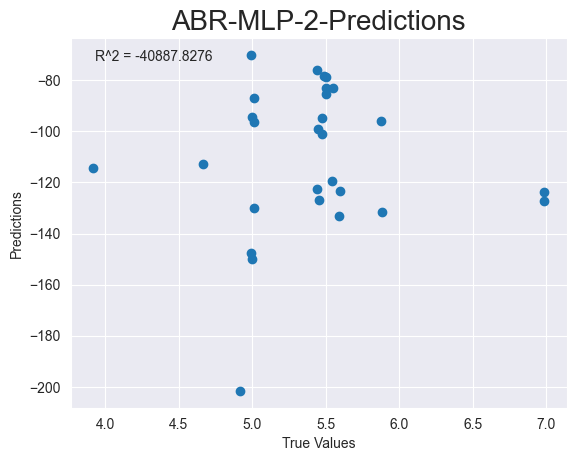

Epoch: 4
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 4
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-MLP-4
Epoch 1/4


2023-05-02 15:48:18.869882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2305401.5000 - mse: 2305401.5000 - mae: 1227.1359 - root_mean_squared_error: 1518.3549

2023-05-02 15:48:20.378465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 461ms/step - loss: 2305401.5000 - mse: 2305401.5000 - mae: 1227.1359 - root_mean_squared_error: 1518.3549 - val_loss: 16395.2441 - val_mse: 16395.2441 - val_mae: 123.2810 - val_root_mean_squared_error: 128.0439
Epoch 2/4
3/3 [==============================] - 0s 105ms/step - loss: 404169.5312 - mse: 404169.5312 - mae: 488.4796 - root_mean_squared_error: 635.7433 - val_loss: 37045.2422 - val_mse: 37045.2422 - val_mae: 184.6200 - val_root_mean_squared_error: 192.4714
Epoch 3/4
3/3 [==============================] - 0s 86ms/step - loss: 208075.7500 - mse: 208075.7500 - mae: 352.3863 - root_mean_squared_error: 456.1532 - val_loss: 31593.6445 - val_mse: 31593.6445 - val_mae: 169.6730 - val_root_mean_squared_error: 177.7460
Epoch 4/4
1/1 [==============================] - 0s 143ms/step - loss: 75681.3906 - mse: 75681.3906 - mae: 260.8436 - root_mean_squared_error: 275.1025
Test loss: [75681.390625, 75681.390625, 260.84356689453125, 275.1025085449219]

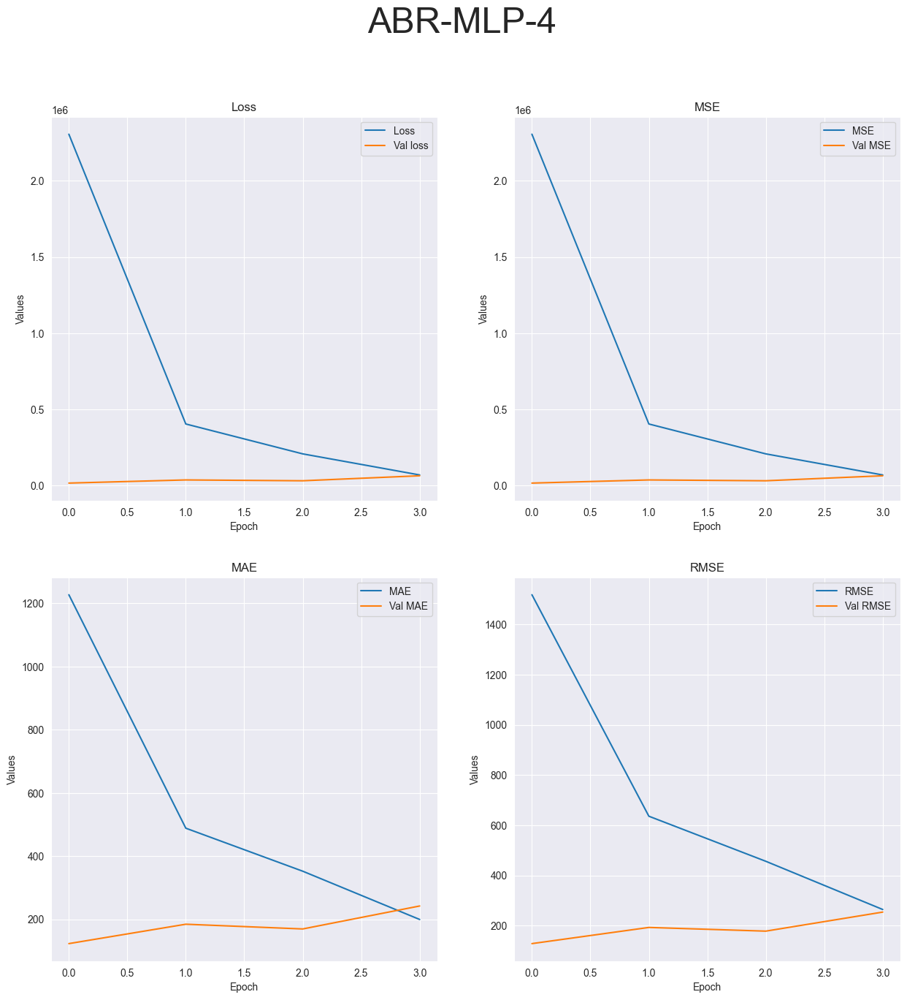

R-squared value: -357138.7745


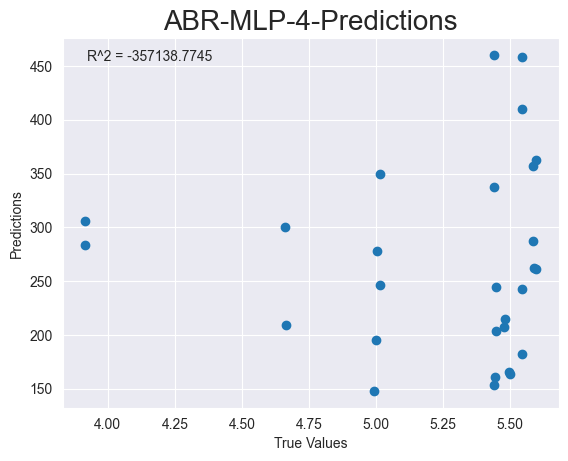

Epoch: 10
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 10
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-MLP-10
Epoch 1/10


2023-05-02 15:48:22.579295: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2216453.7500 - mse: 2216453.7500 - mae: 1214.4352 - root_mean_squared_error: 1488.7759

2023-05-02 15:48:23.866120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 401ms/step - loss: 2216453.7500 - mse: 2216453.7500 - mae: 1214.4352 - root_mean_squared_error: 1488.7759 - val_loss: 29954.8262 - val_mse: 29954.8262 - val_mae: 166.8190 - val_root_mean_squared_error: 173.0746
Epoch 2/10
3/3 [==============================] - 1s 217ms/step - loss: 472379.5625 - mse: 472379.5625 - mae: 517.6238 - root_mean_squared_error: 687.2988 - val_loss: 8068.5312 - val_mse: 8068.5312 - val_mae: 87.1071 - val_root_mean_squared_error: 89.8250
Epoch 3/10
3/3 [==============================] - 0s 72ms/step - loss: 236972.0469 - mse: 236972.0469 - mae: 355.9228 - root_mean_squared_error: 486.7978 - val_loss: 24060.0488 - val_mse: 24060.0488 - val_mae: 149.3858 - val_root_mean_squared_error: 155.1130
Epoch 4/10
3/3 [==============================] - 0s 68ms/step - loss: 52372.5156 - mse: 52372.5156 - mae: 170.2286 - root_mean_squared_error: 228.8504 - val_loss: 31153.9512 - val_mse: 31153.9512 - val_mae: 170.0447 - val_root_mean

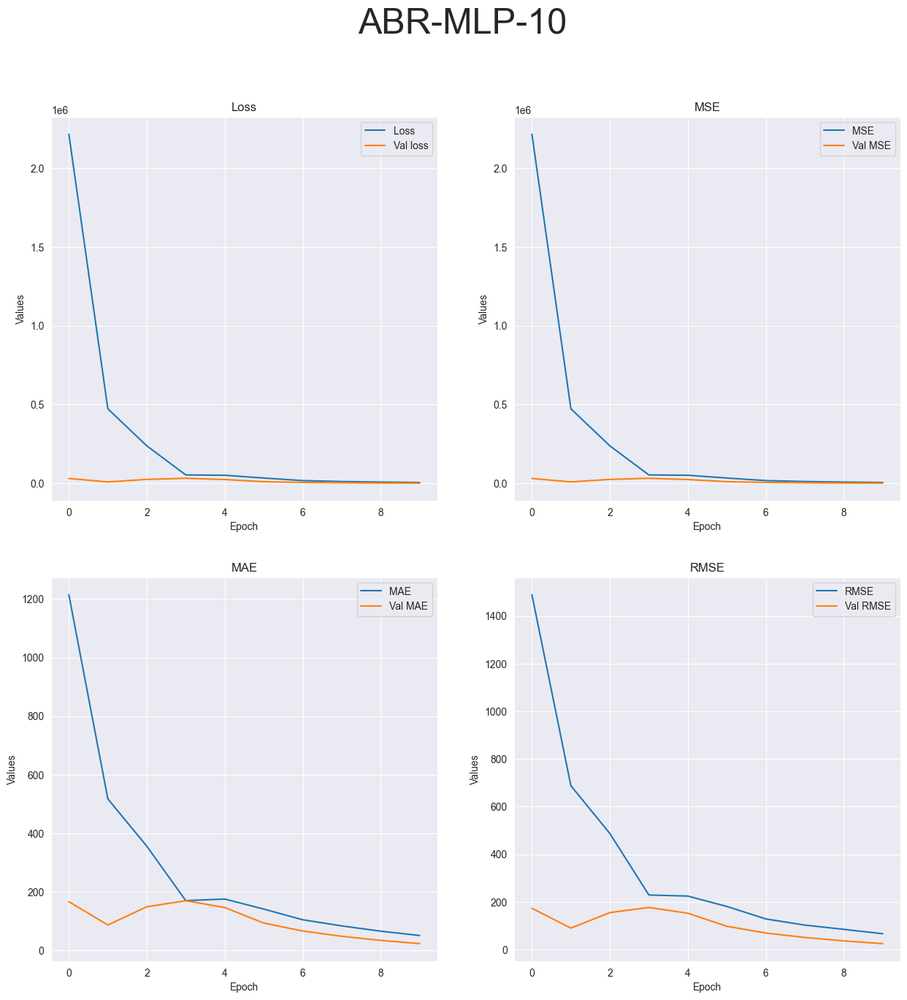

R-squared value: -1251.9071


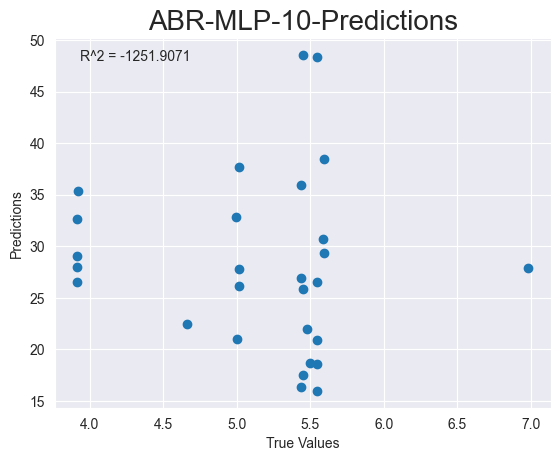

Epoch: 20
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 20
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-MLP-20
Epoch 1/20


2023-05-02 15:48:26.716869: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2341171.0000 - mse: 2341171.0000 - mae: 1221.9399 - root_mean_squared_error: 1530.0885

2023-05-02 15:48:29.460326: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 927ms/step - loss: 2341171.0000 - mse: 2341171.0000 - mae: 1221.9399 - root_mean_squared_error: 1530.0885 - val_loss: 62320.5742 - val_mse: 62320.5742 - val_mae: 237.5621 - val_root_mean_squared_error: 249.6409
Epoch 2/20
3/3 [==============================] - 1s 176ms/step - loss: 517489.0938 - mse: 517489.0938 - mae: 548.4788 - root_mean_squared_error: 719.3671 - val_loss: 418250.0000 - val_mse: 418250.0000 - val_mae: 613.7940 - val_root_mean_squared_error: 646.7225
Epoch 3/20
3/3 [==============================] - 0s 36ms/step - loss: 341821.8125 - mse: 341821.8125 - mae: 463.0354 - root_mean_squared_error: 584.6553 - val_loss: 5707.0273 - val_mse: 5707.0273 - val_mae: 71.3224 - val_root_mean_squared_error: 75.5449
Epoch 4/20
3/3 [==============================] - 1s 384ms/step - loss: 64966.1836 - mse: 64966.1836 - mae: 188.1939 - root_mean_squared_error: 254.8846 - val_loss: 45321.3945 - val_mse: 45321.3945 - val_mae: 201.4095 - val_root_m

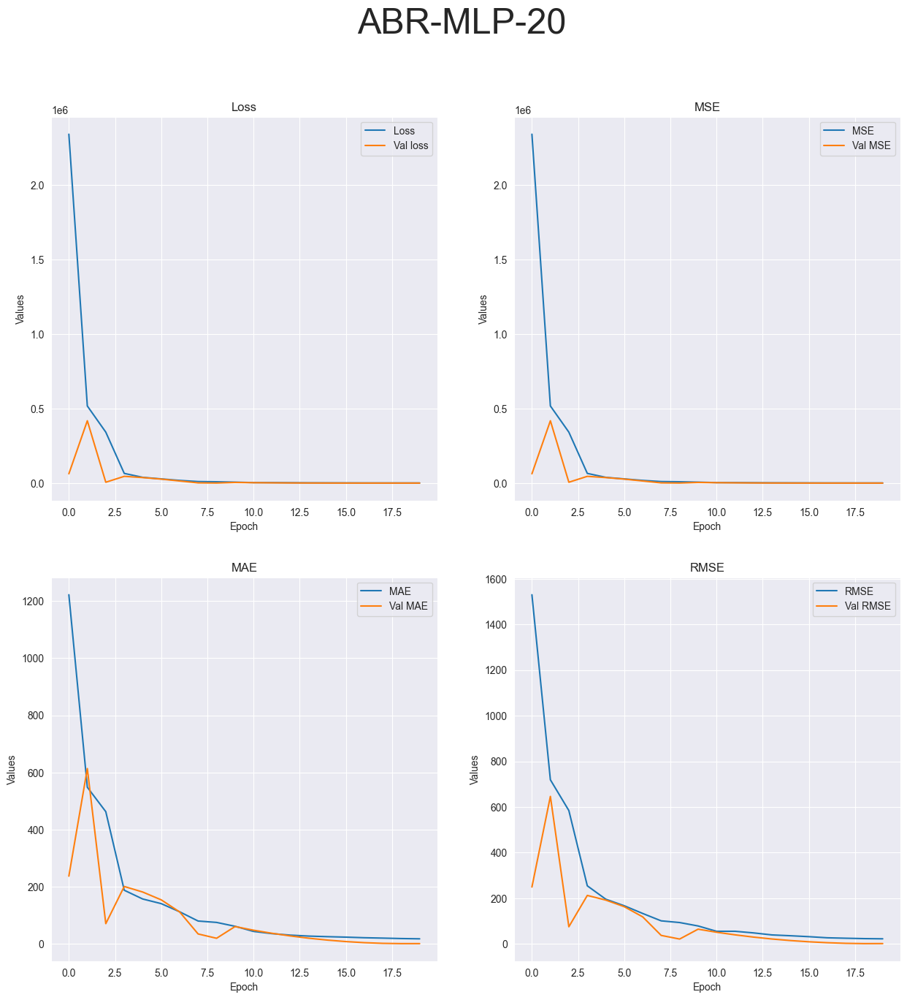

R-squared value: -7.5000


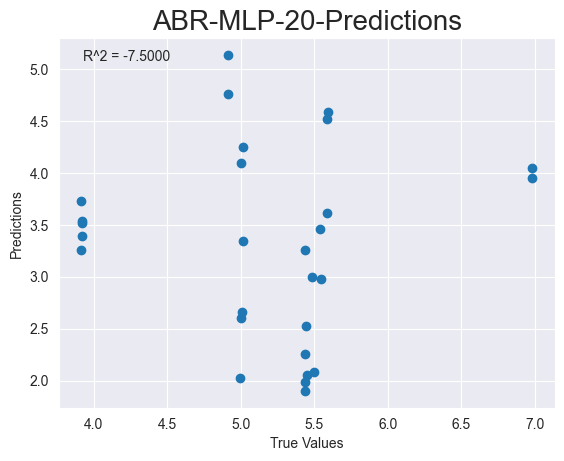

Model Name: FCNN
Epoch: 2
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 2
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-FCNN-2
Epoch 1/2


2023-05-02 15:48:35.950102: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 5997836.0000 - mse: 5997836.0000 - mae: 1803.0846 - root_mean_squared_error: 2449.0481

2023-05-02 15:48:37.529260: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 473ms/step - loss: 5997836.0000 - mse: 5997836.0000 - mae: 1803.0846 - root_mean_squared_error: 2449.0481 - val_loss: 155761.0938 - val_mse: 155761.0938 - val_mae: 381.3244 - val_root_mean_squared_error: 394.6658
Epoch 2/2
1/1 [==============================] - 0s 215ms/step - loss: 1864466.2500 - mse: 1864466.2500 - mae: 1307.6085 - root_mean_squared_error: 1365.4546
Test loss: [1864466.25, 1864466.25, 1307.6085205078125, 1365.45458984375]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


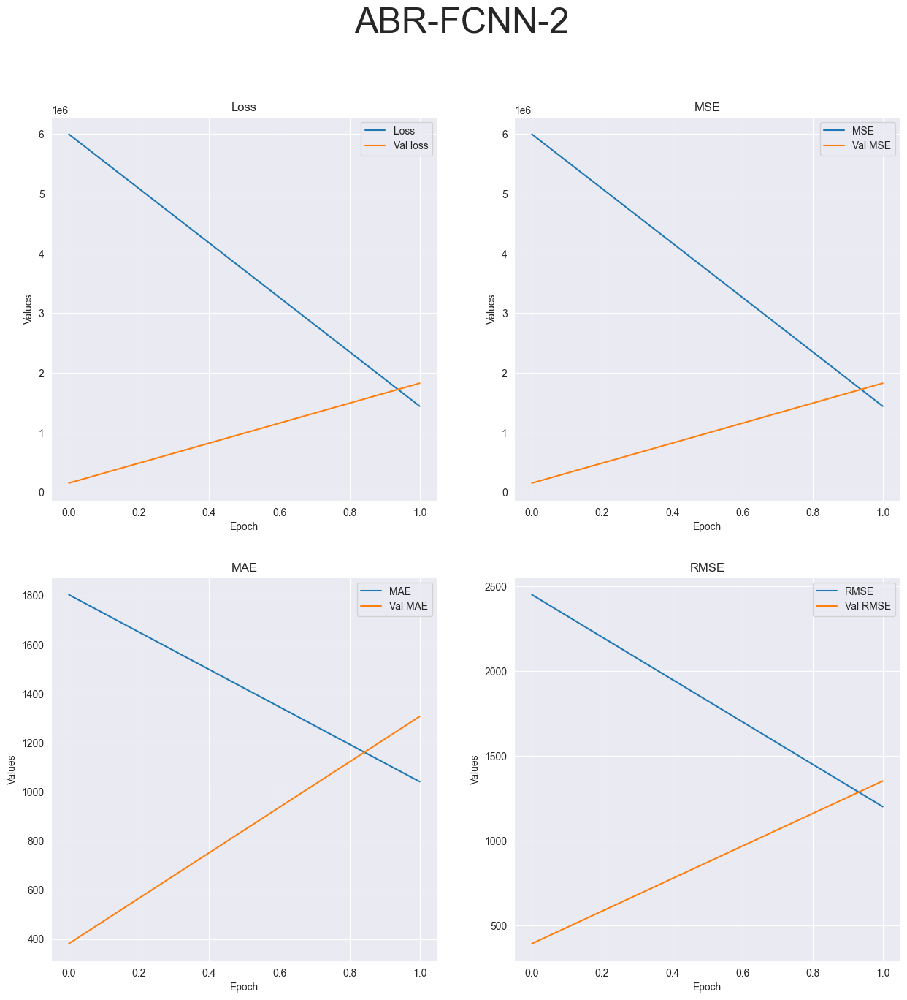

R-squared value: -4099469.1411


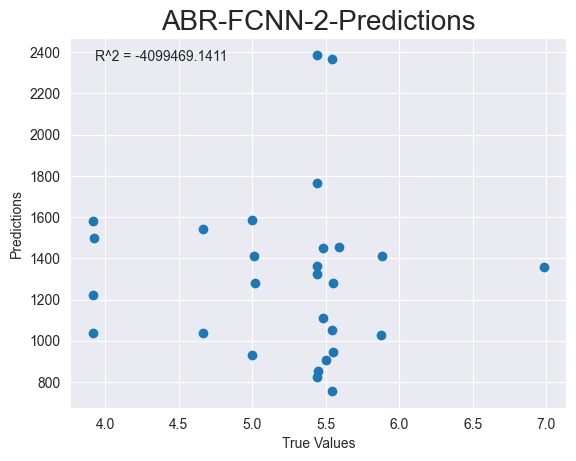

Epoch: 4
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 4
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-FCNN-4
Epoch 1/4


2023-05-02 15:48:41.510005: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 5001309.0000 - mse: 5001309.0000 - mae: 1703.9531 - root_mean_squared_error: 2236.3606

2023-05-02 15:48:43.003731: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 438ms/step - loss: 5001309.0000 - mse: 5001309.0000 - mae: 1703.9531 - root_mean_squared_error: 2236.3606 - val_loss: 183648.9062 - val_mse: 183648.9062 - val_mae: 414.6215 - val_root_mean_squared_error: 428.5428
Epoch 2/4
3/3 [==============================] - 0s 43ms/step - loss: 1539389.8750 - mse: 1539389.8750 - mae: 1091.0948 - root_mean_squared_error: 1240.7216 - val_loss: 1589628.7500 - val_mse: 1589628.7500 - val_mae: 1220.0304 - val_root_mean_squared_error: 1260.8048
Epoch 3/4
3/3 [==============================] - 0s 35ms/step - loss: 1204796.0000 - mse: 1204796.0000 - mae: 1013.4730 - root_mean_squared_error: 1097.6320 - val_loss: 50398.1836 - val_mse: 50398.1836 - val_mae: 216.5815 - val_root_mean_squared_error: 224.4954
Epoch 4/4
1/1 [==============================] - 0s 152ms/step - loss: 453581.1562 - mse: 453581.1562 - mae: 648.1102 - root_mean_squared_error: 673.4843
Test loss: [453581.15625, 453581.15625, 648.1102294921875, 67

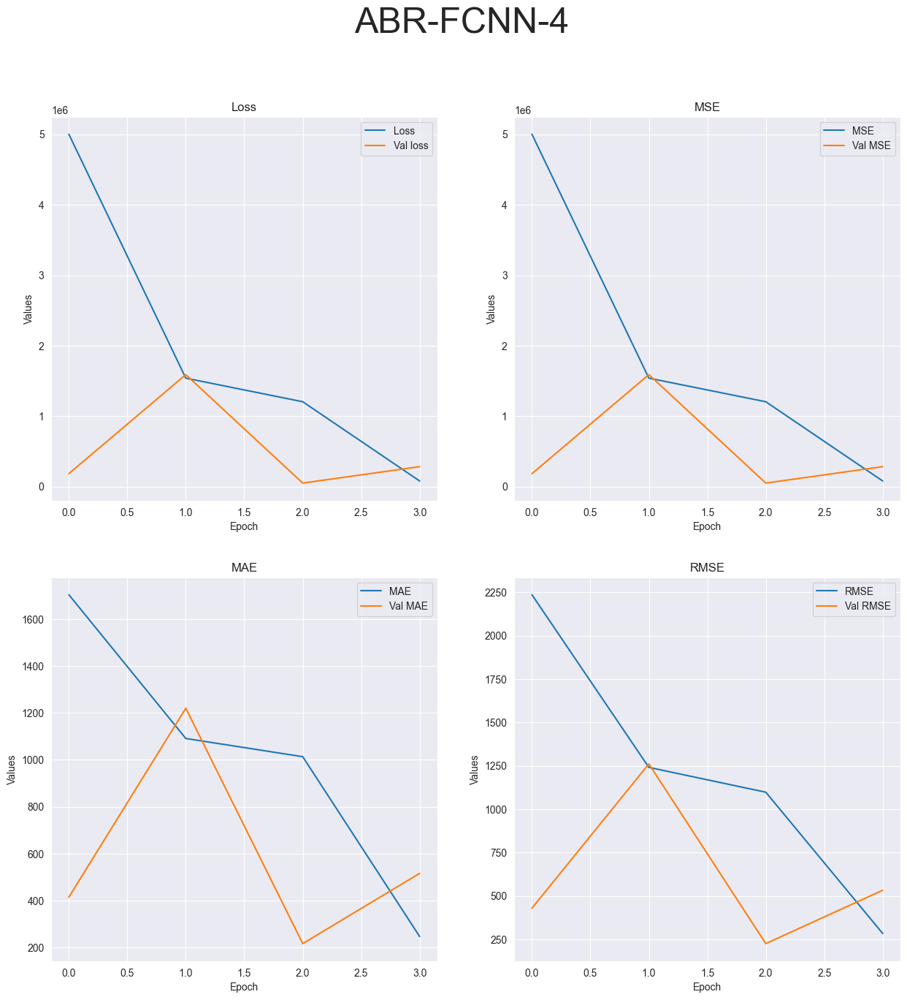

R-squared value: -861344.5152


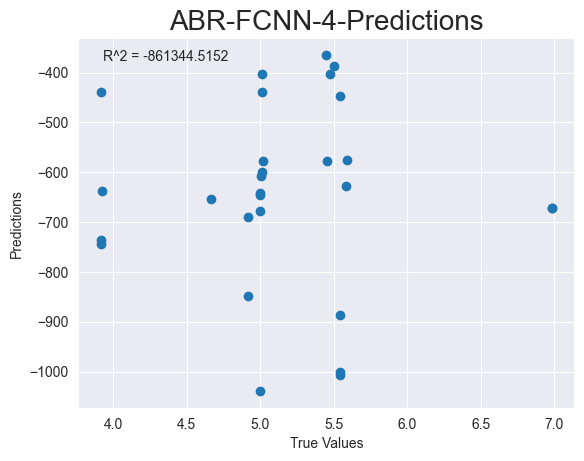

Epoch: 10
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 10
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-FCNN-10
Epoch 1/10


2023-05-02 15:48:44.903932: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6428153.0000 - mse: 6428153.0000 - mae: 1798.1002 - root_mean_squared_error: 2535.3801

2023-05-02 15:48:46.572392: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 414ms/step - loss: 6428153.0000 - mse: 6428153.0000 - mae: 1798.1002 - root_mean_squared_error: 2535.3801 - val_loss: 118501.0625 - val_mse: 118501.0625 - val_mae: 332.7162 - val_root_mean_squared_error: 344.2398
Epoch 2/10
3/3 [==============================] - 0s 103ms/step - loss: 1171433.1250 - mse: 1171433.0000 - mae: 930.7690 - root_mean_squared_error: 1082.3276 - val_loss: 2071892.0000 - val_mse: 2071892.0000 - val_mae: 1392.8019 - val_root_mean_squared_error: 1439.4069
Epoch 3/10
3/3 [==============================] - 0s 71ms/step - loss: 1144932.2500 - mse: 1144932.2500 - mae: 988.6082 - root_mean_squared_error: 1070.0150 - val_loss: 10598.3877 - val_mse: 10598.3877 - val_mae: 98.9642 - val_root_mean_squared_error: 102.9485
Epoch 4/10
3/3 [==============================] - 0s 51ms/step - loss: 149986.0000 - mse: 149986.0000 - mae: 320.8776 - root_mean_squared_error: 387.2803 - val_loss: 632202.8125 - val_mse: 632202.8125 - val_mae: 770

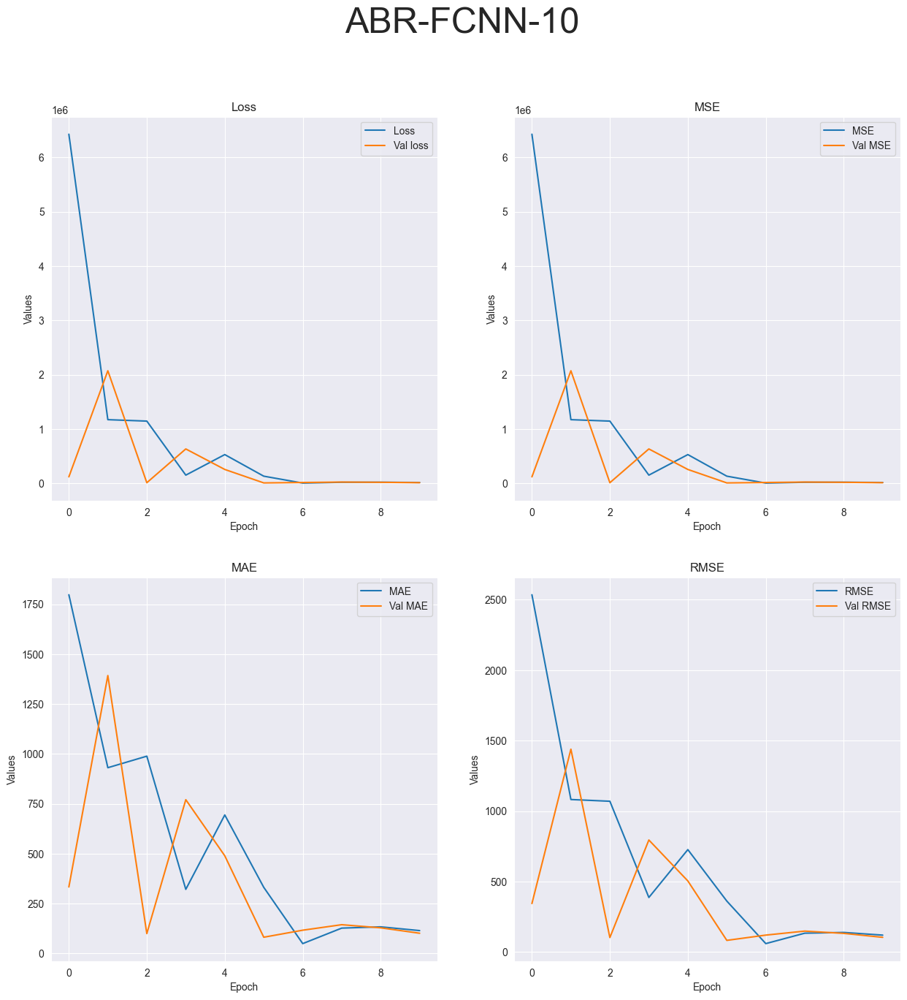

R-squared value: -26725.7504


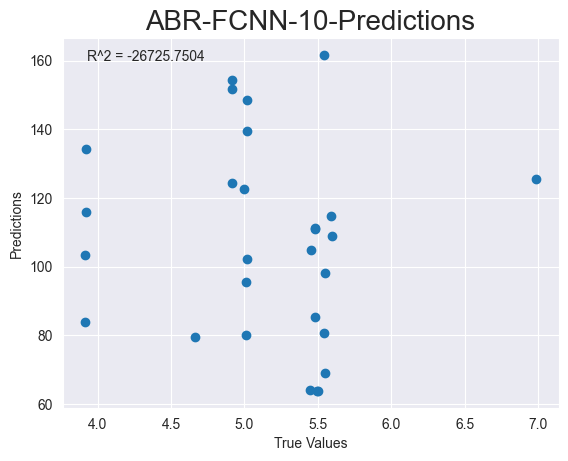

Epoch: 20
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 20
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-FCNN-20
Epoch 1/20


2023-05-02 15:48:49.050724: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 5064734.5000 - mse: 5064734.5000 - mae: 1701.8153 - root_mean_squared_error: 2250.4966

2023-05-02 15:48:50.195120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 340ms/step - loss: 5064734.5000 - mse: 5064734.5000 - mae: 1701.8153 - root_mean_squared_error: 2250.4966 - val_loss: 285961.6875 - val_mse: 285961.6875 - val_mae: 509.7776 - val_root_mean_squared_error: 534.7538
Epoch 2/20
3/3 [==============================] - 0s 107ms/step - loss: 1482659.3750 - mse: 1482659.3750 - mae: 1065.9561 - root_mean_squared_error: 1217.6450 - val_loss: 2627503.7500 - val_mse: 2627503.7500 - val_mae: 1546.3177 - val_root_mean_squared_error: 1620.9576
Epoch 3/20
3/3 [==============================] - 0s 125ms/step - loss: 1246639.2500 - mse: 1246639.2500 - mae: 1025.6013 - root_mean_squared_error: 1116.5300 - val_loss: 81801.8203 - val_mse: 81801.8203 - val_mae: 272.0678 - val_root_mean_squared_error: 286.0102
Epoch 4/20
3/3 [==============================] - 0s 23ms/step - loss: 79805.0703 - mse: 79805.0703 - mae: 243.7339 - root_mean_squared_error: 282.4979 - val_loss: 426237.6562 - val_mse: 426237.6562 - val_mae: 6

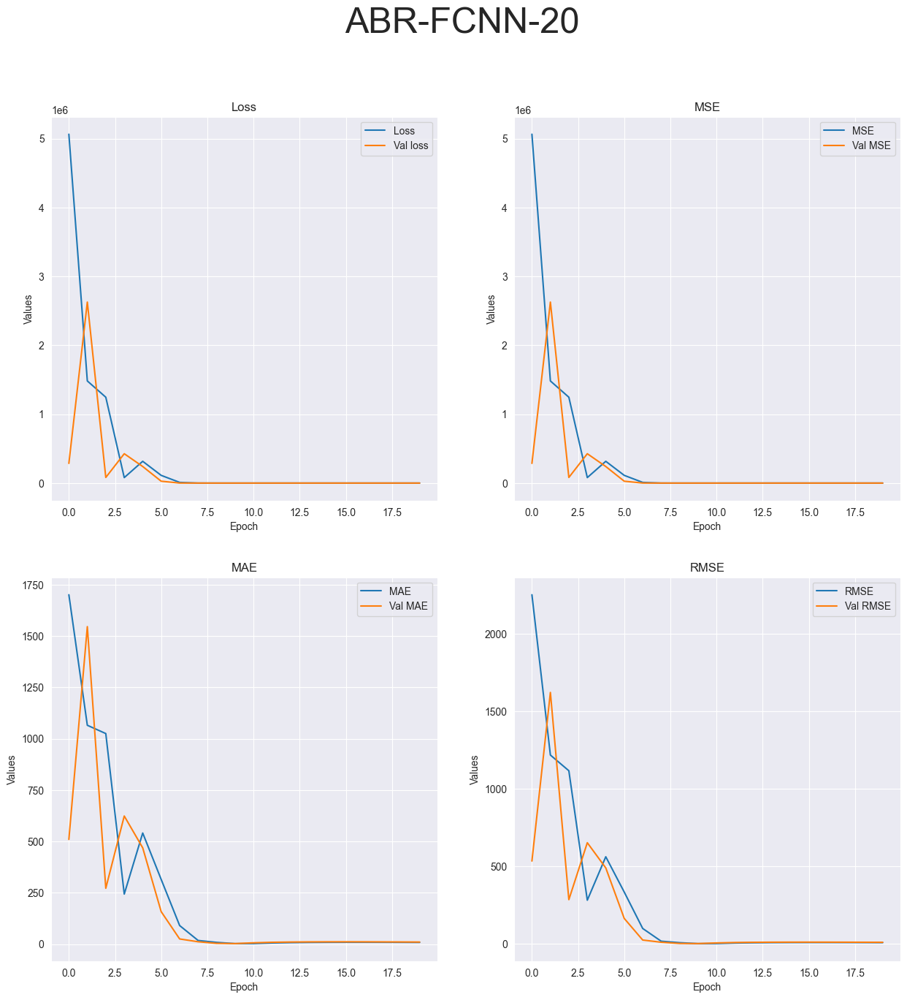

R-squared value: -273.2902


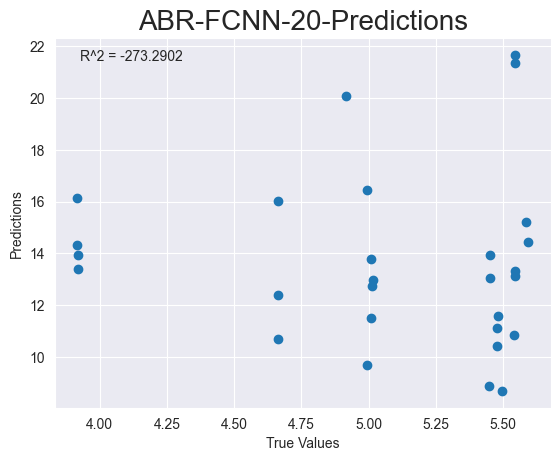

Model Name: DeepSVM
Epoch: 2
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 2
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-DeepSVM-2
Epoch 1/2


2023-05-02 15:48:53.511323: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 609238272.0000 - mse: 609238272.0000 - mae: 23488.9531 - root_mean_squared_error: 24682.7520

2023-05-02 15:48:54.690204: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 336ms/step - loss: 609238272.0000 - mse: 609238272.0000 - mae: 23488.9531 - root_mean_squared_error: 24682.7520 - val_loss: 300003040.0000 - val_mse: 300003040.0000 - val_mae: 16582.0781 - val_root_mean_squared_error: 17320.5957
Epoch 2/2
1/1 [==============================] - 0s 327ms/step - loss: 116786136.0000 - mse: 116786136.0000 - mae: 10405.9775 - root_mean_squared_error: 10806.7637
Test loss: [116786136.0, 116786136.0, 10405.9775390625, 10806.763671875]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


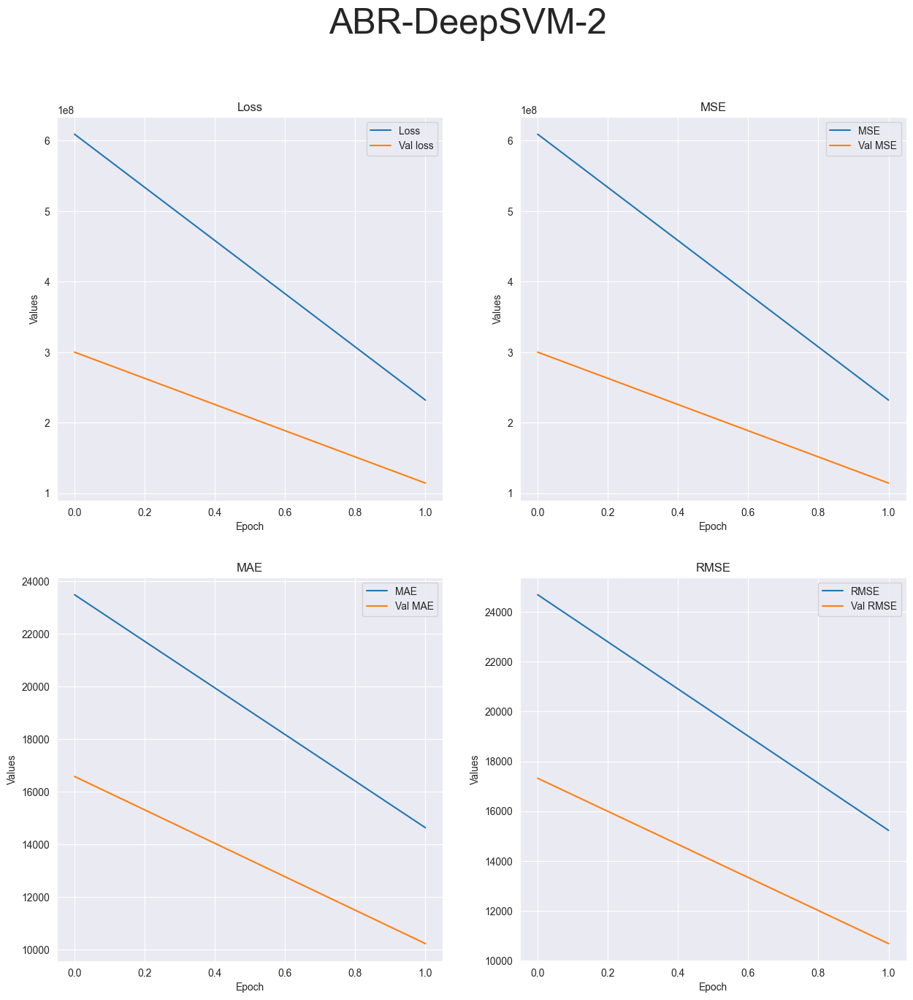

R-squared value: -278392007.1300


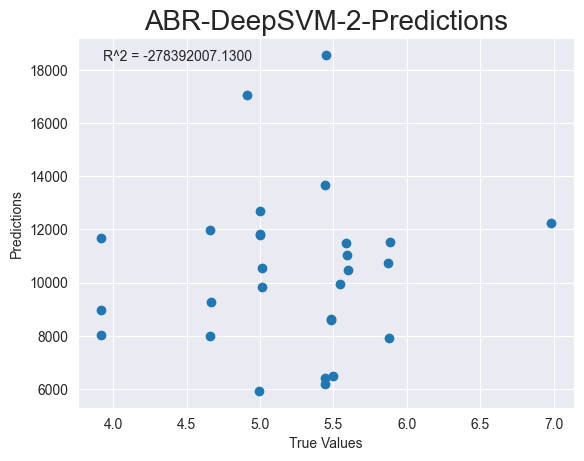

Epoch: 4
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 4
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-DeepSVM-4
Epoch 1/4


2023-05-02 15:48:56.855981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 561722496.0000 - mse: 561722496.0000 - mae: 22754.6738 - root_mean_squared_error: 23700.6855

2023-05-02 15:48:58.249866: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 479ms/step - loss: 561722496.0000 - mse: 561722496.0000 - mae: 22754.6738 - root_mean_squared_error: 23700.6855 - val_loss: 322530272.0000 - val_mse: 322530272.0000 - val_mae: 17382.4219 - val_root_mean_squared_error: 17959.1270
Epoch 2/4
3/3 [==============================] - 0s 164ms/step - loss: 227413648.0000 - mse: 227413648.0000 - mae: 14286.2021 - root_mean_squared_error: 15080.2402 - val_loss: 118836272.0000 - val_mse: 118836272.0000 - val_mae: 10548.7676 - val_root_mean_squared_error: 10901.2051
Epoch 3/4
3/3 [==============================] - 0s 84ms/step - loss: 84554440.0000 - mse: 84554440.0000 - mae: 8676.4385 - root_mean_squared_error: 9195.3486 - val_loss: 43049120.0000 - val_mse: 43049120.0000 - val_mae: 6347.2905 - val_root_mean_squared_error: 6561.1826
Epoch 4/4
1/1 [==============================] - 0s 80ms/step - loss: 15431831.0000 - mse: 15431831.0000 - mae: 3775.3364 - root_mean_squared_error: 3928.3369
Test loss: [15431

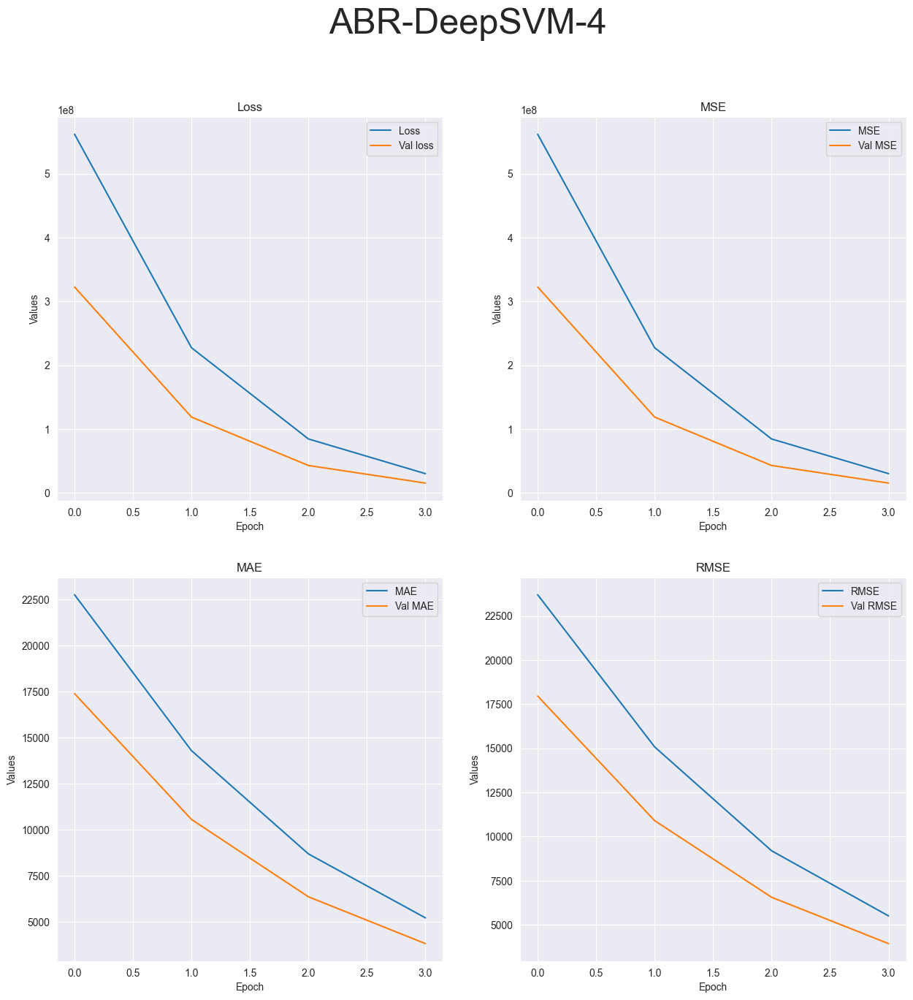

R-squared value: -32338346.4393


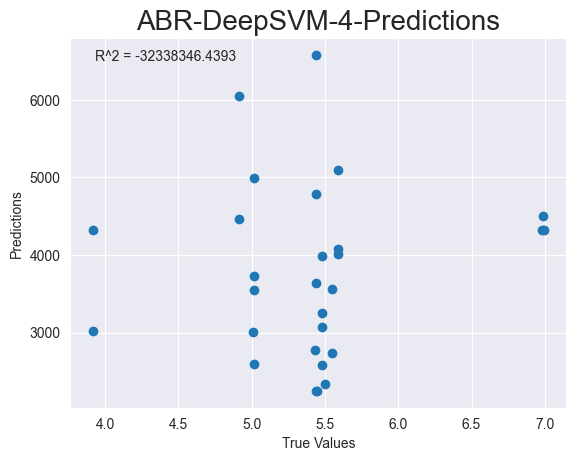

Epoch: 10
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 10
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-DeepSVM-10
Epoch 1/10


2023-05-02 15:49:00.692603: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 616148096.0000 - mse: 616148096.0000 - mae: 23539.0957 - root_mean_squared_error: 24822.3301

2023-05-02 15:49:01.921762: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 432ms/step - loss: 616148096.0000 - mse: 616148096.0000 - mae: 23539.0957 - root_mean_squared_error: 24822.3301 - val_loss: 324415392.0000 - val_mse: 324415392.0000 - val_mae: 17326.1309 - val_root_mean_squared_error: 18011.5352
Epoch 2/10
3/3 [==============================] - 0s 93ms/step - loss: 243666016.0000 - mse: 243666016.0000 - mae: 14824.0059 - root_mean_squared_error: 15609.8047 - val_loss: 123302888.0000 - val_mse: 123302888.0000 - val_mae: 10679.8535 - val_root_mean_squared_error: 11104.1836
Epoch 3/10
3/3 [==============================] - 0s 87ms/step - loss: 91579840.0000 - mse: 91579840.0000 - mae: 9072.2383 - root_mean_squared_error: 9569.7354 - val_loss: 45962584.0000 - val_mse: 45962584.0000 - val_mae: 6519.1509 - val_root_mean_squared_error: 6779.5713
Epoch 4/10
3/3 [==============================] - 0s 61ms/step - loss: 33975756.0000 - mse: 33975756.0000 - mae: 5531.0352 - root_mean_squared_error: 5828.8726 - val_loss: 168

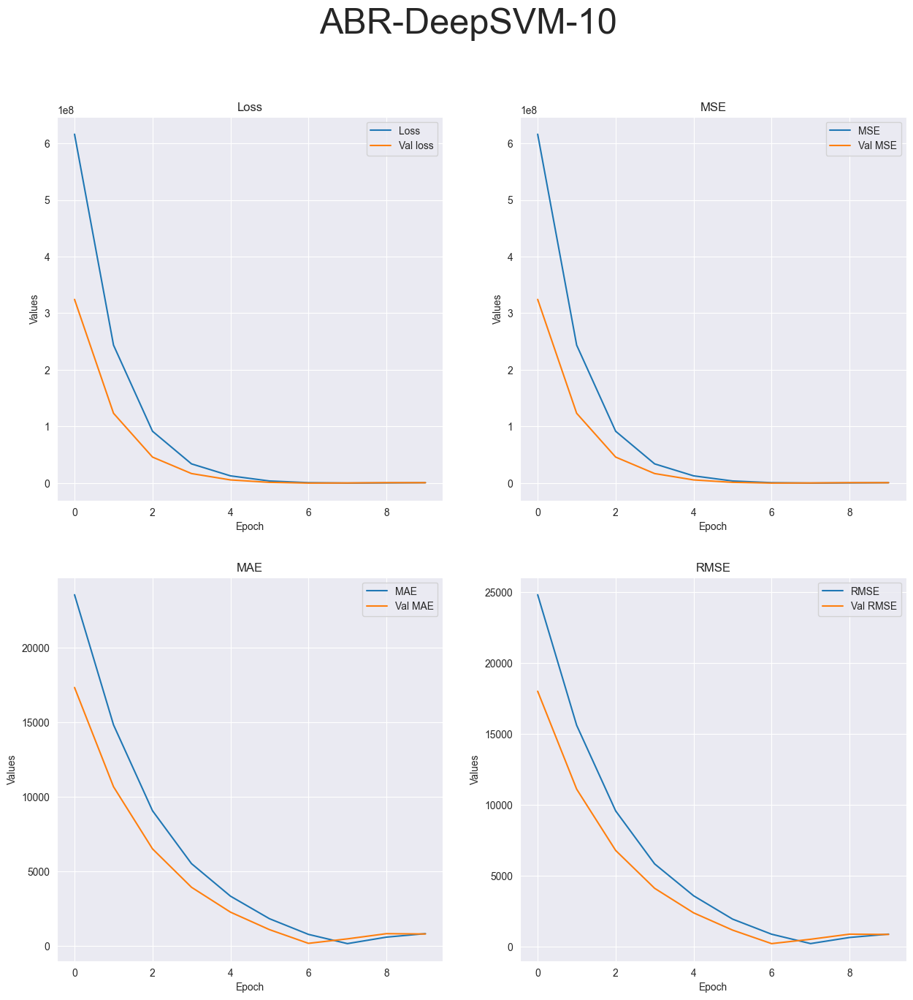

R-squared value: -2762203.8372


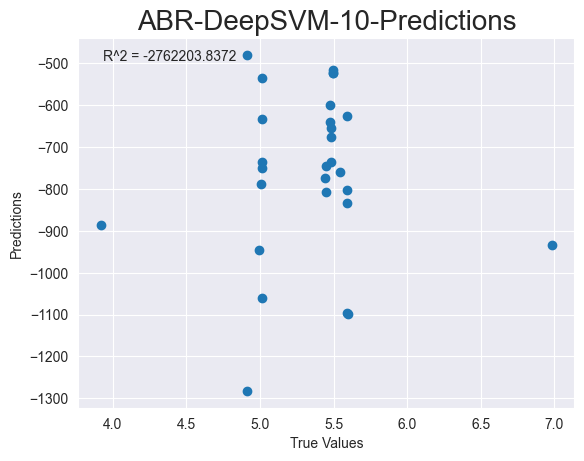

Epoch: 20
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 20
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-DeepSVM-20
Epoch 1/20


2023-05-02 15:49:06.832421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 629864960.0000 - mse: 629864960.0000 - mae: 23903.5527 - root_mean_squared_error: 25097.1113

2023-05-02 15:49:09.725550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 6s 806ms/step - loss: 629864960.0000 - mse: 629864960.0000 - mae: 23903.5527 - root_mean_squared_error: 25097.1113 - val_loss: 310617696.0000 - val_mse: 310617696.0000 - val_mae: 16746.3965 - val_root_mean_squared_error: 17624.3496
Epoch 2/20
3/3 [==============================] - 0s 128ms/step - loss: 250819024.0000 - mse: 250819024.0000 - mae: 15035.6836 - root_mean_squared_error: 15837.2666 - val_loss: 117069176.0000 - val_mse: 117069176.0000 - val_mae: 10277.3779 - val_root_mean_squared_error: 10819.8506
Epoch 3/20
3/3 [==============================] - 0s 67ms/step - loss: 90641408.0000 - mse: 90641408.0000 - mae: 9120.9326 - root_mean_squared_error: 9520.5781 - val_loss: 43730316.0000 - val_mse: 43730316.0000 - val_mae: 6278.7363 - val_root_mean_squared_error: 6612.8901
Epoch 4/20
3/3 [==============================] - 0s 20ms/step - loss: 34263200.0000 - mse: 34263200.0000 - mae: 5581.3042 - root_mean_squared_error: 5853.4775 - val_loss: 15

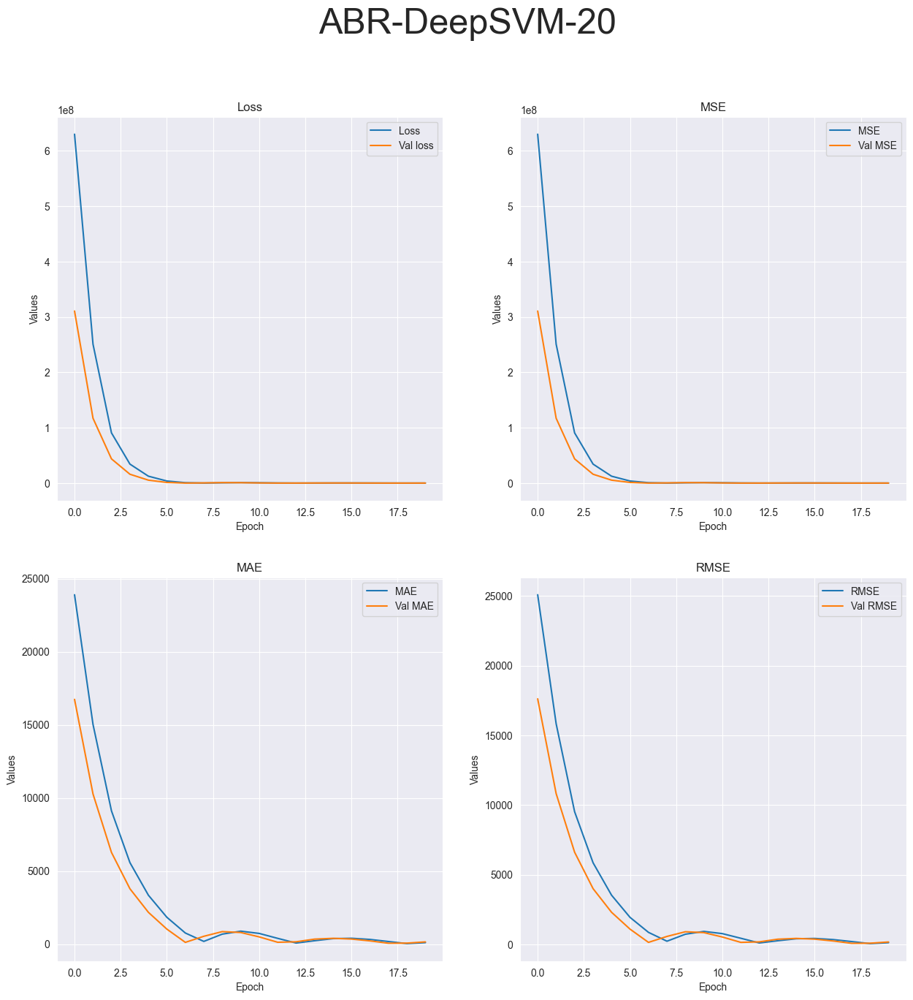

R-squared value: -49587.3591


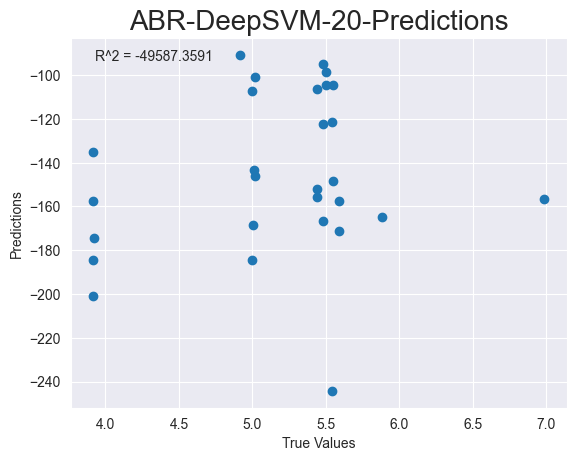

Test Name: MachineLearning
Dataset Name: CGBR
Model Name: Linear
Epoch: 1
Running experiment Raw, dataset CGBR, test MachineLearning, model Linear, epoch 1
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-Linear-1
Model Name: SVR
Epoch: 1
Running experiment Raw, dataset CGBR, test MachineLearning, model SVR, epoch 1
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
no ha tronado
CGBR-SVR
plotting linear


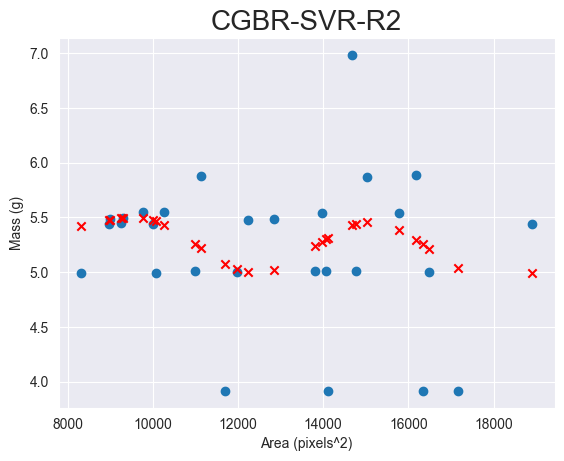

R-squared value: 0.0935


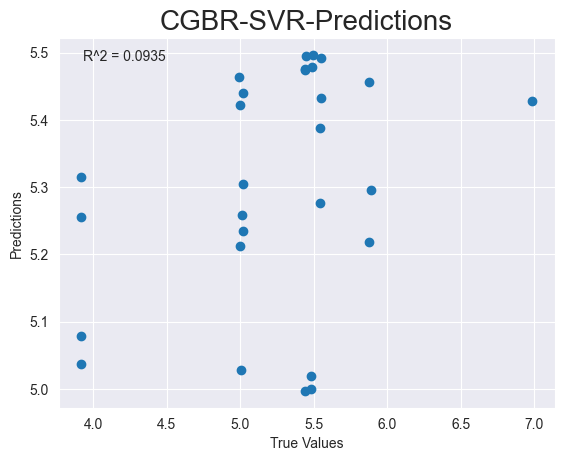

Test Name: Images
Dataset Name: CIBR
Model Name: CNN
Epoch: 2
Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 2
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
entrando
CIBR-CNN-2
Epoch 1/2


2023-05-02 15:49:15.791663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2196.4895 - mse: 2196.4895 - mae: 31.1022 - root_mean_squared_error: 46.8667

2023-05-02 15:49:22.325011: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 8s 1s/step - loss: 2196.4895 - mse: 2196.4895 - mae: 31.1022 - root_mean_squared_error: 46.8667 - val_loss: 31.4224 - val_mse: 31.4224 - val_mae: 5.5536 - val_root_mean_squared_error: 5.6056
Epoch 2/2
1/1 [==============================] - 1s 504ms/step - loss: 5.3919 - mse: 5.3919 - mae: 2.2608 - root_mean_squared_error: 2.3220
Test loss: [5.391890048980713, 5.391890048980713, 2.26076078414917, 2.3220443725585938]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


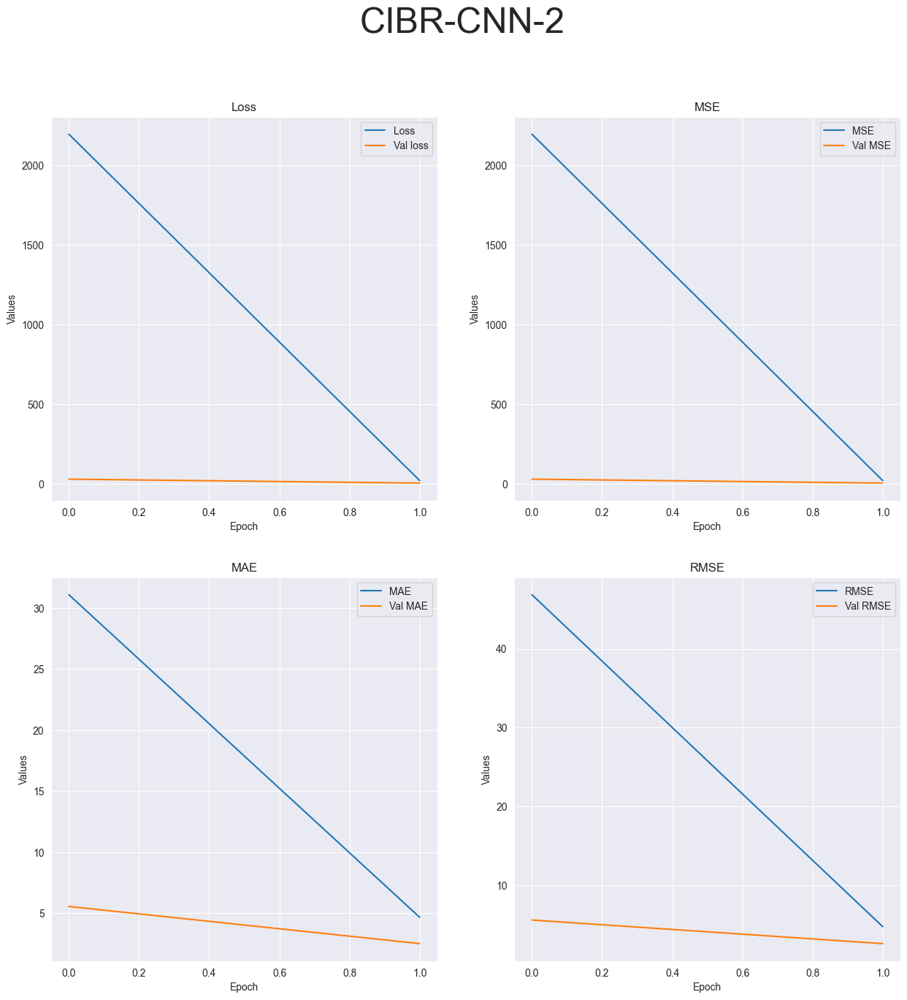

R-squared value: -21.1549


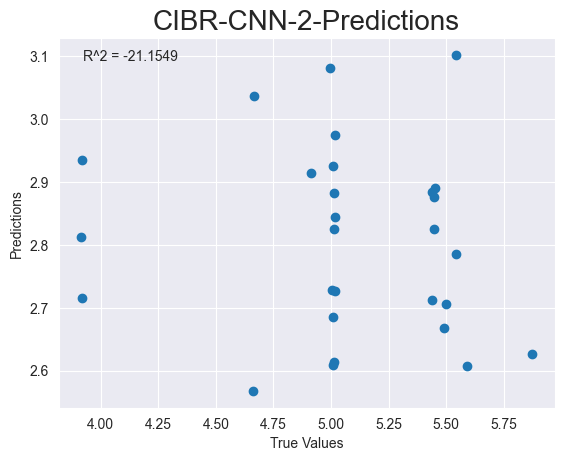

Epoch: 3
Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 3
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
entrando
CIBR-CNN-3
Epoch 1/3


2023-05-02 15:49:27.238240: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2862.5803 - mse: 2862.5803 - mae: 32.1730 - root_mean_squared_error: 53.5031

2023-05-02 15:49:30.233120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 2862.5803 - mse: 2862.5803 - mae: 32.1730 - root_mean_squared_error: 53.5031 - val_loss: 31.6331 - val_mse: 31.6331 - val_mae: 5.5605 - val_root_mean_squared_error: 5.6243
Epoch 2/3
3/3 [==============================] - 1s 434ms/step - loss: 25.3850 - mse: 25.3851 - mae: 4.9766 - root_mean_squared_error: 5.0384 - val_loss: 13.1854 - val_mse: 13.1854 - val_mae: 3.5350 - val_root_mean_squared_error: 3.6312
Epoch 3/3
1/1 [==============================] - 1s 698ms/step - loss: 6.6219 - mse: 6.6219 - mae: 2.4641 - root_mean_squared_error: 2.5733
Test loss: [6.621938228607178, 6.621938228607178, 2.464109182357788, 2.573312759399414]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWING True


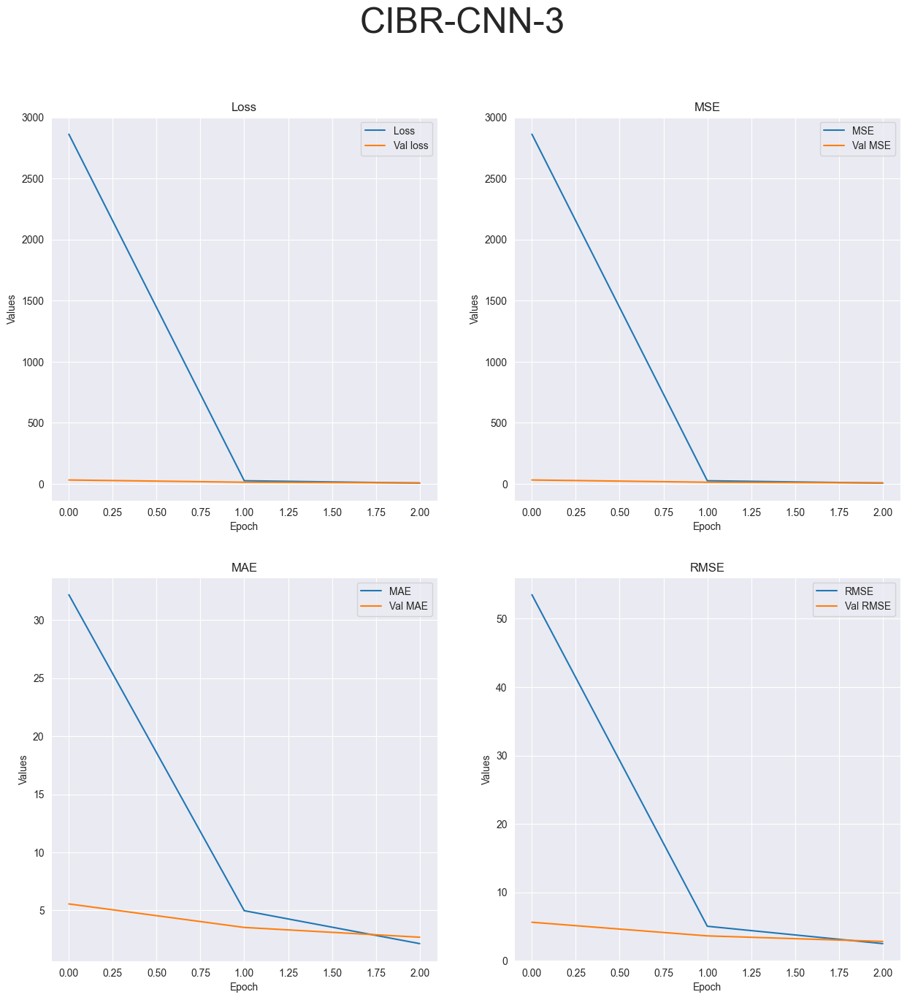

R-squared value: -10.7087


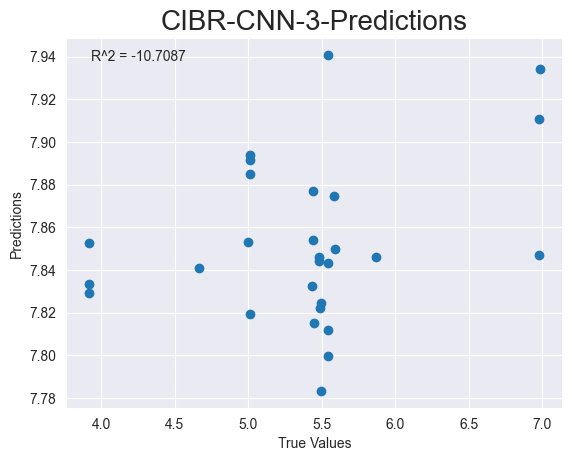

Epoch: 4
Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 4
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
entrando
CIBR-CNN-4
Epoch 1/4


2023-05-02 15:49:36.986034: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2231.6873 - mse: 2231.6873 - mae: 31.2740 - root_mean_squared_error: 47.2407

2023-05-02 15:49:41.897817: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 6s 2s/step - loss: 2231.6873 - mse: 2231.6873 - mae: 31.2740 - root_mean_squared_error: 47.2407 - val_loss: 27.3988 - val_mse: 27.3988 - val_mae: 5.1916 - val_root_mean_squared_error: 5.2344
Epoch 2/4
3/3 [==============================] - 1s 240ms/step - loss: 17.5998 - mse: 17.5998 - mae: 4.0000 - root_mean_squared_error: 4.1952 - val_loss: 24.4200 - val_mse: 24.4200 - val_mae: 4.1382 - val_root_mean_squared_error: 4.9417
Epoch 3/4
3/3 [==============================] - 1s 242ms/step - loss: 6.1743 - mse: 6.1743 - mae: 2.1998 - root_mean_squared_error: 2.4848 - val_loss: 2.0232 - val_mse: 2.0232 - val_mae: 1.3139 - val_root_mean_squared_error: 1.4224
Epoch 4/4
1/1 [==============================] - 0s 265ms/step - loss: 0.7310 - mse: 0.7310 - mae: 0.6510 - root_mean_squared_error: 0.8550
Test loss: [0.7309871315956116, 0.7309871315956116, 0.6509968042373657, 0.8549778461456299]
['loss', 'mse', 'mae', 'root_mean_squared_error']
IM SAVING
IM SHOWI

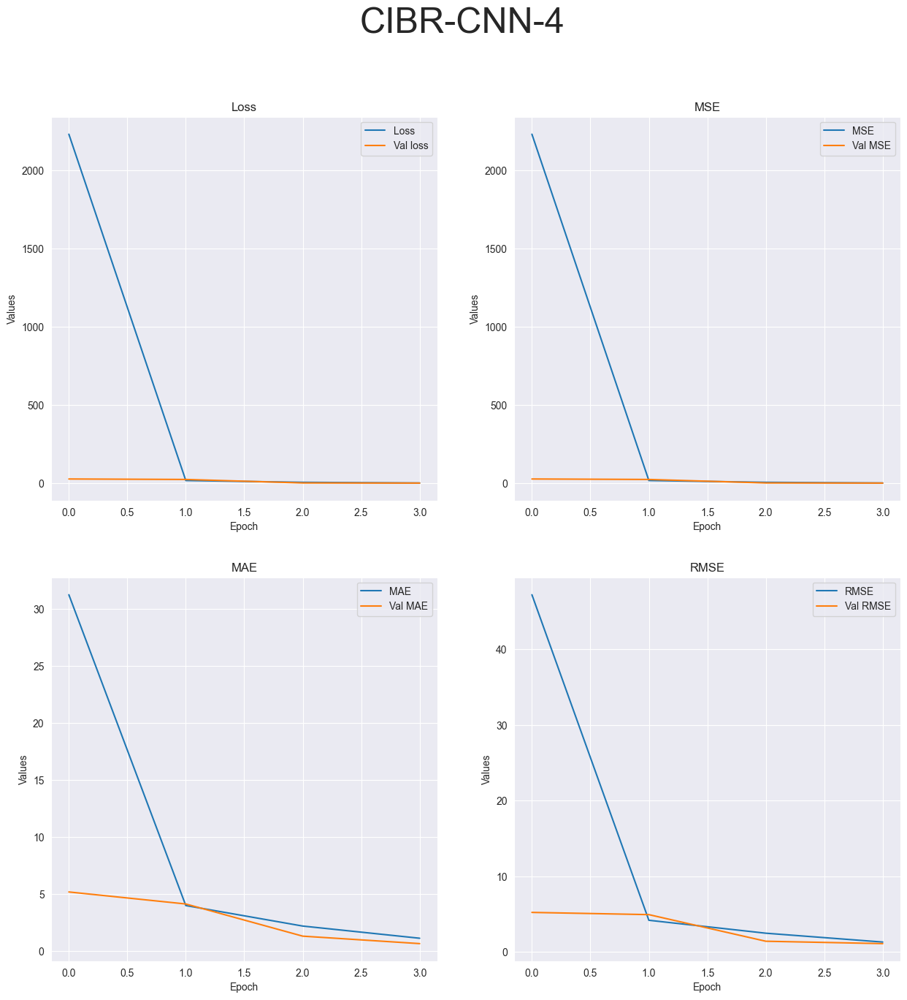

R-squared value: -0.5124


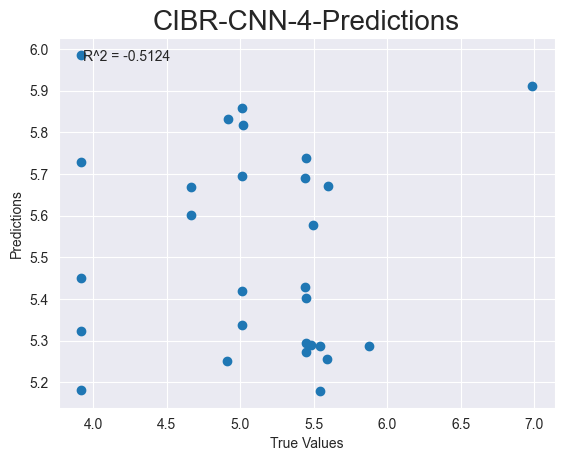

Epoch: 5
Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 5
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
entrando
CIBR-CNN-5
Epoch 1/5


2023-05-02 15:49:48.158920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2288.9050 - mse: 2288.9050 - mae: 31.7079 - root_mean_squared_error: 47.8425

2023-05-02 15:49:50.967977: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 2288.9050 - mse: 2288.9050 - mae: 31.7079 - root_mean_squared_error: 47.8425 - val_loss: 33.0219 - val_mse: 33.0219 - val_mae: 5.7186 - val_root_mean_squared_error: 5.7465
Epoch 2/5
3/3 [==============================] - 1s 266ms/step - loss: 28.8652 - mse: 28.8652 - mae: 5.3111 - root_mean_squared_error: 5.3726 - val_loss: 12.3179 - val_mse: 12.3179 - val_mae: 3.4634 - val_root_mean_squared_error: 3.5097
Epoch 3/5
3/3 [==============================] - 1s 161ms/step - loss: 9.1240 - mse: 9.1240 - mae: 2.5281 - root_mean_squared_error: 3.0206 - val_loss: 0.3898 - val_mse: 0.3898 - val_mae: 0.4964 - val_root_mean_squared_error: 0.6243
Epoch 4/5
3/3 [==============================] - 1s 395ms/step - loss: 12.9994 - mse: 12.9994 - mae: 2.2519 - root_mean_squared_error: 3.6055 - val_loss: 0.4292 - val_mse: 0.4292 - val_mae: 0.5354 - val_root_mean_squared_error: 0.6552
Epoch 5/5
1/1 [==============================] - 0s 347ms/step - 

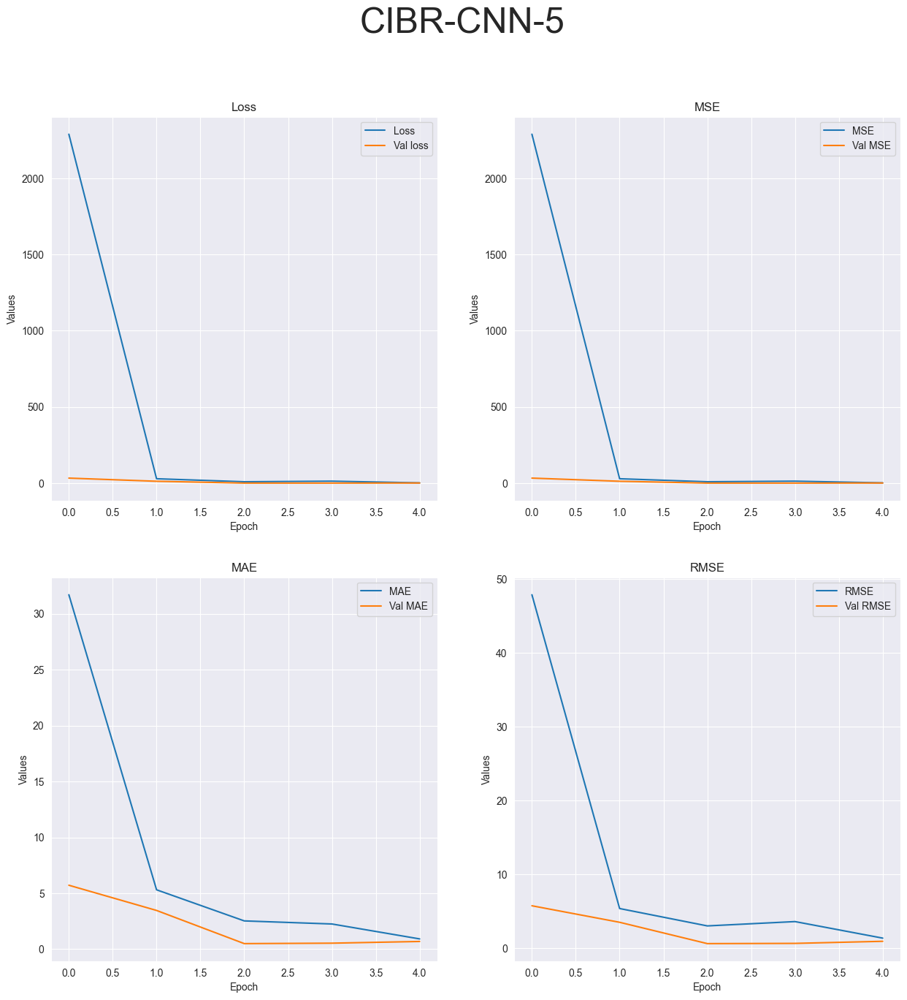

R-squared value: -1.0283


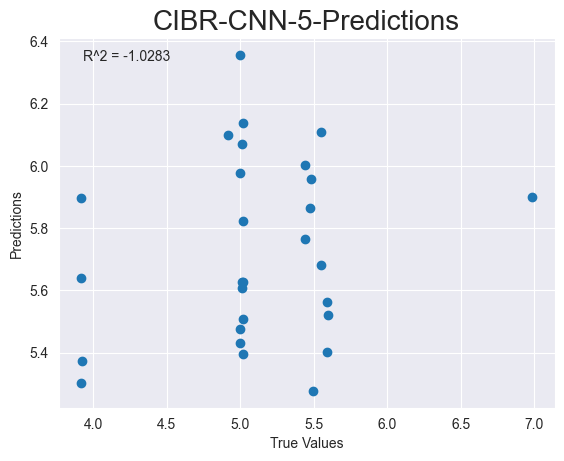

Model Name: RestNet
Epoch: 2
Running experiment Raw, dataset CIBR, test Images, model RestNet, epoch 2
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
CIBR-RestNet-2
Epoch: 3
Running experiment Raw, dataset CIBR, test Images, model RestNet, epoch 3
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
no ha tronado
CIBR-RestNet-3
Epoch: 4
Running experiment Raw, dataset CIBR, test Images, model RestNet, epoch 4
CIBR
EXTENTION .pkl
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66

ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type numpy.ndarray).

In [103]:
import os
import pandas as pd


results_dict = {}
# Define the function for running a single experiment


def run_experiment(experiment_name, dataset_name, data_ext, test_name, model_name, epoch):
    print(f"Running experiment {experiment_name}, dataset {dataset_name}, test {test_name}, model {model_name}, epoch {epoch}")

    print(dataset_name)
 
    print("EXTENTION",data_ext)
    dataframe = None
    if(data_ext == '.pkl'):
        dataframe = pd.read_pickle(dataset_name + data_ext)
    else:
        dataframe = pd.read_csv(dataset_name + data_ext)
    test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
    print("no ha tronado")
    test.buildData()
    test.buildModel()
    test.train(epoch)
    test.plot("folder", save = True, show = False)
    result = test.gather_data()
    return result


def run_all_experiments(experiments, save_path):
    for experiment_name, experiment in experiments.items():
        print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    #data_ext = test["Extention"]
                    #data_path = os.path.join('data', berry_type, dataset_name + data_ext)
                    print(f"Dataset Name: {dataset_name}")
                    for model_name in test['Models']:
                        print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            print(f"Epoch: {epoch}")
                            # Run the experiment
                            #folder = "./{berry_type}-{experiment_name}"
                            result = run_experiment(experiment_name, dataset_name, test['Extention'], test_name, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result

    # Save the results
    with open(save_path, 'w') as f:
        json.dump(results_dict, f)

run_all_experiments(Experiments, "./")



In [ ]:
import os
import glob

results_dict = {}


def run_all_experiments(experiments, save_path):
    for experiment_name, experiment in experiments.items():
        print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    print(f"Dataset Name: {dataset_name}")
                    data_path = os.path.join('data', berry_type, dataset_name + test['Extention'])
                    for model_name in test['Models']:
                        print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            print(f"Epoch: {epoch}")
                            # Run the experiment
                            result = run_experiment(data_path, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result

    # Save the results
    with open(save_path, 'w') as f:
        json.dump(results_dict, f)


In [ ]:

testcnn = AutomaticLearning(pd.read_pickle("croppedimagesRaspberriesRaw.pkl"), "CIRR-ResNet", "ResNet")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


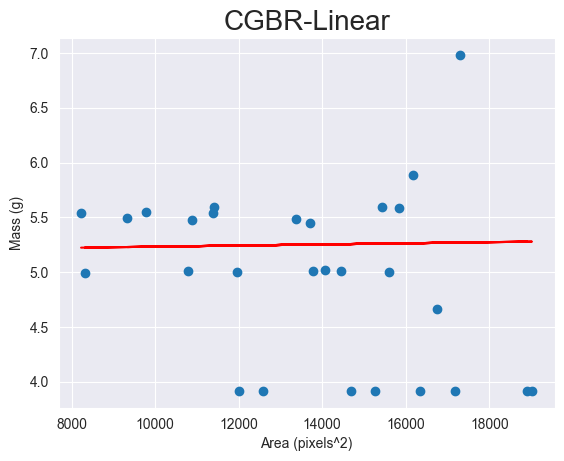

R-squared value: -0.1392


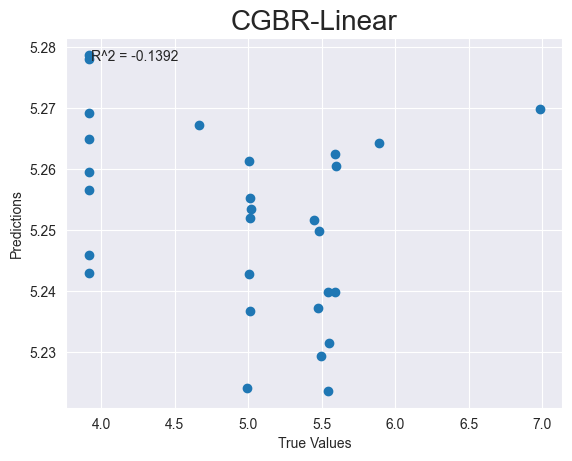

In [53]:
testcnn = AutomaticLearning(pd.read_csv("CGBR.csv"), "CGBR-Linear", "linear")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(400)
testcnn.plot()


plotting linear


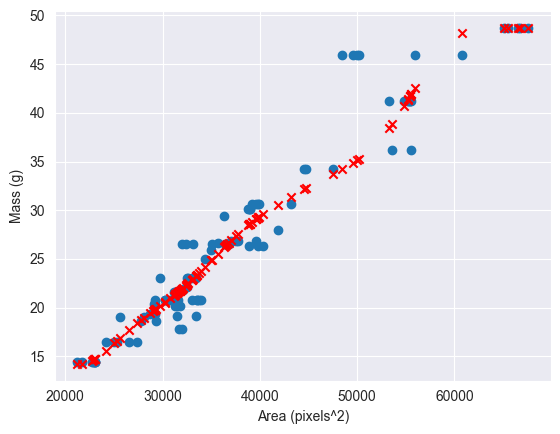

R-squared value: 0.9178


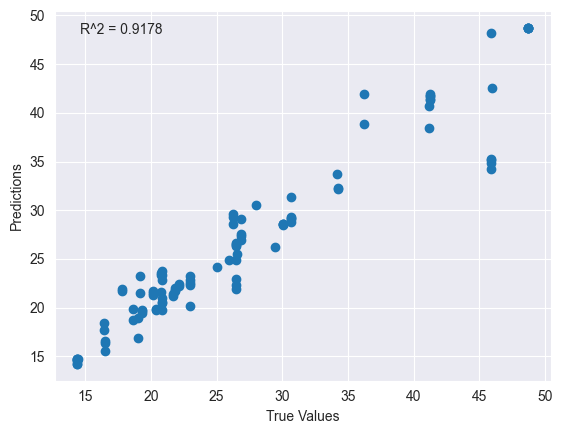

In [8]:

testsvr = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaSVR")
testsvr.buildData()
testsvr.buildModel("SVR")
testsvr.train(2200)
testsvr.plot()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                832       
                                                                 
 dense_9 (Dense)             (None, 32)                2080      
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,457
Trainable params: 3,457
Non-trainable params: 0
_________________________________________________________________
None


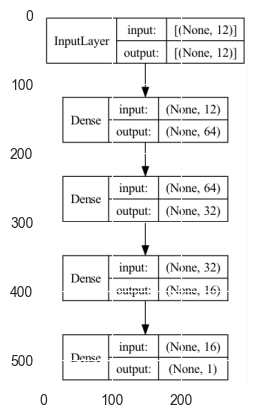

Epoch 1/10
 1/11 [=>............................] - ETA: 5s - loss: 377022.3750 - mse: 377022.3750 - mae: 587.8816 - root_mean_squared_error: 614.0215

2023-04-29 04:02:14.868265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 31ms/step - loss: 15895854.0000 - mse: 15895854.0000 - mae: 2913.8459 - root_mean_squared_error: 3986.9604 - val_loss: 101860.9062 - val_mse: 101860.9062 - val_mae: 307.9383 - val_root_mean_squared_error: 319.1566
Epoch 2/10
 8/11 [====================>.........] - ETA: 0s - loss: 976481.5000 - mse: 976481.5000 - mae: 914.2033 - root_mean_squared_error: 988.1708

2023-04-29 04:02:15.240663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 0s 11ms/step - loss: 946390.3125 - mse: 946390.3125 - mae: 904.1191 - root_mean_squared_error: 972.8259 - val_loss: 377234.4062 - val_mse: 377234.4062 - val_mae: 592.2183 - val_root_mean_squared_error: 614.1941
Epoch 3/10
11/11 [==============================] - 0s 11ms/step - loss: 122046.0703 - mse: 122046.0703 - mae: 296.6097 - root_mean_squared_error: 349.3509 - val_loss: 3624.8376 - val_mse: 3624.8376 - val_mae: 57.6960 - val_root_mean_squared_error: 60.2066
Epoch 4/10
11/11 [==============================] - 0s 11ms/step - loss: 737.0602 - mse: 737.0602 - mae: 19.2511 - root_mean_squared_error: 27.1489 - val_loss: 249.6129 - val_mse: 249.6129 - val_mae: 15.3938 - val_root_mean_squared_error: 15.7991
Epoch 5/10
11/11 [==============================] - 0s 10ms/step - loss: 384.6152 - mse: 384.6152 - mae: 18.9756 - root_mean_squared_error: 19.6116 - val_loss: 388.4864 - val_mse: 388.4864 - val_mae: 19.1997 - val_root_mean_squared_error: 19.71

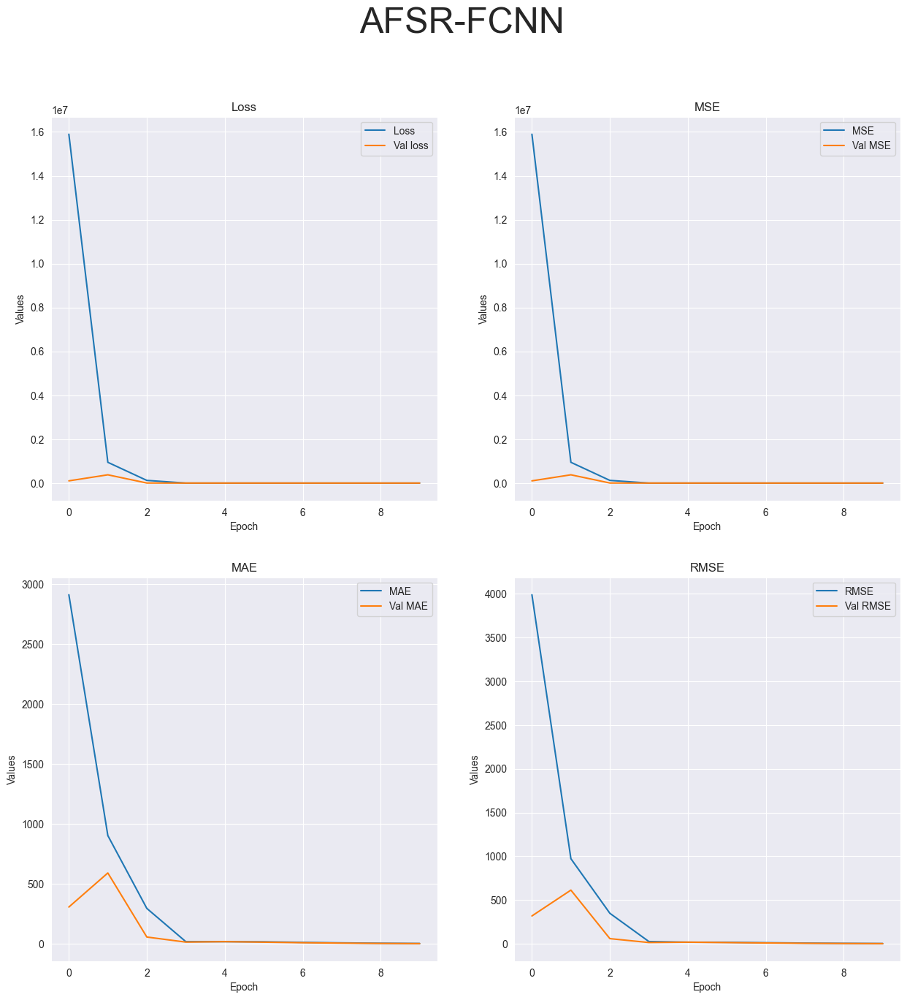

R-squared value: 0.8525


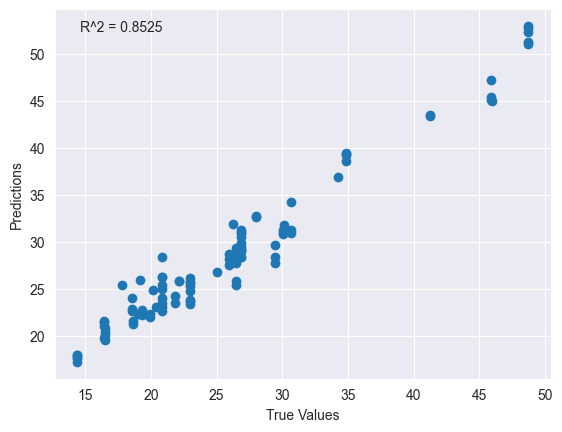

In [13]:

muchas = AutomaticLearning(pd.read_csv("allfeaturesStrawberriesRaw.csv"), "AFSR-FCNN")
muchas.buildData()
muchas.buildModel("FCNN")
muchas.train(10)
muchas.plot()

plotting linear


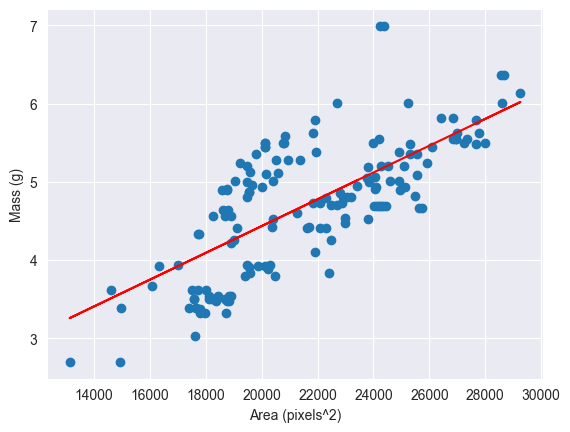

R-squared value: 0.5422


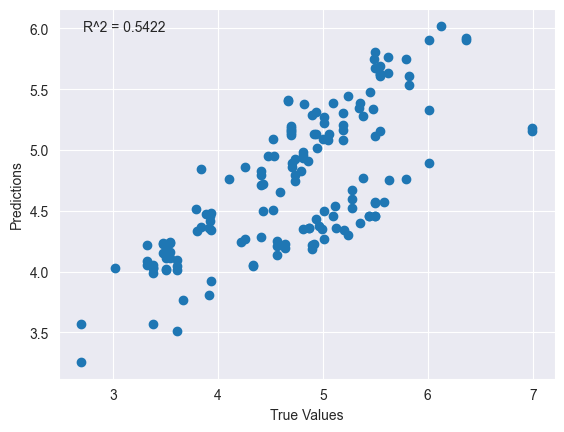

plotting linear


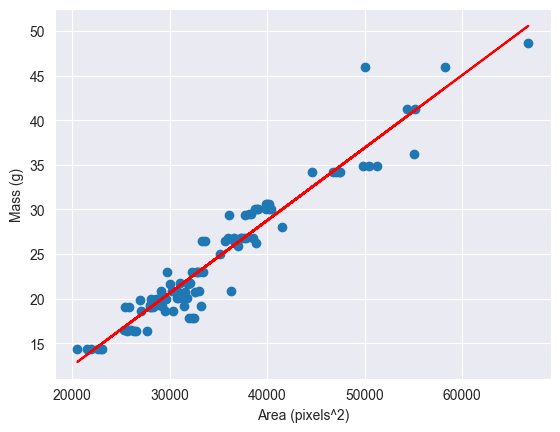

R-squared value: 0.9251


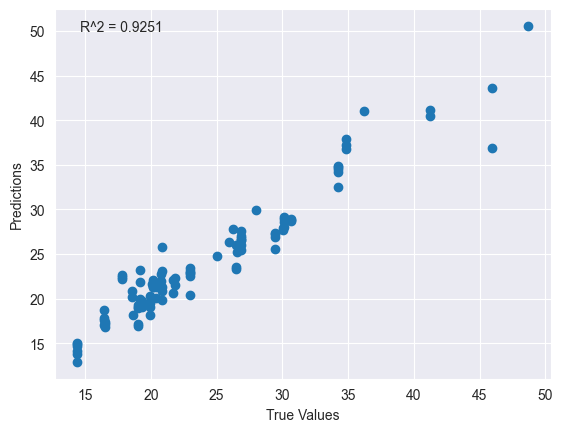

plotting linear


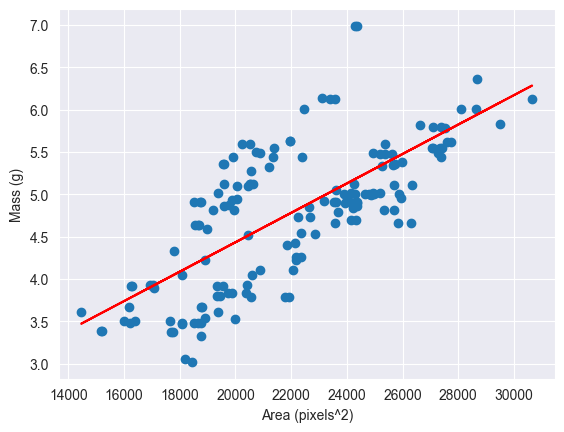

R-squared value: 0.5080


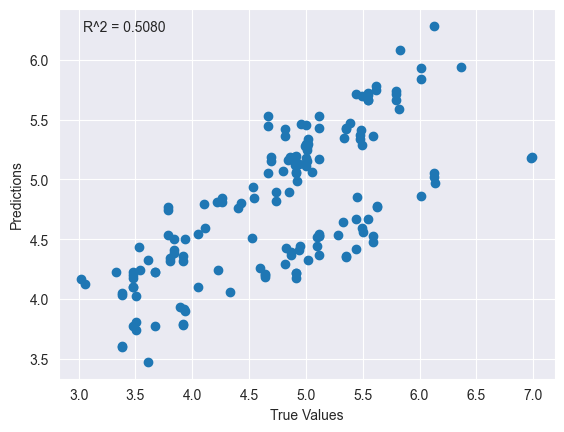

plotting linear


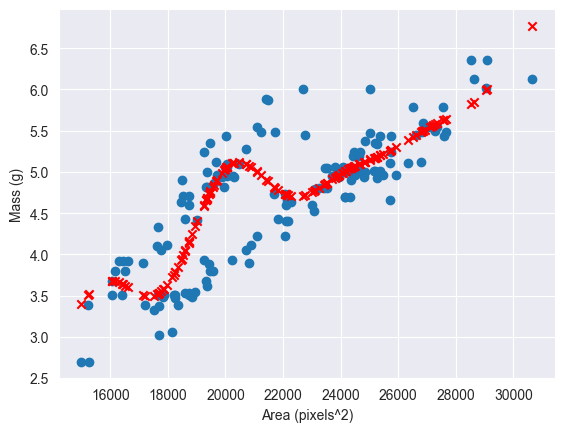

R-squared value: 0.6757


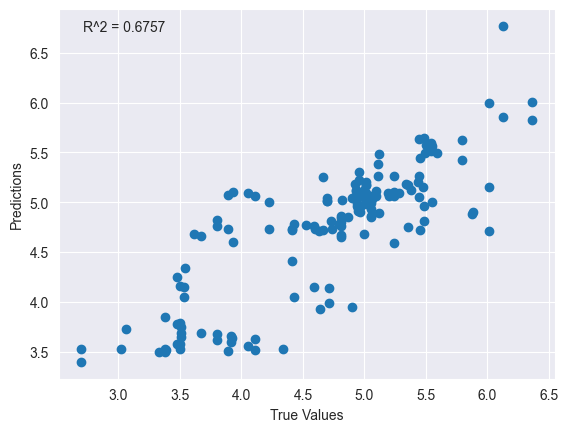

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_369 (Dense)           (None, 64)                192       
                                                                 
 dropout_112 (Dropout)       (None, 64)                0         
                                                                 
 dense_370 (Dense)           (None, 32)                2080      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:10.454677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664

2023-04-29 03:39:11.773911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 64ms/step - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664 - val_loss: 57952.4336 - val_mse: 57952.4336 - val_mae: 237.5029 - val_root_mean_squared_error: 240.7331
Epoch 2/5
16/16 [==============================] - 0s 16ms/step - loss: 50696.3398 - mse: 50696.3398 - mae: 166.3529 - root_mean_squared_error: 225.1585 - val_loss: 920.8993 - val_mse: 920.8993 - val_mae: 29.9157 - val_root_mean_squared_error: 30.3463
Epoch 3/5
16/16 [==============================] - 0s 18ms/step - loss: 4578.2466 - mse: 4578.2466 - mae: 48.7814 - root_mean_squared_error: 67.6627 - val_loss: 107.3159 - val_mse: 107.3159 - val_mae: 10.2257 - val_root_mean_squared_error: 10.3593
Epoch 4/5
16/16 [==============================] - 0s 14ms/step - loss: 2107.4727 - mse: 2107.4727 - mae: 35.8980 - root_mean_squared_error: 45.9072 - val_loss: 133.2910 - val_mse: 133.2910 - val_mae: 11.3972 - val_root_mean_squared_error: 11.5452

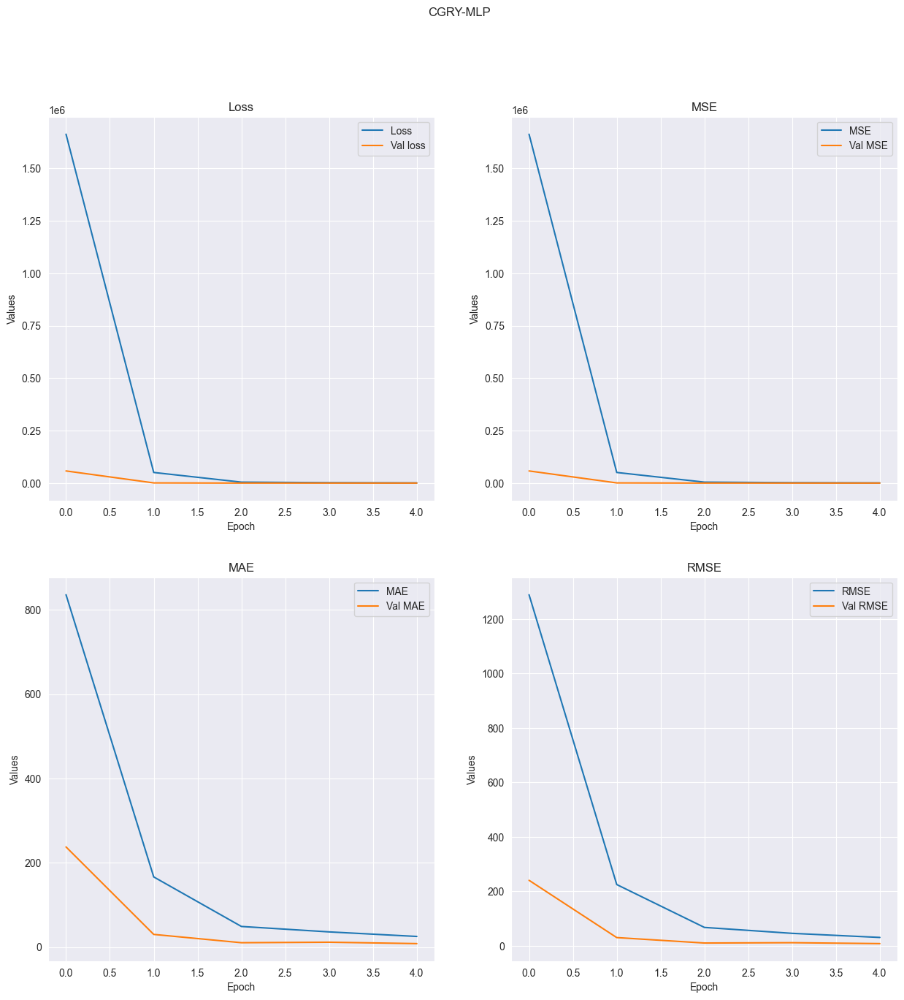

R-squared value: -122.9209


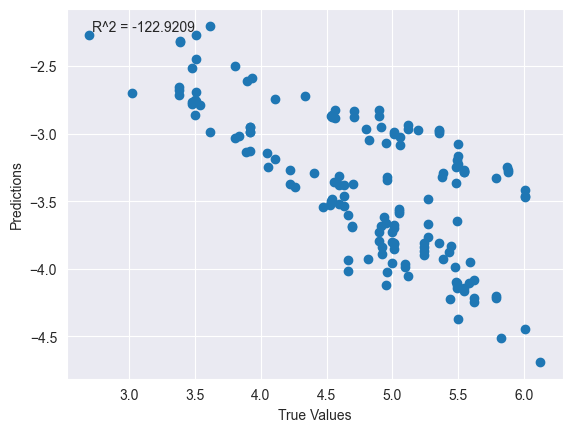

Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_372 (Dense)           (None, 64)                192       
                                                                 
 dropout_114 (Dropout)       (None, 64)                0         
                                                                 
 dense_373 (Dense)           (None, 32)                2080      
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_374 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:20.399078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 

2023-04-29 03:39:21.810632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 91ms/step - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 - val_loss: 166090.0469 - val_mse: 166090.0469 - val_mae: 389.9341 - val_root_mean_squared_error: 407.5415
Epoch 2/5
11/11 [==============================] - 0s 24ms/step - loss: 511054.8125 - mse: 511054.8125 - mae: 509.3962 - root_mean_squared_error: 714.8810 - val_loss: 57024.1289 - val_mse: 57024.1289 - val_mae: 228.5861 - val_root_mean_squared_error: 238.7973
Epoch 3/5
11/11 [==============================] - 0s 17ms/step - loss: 108829.0156 - mse: 108829.0156 - mae: 242.5318 - root_mean_squared_error: 329.8924 - val_loss: 6094.3706 - val_mse: 6094.3701 - val_mae: 74.8816 - val_root_mean_squared_error: 78.0664
Epoch 4/5
11/11 [==============================] - 0s 18ms/step - loss: 35150.0625 - mse: 35150.0625 - mae: 128.3465 - root_mean_squared_error: 187.4835 - val_loss: 115.6760 - val_mse: 115.6760 - val_mae: 10.3060 - val_root_mean

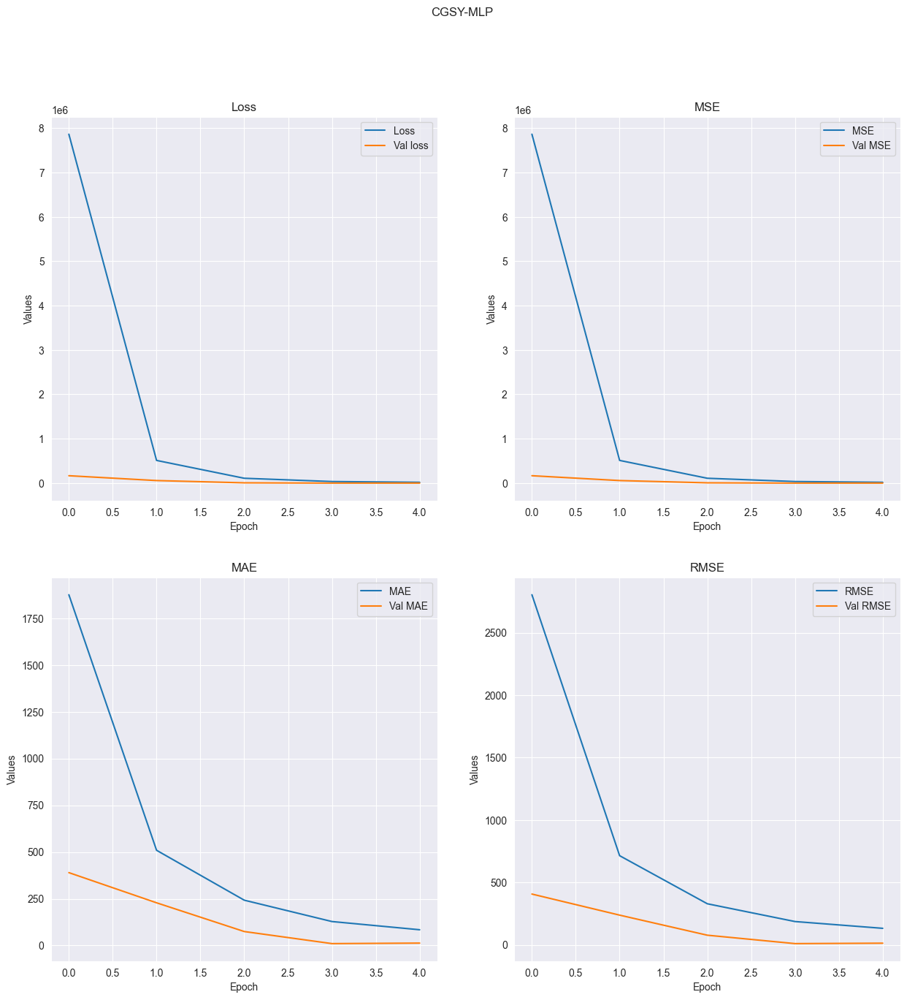

R-squared value: -0.7915


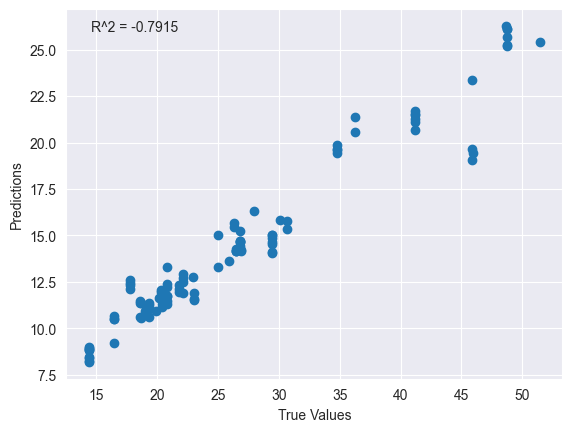

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_375 (Dense)           (None, 64)                192       
                                                                 
 dense_376 (Dense)           (None, 32)                2080      
                                                                 
 dense_377 (Dense)           (None, 16)                528       
                                                                 
 dense_378 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:23.873785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986

2023-04-29 03:39:24.804380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 56ms/step - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986 - val_loss: 555599.4375 - val_mse: 555599.4375 - val_mae: 735.9260 - val_root_mean_squared_error: 745.3854
Epoch 2/5
16/16 [==============================] - 0s 13ms/step - loss: 168030.3438 - mse: 168030.3438 - mae: 328.9428 - root_mean_squared_error: 409.9150 - val_loss: 46.6384 - val_mse: 46.6384 - val_mae: 6.6897 - val_root_mean_squared_error: 6.8292
Epoch 3/5
16/16 [==============================] - 0s 15ms/step - loss: 4408.6826 - mse: 4408.6826 - mae: 61.4353 - root_mean_squared_error: 66.3979 - val_loss: 6530.2080 - val_mse: 6530.2080 - val_mae: 79.7497 - val_root_mean_squared_error: 80.8097
Epoch 4/5
16/16 [==============================] - 0s 10ms/step - loss: 4162.0752 - mse: 4162.0752 - mae: 62.9008 - root_mean_squared_error: 64.5141 - val_loss: 1974.3805 - val_mse: 1974.3805 - val_mae: 43.8345 - val_root_mean_squared_error: 44

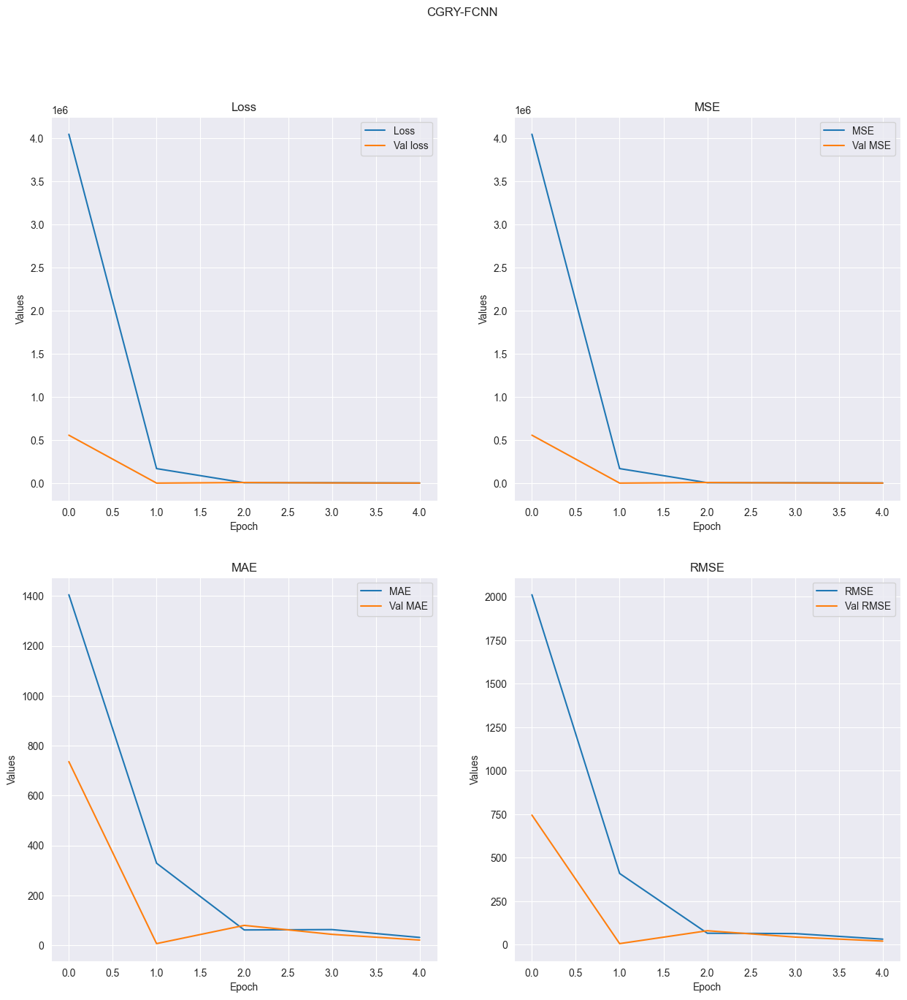

R-squared value: -738.7749


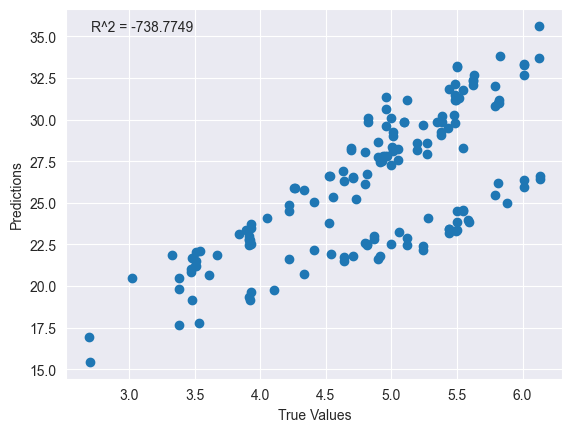

Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_379 (Dense)           (None, 64)                192       
                                                                 
 dense_380 (Dense)           (None, 32)                2080      
                                                                 
 dense_381 (Dense)           (None, 16)                528       
                                                                 
 dense_382 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:26.990116: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110

2023-04-29 03:39:28.050524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110 - val_loss: 729364.1250 - val_mse: 729364.1250 - val_mae: 819.8881 - val_root_mean_squared_error: 854.0282
Epoch 2/5
11/11 [==============================] - 0s 25ms/step - loss: 168845.9531 - mse: 168845.9531 - mae: 339.4226 - root_mean_squared_error: 410.9087 - val_loss: 94275.0938 - val_mse: 94275.0938 - val_mae: 294.4102 - val_root_mean_squared_error: 307.0425
Epoch 3/5
11/11 [==============================] - 0s 15ms/step - loss: 64092.6992 - mse: 64092.6992 - mae: 240.5644 - root_mean_squared_error: 253.1654 - val_loss: 26051.3789 - val_mse: 26051.3789 - val_mae: 154.6329 - val_root_mean_squared_error: 161.4044
Epoch 4/5
11/11 [==============================] - 0s 13ms/step - loss: 11585.3242 - mse: 11585.3242 - mae: 96.6171 - root_mean_squared_error: 107.6351 - val_loss: 786.8887 - val_mse: 786.8887 - val_mae: 26.5961 - val_root_m

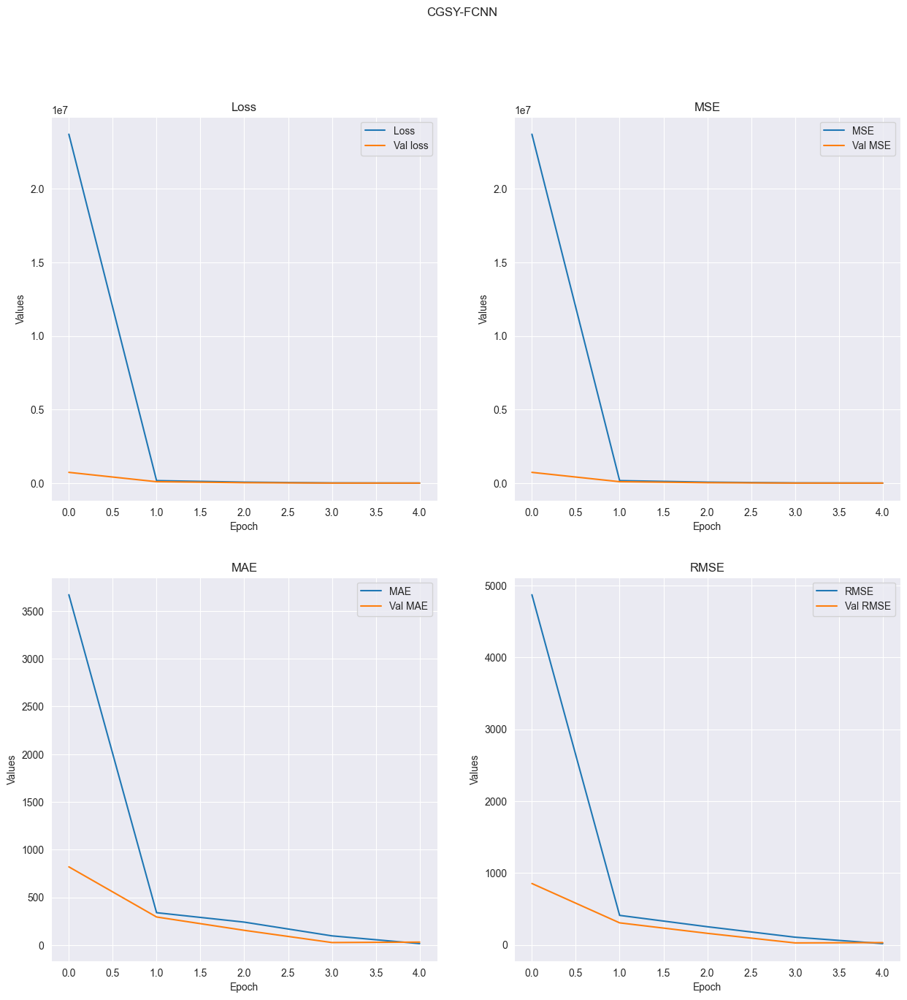

R-squared value: -14.0293


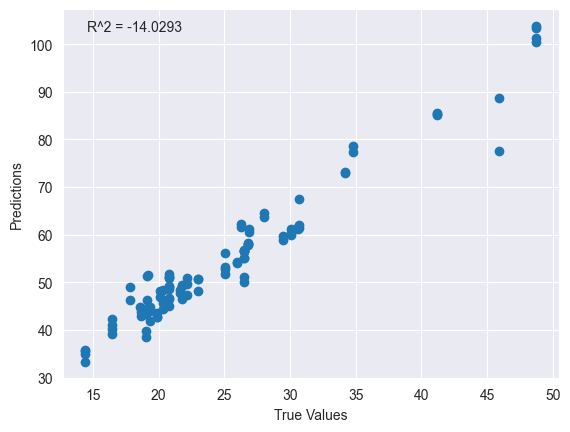

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_383 (Dense)           (None, 64)                128       
                                                                 
 dense_384 (Dense)           (None, 32)                2080      
                                                                 
 dense_385 (Dense)           (None, 16)                528       
                                                                 
 dense_386 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/50


2023-04-29 03:39:30.141956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521

2023-04-29 03:39:31.058009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 75ms/step - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521 - val_loss: 17714.7266 - val_mse: 17714.7266 - val_mae: 127.6721 - val_root_mean_squared_error: 133.0967
Epoch 2/50
11/11 [==============================] - 0s 17ms/step - loss: 932430.1250 - mse: 932430.1250 - mae: 873.2705 - root_mean_squared_error: 965.6242 - val_loss: 421392.2500 - val_mse: 421392.2500 - val_mae: 623.6829 - val_root_mean_squared_error: 649.1473
Epoch 3/50
11/11 [==============================] - 0s 18ms/step - loss: 122324.6250 - mse: 122324.6250 - mae: 275.8206 - root_mean_squared_error: 349.7494 - val_loss: 1564.3717 - val_mse: 1564.3717 - val_mae: 38.2025 - val_root_mean_squared_error: 39.5521
Epoch 4/50
11/11 [==============================] - 0s 16ms/step - loss: 17010.9688 - mse: 17010.9688 - mae: 118.5225 - root_mean_squared_error: 130.4261 - val_loss: 30145.5234 - val_mse: 30145.5234 - val_mae: 167.1085 - val

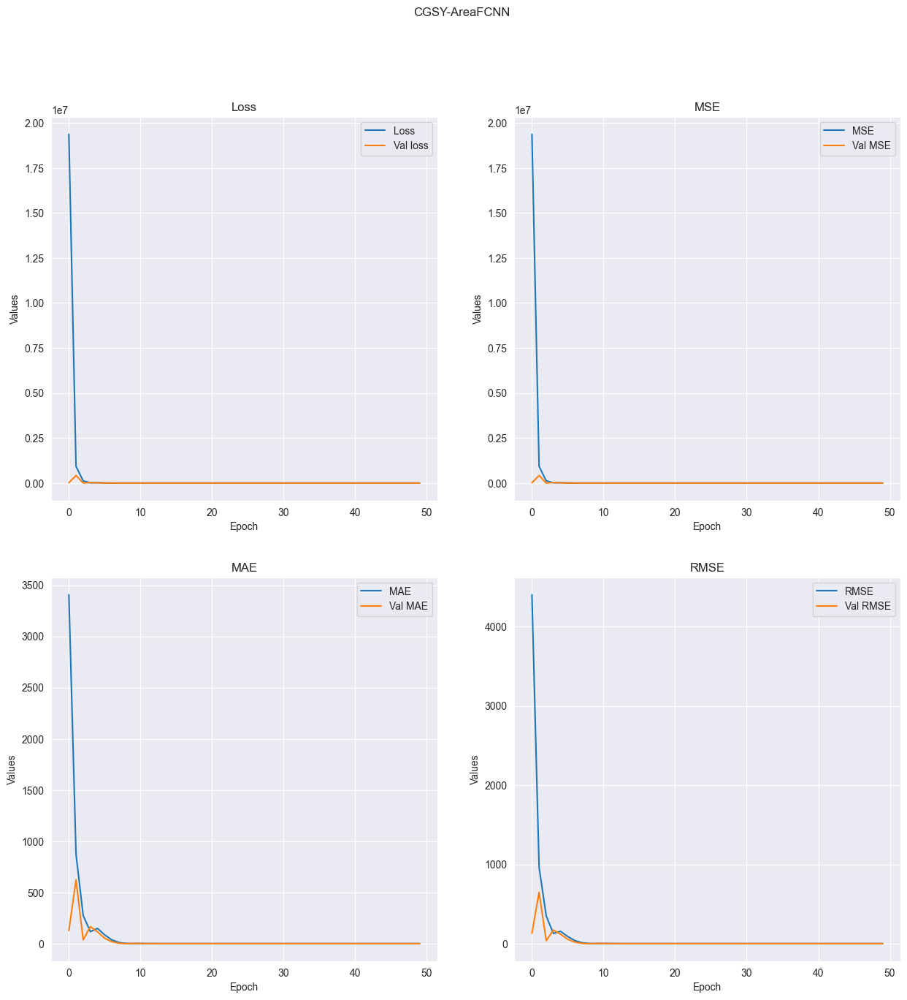

R-squared value: 0.9177


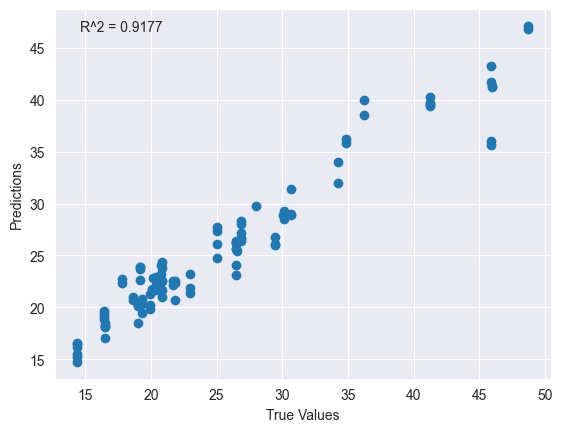

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_387 (Dense)           (None, 64)                128       
                                                                 
 dense_388 (Dense)           (None, 32)                2080      
                                                                 
 dense_389 (Dense)           (None, 16)                528       
                                                                 
 dense_390 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/500


2023-04-29 03:39:38.776629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674

2023-04-29 03:39:39.795213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 77ms/step - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674 - val_loss: 210354.5625 - val_mse: 210354.5625 - val_mae: 439.0882 - val_root_mean_squared_error: 458.6443
Epoch 2/500
11/11 [==============================] - 0s 19ms/step - loss: 1217078.6250 - mse: 1217078.6250 - mae: 1023.1184 - root_mean_squared_error: 1103.2129 - val_loss: 458335.7188 - val_mse: 458335.7188 - val_mae: 648.2742 - val_root_mean_squared_error: 677.0049
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 112703.7422 - mse: 112703.7422 - mae: 262.1600 - root_mean_squared_error: 335.7138 - val_loss: 812.6620 - val_mse: 812.6620 - val_mae: 27.4941 - val_root_mean_squared_error: 28.5072
Epoch 4/500
11/11 [==============================] - 0s 28ms/step - loss: 9231.3857 - mse: 9231.3857 - mae: 87.2979 - root_mean_squared_error: 96.0801 - val_loss: 18772.8359 - val_mse: 18772.8359 - val_mae: 131.5238 - 

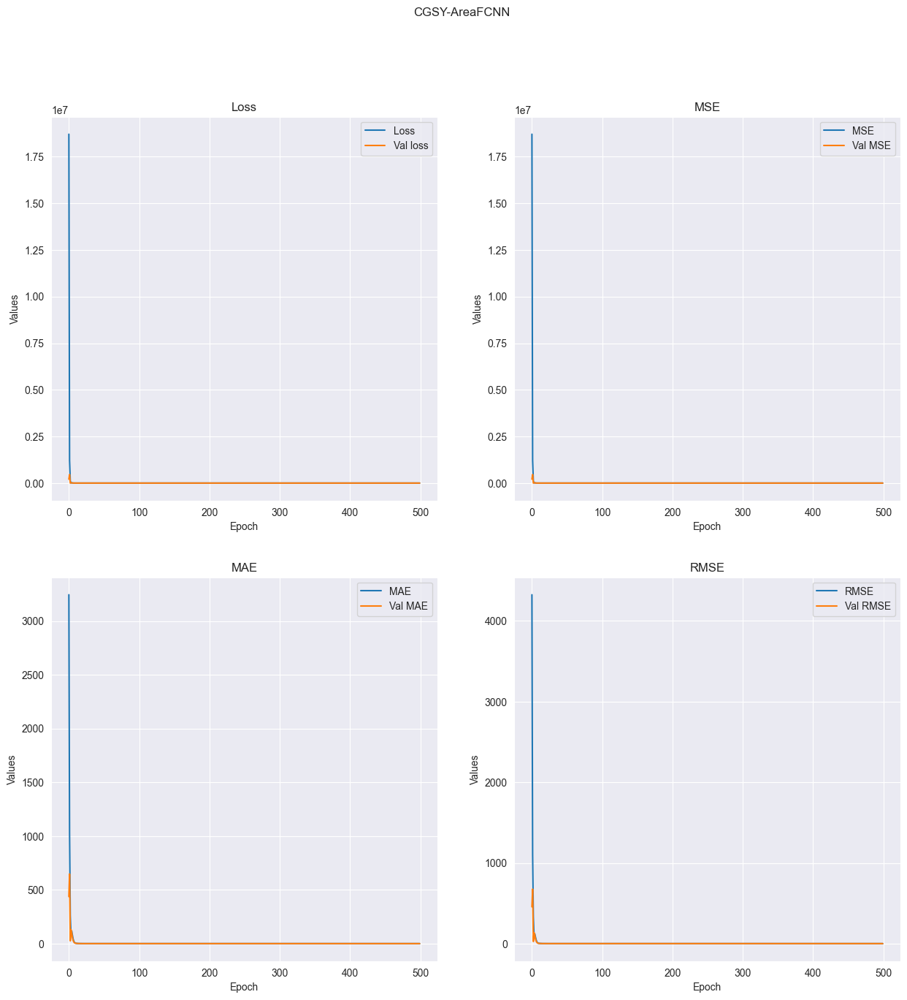

R-squared value: 0.8874


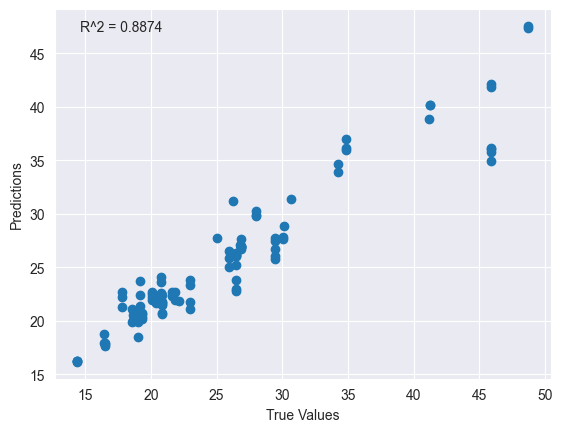

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_391 (Dense)           (None, 64)                128       
                                                                 
 dense_392 (Dense)           (None, 32)                2080      
                                                                 
 dense_393 (Dense)           (None, 16)                528       
                                                                 
 dense_394 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/2200


2023-04-29 03:40:37.817394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076

2023-04-29 03:40:38.868347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 81ms/step - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076 - val_loss: 664391.3125 - val_mse: 664391.3125 - val_mae: 789.2724 - val_root_mean_squared_error: 815.1021
Epoch 2/2200
11/11 [==============================] - 0s 15ms/step - loss: 147479.4062 - mse: 147479.4062 - mae: 324.7747 - root_mean_squared_error: 384.0305 - val_loss: 90890.5234 - val_mse: 90890.5234 - val_mae: 291.6838 - val_root_mean_squared_error: 301.4806
Epoch 3/2200
11/11 [==============================] - 0s 15ms/step - loss: 62459.0117 - mse: 62459.0117 - mae: 238.3114 - root_mean_squared_error: 249.9180 - val_loss: 26080.6699 - val_mse: 26080.6699 - val_mae: 156.1575 - val_root_mean_squared_error: 161.4951
Epoch 4/2200
11/11 [==============================] - 0s 12ms/step - loss: 11361.0537 - mse: 11361.0537 - mae: 94.6271 - root_mean_squared_error: 106.5882 - val_loss: 620.5366 - val_mse: 620.5366 - val_mae: 23.8500 - v

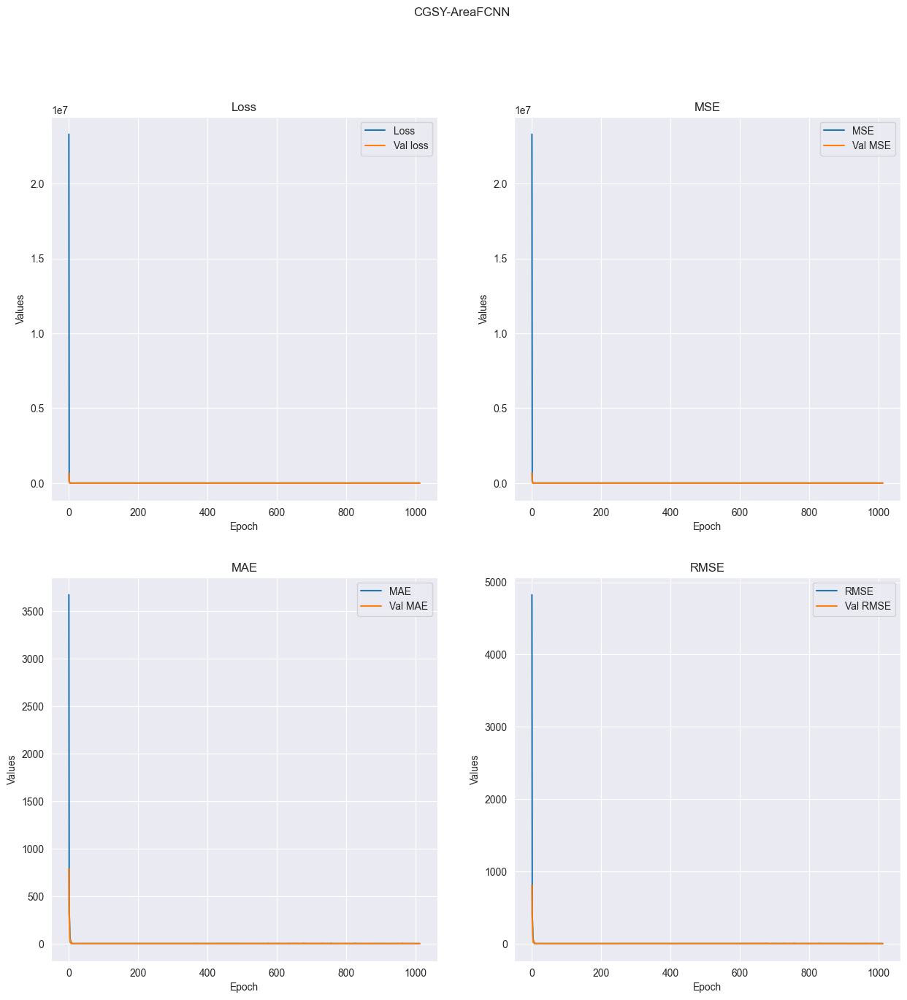

R-squared value: 0.9428


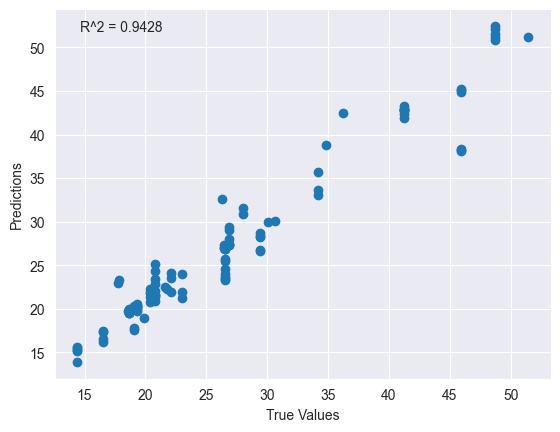

In [123]:

p3 = AutomaticLearning(pd.read_csv("classicgeometryRaspberriesRaw.csv").drop(["Roundness"], axis = 1), "CGRR-AreaLinear")
p3.buildData()
p3.buildModel("linear")
p3.train(2200)
p3.plot()

p1 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaLinear")
p1.buildData()
p1.buildModel("linear")
p1.train(2200)
p1.plot()

p2 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaLinear")
p2.buildData()
p2.buildModel("linear")
p2.train(2200)
p2.plot()


p4 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaSVR")
p4.buildData()
p4.buildModel("SVR")
p4.train(2200)
p4.plot()


p5 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-MLP")
p5.buildData()
p5.buildModel("MLP")
p5.train(5)
p5.plot()

p6 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-MLP")
p6.buildData()
p6.buildModel("MLP")
p6.train(5)
p6.plot()


p7 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-FCNN")
p7.buildData()
p7.buildModel("FCNN")
p7.train(5)
p7.plot()

p8 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-FCNN")
p8.buildData()
p8.buildModel("FCNN")
p8.train(5)
p8.plot()



p9 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p9.buildData()
p9.buildModel("FCNN")
p9.train(50)
p9.plot()


p10 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p10.buildData()
p10.buildModel("FCNN")
p10.train(500)
p10.plot()

p11 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p11.buildData()
p11.buildModel("FCNN")
p11.train(2200)
p11.plot()


